# D-NeRF from scratch

In [1]:
import os

project_path = '/home/youngju/youngju/NeRF/NeRF_Implementations/NeRF_models/D-NeRF'
print(os.listdir(project_path))
os.chdir(project_path)
print(os.getcwd())

['configs', 'Part2 D-NeRF.pdf', 'Part2 D-NeRF.pptx', 'torchsearchsorted', '.ipynb_checkpoints', 'D-NeRF from scratch.ipynb', 'data', 'logs']
/home/youngju/youngju/NeRF/NeRF_Implementations/NeRF_models/D-NeRF


In [2]:
import time
import torch
import numpy as np
import imageio 
import json
import torch.nn.functional as F
import matplotlib.pyplot as plt
import cv2
torch.autograd.set_detect_anomaly(True)
import torch.nn as nn
import numpy as np
from tqdm import tqdm, trange
import mcubes
import trimesh
import math
import lpips

In [3]:
torch.cuda.get_device_name(0)

'NVIDIA GeForce RTX 3090'

In [4]:
def config_parser():

    import argparse
    parser = argparse.ArgumentParser()

    parser.add_argument("--expname", type=str, 
                        help='experiment name')
    parser.add_argument("--basedir", type=str, default='./logs/', 
                        help='where to store ckpts and logs')
    parser.add_argument("--datadir", type=str, default='./data/llff/fern', 
                        help='input data directory')

    # training options
    parser.add_argument("--nerf_type", type=str, default="original",
                        help='nerf network type')
    parser.add_argument("--N_iter", type=int, default=500000,
                        help='num training iterations')
    parser.add_argument("--netdepth", type=int, default=8, 
                        help='layers in network')
    parser.add_argument("--netwidth", type=int, default=256, 
                        help='channels per layer')
    parser.add_argument("--netdepth_fine", type=int, default=8, 
                        help='layers in fine network')
    parser.add_argument("--netwidth_fine", type=int, default=256, 
                        help='channels per layer in fine network')
    parser.add_argument("--N_rand", type=int, default=32*32*4, 
                        help='batch size (number of random rays per gradient step)')
    parser.add_argument("--do_half_precision", action='store_true',
                        help='do half precision training and inference')
    parser.add_argument("--lrate", type=float, default=5e-4, 
                        help='learning rate')
    parser.add_argument("--lrate_decay", type=int, default=250, 
                        help='exponential learning rate decay (in 1000 steps)')
    parser.add_argument("--chunk", type=int, default=1024*32, 
                        help='number of rays processed in parallel, decrease if running out of memory')
    parser.add_argument("--netchunk", type=int, default=1024*64, 
                        help='number of pts sent through network in parallel, decrease if running out of memory')
    parser.add_argument("--no_batching", action='store_true', 
                        help='only take random rays from 1 image at a time')
    parser.add_argument("--no_reload", action='store_true', 
                        help='do not reload weights from saved ckpt')
    parser.add_argument("--ft_path", type=str, default=None, 
                        help='specific weights npy file to reload for coarse network')

    # rendering options
    parser.add_argument("--N_samples", type=int, default=64, 
                        help='number of coarse samples per ray')
    parser.add_argument("--not_zero_canonical", action='store_true',
                        help='if set zero time is not the canonic space')
    parser.add_argument("--N_importance", type=int, default=0,
                        help='number of additional fine samples per ray')
    parser.add_argument("--perturb", type=float, default=1.,
                        help='set to 0. for no jitter, 1. for jitter')
    parser.add_argument("--use_viewdirs", action='store_true', 
                        help='use full 5D input instead of 3D')
    parser.add_argument("--i_embed", type=int, default=0, 
                        help='set 0 for default positional encoding, -1 for none')
    parser.add_argument("--multires", type=int, default=10, 
                        help='log2 of max freq for positional encoding (3D location)')
    parser.add_argument("--multires_views", type=int, default=4, 
                        help='log2 of max freq for positional encoding (2D direction)')
    parser.add_argument("--raw_noise_std", type=float, default=0., 
                        help='std dev of noise added to regularize sigma_a output, 1e0 recommended')
    parser.add_argument("--use_two_models_for_fine", action='store_true',
                        help='use two models for fine results')

    parser.add_argument("--render_only", action='store_true', 
                        help='do not optimize, reload weights and render out render_poses path')
    parser.add_argument("--render_test", action='store_true', 
                        help='render the test set instead of render_poses path')
    parser.add_argument("--render_factor", type=int, default=0, 
                        help='downsampling factor to speed up rendering, set 4 or 8 for fast preview')

    # training options
    parser.add_argument("--precrop_iters", type=int, default=0,
                        help='number of steps to train on central crops')
    parser.add_argument("--precrop_iters_time", type=int, default=0,
                        help='number of steps to train on central time')
    parser.add_argument("--precrop_frac", type=float,
                        default=.5, help='fraction of img taken for central crops')
    parser.add_argument("--add_tv_loss", action='store_true',
                        help='evaluate tv loss')
    parser.add_argument("--tv_loss_weight", type=float,
                        default=1.e-4, help='weight of tv loss')

    # dataset options
    parser.add_argument("--dataset_type", type=str, default='llff', 
                        help='options: llff / blender / deepvoxels')
    parser.add_argument("--testskip", type=int, default=2,
                        help='will load 1/N images from test/val sets, useful for large datasets like deepvoxels')

    ## deepvoxels flags
    parser.add_argument("--shape", type=str, default='greek', 
                        help='options : armchair / cube / greek / vase')

    ## blender flags
    parser.add_argument("--white_bkgd", action='store_true', 
                        help='set to render synthetic data on a white bkgd (always use for dvoxels)')
    parser.add_argument("--half_res", action='store_true', 
                        help='load blender synthetic data at 400x400 instead of 800x800')

    ## llff flags
    parser.add_argument("--factor", type=int, default=8, 
                        help='downsample factor for LLFF images')
    parser.add_argument("--no_ndc", action='store_true', 
                        help='do not use normalized device coordinates (set for non-forward facing scenes)')
    parser.add_argument("--lindisp", action='store_true', 
                        help='sampling linearly in disparity rather than depth')
    parser.add_argument("--spherify", action='store_true', 
                        help='set for spherical 360 scenes')
    parser.add_argument("--llffhold", type=int, default=8, 
                        help='will take every 1/N images as LLFF test set, paper uses 8')

    # logging/saving options
    parser.add_argument("--i_print",   type=int, default=100,
                        help='frequency of console printout and metric loggin')
    parser.add_argument("--i_img",     type=int, default=10000,
                        help='frequency of tensorboard image logging')
    parser.add_argument("--i_weights", type=int, default=100000,
                        help='frequency of weight ckpt saving')
    parser.add_argument("--i_testset", type=int, default=200000,
                        help='frequency of testset saving')
    parser.add_argument("--i_video",   type=int, default=200000,
                        help='frequency of render_poses video saving')

    return parser


### load configurations

In [5]:
parser = config_parser()
args = parser.parse_args(args=[])
args.config = './configs/mutant.txt'

# load config

with open(args.config, 'r') as fp:
    lines = fp.readlines()
    lines = [line.strip() for line in lines]
    lines = [line.split(' = ') for line in lines if len(line)>0]

configs = {}
for line in lines:
    configs[line[0]] = line[1]

from pprint import pprint 
pprint(configs)

args.expname = configs['expname']
args.basedir = configs['basedir']
args.datadir = configs['datadir']
args.dataset_type = configs['dataset_type']

args.nerf_type = configs['nerf_type']
args.no_batching = configs['no_batching']
args.not_zero_canonical = configs['not_zero_canonical']

args.use_viewdirs = configs['use_viewdirs']
args.white_bkgd = configs['white_bkgd']
args.lrate_decay = int(configs['lrate_decay'])

args.N_iter = int(configs['N_iter'])
args.N_samples = int(configs['N_samples'])
args.N_importance = int(configs['N_importance'])
args.N_rand = int(configs['N_rand'])
args.testskip = int(configs['testskip'])

args.precrop_iters = int(configs['precrop_iters'])
args.precrop_iters_time = int(configs['precrop_iters_time'])
args.precrop_frac = float(configs['precrop_frac'])

args.half_res = configs['half_res']
args.do_half_precision = configs['do_half_precision']

args.no_reload = True # don't use checkpoint
pprint(args)

device = torch.device("cuda")
DEBUG=False
print(device)

torch.set_default_tensor_type('torch.cuda.FloatTensor')

{'N_importance': '128',
 'N_iter': '800000',
 'N_rand': '500',
 'N_samples': '64',
 'basedir': './logs',
 'datadir': './data/mutant',
 'dataset_type': 'blender',
 'do_half_precision': 'False',
 'expname': 'mutant',
 'half_res': 'True',
 'lrate_decay': '500',
 'nerf_type': 'direct_temporal',
 'no_batching': 'True',
 'not_zero_canonical': 'False',
 'precrop_frac': '0.5',
 'precrop_iters': '500',
 'precrop_iters_time': '100000',
 'testskip': '1',
 'use_viewdirs': 'True',
 'white_bkgd': 'True'}
Namespace(N_importance=128, N_iter=800000, N_rand=500, N_samples=64, add_tv_loss=False, basedir='./logs', chunk=32768, config='./configs/mutant.txt', datadir='./data/mutant', dataset_type='blender', do_half_precision='False', expname='mutant', factor=8, ft_path=None, half_res='True', i_embed=0, i_img=10000, i_print=100, i_testset=200000, i_video=200000, i_weights=100000, lindisp=False, llffhold=8, lrate=0.0005, lrate_decay=500, multires=10, multires_views=4, nerf_type='direct_temporal', netchunk=655

## Visualize dataset

{'file_path': './test/r_000', 'rotation': 0.3141592653589793, 'time': 0.0, 'transform_matrix': [[-0.9671632051467896, 0.0898933932185173, -0.23772795498371124, -0.958311915397644], [-0.254156231880188, -0.3420792818069458, 0.904647171497345, 3.6467490196228027], [-7.450581485102248e-09, 0.9353613257408142, 0.35369348526000977, 1.4257838726043701], [0.0, 0.0, 0.0, 1.0]]}
(800, 800, 4)


/tmp/ipykernel_68555/698700985.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(_fname)
/tmp/ipykernel_68555/698700985.py:22: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(_fname)


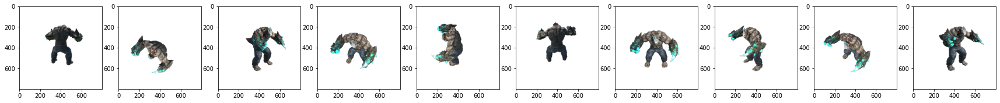

In [6]:
_datadir = './data/mutant'

with open(os.path.join(_datadir, 'transforms_test.json'), 'r') as fp:
    meta  = json.load(fp)
    
# print(meta)

_frames = meta['frames']
_frame = _frames[0]
print(_frame)

_fname = os.path.join(_datadir, _frame['file_path'] + '.png')
# print(_fname)

img = imageio.imread(_fname)
print(img.shape) # 4 channel rgba

fig, axis = plt.subplots(1, 10, figsize=(30,300))
for i in range(10):
    _frame = _frames[i]
    _fname = os.path.join(_datadir, _frame['file_path']+'.png')
    img = imageio.imread(_fname)
    axis[i].imshow(img)

In [7]:
trans_t = lambda t : torch.Tensor([
    [1,0,0,0],
    [0,1,0,0],
    [0,0,1,t],
    [0,0,0,1]]).float()

rot_phi = lambda phi : torch.Tensor([
    [1,0,0,0],
    [0,np.cos(phi),-np.sin(phi),0],
    [0,np.sin(phi), np.cos(phi),0],
    [0,0,0,1]]).float()

rot_theta = lambda th : torch.Tensor([
    [np.cos(th),0,-np.sin(th),0],
    [0,1,0,0],
    [np.sin(th),0, np.cos(th),0],
    [0,0,0,1]]).float()

def rodrigues_mat_to_rot(R):
    eps =1e-16
    trc = np.trace(R)
    trc2 = (trc - 1.)/ 2.
    #sinacostrc2 = np.sqrt(1 - trc2 * trc2)
    s = np.array([R[2, 1] - R[1, 2], R[0, 2] - R[2, 0], R[1, 0] - R[0, 1]])
    if (1 - trc2 * trc2) >= eps:
        tHeta = np.arccos(trc2)
        tHetaf = tHeta / (2 * (np.sin(tHeta)))
    else:
        tHeta = np.real(np.arccos(trc2))
        tHetaf = 0.5 / (1 - tHeta / 6)
    omega = tHetaf * s
    return omega

def rodrigues_rot_to_mat(r):
    wx,wy,wz = r
    theta = np.sqrt(wx * wx + wy * wy + wz * wz)
    a = np.cos(theta)
    b = (1 - np.cos(theta)) / (theta*theta)
    c = np.sin(theta) / theta
    R = np.zeros([3,3])
    R[0, 0] = a + b * (wx * wx)
    R[0, 1] = b * wx * wy - c * wz
    R[0, 2] = b * wx * wz + c * wy
    R[1, 0] = b * wx * wy + c * wz
    R[1, 1] = a + b * (wy * wy)
    R[1, 2] = b * wy * wz - c * wx
    R[2, 0] = b * wx * wz - c * wy
    R[2, 1] = b * wz * wy + c * wx
    R[2, 2] = a + b * (wz * wz)
    return R


def pose_spherical(theta, phi, radius):
    c2w = trans_t(radius)
    c2w = rot_phi(phi/180.*np.pi) @ c2w
    c2w = rot_theta(theta/180.*np.pi) @ c2w
    c2w = torch.Tensor(np.array([[-1,0,0,0],[0,0,1,0],[0,1,0,0],[0,0,0,1]])) @ c2w
    return c2w


def load_blender_data(basedir, half_res=False, testskip=1):
    splits = ['train', 'val', 'test']
    metas = {}
    for s in splits:
        with open(os.path.join(basedir, 'transforms_{}.json'.format(s)), 'r') as fp:
            metas[s] = json.load(fp)

    all_imgs = []
    all_poses = []
    all_times = []
    counts = [0]
    for s in splits:
        meta = metas[s]

        imgs = []
        poses = []
        times = []
        # if s=='train' or testskip==0:
        #     skip = 2  # if you remove/change this 2, also change the /2 in the times vector
        # else:
        skip = testskip
            
        for t, frame in enumerate(meta['frames'][::skip]):
            fname = os.path.join(basedir, frame['file_path'] + '.png')
            imgs.append(imageio.imread(fname))
            poses.append(np.array(frame['transform_matrix']))
            cur_time = frame['time'] if 'time' in frame else float(t) / (len(meta['frames'][::skip])-1)
            times.append(cur_time)

        assert times[0] == 0, "Time must staugging consider passing CUDA_LAUNCH_BLOCKING=1.rt at 0"

        imgs = (np.array(imgs) / 255.).astype(np.float32)  # keep all 4 channels (RGBA)
        poses = np.array(poses).astype(np.float32)
        times = np.array(times).astype(np.float32)
        counts.append(counts[-1] + imgs.shape[0])
        all_imgs.append(imgs)
        all_poses.append(poses)
        all_times.append(times)
    
    i_split = [np.arange(counts[i], counts[i+1]) for i in range(3)]
    
    imgs = np.concatenate(all_imgs, 0)
    poses = np.concatenate(all_poses, 0)
    times = np.concatenate(all_times, 0)
    
    H, W = imgs[0].shape[:2]
    camera_angle_x = float(meta['camera_angle_x'])
    focal = .5 * W / np.tan(.5 * camera_angle_x)

    if os.path.exists(os.path.join(basedir, 'transforms_{}.json'.format('render'))):
        with open(os.path.join(basedir, 'transforms_{}.json'.format('render')), 'r') as fp:
            meta = json.load(fp)
        render_poses = []
        for frame in meta['frames']:
            render_poses.append(np.array(frame['transform_matrix']))
        render_poses = np.array(render_poses).astype(np.float32)
    else:
        render_poses = torch.stack([pose_spherical(angle, -30.0, 4.0) for angle in np.linspace(-180,180,40+1)[:-1]], 0)
    render_times = torch.linspace(0., 1., render_poses.shape[0])
    
    if half_res:
        H = H//2
        W = W//2
        focal = focal/2.

        imgs_half_res = np.zeros((imgs.shape[0], H, W, 4))
        for i, img in enumerate(imgs):
            imgs_half_res[i] = cv2.resize(img, (H, W), interpolation=cv2.INTER_AREA)
        imgs = imgs_half_res
        # imgs = tf.image.resize_area(imgs, [400, 400]).numpy()

        
    return imgs, poses, times, render_poses, render_times, [H, W, focal], i_split

In [8]:
torch.cuda.is_available()

True

In [9]:
torch.cuda.get_device_name(0)

'NVIDIA GeForce RTX 3090'

In [10]:
images, poses, times, render_poses, render_times, hwf, i_split = load_blender_data(args.datadir, args.half_res, args.testskip)

/tmp/ipykernel_68555/2327544139.py:85: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  imgs.append(imageio.imread(fname))


In [11]:
print(images.shape)
print(i_split) # 150 + 20 + 20
print(poses.shape)
print(poses[0]) # 4 x 4 cam2world matrix

print(times.shape)
print(times[0], times[-1])

(190, 400, 400, 4)
[array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149]), array([150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162,
       163, 164, 165, 166, 167, 168, 169]), array([170, 171, 172, 173, 1

## Positional Encoding
- position xyz, view direction, time

In [12]:
# Positional encoding (section 5.1)
class Embedder:
    def __init__(self, **kwargs):
        self.kwargs = kwargs
        self.create_embedding_fn()
        
    def create_embedding_fn(self):
        embed_fns = []
        d = self.kwargs['input_dims']
        out_dim = 0
        if self.kwargs['include_input']:
            embed_fns.append(lambda x : x)
            out_dim += d
            
        max_freq = self.kwargs['max_freq_log2']
        N_freqs = self.kwargs['num_freqs']
        
        if self.kwargs['log_sampling']:
            freq_bands = 2.**torch.linspace(0., max_freq, steps=N_freqs)
        else:
            freq_bands = torch.linspace(2.**0., 2.**max_freq, steps=N_freqs)
            
        for freq in freq_bands:
            for p_fn in self.kwargs['periodic_fns']:
                embed_fns.append(lambda x, p_fn=p_fn, freq=freq : p_fn(x * freq))
                out_dim += d
                    
        self.embed_fns = embed_fns
        self.out_dim = out_dim
        
    def embed(self, inputs):
        return torch.cat([fn(inputs) for fn in self.embed_fns], -1)


def get_embedder(multires, input_dims, i=0):
    if i == -1:
        return nn.Identity(), input_dims
    
    embed_kwargs = {
                'include_input' : True,
                'input_dims' : input_dims,
                'max_freq_log2' : multires-1,
                'num_freqs' : multires,
                'log_sampling' : True,
                'periodic_fns' : [torch.sin, torch.cos],
    }
    
    embedder_obj = Embedder(**embed_kwargs)
    embed = lambda x, eo=embedder_obj : eo.embed(x)
    return embed, embedder_obj.out_dim

In [13]:
# Model
class DirectTemporalNeRF(nn.Module):
    def __init__(self, D=8, W=256, input_ch=3, input_ch_views=3, input_ch_time=1, output_ch=4, skips=[4],
                 use_viewdirs=False, memory=[], embed_fn=None, zero_canonical=True):
        super(DirectTemporalNeRF, self).__init__()
        self.D = D # layer 개수
        self.W = W # layer 채널 수 
        self.input_ch = input_ch # 3d position을 positional encode된 channel의 개수
        self.input_ch_views = input_ch_views # viewdir을 ""
        self.input_ch_time = input_ch_time  # time을 ""
        self.skips = skips
        self.use_viewdirs = use_viewdirs
        self.memory = memory
        self.embed_fn = embed_fn
        self.zero_canonical = zero_canonical

        # canonical network (canonical state의 static한 object를 modeling)
        self._occ = NeRFOriginal(D=D, W=W, input_ch=input_ch, input_ch_views=input_ch_views,
                                 input_ch_time=input_ch_time, output_ch=output_ch, skips=skips,
                                 use_viewdirs=use_viewdirs, memory=memory, embed_fn=embed_fn, output_color_ch=3)
        # deformation network
        self._time, self._time_out = self.create_time_net()

    def create_time_net(self):
        """
        input: x, y, z, t
        output: dx, dy, dz (deformation)
        """
        layers = [nn.Linear(self.input_ch + self.input_ch_time, self.W)] # 1st layer
        for i in range(self.D - 1):
            layer = nn.Linear
            
            in_channels = self.W
            if  i in self.skips:
                in_channels += self.input_ch
                
            layers += [layer(in_channels, self.W)]
        
        return nn.ModuleList(layers), nn.Linear(self.W, 3)
        
    
    def query_time(self, new_pts, t, net, net_final):
        """
        new_pts.shape: [chunk, positional_encoded_position_dim]
        t.shape: [chunk, positional_encoded_time_dim] 
        """
        h = torch.cat([new_pts, t], dim=-1)
        for i, l in enumerate(net):
            h = net[i](h)
            h = F.relu(h) # nonlinearity
            if i in self.skips:
                h = torch.cat([h, new_pts], dim=-1)
            
        return net_final(h) # 3 dimension (dx, dy, dz)
            
    
    def forward(self, x, ts):
        input_pts, input_views = torch.split(x, [self.input_ch, self.input_ch_views], dim=-1)
        t = ts[0] # ?

        assert len(torch.unique(t[:, :1])) == 1, "Only accepts all points from same time"
        cur_time = t[0, 0] # 현재 time (canonical time)
        
        if cur_time == 0. and self.zero_canonical:
            dx = torch.zeros_like(input_pts[:, :3])
        
        else: # deformation needed
            dx = self.query_time(input_pts, t, self._time, self._time_out)
            input_pts_orig = input_pts[:, :3]
            input_pts = self.embed_fn(input_pts_orig + dx) # deformation space to canonical space
            
        out, _ = self._occ(torch.cat([input_pts, input_views], dim=-1), t)
        
        return out, dx

# Canonical Network (Original NeRF와 구조상 동일)
class NeRF:
    @staticmethod
    def get_by_name(type,  *args, **kwargs):
        print ("NeRF type selected: %s" % type)

        if type == "original":
            model = NeRFOriginal(*args, **kwargs)
        elif type == "direct_temporal":
            model = DirectTemporalNeRF(*args, **kwargs)
        else:
            raise ValueError("Type %s not recognized." % type)
        return model

class NeRFOriginal(nn.Module):
    def __init__(self, D=8, W=256, input_ch=3, input_ch_views=3, input_ch_time=1, output_ch=4, skips=[4],
                 use_viewdirs=False, memory=[], embed_fn=None, output_color_ch=3, zero_canonical=True):
        super(NeRFOriginal, self).__init__()
        self.D = D # layer depth
        self.W = W # layer width
        self.input_ch = input_ch # input dimension of encoded position
        self.input_ch_views = input_ch_views # input dimension of encoded viewdirs
        self.skips = skips # skip list
        self.use_viewdirs = use_viewdirs # True if use viewdirs

        # self.pts_linears = nn.ModuleList(
        #     [nn.Linear(input_ch, W)] +
        #     [nn.Linear(W, W) if i not in self.skips else nn.Linear(W + input_ch, W) for i in range(D-1)])

        layers = [nn.Linear(input_ch, W)]
        for i in range(D - 1):
            layer = nn.Linear
            
            in_channels = W
            if i in self.skips:
                in_channels += input_ch
                
            layers += [layer(in_channels, W)]
        
        self.pts_linears = nn.ModuleList(layers)
        
        ### Implementation according to the official code release (https://github.com/bmild/nerf/blob/master/run_nerf_helpers.py#L104-L105)
        self.views_linears = nn.ModuleList([nn.Linear(input_ch_views + W, W//2)])

        ### Implementation according to the paper
        # self.views_linears = nn.ModuleList(
        #     [nn.Linear(input_ch_views + W, W//2)] + [nn.Linear(W//2, W//2) for i in range(D//2)])

        if use_viewdirs:
            self.feature_linear = nn.Linear(W, W)
            self.alpha_linear = nn.Linear(W, 1) # final density layer
            self.rgb_linear = nn.Linear(W//2, output_color_ch) # final rgb layer
        else:
            self.output_linear = nn.Linear(W, output_ch)

    def forward(self, x, ts):
        input_pts, input_views = torch.split(x, [self.input_ch, self.input_ch_views], dim=-1)
        h = input_pts
        
        for i, l in enumerate(self.pts_linears):
            h = self.pts_linears[i](h)
            h = F.relu(h)
            if i in self.skips:
                h = torch.cat([input_pts, h], dim=-1)
                
        if self.use_viewdirs:
            alpha = self.alpha_linear(h) # 1 dimension
            
            feature = self.feature_linear(h)
            h = torch.cat([feature, input_views], -1)
            
            for i, l in enumerate(self.views_linears):
                h = self.views_linears[i](h)
                h = F.relu(h)
                
            rgb = self.rgb_linear(h)
            outputs = torch.cat([rgb, alpha], dim=-1)
        
        else:
            outputs = self.output_linear(h)
        
        return outputs, torch.zeros_like(input_pts[:, :3])


    def load_weights_from_keras(self, weights):
        assert self.use_viewdirs, "Not implemented if use_viewdirs=False"

        # Load pts_linears
        for i in range(self.D):
            idx_pts_linears = 2 * i
            self.pts_linears[i].weight.data = torch.from_numpy(np.transpose(weights[idx_pts_linears]))
            self.pts_linears[i].bias.data = torch.from_numpy(np.transpose(weights[idx_pts_linears+1]))

        # Load feature_linear
        idx_feature_linear = 2 * self.D
        self.feature_linear.weight.data = torch.from_numpy(np.transpose(weights[idx_feature_linear]))
        self.feature_linear.bias.data = torch.from_numpy(np.transpose(weights[idx_feature_linear+1]))

        # Load views_linears
        idx_views_linears = 2 * self.D + 2
        self.views_linears[0].weight.data = torch.from_numpy(np.transpose(weights[idx_views_linears]))
        self.views_linears[0].bias.data = torch.from_numpy(np.transpose(weights[idx_views_linears+1]))

        # Load rgb_linear
        idx_rbg_linear = 2 * self.D + 4
        self.rgb_linear.weight.data = torch.from_numpy(np.transpose(weights[idx_rbg_linear]))
        self.rgb_linear.bias.data = torch.from_numpy(np.transpose(weights[idx_rbg_linear+1]))

        # Load alpha_linear
        idx_alpha_linear = 2 * self.D + 6
        self.alpha_linear.weight.data = torch.from_numpy(np.transpose(weights[idx_alpha_linear]))
        self.alpha_linear.bias.data = torch.from_numpy(np.transpose(weights[idx_alpha_linear+1]))


def hsv_to_rgb(h, s, v):
    '''
    h,s,v in range [0,1]
    '''
    hi = torch.floor(h * 6)
    f = h * 6. - hi
    p = v * (1. - s)
    q = v * (1. - f * s)
    t = v * (1. - (1. - f) * s)

    rgb = torch.cat([hi, hi, hi], -1) % 6
    rgb[rgb == 0] = torch.cat((v, t, p), -1)[rgb == 0]
    rgb[rgb == 1] = torch.cat((q, v, p), -1)[rgb == 1]
    rgb[rgb == 2] = torch.cat((p, v, t), -1)[rgb == 2]
    rgb[rgb == 3] = torch.cat((p, q, v), -1)[rgb == 3]
    rgb[rgb == 4] = torch.cat((t, p, v), -1)[rgb == 4]
    rgb[rgb == 5] = torch.cat((v, p, q), -1)[rgb == 5]
    return rgb


# Ray helpers
def get_rays(H, W, focal, c2w):
    i, j = torch.meshgrid(torch.linspace(0, W-1, W), torch.linspace(0, H-1, H))  # pytorch's meshgrid has indexing='ij'
    i = i.t()
    j = j.t()
    dirs = torch.stack([(i-W*.5)/focal, -(j-H*.5)/focal, -torch.ones_like(i)], -1)
    # Rotate ray directions from camera frame to the world frame
    rays_d = torch.sum(dirs[..., np.newaxis, :] * c2w[:3,:3], -1)  # dot product, equals to: [c2w.dot(dir) for dir in dirs]
    # Translate camera frame's origin to the world frame. It is the origin of all rays.
    rays_o = c2w[:3,-1].expand(rays_d.shape)
    return rays_o, rays_d


def get_rays_np(H, W, focal, c2w):
    i, j = np.meshgrid(np.arange(W, dtype=np.float32), np.arange(H, dtype=np.float32), indexing='xy')
    dirs = np.stack([(i-W*.5)/focal, -(j-H*.5)/focal, -np.ones_like(i)], -1)
    # Rotate ray directions from camera frame to the world frame
    rays_d = np.sum(dirs[..., np.newaxis, :] * c2w[:3,:3], -1)  # dot product, equals to: [c2w.dot(dir) for dir in dirs]
    # Translate camera frame's origin to the world frame. It is the origin of all rays.
    rays_o = np.broadcast_to(c2w[:3,-1], np.shape(rays_d))
    return rays_o, rays_d


def ndc_rays(H, W, focal, near, rays_o, rays_d):
    # Shift ray origins to near plane
    t = -(near + rays_o[...,2]) / rays_d[...,2]
    rays_o = rays_o + t[...,None] * rays_d
    
    # Projection
    o0 = -1./(W/(2.*focal)) * rays_o[...,0] / rays_o[...,2]
    o1 = -1./(H/(2.*focal)) * rays_o[...,1] / rays_o[...,2]
    o2 = 1. + 2. * near / rays_o[...,2]

    d0 = -1./(W/(2.*focal)) * (rays_d[...,0]/rays_d[...,2] - rays_o[...,0]/rays_o[...,2])
    d1 = -1./(H/(2.*focal)) * (rays_d[...,1]/rays_d[...,2] - rays_o[...,1]/rays_o[...,2])
    d2 = -2. * near / rays_o[...,2]
    
    rays_o = torch.stack([o0,o1,o2], -1)
    rays_d = torch.stack([d0,d1,d2], -1)
    
    return rays_o, rays_d


# Hierarchical sampling (section 5.2)
def sample_pdf(bins, weights, N_samples, det=False, pytest=False):
    # Get pdf
    weights = weights + 1e-5 # prevent nans
    pdf = weights / torch.sum(weights, -1, keepdim=True)
    cdf = torch.cumsum(pdf, -1)
    cdf = torch.cat([torch.zeros_like(cdf[...,:1]), cdf], -1)  # (batch, len(bins))

    # Take uniform samples
    if det:
        u = torch.linspace(0., 1., steps=N_samples)
        u = u.expand(list(cdf.shape[:-1]) + [N_samples])
    else:
        u = torch.rand(list(cdf.shape[:-1]) + [N_samples])

    # Pytest, overwrite u with numpy's fixed random numbers
    if pytest:
        np.random.seed(0)
        new_shape = list(cdf.shape[:-1]) + [N_samples]
        if det:
            u = np.linspace(0., 1., N_samples)
            u = np.broadcast_to(u, new_shape)
        else:
            u = np.random.rand(*new_shape)
        u = torch.Tensor(u)

    # Invert CDF
    u = u.contiguous()
    inds = torch.searchsorted(cdf, u, side='right')
    below = torch.max(torch.zeros_like(inds-1), inds-1)
    above = torch.min((cdf.shape[-1]-1) * torch.ones_like(inds), inds)
    inds_g = torch.stack([below, above], -1)  # (batch, N_samples, 2)

    # cdf_g = tf.gather(cdf, inds_g, axis=-1, batch_dims=len(inds_g.shape)-2)
    # bins_g = tf.gather(bins, inds_g, axis=-1, batch_dims=len(inds_g.shape)-2)
    matched_shape = [inds_g.shape[0], inds_g.shape[1], cdf.shape[-1]]
    cdf_g = torch.gather(cdf.unsqueeze(1).expand(matched_shape), 2, inds_g)
    bins_g = torch.gather(bins.unsqueeze(1).expand(matched_shape), 2, inds_g)

    denom = (cdf_g[...,1]-cdf_g[...,0])
    denom = torch.where(denom<1e-5, torch.ones_like(denom), denom)
    t = (u-cdf_g[...,0])/denom
    samples = bins_g[...,0] + t * (bins_g[...,1]-bins_g[...,0])

    return samples

In [14]:
# Misc
img2mse = lambda x, y : torch.mean((x - y) ** 2)
mse2psnr = lambda x : -10. * torch.log(x) / torch.log(torch.Tensor([10.]))
to8b = lambda x : (255*np.clip(x,0,1)).astype(np.uint8)

In [15]:
DEBUG = False


def batchify(fn, chunk):
    """Constructs a version of 'fn' that applies to smaller batches.
    """
    if chunk is None:
        return fn
    def ret(inputs_pos, inputs_time):
        num_batches = inputs_pos.shape[0]

        out_list = []
        dx_list = []
        for i in range(0, num_batches, chunk):
            out, dx = fn(inputs_pos[i:i+chunk], [inputs_time[0][i:i+chunk], inputs_time[1][i:i+chunk]])
            out_list += [out]
            dx_list += [dx]
        return torch.cat(out_list, 0), torch.cat(dx_list, 0)
    return ret


def run_network(inputs, viewdirs, frame_time, fn, embed_fn, embeddirs_fn, embedtime_fn, netchunk=1024*64,
                embd_time_discr=True):
    """Prepares inputs and applies network 'fn'.
    inputs: N_rays x N_points_per_ray x 3
    viewdirs: N_rays x 3
    frame_time: N_rays x 1
    """
    assert len(torch.unique(frame_time)) == 1, "Only accepts all points from same time"
    cur_time = torch.unique(frame_time)[0]

    # embed position
    inputs_flat = torch.reshape(inputs, [-1, inputs.shape[-1]])
    embedded = embed_fn(inputs_flat)

    # embed time
    if embd_time_discr:
        B, N, _ = inputs.shape
        input_frame_time = frame_time[:, None].expand([B, N, 1])
        input_frame_time_flat = torch.reshape(input_frame_time, [-1, 1])
        embedded_time = embedtime_fn(input_frame_time_flat)
        embedded_times = [embedded_time, embedded_time]

    else:
        assert NotImplementedError

    # embed views
    if viewdirs is not None:
        input_dirs = viewdirs[:,None].expand(inputs.shape)
        input_dirs_flat = torch.reshape(input_dirs, [-1, input_dirs.shape[-1]])
        embedded_dirs = embeddirs_fn(input_dirs_flat)
        embedded = torch.cat([embedded, embedded_dirs], -1)

    outputs_flat, position_delta_flat = batchify(fn, netchunk)(embedded, embedded_times)
    outputs = torch.reshape(outputs_flat, list(inputs.shape[:-1]) + [outputs_flat.shape[-1]])
    position_delta = torch.reshape(position_delta_flat, list(inputs.shape[:-1]) + [position_delta_flat.shape[-1]])
    return outputs, position_delta


def batchify_rays(rays_flat, chunk=1024*32, **kwargs):
    """Render rays in smaller minibatches to avoid OOM.
        반복문을 돌면서 작은 batch 단위로 render_rays 함수 호출
    """
    all_ret = {}
    for i in range(0, rays_flat.shape[0], chunk):
        ret = render_rays(rays_flat[i:i+chunk], **kwargs)
        for k in ret:
            if k not in all_ret:
                all_ret[k] = []
            all_ret[k].append(ret[k])

    all_ret = {k : torch.cat(all_ret[k], 0) for k in all_ret}
    return all_ret


def render(H, W, focal, chunk=1024*32, rays=None, c2w=None, ndc=True,
                  near=0., far=1., frame_time=None,
                  use_viewdirs=False, c2w_staticcam=None,
                  **kwargs):
    """Render rays
    Args:
      H: int. Height of image in pixels.
      W: int. Width of image in pixels.
      focal: float. Focal length of pinhole camera.
      chunk: int. Maximum number of rays to process simultaneously. Used to
        control maximum memory usage. Does not affect final results.
      rays: array of shape [2, batch_size, 3]. Ray origin and direction for
        each example in batch.
      c2w: array of shape [3, 4]. Camera-to-world transformation matrix.
      ndc: bool. If True, represent ray origin, direction in NDC coordinates.
      near: float or array of shape [batch_size]. Nearest distance for a ray.
      far: float or array of shape [batch_size]. Farthest distance for a ray.
      use_viewdirs: bool. If True, use viewing direction of a point in space in model.
      c2w_staticcam: array of shape [3, 4]. If not None, use this transformation matrix for 
       camera while using other c2w argument for viewing directions.
    Returns:
      rgb_map: [batch_size, 3]. Predicted RGB values for rays.
      disp_map: [batch_size]. Disparity map. Inverse of depth.
      acc_map: [batch_size]. Accumulated opacity (alpha) along a ray.
      extras: dict with everything returned by render_rays().
    """
    if c2w is not None:
        # special case to render full image
        rays_o, rays_d = get_rays(H, W, focal, c2w) # rays의 원점과 방향
    else:
        # use provided ray batch
        rays_o, rays_d = rays

    if use_viewdirs:
        # provide ray directions as input
        viewdirs = rays_d
        if c2w_staticcam is not None:
            # special case to visualize effect of viewdirs
            rays_o, rays_d = get_rays(H, W, focal, c2w_staticcam)
        viewdirs = viewdirs / torch.norm(viewdirs, dim=-1, keepdim=True)
        viewdirs = torch.reshape(viewdirs, [-1,3]).float()

    sh = rays_d.shape # [..., 3]
    if ndc:
        # for forward facing scenes
        rays_o, rays_d = ndc_rays(H, W, focal, 1., rays_o, rays_d)

    # Create ray batch (flatten)
    rays_o = torch.reshape(rays_o, [-1,3]).float() # xyz 3 channels
    rays_d = torch.reshape(rays_d, [-1,3]).float()
    
    # time
    near, far = near * torch.ones_like(rays_d[...,:1]), far * torch.ones_like(rays_d[...,:1])
    frame_time = frame_time * torch.ones_like(rays_d[...,:1])
    
    # concat ray elements
    rays = torch.cat([rays_o, rays_d, near, far, frame_time], -1)
    
    if use_viewdirs:
        rays = torch.cat([rays, viewdirs], -1)

    # Render and reshape
    all_ret = batchify_rays(rays, chunk, **kwargs)
    for k in all_ret:
        k_sh = list(sh[:-1]) + list(all_ret[k].shape[1:])
        all_ret[k] = torch.reshape(all_ret[k], k_sh)

    k_extract = ['rgb_map', 'disp_map', 'acc_map']
    ret_list = [all_ret[k] for k in k_extract]
    ret_dict = {k : all_ret[k] for k in all_ret if k not in k_extract}
    return ret_list + [ret_dict]


def render_path(render_poses, render_times, hwf, chunk, render_kwargs, gt_imgs=None, savedir=None,
                render_factor=0, save_also_gt=False, i_offset=0):

    H, W, focal = hwf

    if render_factor!=0:
        # Render downsampled for speed
        H = H//render_factor
        W = W//render_factor
        focal = focal/render_factor

    if savedir is not None:
        save_dir_estim = os.path.join(savedir, "estim")
        save_dir_gt = os.path.join(savedir, "gt")
        if not os.path.exists(save_dir_estim):
            os.makedirs(save_dir_estim)
        if save_also_gt and not os.path.exists(save_dir_gt):
            os.makedirs(save_dir_gt)

    rgbs = []
    disps = []
    accs = []

    for i, (c2w, frame_time) in enumerate(zip(tqdm(render_poses), render_times)):
        rgb, disp, acc, _ = render(H, W, focal, chunk=chunk, c2w=c2w[:3,:4], frame_time=frame_time, **render_kwargs)
        rgbs.append(rgb.cpu().numpy())
        disps.append(disp.cpu().numpy())
        accs.append(acc.cpu().numpy())

        if savedir is not None:
            rgb8_estim = to8b(rgbs[-1])
            filename = os.path.join(save_dir_estim, '{:03d}.png'.format(i+i_offset))
            imageio.imwrite(filename, rgb8_estim)
            if save_also_gt:
                rgb8_gt = to8b(gt_imgs[i])
                filename = os.path.join(save_dir_gt, '{:03d}.png'.format(i+i_offset))
                imageio.imwrite(filename, rgb8_gt)

    rgbs = np.stack(rgbs, 0)
    disps = np.stack(disps, 0)
    accs = np.stack(accs, 0)

    return rgbs, disps, accs


def create_nerf(args):
    """Instantiate NeRF's MLP model.
    """
    embed_fn, input_ch = get_embedder(args.multires, 3, args.i_embed)
    embedtime_fn, input_ch_time = get_embedder(args.multires, 1, args.i_embed) # multires: 10, i_embed: 0(pe)

    input_ch_views = 0
    embeddirs_fn = None
    if args.use_viewdirs:
        embeddirs_fn, input_ch_views = get_embedder(args.multires_views, 3, args.i_embed)

    output_ch = 5 if args.N_importance > 0 else 4
    skips = [4]
    model = NeRF.get_by_name(args.nerf_type, D=args.netdepth, W=args.netwidth,
                 input_ch=input_ch, output_ch=output_ch, skips=skips,
                 input_ch_views=input_ch_views, input_ch_time=input_ch_time,
                 use_viewdirs=args.use_viewdirs, embed_fn=embed_fn,
                 zero_canonical=not args.not_zero_canonical).to(device)
    grad_vars = list(model.parameters())

    model_fine = None
    if args.use_two_models_for_fine:
        model_fine = NeRF.get_by_name(args.nerf_type, D=args.netdepth_fine, W=args.netwidth_fine,
                          input_ch=input_ch, output_ch=output_ch, skips=skips,
                          input_ch_views=input_ch_views, input_ch_time=input_ch_time,
                          use_viewdirs=args.use_viewdirs, embed_fn=embed_fn,
                          zero_canonical=not args.not_zero_canonical).to(device)
        grad_vars += list(model_fine.parameters())

    network_query_fn = lambda inputs, viewdirs, ts, network_fn : run_network(inputs, viewdirs, ts, network_fn,
                                                                embed_fn=embed_fn,
                                                                embeddirs_fn=embeddirs_fn,
                                                                embedtime_fn=embedtime_fn,
                                                                netchunk=args.netchunk,
                                                                embd_time_discr=args.nerf_type!="temporal")

    # Create optimizer
    optimizer = torch.optim.Adam(params=grad_vars, lr=args.lrate, betas=(0.9, 0.999))

    '''
    if args.do_half_precision:
        print("Run model at half precision")
        if model_fine is not None:
            [model, model_fine], optimizers = amp.initialize([model, model_fine], optimizer, opt_level='O1')
        else:
            model, optimizers = amp.initialize(model, optimizer, opt_level='O1')
    '''

    start = 0
    basedir = args.basedir
    expname = args.expname

    ##########################

    # Load checkpoints
    if args.ft_path is not None and args.ft_path!='None':
        ckpts = [args.ft_path]
    else:
        ckpts = [os.path.join(basedir, expname, f) for f in sorted(os.listdir(os.path.join(basedir, expname))) if 'tar' in f]

    print('Found ckpts', ckpts)
    if len(ckpts) > 0 and not args.no_reload:
        ckpt_path = ckpts[-1]
        print('Reloading from', ckpt_path)
        ckpt = torch.load(ckpt_path)

        start = ckpt['global_step']
        optimizer.load_state_dict(ckpt['optimizer_state_dict'])

        # Load model
        model.load_state_dict(ckpt['network_fn_state_dict'])
        if model_fine is not None:
            model_fine.load_state_dict(ckpt['network_fine_state_dict'])
        print(f'Loaded from {ckpt_path}')


    ##########################

    render_kwargs_train = {
        'network_query_fn' : network_query_fn,
        'perturb' : args.perturb,
        'N_importance' : args.N_importance,
        'network_fine': model_fine,
        'N_samples' : args.N_samples,
        'network_fn' : model,
        'use_viewdirs' : args.use_viewdirs,
        'white_bkgd' : args.white_bkgd,
        'raw_noise_std' : args.raw_noise_std,
        'use_two_models_for_fine' : args.use_two_models_for_fine,
    }

    # NDC only good for LLFF-style forward facing data
    if args.dataset_type != 'llff' or args.no_ndc:
        render_kwargs_train['ndc'] = False
        render_kwargs_train['lindisp'] = args.lindisp

    render_kwargs_test = {k : render_kwargs_train[k] for k in render_kwargs_train}
    render_kwargs_test['perturb'] = False
    render_kwargs_test['raw_noise_std'] = 0.

    return render_kwargs_train, render_kwargs_test, start, grad_vars, optimizer


def raw2outputs(raw, z_vals, rays_d, raw_noise_std=0, white_bkgd=False, pytest=False):
    """Transforms model's predictions to semantically meaningful values.
    Args:
        raw: [num_rays, num_samples along ray, 4]. Prediction from model.
        z_vals: [num_rays, num_samples along ray]. Integration time.
        rays_d: [num_rays, 3]. Direction of each ray.
    Returns:
        rgb_map: [num_rays, 3]. Estimated RGB color of a ray.
        disp_map: [num_rays]. Disparity map. Inverse of depth map.
        acc_map: [num_rays]. Sum of weights along each ray.
        weights: [num_rays, num_samples]. Weights assigned to each sampled color.
        depth_map: [num_rays]. Estimated distance to object.
    """
    raw2alpha = lambda raw, dists, act_fn=F.relu: 1.-torch.exp(-act_fn(raw)*dists)

    dists = z_vals[...,1:] - z_vals[...,:-1]
    dists = torch.cat([dists, torch.Tensor([1e10]).expand(dists[...,:1].shape)], -1)  # [N_rays, N_samples]

    dists = dists * torch.norm(rays_d[...,None,:], dim=-1)

    rgb = torch.sigmoid(raw[...,:3])  # [N_rays, N_samples, 3]
    noise = 0.
    if raw_noise_std > 0.:
        noise = torch.randn(raw[...,3].shape) * raw_noise_std

        # Overwrite randomly sampled data if pytest
        if pytest:
            np.random.seed(0)
            noise = np.random.rand(*list(raw[...,3].shape)) * raw_noise_std
            noise = torch.Tensor(noise)

    alpha = raw2alpha(raw[...,3] + noise, dists)  # [N_rays, N_samples]
    # weights = alpha * tf.math.cumprod(1.-alpha + 1e-10, -1, exclusive=True)
    
    # transmittance
    weights = alpha * torch.cumprod(torch.cat([torch.ones((alpha.shape[0], 1)), 1.-alpha + 1e-10], -1), -1)[:, :-1]
    rgb_map = torch.sum(weights[...,None] * rgb, -2)  # [N_rays, 3]

    depth_map = torch.sum(weights * z_vals, -1)
    disp_map = 1./torch.max(1e-10 * torch.ones_like(depth_map), depth_map / torch.sum(weights, -1))
    acc_map = torch.sum(weights, -1)

    if white_bkgd:
        rgb_map = rgb_map + (1.-acc_map[...,None])
        # rgb_map = rgb_map + torch.cat([acc_map[..., None] * 0, acc_map[..., None] * 0, (1. - acc_map[..., None])], -1)

    return rgb_map, disp_map, acc_map, weights, depth_map


def render_rays(ray_batch,
                network_fn,
                network_query_fn,
                N_samples,
                retraw=False,
                lindisp=False,
                perturb=0.,
                N_importance=0,
                network_fine=None,
                white_bkgd=False,
                raw_noise_std=0.,
                verbose=False,
                pytest=False,
                z_vals=None,
                use_two_models_for_fine=False):
    """Volumetric rendering.
    Args:
      ray_batch: array of shape [batch_size, ...]. All information necessary
        for sampling along a ray, including: ray origin, ray direction, min
        dist, max dist, and unit-magnitude viewing direction.
      network_fn: function. Model for predicting RGB and density at each point
        in space.
      network_query_fn: function used for passing queries to network_fn.
      N_samples: int. Number of different times to sample along each ray.
      retraw: bool. If True, include model's raw, unprocessed predictions.
      lindisp: bool. If True, sample linearly in inverse depth rather than in depth.
      perturb: float, 0 or 1. If non-zero, each ray is sampled at stratified
        random points in time.
      N_importance: int. Number of additional times to sample along each ray.
        These samples are only passed to network_fine.
      network_fine: "fine" network with same spec as network_fn.
      white_bkgd: bool. If True, assume a white background.
      raw_noise_std: ...
      verbose: bool. If True, print more debugging info.
    Returns:
      rgb_map: [num_rays, 3]. Estimated RGB color of a ray. Comes from fine model.
      disp_map: [num_rays]. Disparity map. 1 / depth.
      acc_map: [num_rays]. Accumulated opacity along each ray. Comes from fine model.
      raw: [num_rays, num_samples, 4]. Raw predictions from model.
      rgb0: See rgb_map. Output for coarse model.
      disp0: See disp_map. Output for coarse model.
      acc0: See acc_map. Output for coarse model.
      z_std: [num_rays]. Standard deviation of distances along ray for each
        sample.
    """
    # rays elements 단위로 분리
    N_rays = ray_batch.shape[0]
    rays_o, rays_d = ray_batch[:,0:3], ray_batch[:,3:6] # [N_rays, 3] each
    viewdirs = ray_batch[:,-3:] if ray_batch.shape[-1] > 9 else None
    bounds = torch.reshape(ray_batch[...,6:9], [-1,1,3])
    near, far, frame_time = bounds[...,0], bounds[...,1], bounds[...,2] # [-1,1]
    z_samples = None
    rgb_map_0, disp_map_0, acc_map_0, position_delta_0 = None, None, None, None
    
    
    if z_vals is None:
        t_vals = torch.linspace(0., 1., steps=N_samples)
        if not lindisp:
            z_vals = near * (1.-t_vals) + far * (t_vals)
        else:
            z_vals = 1./(1./near * (1.-t_vals) + 1./far * (t_vals))

        z_vals = z_vals.expand([N_rays, N_samples])

        if perturb > 0.:
            # get intervals between samples
            mids = .5 * (z_vals[...,1:] + z_vals[...,:-1])
            upper = torch.cat([mids, z_vals[...,-1:]], -1)
            lower = torch.cat([z_vals[...,:1], mids], -1)
            # stratified samples in those intervals
            t_rand = torch.rand(z_vals.shape)

            # Pytest, overwrite u with numpy's fixed random numbers
            if pytest:
                np.random.seed(0)
                t_rand = np.random.rand(*list(z_vals.shape))
                t_rand = torch.Tensor(t_rand)

            z_vals = lower + (upper - lower) * t_rand

        pts = rays_o[...,None,:] + rays_d[...,None,:] * z_vals[...,:,None] # [N_rays, N_samples, 3]


        if N_importance <= 0:
            raw, position_delta = network_query_fn(pts, viewdirs, frame_time, network_fn)
            rgb_map, disp_map, acc_map, weights, depth_map = raw2outputs(raw, z_vals, rays_d, raw_noise_std, white_bkgd, pytest=pytest)

        else:
            if use_two_models_for_fine:
                raw, position_delta_0 = network_query_fn(pts, viewdirs, frame_time, network_fn)
                rgb_map_0, disp_map_0, acc_map_0, weights, _ = raw2outputs(raw, z_vals, rays_d, raw_noise_std, white_bkgd, pytest=pytest)

            else:
                with torch.no_grad():
                    raw, _ = network_query_fn(pts, viewdirs, frame_time, network_fn)
                    _, _, _, weights, _ = raw2outputs(raw, z_vals, rays_d, raw_noise_std, white_bkgd, pytest=pytest)

            z_vals_mid = .5 * (z_vals[...,1:] + z_vals[...,:-1])
            z_samples = sample_pdf(z_vals_mid, weights[...,1:-1], N_importance, det=(perturb==0.), pytest=pytest)
            z_samples = z_samples.detach()
            z_vals, _ = torch.sort(torch.cat([z_vals, z_samples], -1), -1)

    pts = rays_o[...,None,:] + rays_d[...,None,:] * z_vals[...,:,None] # [N_rays, N_samples + N_importance, 3]
    run_fn = network_fn if network_fine is None else network_fine
    raw, position_delta = network_query_fn(pts, viewdirs, frame_time, run_fn)
    rgb_map, disp_map, acc_map, weights, _ = raw2outputs(raw, z_vals, rays_d, raw_noise_std, white_bkgd, pytest=pytest)

    ret = {'rgb_map' : rgb_map, 'disp_map' : disp_map, 'acc_map' : acc_map, 'z_vals' : z_vals,
           'position_delta' : position_delta}
    if retraw:
        ret['raw'] = raw
    if N_importance > 0:
        if rgb_map_0 is not None:
            ret['rgb0'] = rgb_map_0
        if disp_map_0 is not None:
            ret['disp0'] = disp_map_0
        if acc_map_0 is not None:
            ret['acc0'] = acc_map_0
        if position_delta_0 is not None:
            ret['position_delta_0'] = position_delta_0
        if z_samples is not None:
            ret['z_std'] = torch.std(z_samples, dim=-1, unbiased=False)  # [N_rays]

    for k in ret:
        if (torch.isnan(ret[k]).any() or torch.isinf(ret[k]).any()) and DEBUG:
            print(f"! [Numerical Error] {k} contains nan or inf.")

    return ret

In [16]:
def train(args):

    # Load data

    if args.dataset_type == 'blender':
        images, poses, times, render_poses, render_times, hwf, i_split = load_blender_data(args.datadir, args.half_res, args.testskip)
        print('Loaded blender', images.shape, render_poses.shape, hwf, args.datadir)
        i_train, i_val, i_test = i_split

        near = 2.
        far = 6.

        if args.white_bkgd:
            images = images[...,:3]*images[...,-1:] + (1.-images[...,-1:])
        else:
            images = images[...,:3]

        # images = [rgb2hsv(img) for img in images]

    else:
        print('Unknown dataset type', args.dataset_type, 'exiting')
        return

    min_time, max_time = times[i_train[0]], times[i_train[-1]]
    assert min_time == 0., "time must start at 0"
    assert max_time == 1., "max time must be 1"

    # Cast intrinsics to right types
    H, W, focal = hwf
    H, W = int(H), int(W)
    hwf = [H, W, focal]

    if args.render_test:
        render_poses = np.array(poses[i_test])
        render_times = np.array(times[i_test])

    # Create log dir and copy the config file
    basedir = args.basedir
    expname = args.expname
    os.makedirs(os.path.join(basedir, expname), exist_ok=True)
    f = os.path.join(basedir, expname, 'args.txt')
    with open(f, 'w') as file:
        for arg in sorted(vars(args)):
            attr = getattr(args, arg)
            file.write('{} = {}\n'.format(arg, attr))
    if args.config is not None:
        f = os.path.join(basedir, expname, 'config.txt')
        with open(f, 'w') as file:
            file.write(open(args.config, 'r').read())

    # Create nerf model
    render_kwargs_train, render_kwargs_test, start, grad_vars, optimizer = create_nerf(args)
    global_step = start

    bds_dict = {
        'near' : near,
        'far' : far,
    }
    render_kwargs_train.update(bds_dict)
    render_kwargs_test.update(bds_dict)

    # Move testing data to GPU
    render_poses = torch.Tensor(render_poses).to(device)
    render_times = torch.Tensor(render_times).to(device)

    # Short circuit if only rendering out from trained model
    if args.render_only:
        print('RENDER ONLY')
        with torch.no_grad():
            if args.render_test:
                # render_test switches to test poses
                images = images[i_test]
            else:
                # Default is smoother render_poses path
                images = None

            testsavedir = os.path.join(basedir, expname, 'renderonly_{}_{:06d}'.format('test' if args.render_test else 'path', start))
            os.makedirs(testsavedir, exist_ok=True)
            print('test poses shape', render_poses.shape)

            rgbs, _, _ = render_path(render_poses, render_times, hwf, args.chunk, render_kwargs_test, gt_imgs=images,
                                  savedir=testsavedir, render_factor=args.render_factor, save_also_gt=False)
            print('Done rendering', testsavedir)
            imageio.mimwrite(os.path.join(testsavedir, 'video.mp4'), to8b(rgbs), fps=10, quality=8)

            return

    # Prepare raybatch tensor if batching random rays
    N_rand = args.N_rand
    use_batching = not args.no_batching
    if use_batching:
        # For random ray batching
        print('get rays')
        rays = np.stack([get_rays_np(H, W, focal, p) for p in poses[:,:3,:4]], 0) # [N, ro+rd, H, W, 3]
        print('done, concats')
        rays_rgb = np.concatenate([rays, images[:,None]], 1) # [N, ro+rd+rgb, H, W, 3]
        rays_rgb = np.transpose(rays_rgb, [0,2,3,1,4]) # [N, H, W, ro+rd+rgb, 3]
        rays_rgb = np.stack([rays_rgb[i] for i in i_train], 0) # train images only
        rays_rgb = np.reshape(rays_rgb, [-1,3,3]) # [(N-1)*H*W, ro+rd+rgb, 3]
        rays_rgb = rays_rgb.astype(np.float32)
        print('shuffle rays')
        np.random.shuffle(rays_rgb)

        print('done')
        i_batch = 0

    # Move training data to GPU
    images = torch.Tensor(images).to(device)
    poses = torch.Tensor(poses).to(device)
    times = torch.Tensor(times).to(device)
    if use_batching:
        rays_rgb = torch.Tensor(rays_rgb).to(device)

    psnrs = []
    iternums = []
    N_iters = args.N_iter + 1
    print('Begin')

    # Summary writers
    #writer = SummaryWriter(os.path.join(basedir, 'summaries', expname))
    
    start = start
    for i in trange(start, N_iters):
        time0 = time.time()

        # Sample random ray batch
        if use_batching: # False 
            raise NotImplementedError("Time not implemented")

            # Random over all images
            batch = rays_rgb[i_batch:i_batch+N_rand] # [B, 2+1, 3*?]
            batch = torch.transpose(batch, 0, 1)
            batch_rays, target_s = batch[:2], batch[2]

            i_batch += N_rand
            if i_batch >= rays_rgb.shape[0]:
                print("Shuffle data after an epoch!")
                rand_idx = torch.randperm(rays_rgb.shape[0])
                rays_rgb = rays_rgb[rand_idx]
                i_batch = 0

        else:
            # Random from one image
            if i >= args.precrop_iters_time:
                img_i = np.random.choice(i_train)
            else:
                skip_factor = i / float(args.precrop_iters_time) * len(i_train)
                max_sample = max(int(skip_factor), 3)
                img_i = np.random.choice(i_train[:max_sample])

            target = images[img_i]
            pose = poses[img_i, :3, :4]
            frame_time = times[img_i]

            if N_rand is not None:
                rays_o, rays_d = get_rays(H, W, focal, torch.Tensor(pose))  # (H, W, 3), (H, W, 3)

                if i < args.precrop_iters:
                    dH = int(H//2 * args.precrop_frac)
                    dW = int(W//2 * args.precrop_frac)
                    coords = torch.stack(
                        torch.meshgrid(
                            torch.linspace(H//2 - dH, H//2 + dH - 1, 2*dH), 
                            torch.linspace(W//2 - dW, W//2 + dW - 1, 2*dW)
                        ), -1)
                    if i == start:
                        print(f"[Config] Center cropping of size {2*dH} x {2*dW} is enabled until iter {args.precrop_iters}")                
                else:
                    coords = torch.stack(torch.meshgrid(torch.linspace(0, H-1, H), torch.linspace(0, W-1, W)), -1)  # (H, W, 2)

                coords = torch.reshape(coords, [-1,2])  # (H * W, 2)
                select_inds = np.random.choice(coords.shape[0], size=[N_rand], replace=False)  # (N_rand,)
                select_coords = coords[select_inds].long()  # (N_rand, 2)
                rays_o = rays_o[select_coords[:, 0], select_coords[:, 1]]  # (N_rand, 3)
                rays_d = rays_d[select_coords[:, 0], select_coords[:, 1]]  # (N_rand, 3)
                batch_rays = torch.stack([rays_o, rays_d], 0)
                target_s = target[select_coords[:, 0], select_coords[:, 1]]  # (N_rand, 3)

        #####  Core optimization loop  #####
        rgb, disp, acc, extras = render(H, W, focal, chunk=args.chunk, rays=batch_rays, frame_time=frame_time,
                                                verbose=i < 10, retraw=True,
                                                **render_kwargs_train)

        if args.add_tv_loss:
            frame_time_prev = times[img_i - 1] if img_i > 0 else None
            frame_time_next = times[img_i + 1] if img_i < times.shape[0] - 1 else None

            if frame_time_prev is not None and frame_time_next is not None:
                if np.random.rand() > .5:
                    frame_time_prev = None
                else:
                    frame_time_next = None

            if frame_time_prev is not None:
                rand_time_prev = frame_time_prev + (frame_time - frame_time_prev) * torch.rand(1)[0]
                _, _, _, extras_prev = render(H, W, focal, chunk=args.chunk, rays=batch_rays, frame_time=rand_time_prev,
                                                verbose=i < 10, retraw=True, z_vals=extras['z_vals'].detach(),
                                                **render_kwargs_train)

            if frame_time_next is not None:
                rand_time_next = frame_time + (frame_time_next - frame_time) * torch.rand(1)[0]
                _, _, _, extras_next = render(H, W, focal, chunk=args.chunk, rays=batch_rays, frame_time=rand_time_next,
                                                verbose=i < 10, retraw=True, z_vals=extras['z_vals'].detach(),
                                                **render_kwargs_train)

        optimizer.zero_grad()
        img_loss = img2mse(rgb, target_s)

        tv_loss = 0
        if args.add_tv_loss:
            if frame_time_prev is not None:
                tv_loss += ((extras['position_delta'] - extras_prev['position_delta']).pow(2)).sum()
                if 'position_delta_0' in extras:
                    tv_loss += ((extras['position_delta_0'] - extras_prev['position_delta_0']).pow(2)).sum()
            if frame_time_next is not None:
                tv_loss += ((extras['position_delta'] - extras_next['position_delta']).pow(2)).sum()
                if 'position_delta_0' in extras:
                    tv_loss += ((extras['position_delta_0'] - extras_next['position_delta_0']).pow(2)).sum()
            tv_loss = tv_loss * args.tv_loss_weight

        loss = img_loss + tv_loss
        psnr = mse2psnr(img_loss)

        if 'rgb0' in extras:
            img_loss0 = img2mse(extras['rgb0'], target_s)
            loss = loss + img_loss0
            psnr0 = mse2psnr(img_loss0)
        
 
        loss.backward()

        optimizer.step()

        # NOTE: IMPORTANT!
        ###   update learning rate   ###
        decay_rate = 0.1
        decay_steps = args.lrate_decay * 1000
        new_lrate = args.lrate * (decay_rate ** (global_step / decay_steps))
        for param_group in optimizer.param_groups:
            param_group['lr'] = new_lrate
        ################################

        dt = time.time()-time0
        # print(f"Step: {global_step}, Loss: {loss}, Time: {dt}")
        #####           end            #####

        # Rest is logging
        if i%args.i_weights==0:
            path = os.path.join(basedir, expname, '{:06d}.tar'.format(i))
            save_dict = {
                'global_step': global_step,
                'network_fn_state_dict': render_kwargs_train['network_fn'].state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
            }
            if render_kwargs_train['network_fine'] is not None:
                save_dict['network_fine_state_dict'] = render_kwargs_train['network_fine'].state_dict()

            torch.save(save_dict, path)
            print('Saved checkpoints at', path)

        if i % args.i_print == 0:
            tqdm_txt = f"[TRAIN] Iter: {i} Loss_fine: {img_loss.item()} PSNR: {psnr.item()}"
            if args.add_tv_loss:
                tqdm_txt += f" TV: {tv_loss.item()}"
            tqdm.write(tqdm_txt)

            img_i=np.random.choice(i_val)
            target = images[img_i]
            pose = poses[img_i, :3,:4]
            frame_time = times[img_i]
            with torch.no_grad():
                rgb, disp, acc, extras = render(H, W, focal, chunk=args.chunk, c2w=pose, frame_time=frame_time,
                                                    **render_kwargs_test)
            

            psnrs.append(psnr.detach().cpu().numpy())
            iternums.append(i)
            
            plt.figure(figsize=(10,4))
            plt.subplot(121)
            plt.imshow(rgb.cpu())
            plt.title(f'Iteration: {i}')
            plt.subplot(122)
            plt.plot(iternums, psnrs)
            plt.title('PSNR')
            plt.show()


        del loss, img_loss, psnr, target_s
        if 'rgb0' in extras:
            del img_loss0, psnr0
        if args.add_tv_loss:
            del tv_loss
        del rgb, disp, acc, extras

        

        global_step += 1

/tmp/ipykernel_68555/2327544139.py:85: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  imgs.append(imageio.imread(fname))


Loaded blender (190, 400, 400, 4) torch.Size([40, 4, 4]) [400, 400, 555.5555155968841] ./data/mutant
NeRF type selected: direct_temporal
Found ckpts ['./logs/mutant/000000.tar', './logs/mutant/800000.tar']
Begin


  0%|                                                                            | 0/800001 [00:00<?, ?it/s]

[Config] Center cropping of size 200 x 200 is enabled until iter 500


/home/youngju/anaconda3/envs/NeRF/lib/python3.8/site-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1646755903507/work/aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
  0%|                                                                            | 0/800001 [00:00<?, ?it/s]

Saved checkpoints at ./logs/mutant/000000.tar
[TRAIN] Iter: 0 Loss_fine: 0.17978669703006744 PSNR: 7.4524245262146


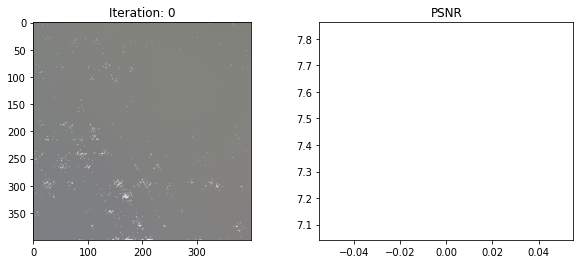

  0%|                                                                | 99/800001 [00:17<18:32:03, 11.99it/s]

[TRAIN] Iter: 100 Loss_fine: 0.051077716052532196 PSNR: 12.917685508728027


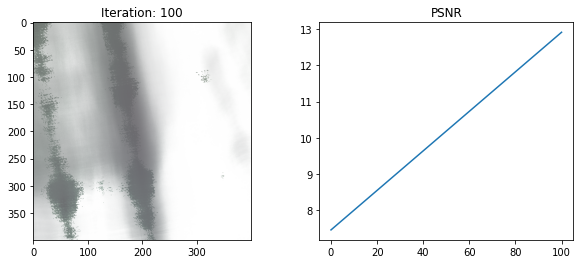

  0%|                                                               | 199/800001 [00:33<18:11:24, 12.21it/s]

[TRAIN] Iter: 200 Loss_fine: 0.021658549085259438 PSNR: 16.643707275390625


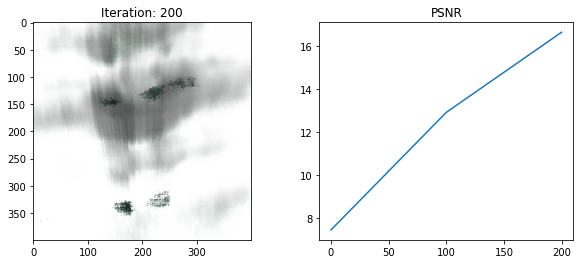

  0%|                                                               | 299/800001 [00:50<18:13:16, 12.19it/s]

[TRAIN] Iter: 300 Loss_fine: 0.026235394179821014 PSNR: 15.811124801635742


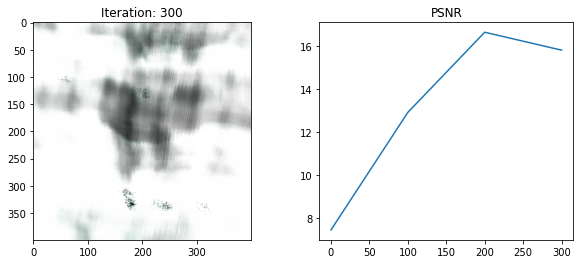

  0%|                                                               | 399/800001 [01:06<18:10:52, 12.22it/s]

[TRAIN] Iter: 400 Loss_fine: 0.023360947147011757 PSNR: 16.315093994140625


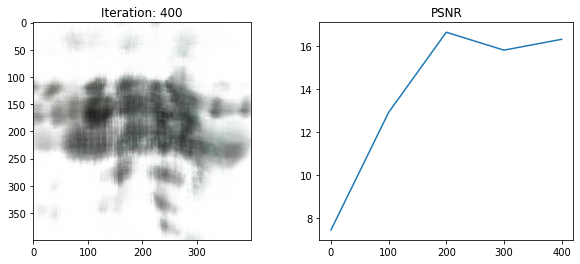

  0%|                                                               | 499/800001 [01:23<18:07:10, 12.26it/s]

[TRAIN] Iter: 500 Loss_fine: 0.032850995659828186 PSNR: 14.834513664245605


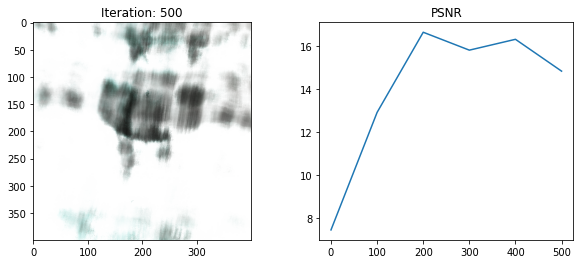

  0%|                                                               | 599/800001 [01:39<18:30:10, 12.00it/s]

[TRAIN] Iter: 600 Loss_fine: 0.005865410901606083 PSNR: 22.3170166015625


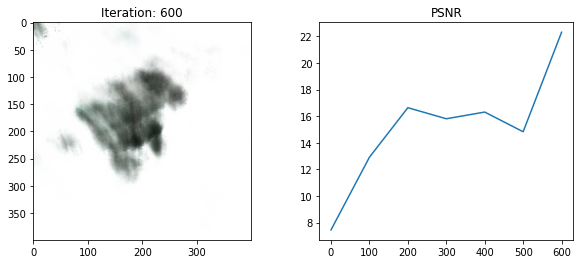

  0%|                                                               | 699/800001 [01:56<18:24:50, 12.06it/s]

[TRAIN] Iter: 700 Loss_fine: 0.004185700789093971 PSNR: 23.782320022583008


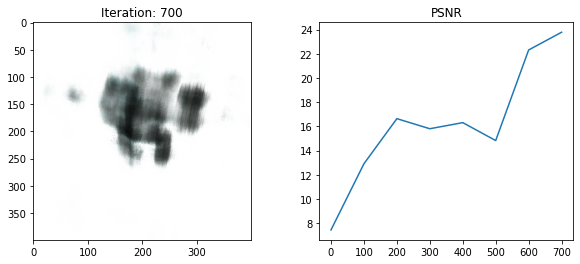

  0%|                                                               | 799/800001 [02:12<18:30:15, 12.00it/s]

[TRAIN] Iter: 800 Loss_fine: 0.004356065299361944 PSNR: 23.60905647277832


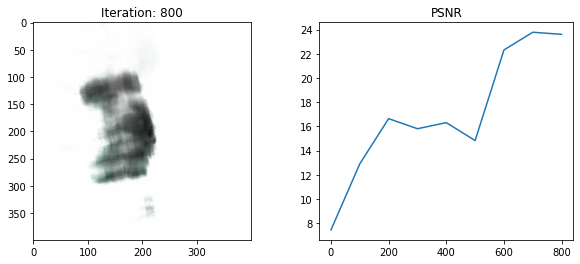

  0%|                                                               | 899/800001 [02:29<18:29:11, 12.01it/s]

[TRAIN] Iter: 900 Loss_fine: 0.004632753320038319 PSNR: 23.34160614013672


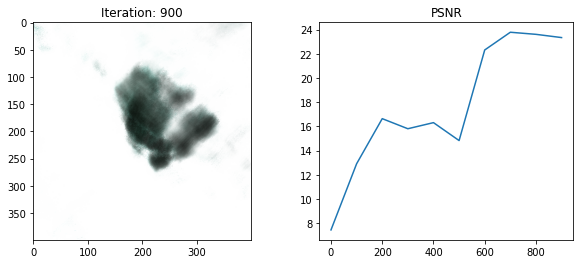

  0%|                                                               | 999/800001 [02:46<18:27:38, 12.02it/s]

[TRAIN] Iter: 1000 Loss_fine: 0.004507915582507849 PSNR: 23.460241317749023


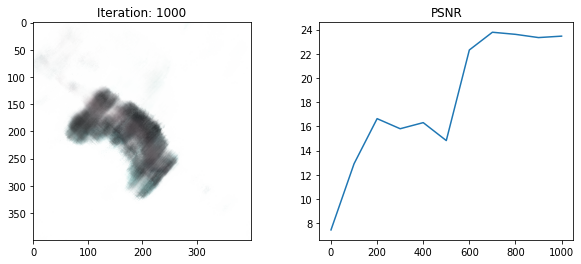

  0%|                                                              | 1099/800001 [03:02<18:22:03, 12.08it/s]

[TRAIN] Iter: 1100 Loss_fine: 0.002949825255200267 PSNR: 25.30203628540039


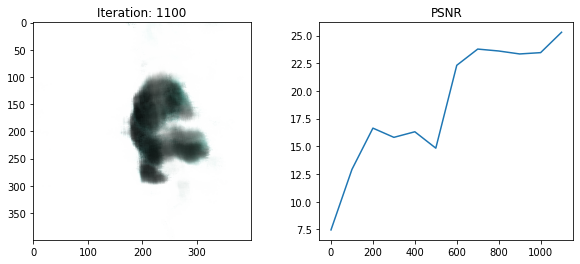

  0%|                                                              | 1199/800001 [03:19<18:29:04, 12.00it/s]

[TRAIN] Iter: 1200 Loss_fine: 0.006609013304114342 PSNR: 21.798633575439453


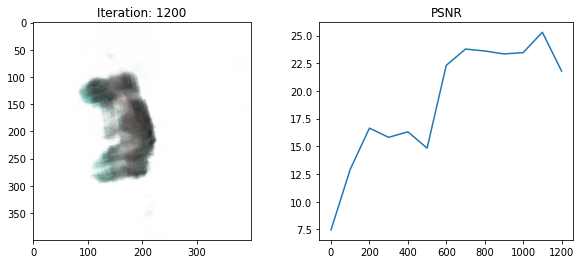

  0%|                                                              | 1299/800001 [03:35<18:27:08, 12.02it/s]

[TRAIN] Iter: 1300 Loss_fine: 0.0031817699782550335 PSNR: 24.973310470581055


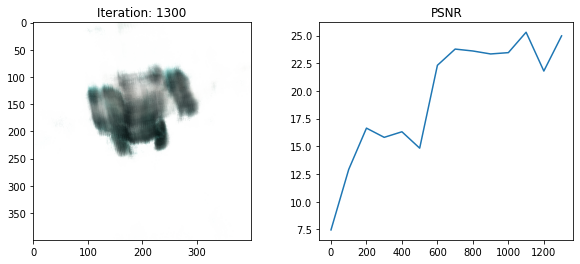

  0%|                                                              | 1399/800001 [03:52<18:26:18, 12.03it/s]

[TRAIN] Iter: 1400 Loss_fine: 0.006631487049162388 PSNR: 21.783891677856445


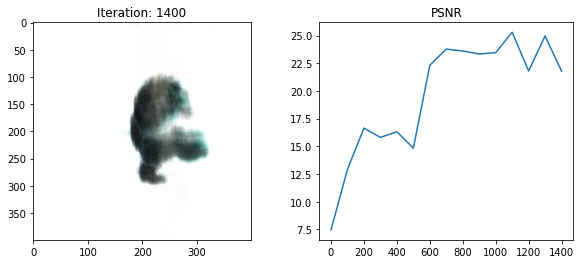

  0%|                                                              | 1499/800001 [04:09<18:28:16, 12.01it/s]

[TRAIN] Iter: 1500 Loss_fine: 0.005224093794822693 PSNR: 22.81989097595215


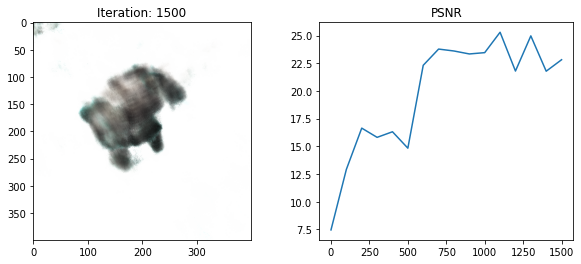

  0%|                                                              | 1599/800001 [04:25<18:29:41, 11.99it/s]

[TRAIN] Iter: 1600 Loss_fine: 0.0028351284563541412 PSNR: 25.474273681640625


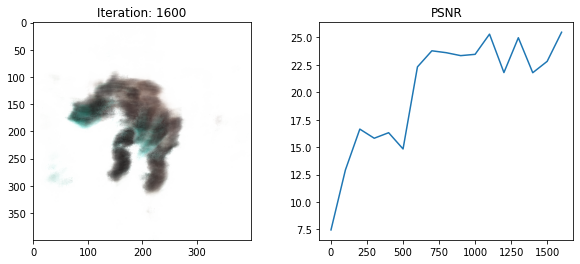

  0%|▏                                                             | 1699/800001 [04:42<18:39:50, 11.88it/s]

[TRAIN] Iter: 1700 Loss_fine: 0.0023608619812875986 PSNR: 26.26929473876953


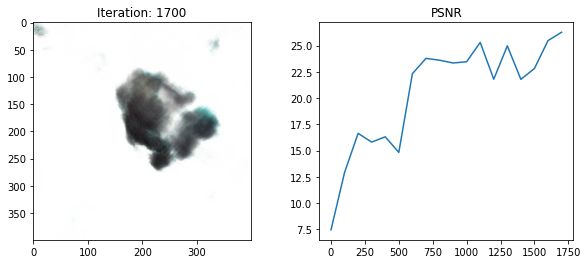

  0%|▏                                                             | 1799/800001 [04:59<18:31:07, 11.97it/s]

[TRAIN] Iter: 1800 Loss_fine: 0.0035124411806464195 PSNR: 24.543909072875977


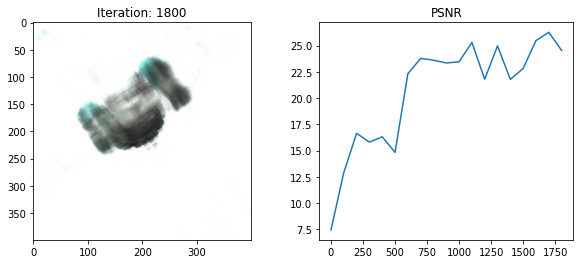

  0%|▏                                                             | 1899/800001 [05:15<18:28:12, 12.00it/s]

[TRAIN] Iter: 1900 Loss_fine: 0.003315843641757965 PSNR: 24.79405975341797


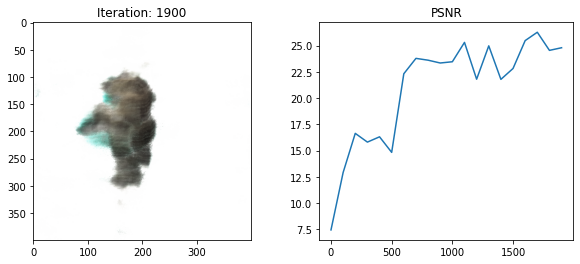

  0%|▏                                                             | 1999/800001 [05:32<18:27:07, 12.01it/s]

[TRAIN] Iter: 2000 Loss_fine: 0.003080072347074747 PSNR: 25.114391326904297


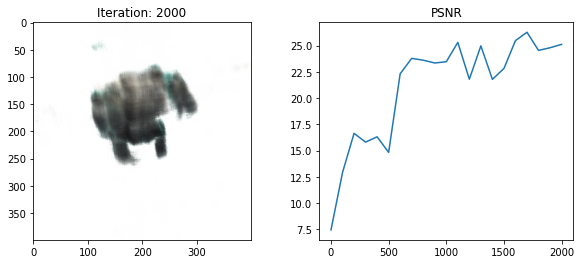

  0%|▏                                                             | 2099/800001 [05:48<18:28:10, 12.00it/s]

[TRAIN] Iter: 2100 Loss_fine: 0.0030639939941465855 PSNR: 25.137121200561523


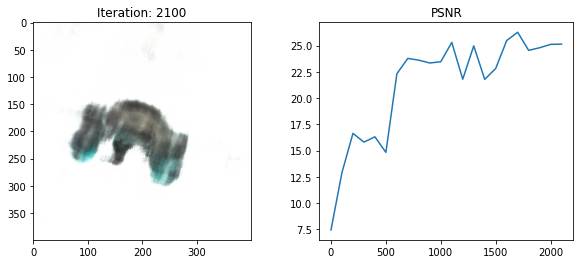

  0%|▏                                                             | 2199/800001 [06:05<18:27:02, 12.01it/s]

[TRAIN] Iter: 2200 Loss_fine: 0.0028819527942687273 PSNR: 25.40312957763672


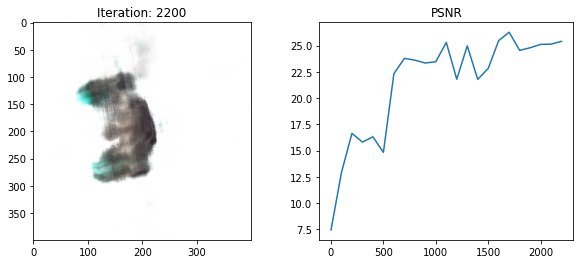

  0%|▏                                                             | 2299/800001 [06:22<18:26:49, 12.01it/s]

[TRAIN] Iter: 2300 Loss_fine: 0.003932556603103876 PSNR: 24.05324935913086


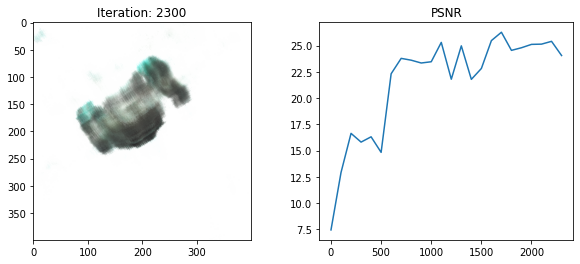

  0%|▏                                                             | 2399/800001 [06:38<18:21:51, 12.06it/s]

[TRAIN] Iter: 2400 Loss_fine: 0.003046978497877717 PSNR: 25.161306381225586


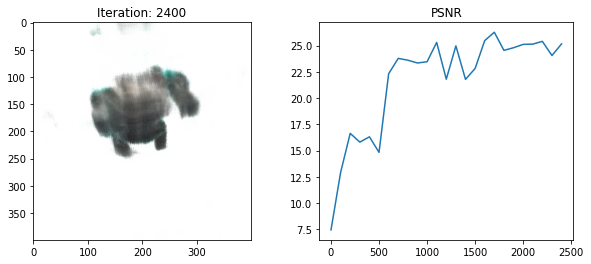

  0%|▏                                                             | 2499/800001 [06:55<18:31:53, 11.95it/s]

[TRAIN] Iter: 2500 Loss_fine: 0.0024783145636320114 PSNR: 26.058433532714844


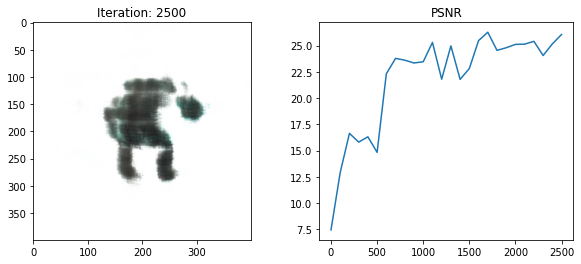

  0%|▏                                                             | 2599/800001 [07:11<18:27:31, 12.00it/s]

[TRAIN] Iter: 2600 Loss_fine: 0.005192138254642487 PSNR: 22.84653663635254


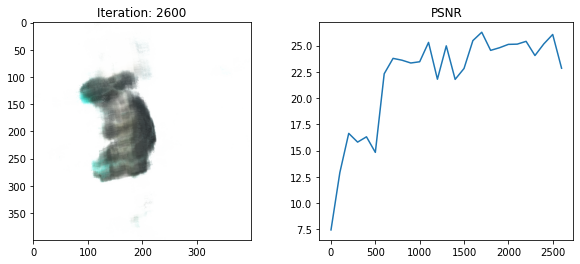

  0%|▏                                                             | 2699/800001 [07:28<18:24:33, 12.03it/s]

[TRAIN] Iter: 2700 Loss_fine: 0.005055450834333897 PSNR: 22.962400436401367


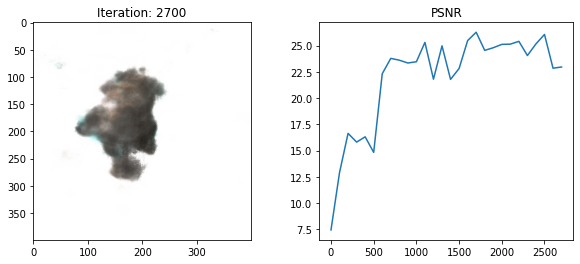

  0%|▏                                                             | 2799/800001 [07:45<18:32:39, 11.94it/s]

[TRAIN] Iter: 2800 Loss_fine: 0.0022210655733942986 PSNR: 26.534385681152344


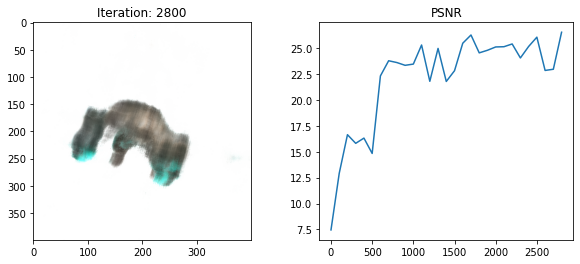

  0%|▏                                                             | 2899/800001 [08:01<18:28:54, 11.98it/s]

[TRAIN] Iter: 2900 Loss_fine: 0.004510294646024704 PSNR: 23.45795249938965


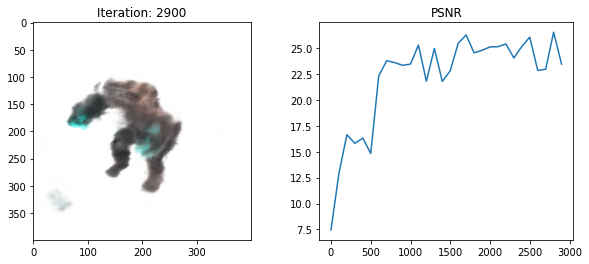

  0%|▏                                                             | 2999/800001 [08:18<18:26:36, 12.00it/s]

[TRAIN] Iter: 3000 Loss_fine: 0.002906444948166609 PSNR: 25.366378784179688


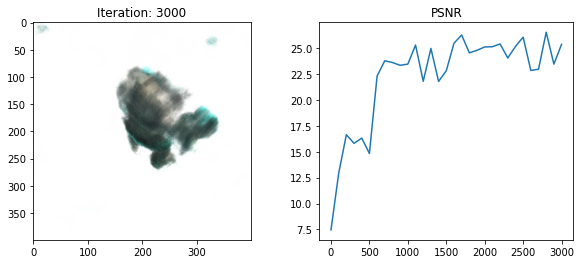

  0%|▏                                                             | 3099/800001 [08:35<18:27:18, 11.99it/s]

[TRAIN] Iter: 3100 Loss_fine: 0.002398548647761345 PSNR: 26.200511932373047


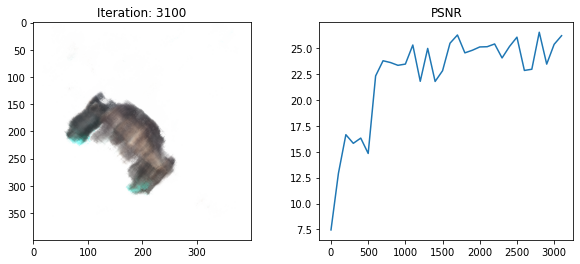

  0%|▏                                                             | 3199/800001 [08:51<18:23:27, 12.03it/s]

[TRAIN] Iter: 3200 Loss_fine: 0.0032647005282342434 PSNR: 24.8615665435791


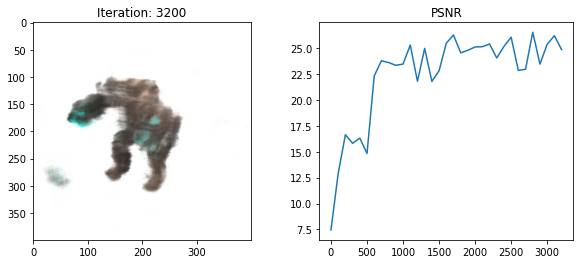

  0%|▎                                                             | 3299/800001 [09:08<18:27:52, 11.99it/s]

[TRAIN] Iter: 3300 Loss_fine: 0.003278994932770729 PSNR: 24.842592239379883


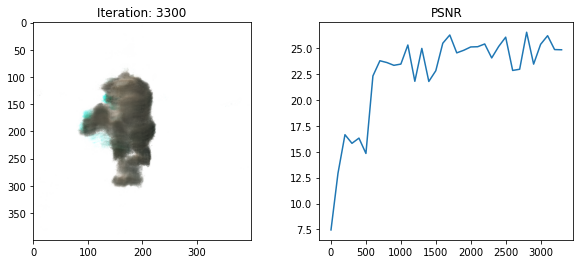

  0%|▎                                                             | 3399/800001 [09:24<18:24:26, 12.02it/s]

[TRAIN] Iter: 3400 Loss_fine: 0.005355189088732004 PSNR: 22.712249755859375


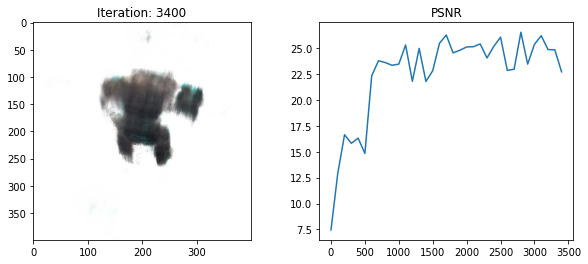

  0%|▎                                                             | 3499/800001 [09:41<18:24:45, 12.02it/s]

[TRAIN] Iter: 3500 Loss_fine: 0.005282026249915361 PSNR: 22.77199363708496


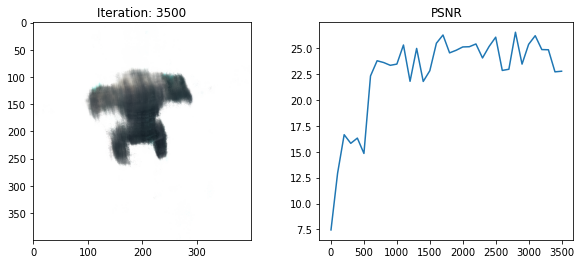

  0%|▎                                                             | 3599/800001 [09:58<19:28:47, 11.36it/s]

[TRAIN] Iter: 3600 Loss_fine: 0.004726775456219912 PSNR: 23.254350662231445


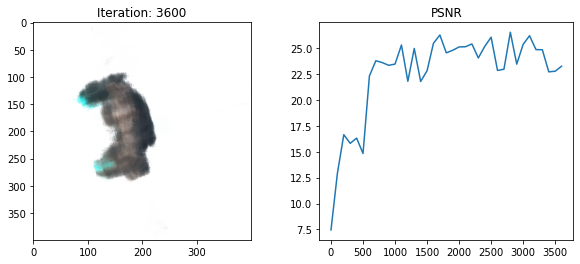

  0%|▎                                                             | 3699/800001 [10:15<18:24:09, 12.02it/s]

[TRAIN] Iter: 3700 Loss_fine: 0.0028386057820171118 PSNR: 25.468950271606445


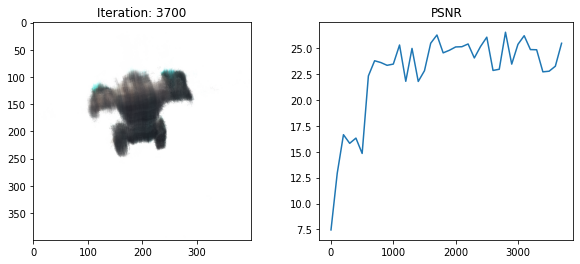

  0%|▎                                                             | 3799/800001 [10:31<18:25:46, 12.00it/s]

[TRAIN] Iter: 3800 Loss_fine: 0.0038245944306254387 PSNR: 24.17414665222168


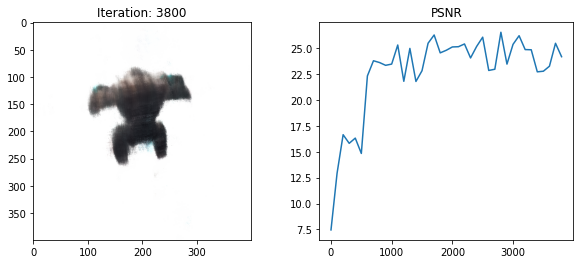

  0%|▎                                                             | 3899/800001 [10:48<18:24:47, 12.01it/s]

[TRAIN] Iter: 3900 Loss_fine: 0.0037519766483455896 PSNR: 24.25739860534668


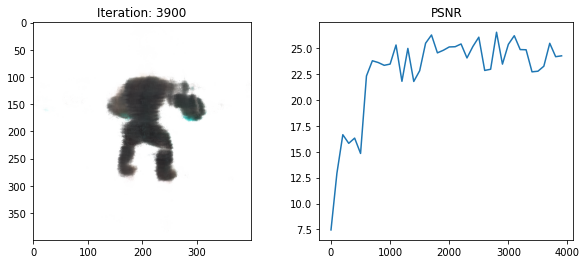

  0%|▎                                                             | 3999/800001 [11:05<18:46:08, 11.78it/s]

[TRAIN] Iter: 4000 Loss_fine: 0.00418769009411335 PSNR: 23.78025245666504


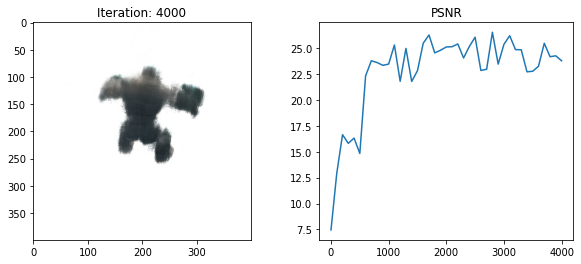

  1%|▎                                                             | 4099/800001 [11:22<18:25:00, 12.00it/s]

[TRAIN] Iter: 4100 Loss_fine: 0.0039459289982914925 PSNR: 24.03850746154785


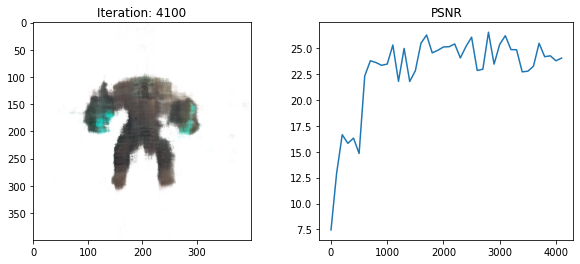

  1%|▎                                                             | 4199/800001 [11:38<18:17:22, 12.09it/s]

[TRAIN] Iter: 4200 Loss_fine: 0.0029374631121754646 PSNR: 25.320274353027344


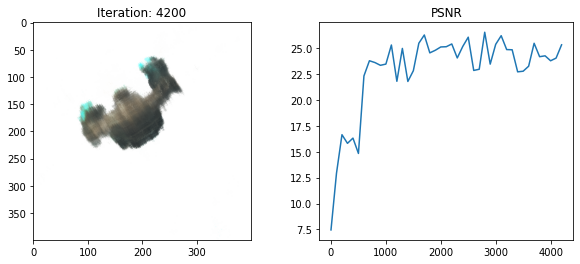

  1%|▎                                                             | 4299/800001 [11:55<18:24:26, 12.01it/s]

[TRAIN] Iter: 4300 Loss_fine: 0.00542959151789546 PSNR: 22.652328491210938


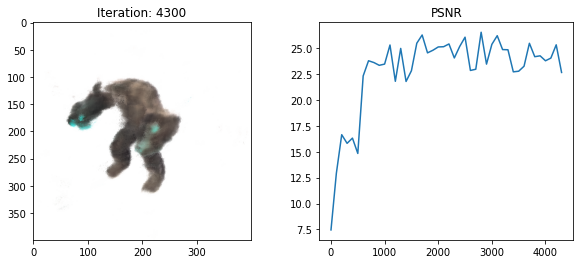

  1%|▎                                                             | 4399/800001 [12:12<19:23:25, 11.40it/s]

[TRAIN] Iter: 4400 Loss_fine: 0.0028501662891358137 PSNR: 25.451297760009766


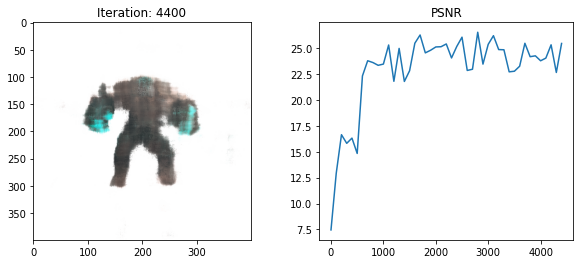

  1%|▎                                                             | 4499/800001 [12:28<18:03:58, 12.23it/s]

[TRAIN] Iter: 4500 Loss_fine: 0.006162097677588463 PSNR: 22.102712631225586


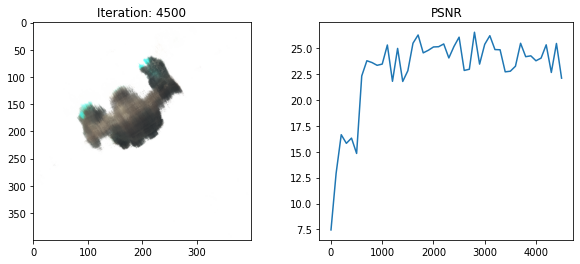

  1%|▎                                                             | 4599/800001 [12:45<19:43:09, 11.20it/s]

[TRAIN] Iter: 4600 Loss_fine: 0.0021921726875007153 PSNR: 26.59125328063965


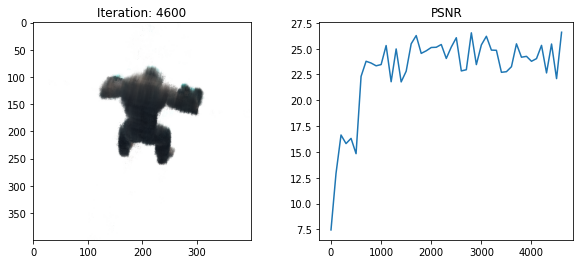

  1%|▎                                                             | 4699/800001 [13:02<18:29:07, 11.95it/s]

[TRAIN] Iter: 4700 Loss_fine: 0.0028354974929243326 PSNR: 25.473705291748047


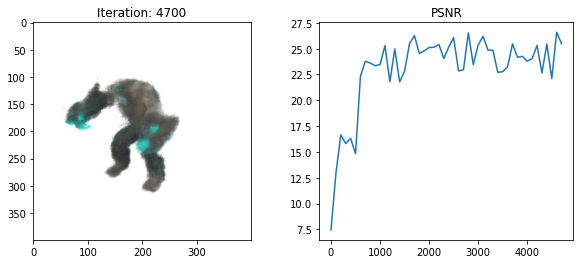

  1%|▎                                                             | 4799/800001 [13:20<19:23:22, 11.39it/s]

[TRAIN] Iter: 4800 Loss_fine: 0.0017292988486588001 PSNR: 27.62129783630371


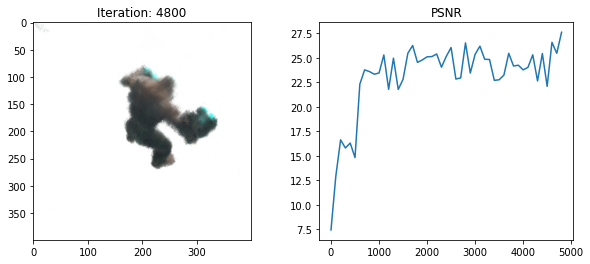

  1%|▍                                                             | 4899/800001 [13:37<19:31:06, 11.32it/s]

[TRAIN] Iter: 4900 Loss_fine: 0.0019883711356669664 PSNR: 27.015026092529297


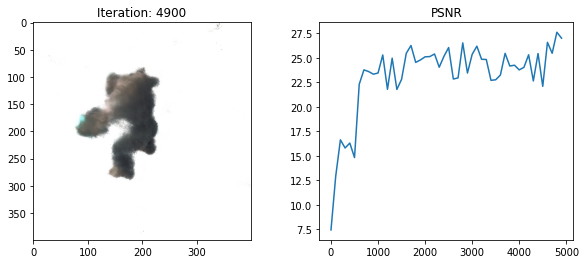

  1%|▍                                                             | 4999/800001 [13:55<19:24:38, 11.38it/s]

[TRAIN] Iter: 5000 Loss_fine: 0.004593468736857176 PSNR: 23.37859344482422


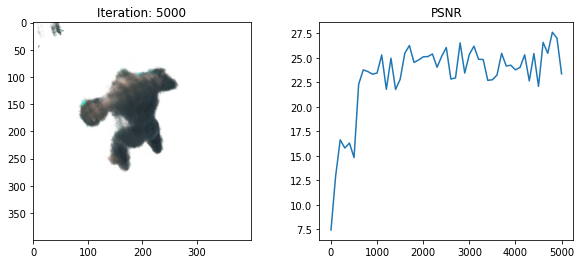

  1%|▍                                                             | 5099/800001 [14:13<19:41:19, 11.21it/s]

[TRAIN] Iter: 5100 Loss_fine: 0.004576136823743582 PSNR: 23.395008087158203


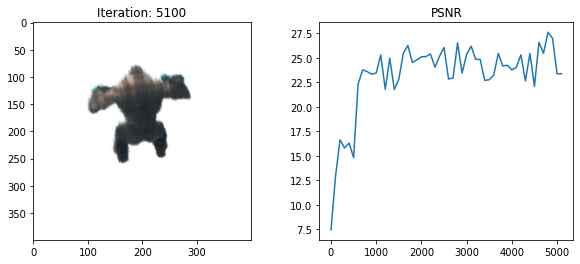

  1%|▍                                                             | 5199/800001 [14:30<19:22:02, 11.40it/s]

[TRAIN] Iter: 5200 Loss_fine: 0.00364200328476727 PSNR: 24.3865966796875


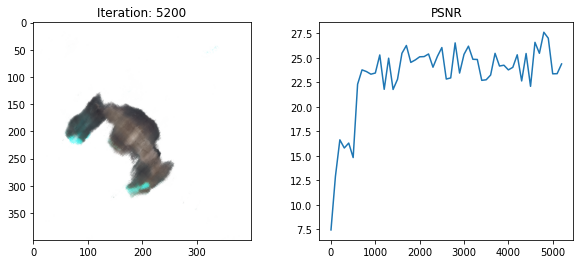

  1%|▍                                                             | 5299/800001 [14:48<19:21:29, 11.40it/s]

[TRAIN] Iter: 5300 Loss_fine: 0.0013195197097957134 PSNR: 28.795839309692383


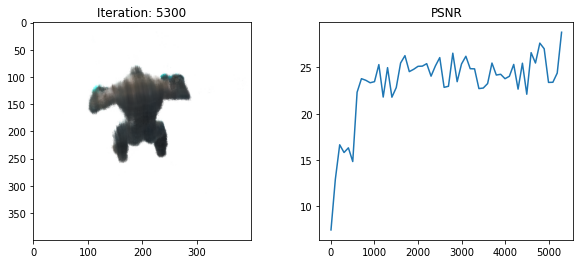

  1%|▍                                                             | 5399/800001 [15:06<19:24:11, 11.38it/s]

[TRAIN] Iter: 5400 Loss_fine: 0.0034272740595042706 PSNR: 24.6505126953125


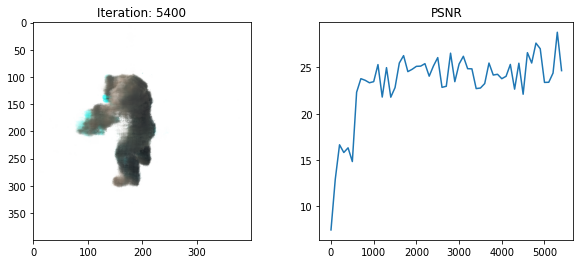

  1%|▍                                                             | 5499/800001 [15:23<19:22:06, 11.39it/s]

[TRAIN] Iter: 5500 Loss_fine: 0.004400843754410744 PSNR: 23.564640045166016


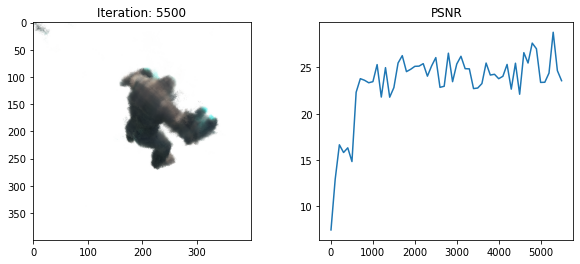

  1%|▍                                                             | 5599/800001 [15:41<19:34:02, 11.28it/s]

[TRAIN] Iter: 5600 Loss_fine: 0.0021431392524391413 PSNR: 26.689495086669922


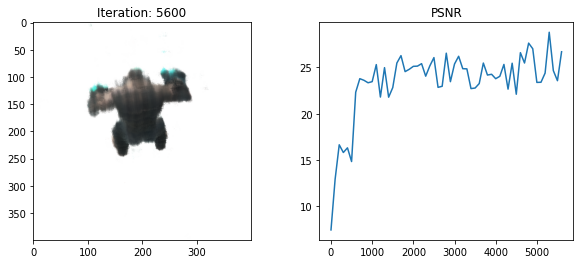

  1%|▍                                                             | 5699/800001 [15:59<19:39:45, 11.22it/s]

[TRAIN] Iter: 5700 Loss_fine: 0.002295231446623802 PSNR: 26.391735076904297


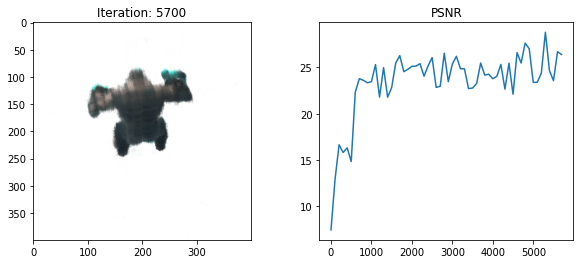

  1%|▍                                                             | 5799/800001 [16:16<19:37:48, 11.24it/s]

[TRAIN] Iter: 5800 Loss_fine: 0.0043650539591908455 PSNR: 23.6001033782959


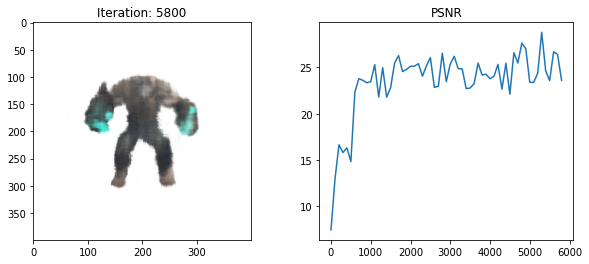

  1%|▍                                                             | 5899/800001 [16:34<19:38:28, 11.23it/s]

[TRAIN] Iter: 5900 Loss_fine: 0.0057307216338813305 PSNR: 22.41790771484375


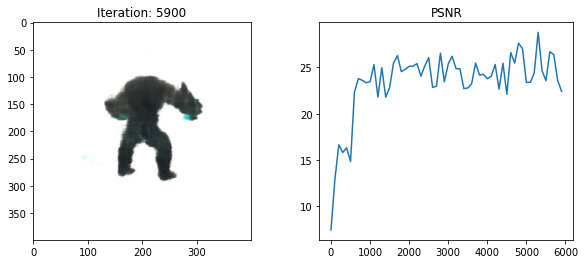

  1%|▍                                                             | 5999/800001 [16:51<18:06:58, 12.17it/s]

[TRAIN] Iter: 6000 Loss_fine: 0.0031548454426229 PSNR: 25.01021957397461


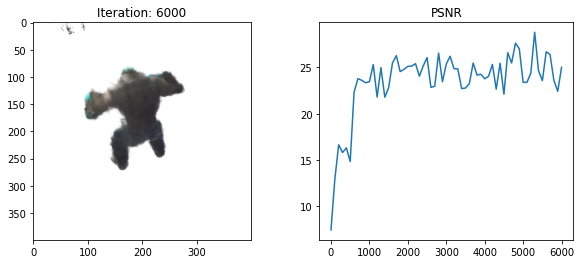

  1%|▍                                                             | 6099/800001 [17:08<19:37:33, 11.24it/s]

[TRAIN] Iter: 6100 Loss_fine: 0.006113247014582157 PSNR: 22.13728141784668


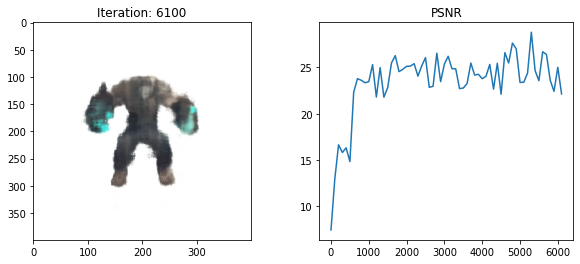

  1%|▍                                                             | 6199/800001 [17:26<19:23:58, 11.37it/s]

[TRAIN] Iter: 6200 Loss_fine: 0.0022183938417583704 PSNR: 26.539613723754883


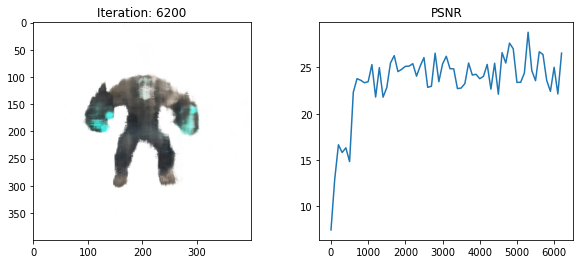

  1%|▍                                                             | 6299/800001 [17:44<19:19:30, 11.41it/s]

[TRAIN] Iter: 6300 Loss_fine: 0.004025437403470278 PSNR: 23.95186996459961


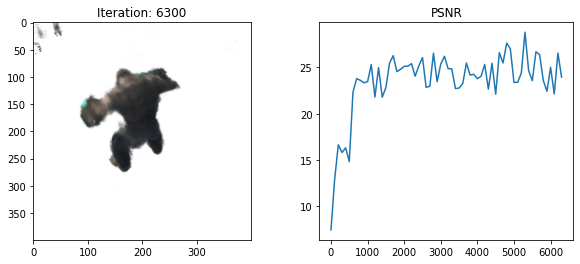

  1%|▍                                                             | 6399/800001 [18:01<19:23:43, 11.37it/s]

[TRAIN] Iter: 6400 Loss_fine: 0.0017912584589794278 PSNR: 27.468416213989258


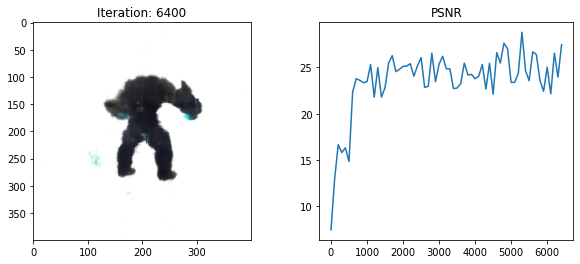

  1%|▌                                                             | 6499/800001 [18:19<19:23:21, 11.37it/s]

[TRAIN] Iter: 6500 Loss_fine: 0.002032836200669408 PSNR: 26.918973922729492


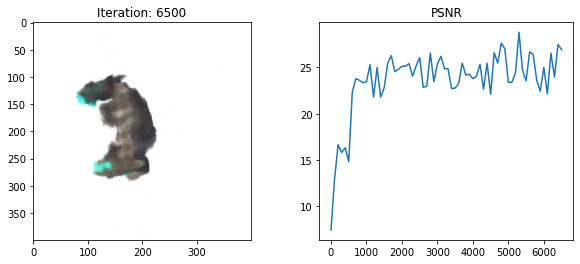

  1%|▌                                                             | 6599/800001 [18:36<19:20:37, 11.39it/s]

[TRAIN] Iter: 6600 Loss_fine: 0.0015051952796056867 PSNR: 28.224071502685547


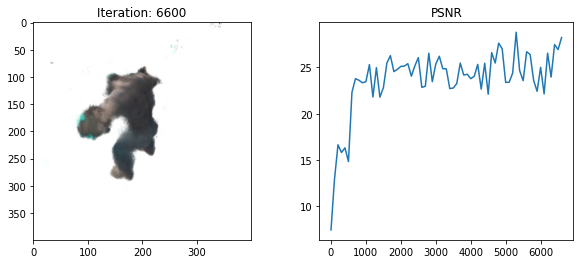

  1%|▌                                                             | 6699/800001 [18:54<20:08:17, 10.94it/s]

[TRAIN] Iter: 6700 Loss_fine: 0.005019806325435638 PSNR: 22.993131637573242


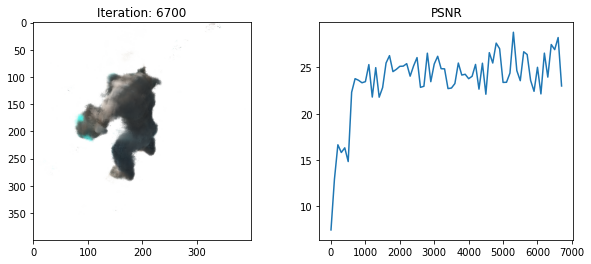

  1%|▌                                                             | 6799/800001 [19:12<19:21:49, 11.38it/s]

[TRAIN] Iter: 6800 Loss_fine: 0.0045346468687057495 PSNR: 23.4345645904541


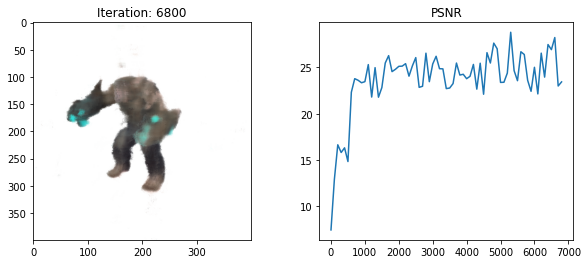

  1%|▌                                                             | 6899/800001 [19:29<19:13:36, 11.46it/s]

[TRAIN] Iter: 6900 Loss_fine: 0.003838823176920414 PSNR: 24.15802001953125


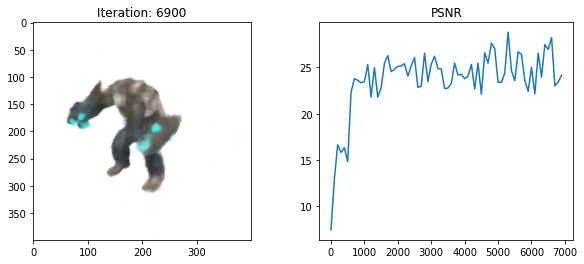

  1%|▌                                                             | 6999/800001 [19:47<19:57:49, 11.03it/s]

[TRAIN] Iter: 7000 Loss_fine: 0.0025914853904396296 PSNR: 25.864511489868164


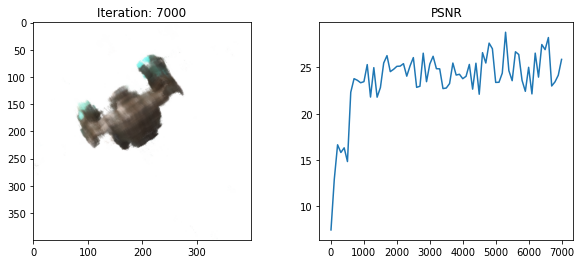

  1%|▌                                                             | 7099/800001 [20:05<20:02:27, 10.99it/s]

[TRAIN] Iter: 7100 Loss_fine: 0.0019631735049188137 PSNR: 27.070411682128906


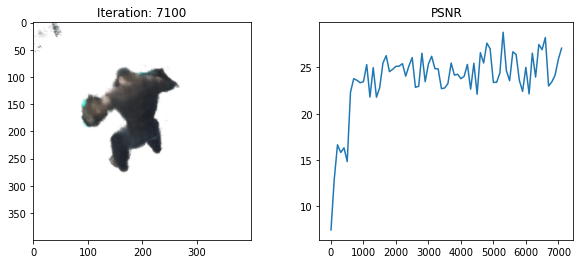

  1%|▌                                                             | 7199/800001 [20:22<19:11:05, 11.48it/s]

[TRAIN] Iter: 7200 Loss_fine: 0.0025312048383057117 PSNR: 25.966726303100586


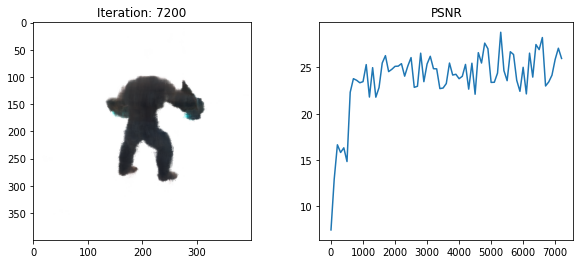

  1%|▌                                                             | 7299/800001 [20:40<19:56:58, 11.04it/s]

[TRAIN] Iter: 7300 Loss_fine: 0.0014400355285033584 PSNR: 28.416269302368164


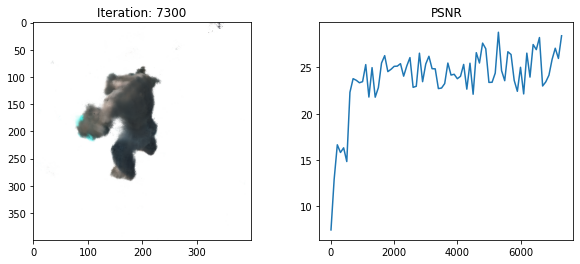

  1%|▌                                                             | 7399/800001 [20:57<20:08:40, 10.93it/s]

[TRAIN] Iter: 7400 Loss_fine: 0.0045068468898534775 PSNR: 23.461271286010742


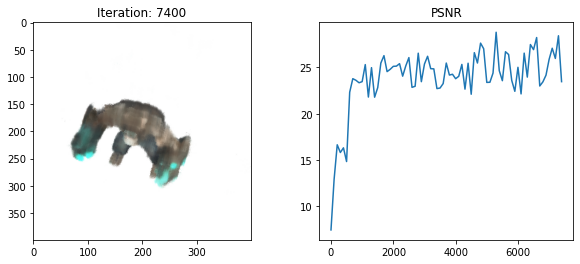

  1%|▌                                                             | 7499/800001 [21:13<18:05:11, 12.17it/s]

[TRAIN] Iter: 7500 Loss_fine: 0.0017667713109403849 PSNR: 27.528196334838867


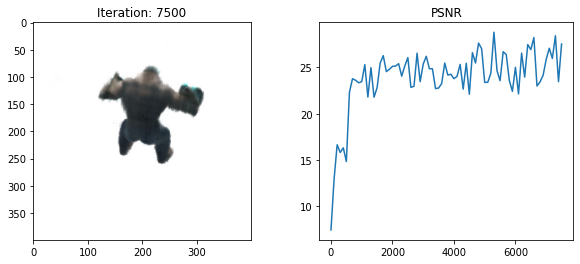

  1%|▌                                                             | 7599/800001 [21:31<19:52:46, 11.07it/s]

[TRAIN] Iter: 7600 Loss_fine: 0.0015912294620648026 PSNR: 27.982669830322266


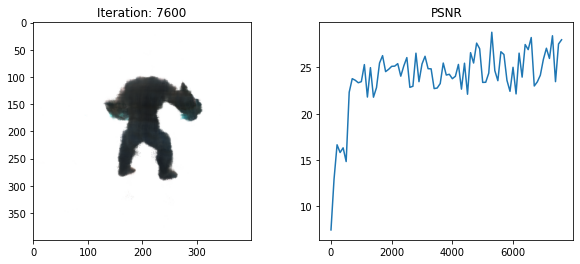

  1%|▌                                                             | 7699/800001 [21:48<18:20:05, 12.00it/s]

[TRAIN] Iter: 7700 Loss_fine: 0.0020522007253021 PSNR: 26.8778018951416


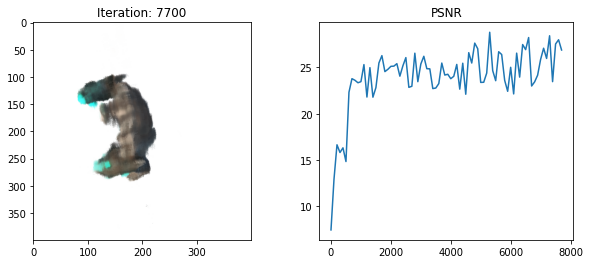

  1%|▌                                                             | 7799/800001 [22:04<18:19:56, 12.00it/s]

[TRAIN] Iter: 7800 Loss_fine: 0.004464384168386459 PSNR: 23.502384185791016


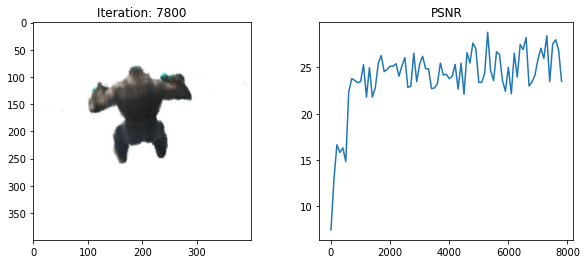

  1%|▌                                                             | 7899/800001 [22:21<18:20:22, 12.00it/s]

[TRAIN] Iter: 7900 Loss_fine: 0.0026045108679682016 PSNR: 25.842737197875977


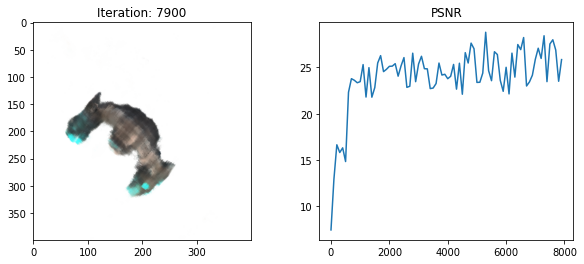

  1%|▌                                                             | 7999/800001 [22:37<18:22:26, 11.97it/s]

[TRAIN] Iter: 8000 Loss_fine: 0.0022624346893280745 PSNR: 26.454240798950195


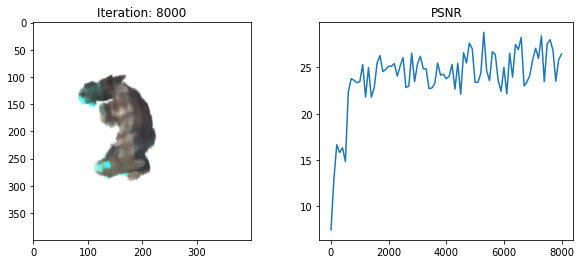

  1%|▋                                                             | 8099/800001 [22:54<18:20:32, 11.99it/s]

[TRAIN] Iter: 8100 Loss_fine: 0.0026602454017847776 PSNR: 25.750782012939453


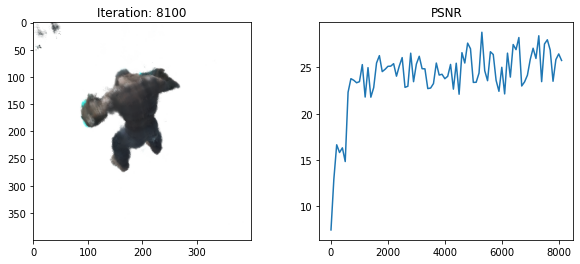

  1%|▋                                                             | 8199/800001 [23:11<18:20:22, 11.99it/s]

[TRAIN] Iter: 8200 Loss_fine: 0.004252997227013111 PSNR: 23.71304702758789


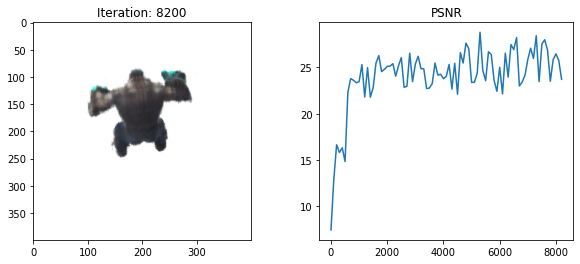

  1%|▋                                                             | 8299/800001 [23:27<18:39:33, 11.79it/s]

[TRAIN] Iter: 8300 Loss_fine: 0.003909579943865538 PSNR: 24.078699111938477


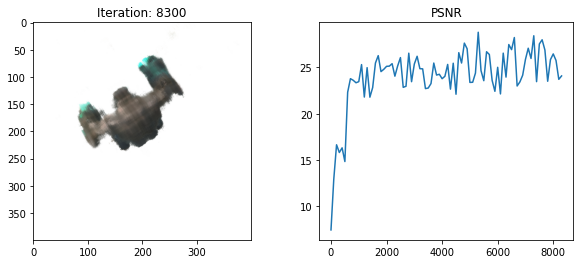

  1%|▋                                                             | 8399/800001 [23:44<18:21:03, 11.98it/s]

[TRAIN] Iter: 8400 Loss_fine: 0.003619729308411479 PSNR: 24.413238525390625


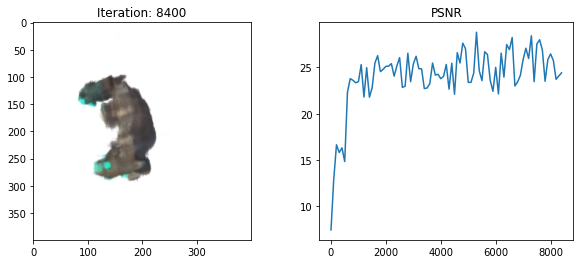

  1%|▋                                                             | 8499/800001 [24:00<18:16:23, 12.03it/s]

[TRAIN] Iter: 8500 Loss_fine: 0.00201803888194263 PSNR: 26.95070457458496


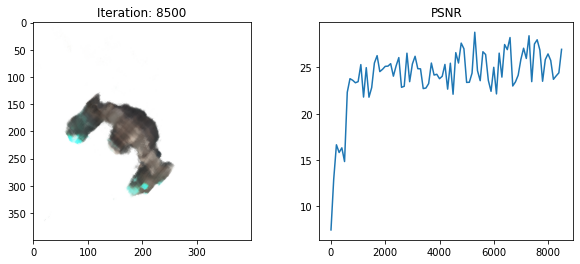

  1%|▋                                                             | 8599/800001 [24:18<18:16:06, 12.03it/s]

[TRAIN] Iter: 8600 Loss_fine: 0.001233763643540442 PSNR: 29.08768081665039


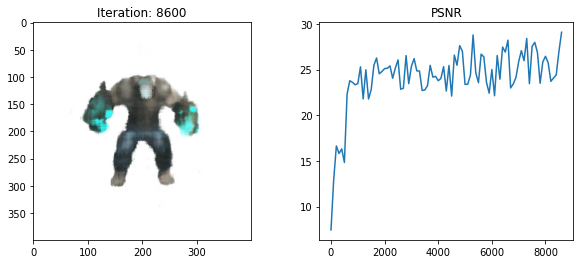

  1%|▋                                                             | 8699/800001 [24:34<18:16:12, 12.03it/s]

[TRAIN] Iter: 8700 Loss_fine: 0.0028889006935060024 PSNR: 25.392671585083008


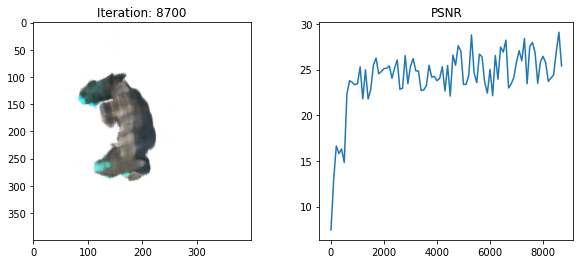

  1%|▋                                                             | 8799/800001 [24:51<18:18:40, 12.00it/s]

[TRAIN] Iter: 8800 Loss_fine: 0.003933117259293795 PSNR: 24.052629470825195


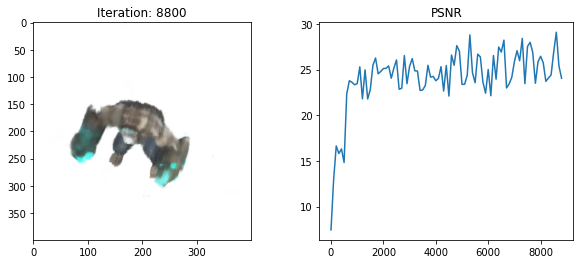

  1%|▋                                                             | 8899/800001 [25:08<18:20:49, 11.98it/s]

[TRAIN] Iter: 8900 Loss_fine: 0.0027911358047276735 PSNR: 25.54218864440918


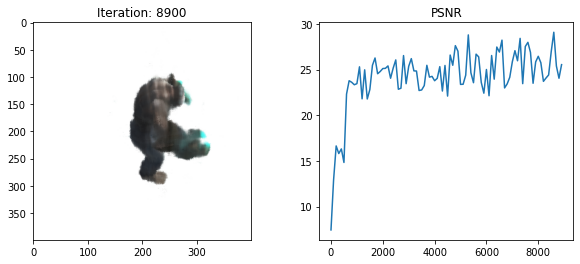

  1%|▋                                                             | 8999/800001 [25:24<18:15:33, 12.03it/s]

[TRAIN] Iter: 9000 Loss_fine: 0.0025750345084816217 PSNR: 25.892168045043945


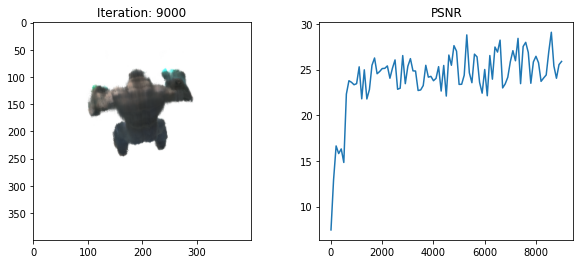

  1%|▋                                                             | 9099/800001 [25:41<18:18:25, 12.00it/s]

[TRAIN] Iter: 9100 Loss_fine: 0.0013838763115927577 PSNR: 28.589025497436523


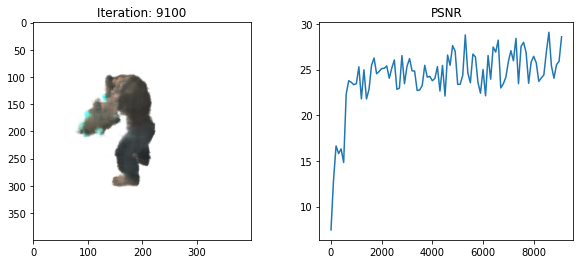

  1%|▋                                                             | 9199/800001 [25:57<18:17:20, 12.01it/s]

[TRAIN] Iter: 9200 Loss_fine: 0.002301806351169944 PSNR: 26.379310607910156


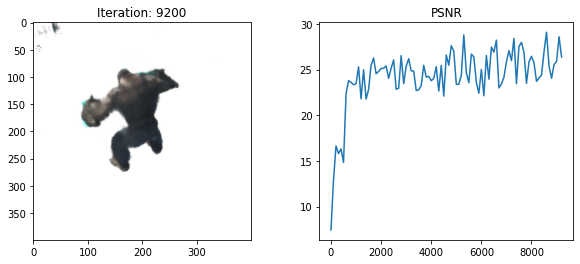

  1%|▋                                                             | 9299/800001 [26:14<18:20:14, 11.98it/s]

[TRAIN] Iter: 9300 Loss_fine: 0.0024320194497704506 PSNR: 26.140329360961914


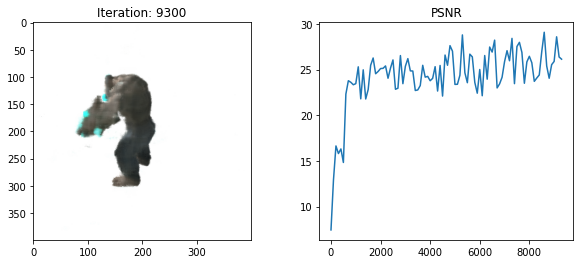

  1%|▋                                                             | 9399/800001 [26:31<18:17:56, 12.00it/s]

[TRAIN] Iter: 9400 Loss_fine: 0.0017406214028596878 PSNR: 27.59295654296875


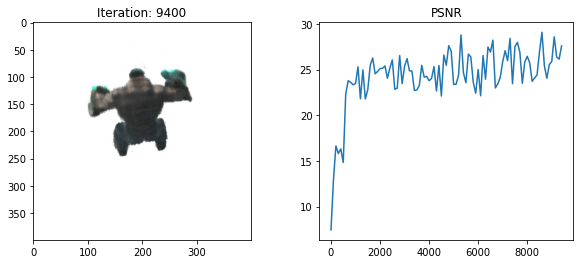

  1%|▋                                                             | 9499/800001 [26:47<18:16:03, 12.02it/s]

[TRAIN] Iter: 9500 Loss_fine: 0.0011095210211351514 PSNR: 29.54864501953125


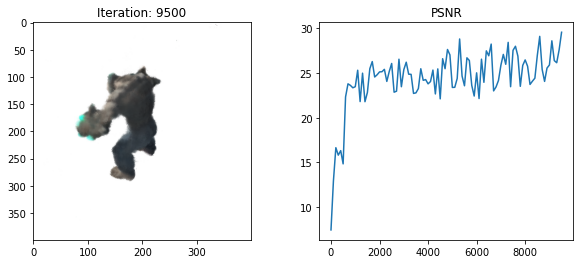

  1%|▋                                                             | 9599/800001 [27:04<18:13:23, 12.05it/s]

[TRAIN] Iter: 9600 Loss_fine: 0.0026187242474406958 PSNR: 25.819101333618164


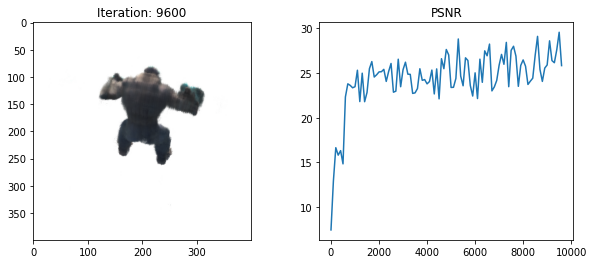

  1%|▊                                                             | 9699/800001 [27:20<18:15:24, 12.02it/s]

[TRAIN] Iter: 9700 Loss_fine: 0.004204313270747662 PSNR: 23.763050079345703


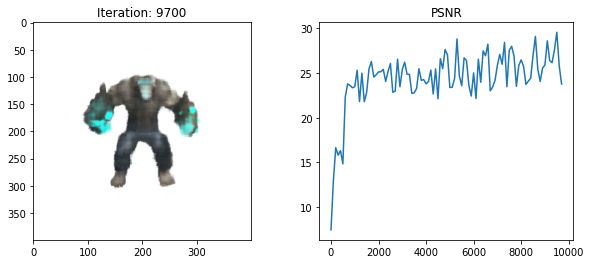

  1%|▊                                                             | 9799/800001 [27:37<18:18:38, 11.99it/s]

[TRAIN] Iter: 9800 Loss_fine: 0.002363497158512473 PSNR: 26.264450073242188


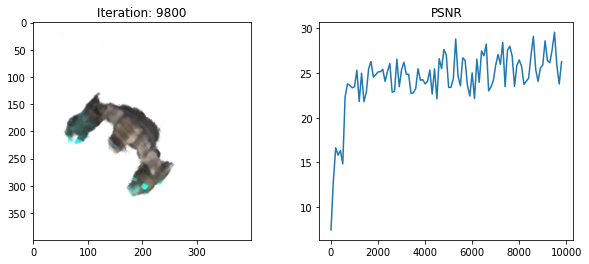

  1%|▊                                                             | 9899/800001 [27:54<18:16:06, 12.01it/s]

[TRAIN] Iter: 9900 Loss_fine: 0.00289179221726954 PSNR: 25.388328552246094


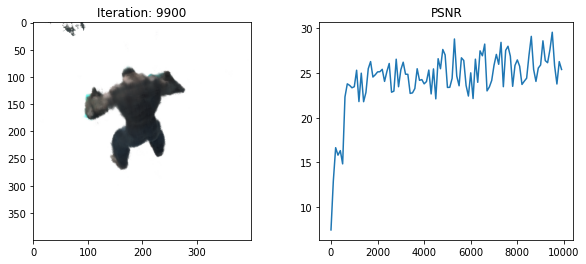

  1%|▊                                                             | 9999/800001 [28:10<18:15:11, 12.02it/s]

[TRAIN] Iter: 10000 Loss_fine: 0.0019134358735755086 PSNR: 27.181859970092773


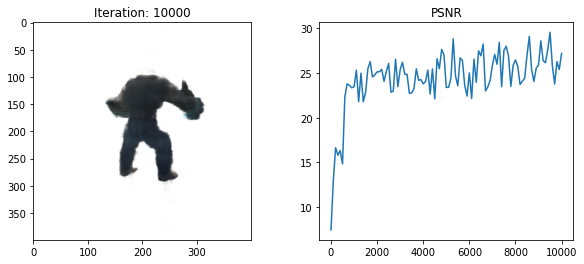

  1%|▊                                                            | 10099/800001 [28:27<18:15:16, 12.02it/s]

[TRAIN] Iter: 10100 Loss_fine: 0.0024321426171809435 PSNR: 26.14011001586914


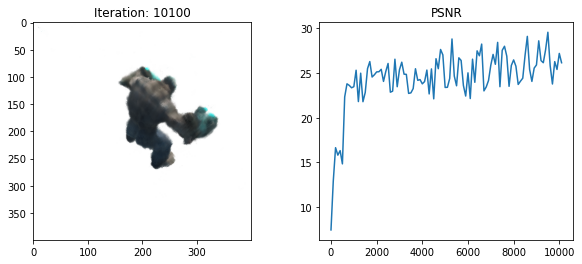

  1%|▊                                                            | 10199/800001 [28:44<18:18:28, 11.98it/s]

[TRAIN] Iter: 10200 Loss_fine: 0.0008279496687464416 PSNR: 30.819961547851562


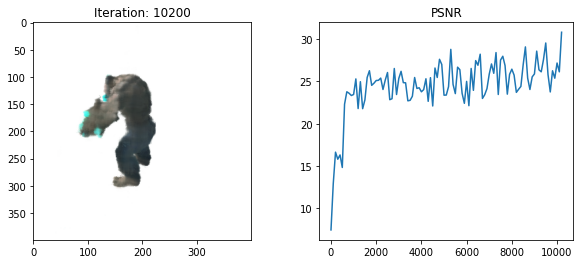

  1%|▊                                                            | 10299/800001 [29:00<18:16:15, 12.01it/s]

[TRAIN] Iter: 10300 Loss_fine: 0.0017350303241983056 PSNR: 27.606929779052734


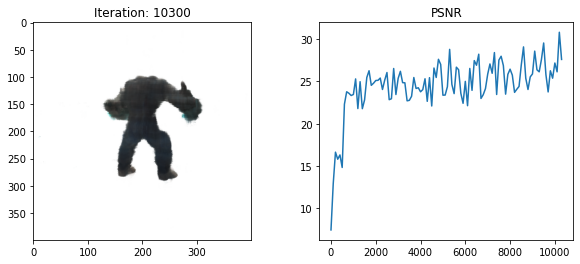

  1%|▊                                                            | 10399/800001 [29:17<18:11:00, 12.06it/s]

[TRAIN] Iter: 10400 Loss_fine: 0.0013197259977459908 PSNR: 28.795162200927734


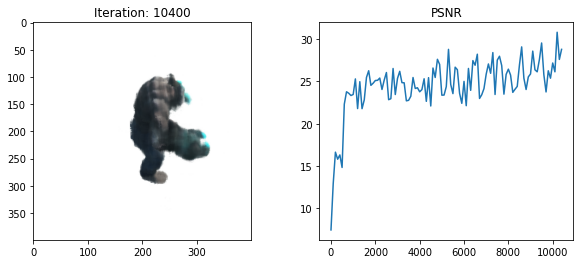

  1%|▊                                                            | 10499/800001 [29:33<18:13:32, 12.03it/s]

[TRAIN] Iter: 10500 Loss_fine: 0.0025432929396629333 PSNR: 25.94603729248047


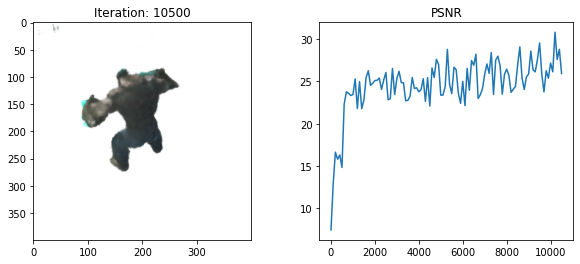

  1%|▊                                                            | 10599/800001 [29:50<18:28:06, 11.87it/s]

[TRAIN] Iter: 10600 Loss_fine: 0.0031796591356396675 PSNR: 24.976192474365234


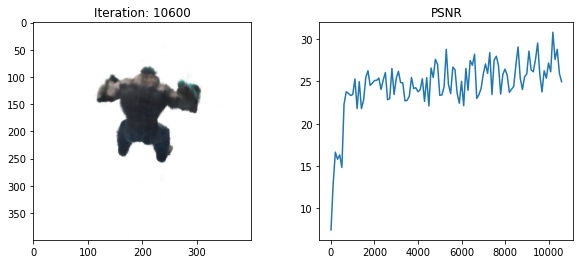

  1%|▊                                                            | 10699/800001 [30:07<18:16:15, 12.00it/s]

[TRAIN] Iter: 10700 Loss_fine: 0.0019690818153321743 PSNR: 27.057361602783203


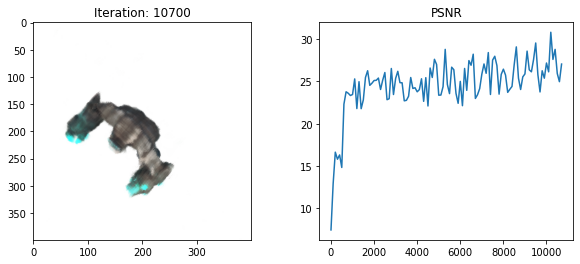

  1%|▊                                                            | 10799/800001 [30:23<18:15:26, 12.01it/s]

[TRAIN] Iter: 10800 Loss_fine: 0.0016591394087299705 PSNR: 27.801172256469727


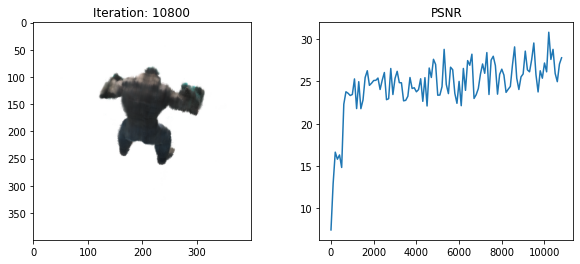

  1%|▊                                                            | 10899/800001 [30:40<18:11:11, 12.05it/s]

[TRAIN] Iter: 10900 Loss_fine: 0.0015367327723652124 PSNR: 28.134016036987305


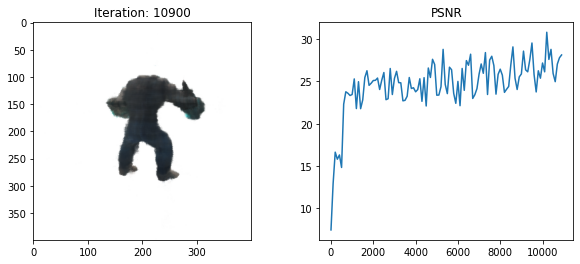

  1%|▊                                                            | 10999/800001 [30:56<18:12:15, 12.04it/s]

[TRAIN] Iter: 11000 Loss_fine: 0.0015591410920023918 PSNR: 28.071144104003906


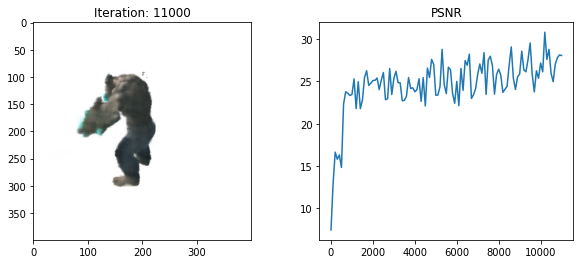

  1%|▊                                                            | 11099/800001 [31:13<18:14:44, 12.01it/s]

[TRAIN] Iter: 11100 Loss_fine: 0.0008087345049716532 PSNR: 30.92194175720215


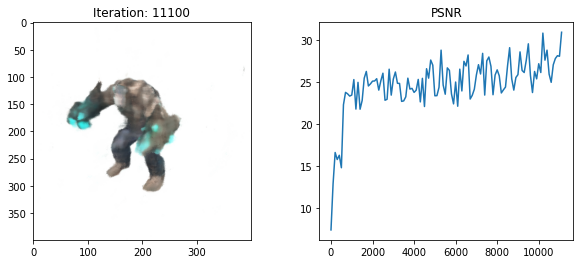

  1%|▊                                                            | 11199/800001 [31:30<18:11:02, 12.05it/s]

[TRAIN] Iter: 11200 Loss_fine: 0.00027203562785871327 PSNR: 35.653743743896484


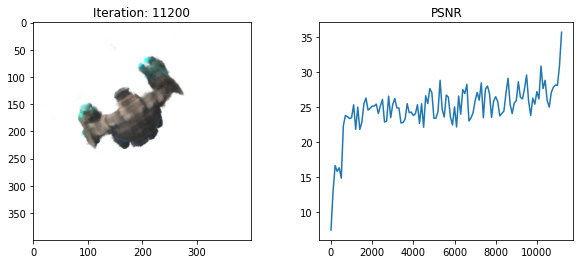

  1%|▊                                                            | 11299/800001 [31:46<18:12:06, 12.04it/s]

[TRAIN] Iter: 11300 Loss_fine: 0.001867282553575933 PSNR: 27.287900924682617


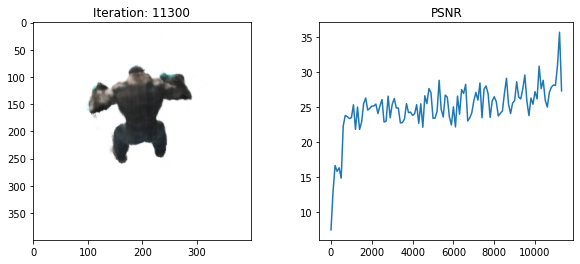

  1%|▊                                                            | 11399/800001 [32:03<18:10:55, 12.05it/s]

[TRAIN] Iter: 11400 Loss_fine: 0.0008912582416087389 PSNR: 30.499961853027344


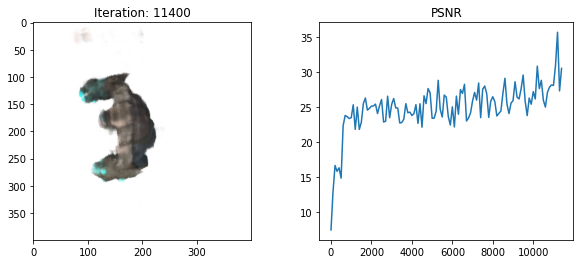

  1%|▉                                                            | 11499/800001 [32:19<18:15:20, 12.00it/s]

[TRAIN] Iter: 11500 Loss_fine: 0.0016343820607289672 PSNR: 27.86646270751953


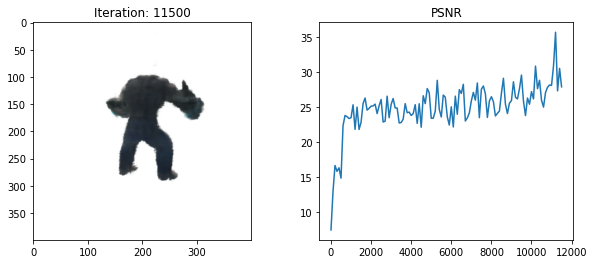

  1%|▉                                                            | 11599/800001 [32:36<18:16:56, 11.98it/s]

[TRAIN] Iter: 11600 Loss_fine: 0.004141474142670631 PSNR: 23.828449249267578


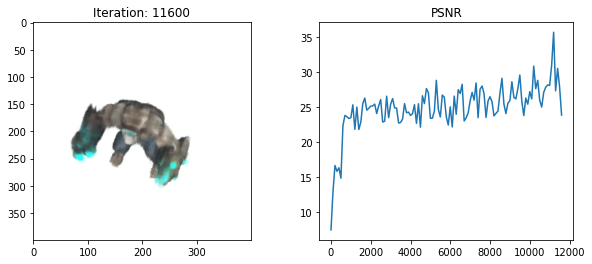

  1%|▉                                                            | 11699/800001 [32:53<18:09:06, 12.06it/s]

[TRAIN] Iter: 11700 Loss_fine: 0.0012468936620280147 PSNR: 29.041706085205078


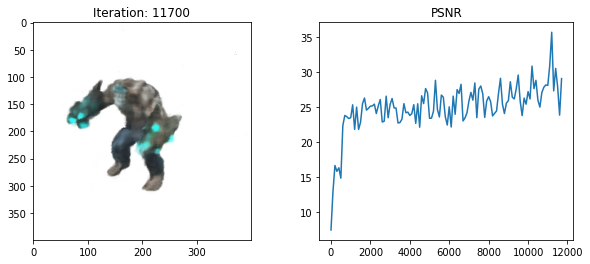

  1%|▉                                                            | 11799/800001 [33:09<18:13:18, 12.02it/s]

[TRAIN] Iter: 11800 Loss_fine: 0.0015504546463489532 PSNR: 28.095409393310547


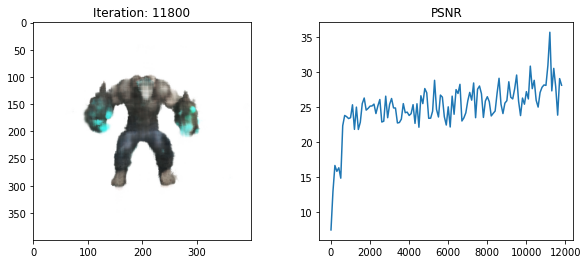

  1%|▉                                                            | 11899/800001 [33:26<18:49:27, 11.63it/s]

[TRAIN] Iter: 11900 Loss_fine: 0.002108390675857663 PSNR: 26.76049041748047


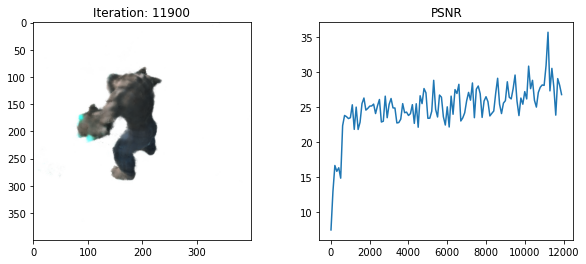

  1%|▉                                                            | 11999/800001 [33:42<18:07:33, 12.08it/s]

[TRAIN] Iter: 12000 Loss_fine: 0.0014165836619213223 PSNR: 28.487579345703125


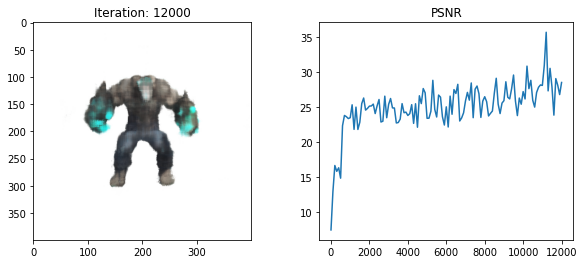

  2%|▉                                                            | 12099/800001 [33:59<18:15:05, 11.99it/s]

[TRAIN] Iter: 12100 Loss_fine: 0.003674952080473304 PSNR: 24.34748077392578


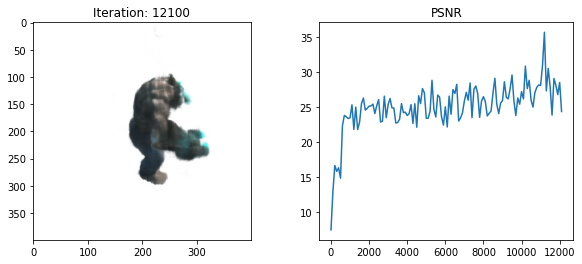

  2%|▉                                                            | 12199/800001 [34:16<18:13:36, 12.01it/s]

[TRAIN] Iter: 12200 Loss_fine: 0.0017859467770904303 PSNR: 27.481313705444336


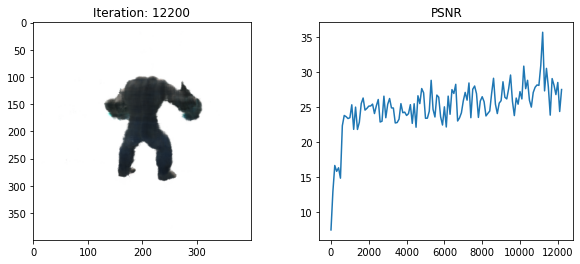

  2%|▉                                                            | 12299/800001 [34:32<18:13:42, 12.00it/s]

[TRAIN] Iter: 12300 Loss_fine: 0.002794352127239108 PSNR: 25.537189483642578


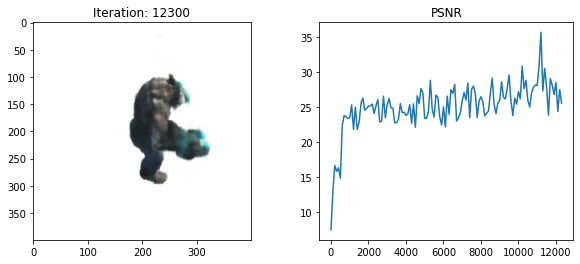

  2%|▉                                                            | 12399/800001 [34:49<18:17:45, 11.96it/s]

[TRAIN] Iter: 12400 Loss_fine: 0.004499130416661501 PSNR: 23.468713760375977


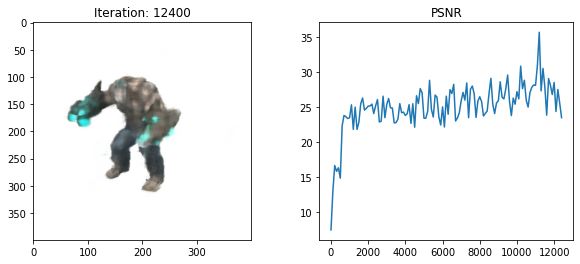

  2%|▉                                                            | 12499/800001 [35:06<18:14:22, 11.99it/s]

[TRAIN] Iter: 12500 Loss_fine: 0.0018241361249238253 PSNR: 27.389427185058594


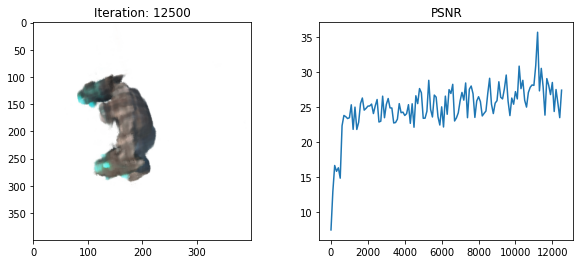

  2%|▉                                                            | 12599/800001 [35:22<18:13:50, 12.00it/s]

[TRAIN] Iter: 12600 Loss_fine: 0.003781696315854788 PSNR: 24.223134994506836


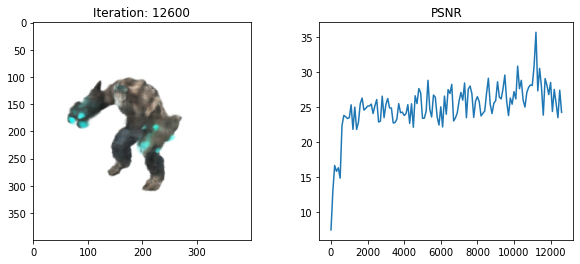

  2%|▉                                                            | 12699/800001 [35:39<18:13:29, 12.00it/s]

[TRAIN] Iter: 12700 Loss_fine: 0.0005975205567665398 PSNR: 32.23646926879883


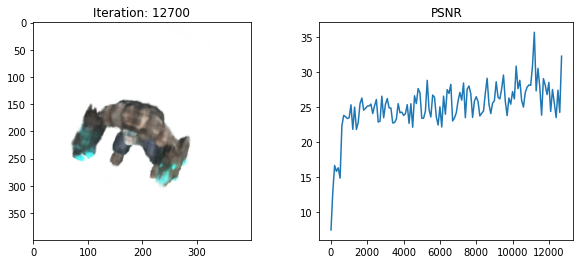

  2%|▉                                                            | 12799/800001 [35:55<18:14:14, 11.99it/s]

[TRAIN] Iter: 12800 Loss_fine: 0.0032152391504496336 PSNR: 24.927865982055664


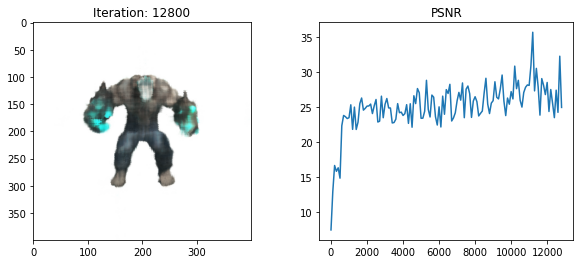

  2%|▉                                                            | 12899/800001 [36:12<18:12:47, 12.00it/s]

[TRAIN] Iter: 12900 Loss_fine: 0.001743727014400065 PSNR: 27.585214614868164


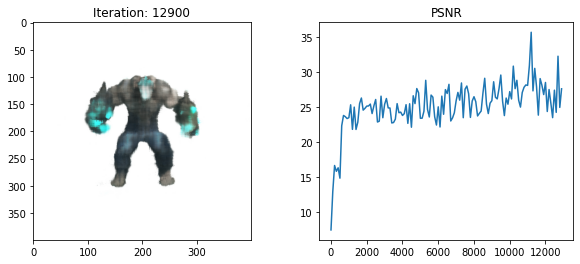

  2%|▉                                                            | 12999/800001 [36:29<19:13:44, 11.37it/s]

[TRAIN] Iter: 13000 Loss_fine: 0.0033081660512834787 PSNR: 24.804126739501953


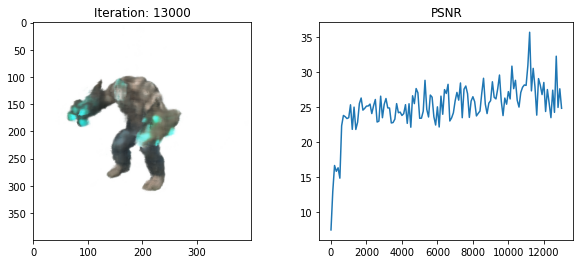

  2%|▉                                                            | 13099/800001 [36:46<18:19:21, 11.93it/s]

[TRAIN] Iter: 13100 Loss_fine: 0.0009060204029083252 PSNR: 30.428617477416992


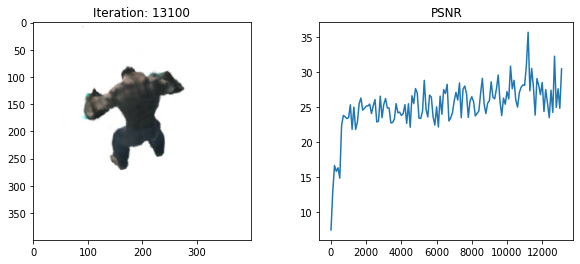

  2%|█                                                            | 13199/800001 [37:03<18:55:31, 11.55it/s]

[TRAIN] Iter: 13200 Loss_fine: 0.002227714052423835 PSNR: 26.521404266357422


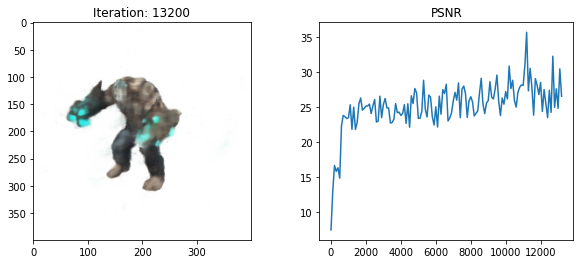

  2%|█                                                            | 13299/800001 [37:21<21:06:02, 10.36it/s]

[TRAIN] Iter: 13300 Loss_fine: 0.001919093425385654 PSNR: 27.169036865234375


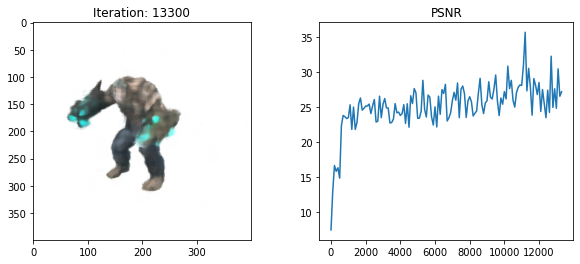

  2%|█                                                            | 13399/800001 [37:38<17:53:57, 12.21it/s]

[TRAIN] Iter: 13400 Loss_fine: 0.003320589428767562 PSNR: 24.7878475189209


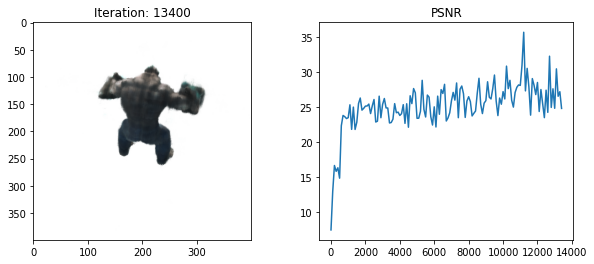

  2%|█                                                            | 13499/800001 [37:54<18:25:23, 11.86it/s]

[TRAIN] Iter: 13500 Loss_fine: 0.0025127551052719355 PSNR: 25.998497009277344


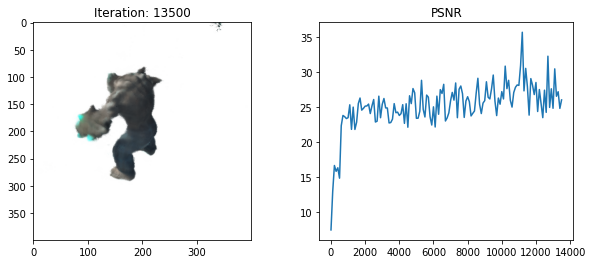

  2%|█                                                            | 13599/800001 [38:11<18:16:54, 11.95it/s]

[TRAIN] Iter: 13600 Loss_fine: 0.0021837581880390644 PSNR: 26.607955932617188


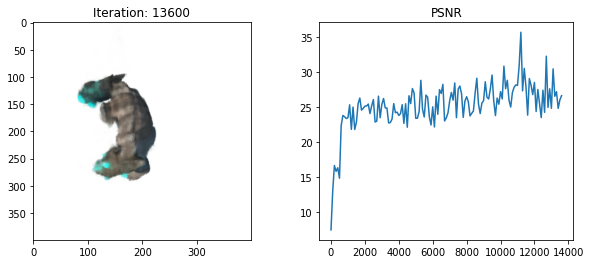

  2%|█                                                            | 13699/800001 [38:28<18:24:48, 11.86it/s]

[TRAIN] Iter: 13700 Loss_fine: 0.0011405723635107279 PSNR: 29.42877197265625


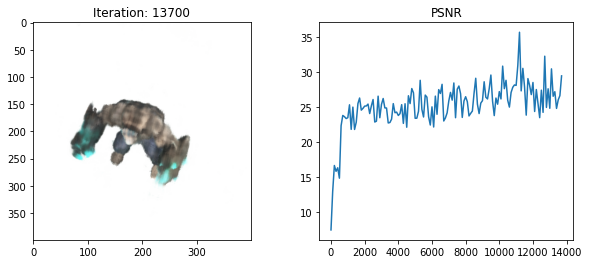

  2%|█                                                            | 13799/800001 [38:45<17:52:50, 12.21it/s]

[TRAIN] Iter: 13800 Loss_fine: 0.0031969877891242504 PSNR: 24.952590942382812


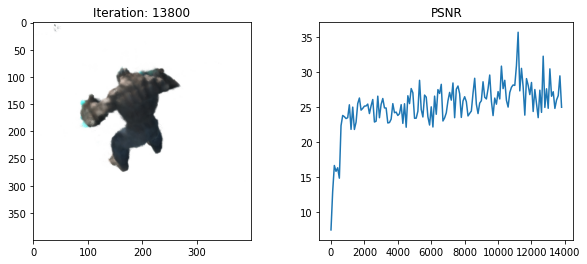

  2%|█                                                            | 13899/800001 [39:01<17:54:37, 12.19it/s]

[TRAIN] Iter: 13900 Loss_fine: 0.0022654628846794367 PSNR: 26.44843101501465


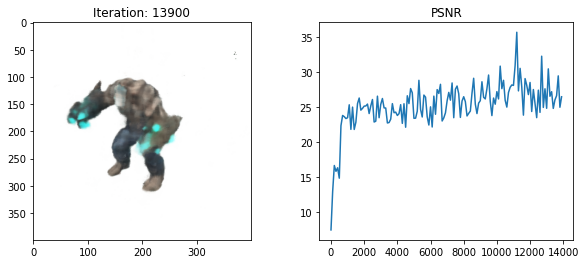

  2%|█                                                            | 13999/800001 [39:18<17:52:18, 12.22it/s]

[TRAIN] Iter: 14000 Loss_fine: 0.0028912837151437998 PSNR: 25.38909149169922


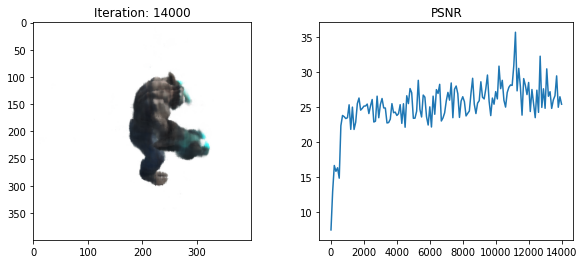

  2%|█                                                            | 14099/800001 [39:34<17:50:31, 12.24it/s]

[TRAIN] Iter: 14100 Loss_fine: 0.0008615110418759286 PSNR: 30.64739227294922


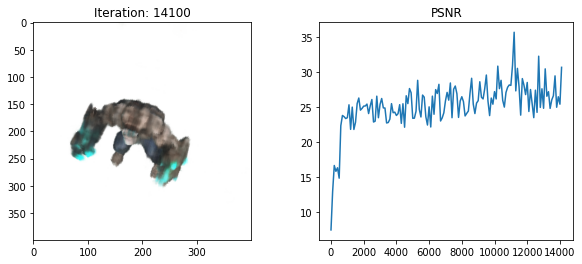

  2%|█                                                            | 14199/800001 [39:51<17:51:39, 12.22it/s]

[TRAIN] Iter: 14200 Loss_fine: 0.003043742384761572 PSNR: 25.165922164916992


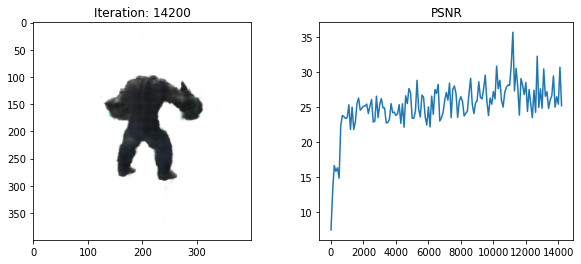

  2%|█                                                            | 14299/800001 [40:07<17:51:21, 12.22it/s]

[TRAIN] Iter: 14300 Loss_fine: 0.0016057799803093076 PSNR: 27.94314193725586


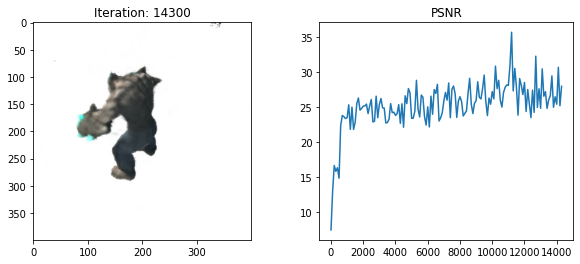

  2%|█                                                            | 14399/800001 [40:24<17:53:56, 12.19it/s]

[TRAIN] Iter: 14400 Loss_fine: 0.0024367044679820538 PSNR: 26.13197135925293


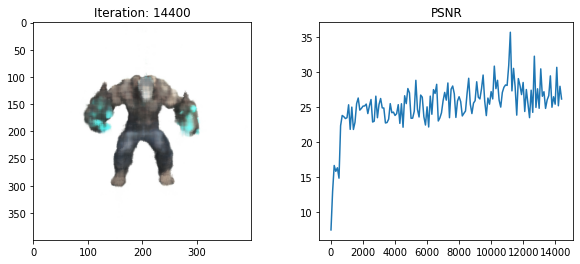

  2%|█                                                            | 14499/800001 [40:40<17:50:23, 12.23it/s]

[TRAIN] Iter: 14500 Loss_fine: 0.0026448084972798824 PSNR: 25.776058197021484


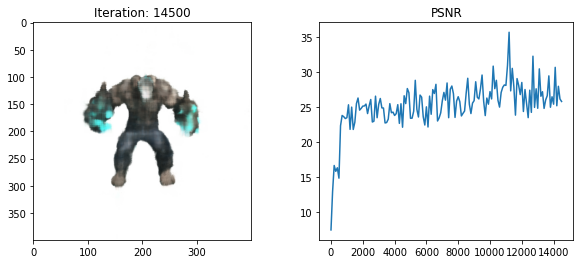

  2%|█                                                            | 14599/800001 [40:58<19:13:03, 11.35it/s]

[TRAIN] Iter: 14600 Loss_fine: 0.0008648875518701971 PSNR: 30.63040542602539


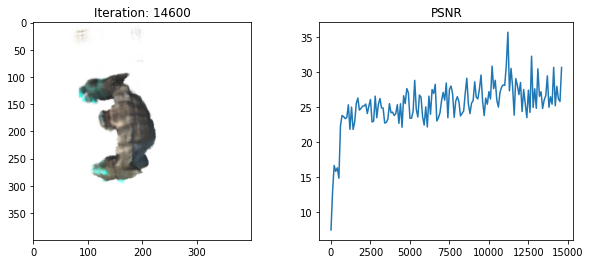

  2%|█                                                            | 14699/800001 [41:15<18:11:06, 12.00it/s]

[TRAIN] Iter: 14700 Loss_fine: 0.0026672719977796078 PSNR: 25.73932647705078


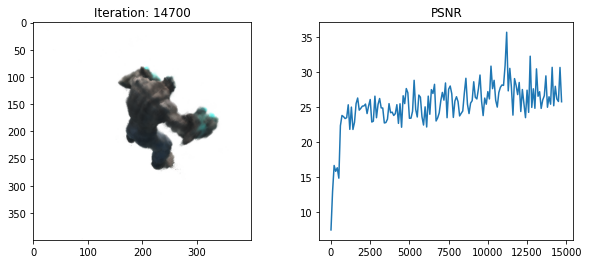

  2%|█▏                                                           | 14799/800001 [41:31<18:08:33, 12.02it/s]

[TRAIN] Iter: 14800 Loss_fine: 0.0011542142601683736 PSNR: 29.37713623046875


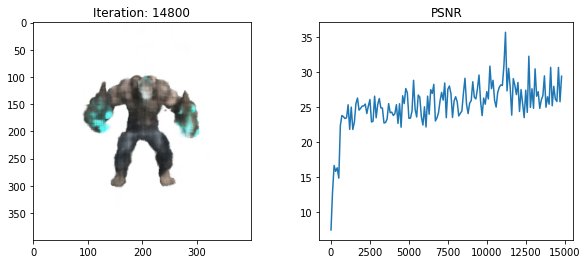

  2%|█▏                                                           | 14899/800001 [41:48<18:30:26, 11.78it/s]

[TRAIN] Iter: 14900 Loss_fine: 0.0006080719758756459 PSNR: 32.16044998168945


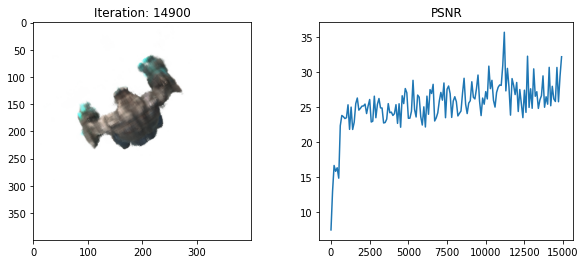

  2%|█▏                                                           | 14999/800001 [42:05<18:34:37, 11.74it/s]

[TRAIN] Iter: 15000 Loss_fine: 0.001435876707546413 PSNR: 28.4288272857666


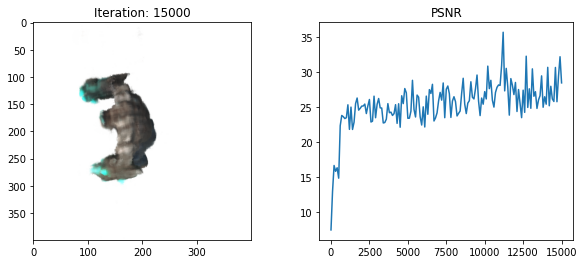

  2%|█▏                                                           | 15099/800001 [42:22<19:25:36, 11.22it/s]

[TRAIN] Iter: 15100 Loss_fine: 0.0020038203801959753 PSNR: 26.981412887573242


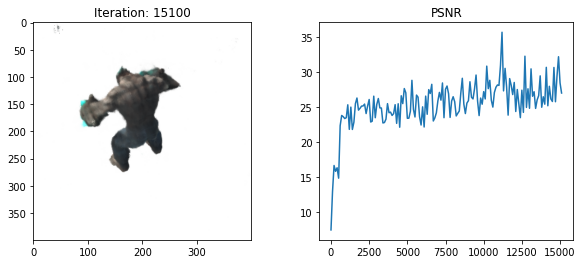

  2%|█▏                                                           | 15199/800001 [42:39<18:14:34, 11.95it/s]

[TRAIN] Iter: 15200 Loss_fine: 0.0014548340113833547 PSNR: 28.37186622619629


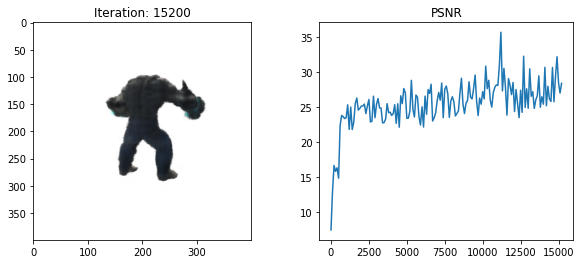

  2%|█▏                                                           | 15299/800001 [42:56<18:25:19, 11.83it/s]

[TRAIN] Iter: 15300 Loss_fine: 0.0018823626451194286 PSNR: 27.252965927124023


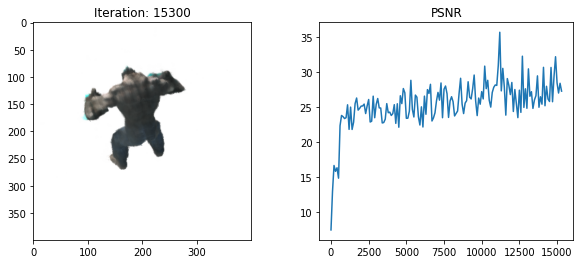

  2%|█▏                                                           | 15399/800001 [43:14<18:18:21, 11.91it/s]

[TRAIN] Iter: 15400 Loss_fine: 0.0016236446099355817 PSNR: 27.895090103149414


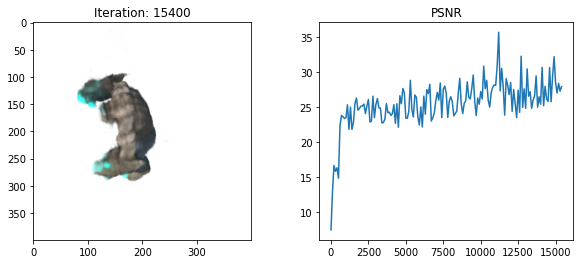

  2%|█▏                                                           | 15499/800001 [43:31<17:54:48, 12.16it/s]

[TRAIN] Iter: 15500 Loss_fine: 0.000689696054905653 PSNR: 31.613422393798828


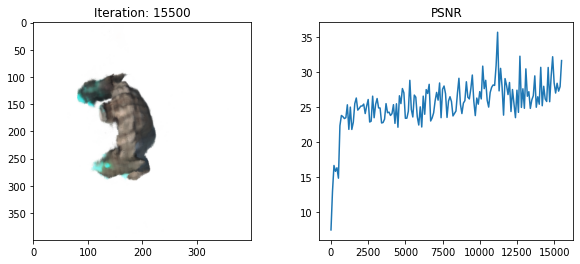

  2%|█▏                                                           | 15599/800001 [43:47<17:51:13, 12.20it/s]

[TRAIN] Iter: 15600 Loss_fine: 0.0014638087013736367 PSNR: 28.345155715942383


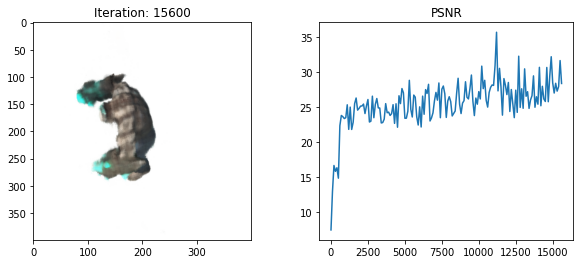

  2%|█▏                                                           | 15699/800001 [44:04<17:52:15, 12.19it/s]

[TRAIN] Iter: 15700 Loss_fine: 0.002265677321702242 PSNR: 26.44801902770996


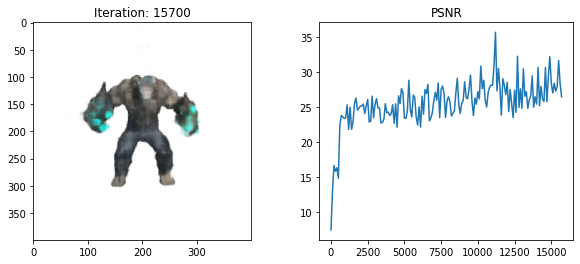

  2%|█▏                                                           | 15799/800001 [44:20<17:51:38, 12.20it/s]

[TRAIN] Iter: 15800 Loss_fine: 0.005211494397372007 PSNR: 22.83037757873535


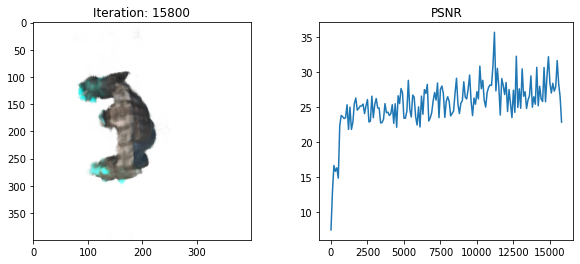

  2%|█▏                                                           | 15899/800001 [44:37<17:51:31, 12.20it/s]

[TRAIN] Iter: 15900 Loss_fine: 0.002494517248123884 PSNR: 26.030134201049805


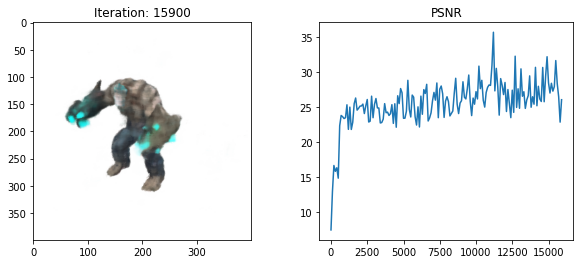

  2%|█▏                                                           | 15999/800001 [44:53<17:50:01, 12.21it/s]

[TRAIN] Iter: 16000 Loss_fine: 0.0014305025106295943 PSNR: 28.445112228393555


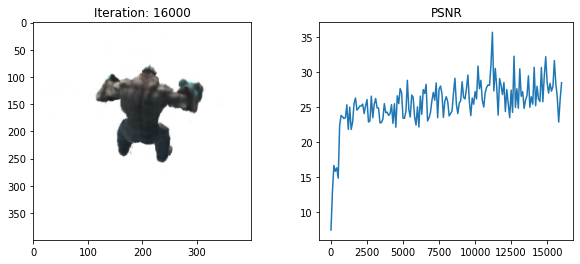

  2%|█▏                                                           | 16099/800001 [45:10<18:36:03, 11.71it/s]

[TRAIN] Iter: 16100 Loss_fine: 0.0010850888211280107 PSNR: 29.645349502563477


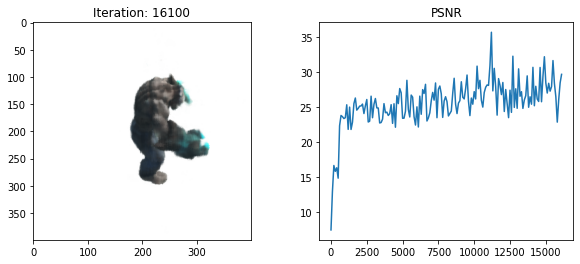

  2%|█▏                                                           | 16199/800001 [45:27<19:18:33, 11.28it/s]

[TRAIN] Iter: 16200 Loss_fine: 0.0022554094903171062 PSNR: 26.467744827270508


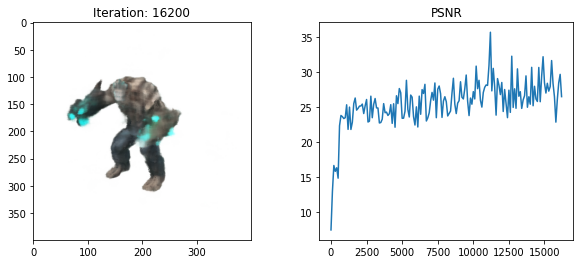

  2%|█▏                                                           | 16299/800001 [45:44<17:48:54, 12.22it/s]

[TRAIN] Iter: 16300 Loss_fine: 0.0030723141971975565 PSNR: 25.125343322753906


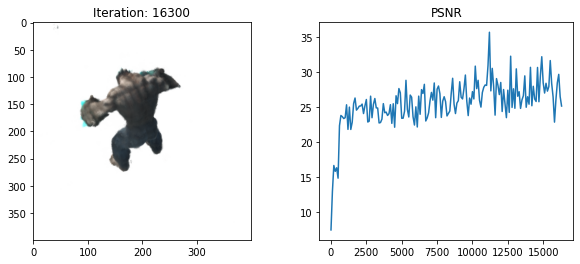

  2%|█▎                                                           | 16399/800001 [46:01<17:50:10, 12.20it/s]

[TRAIN] Iter: 16400 Loss_fine: 0.00090758316218853 PSNR: 30.4211368560791


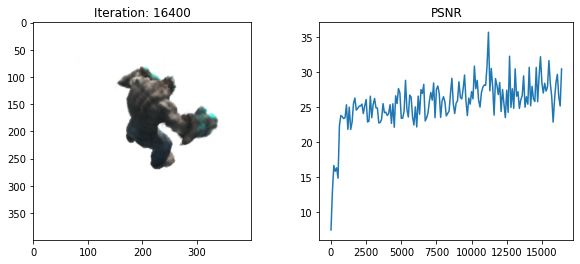

  2%|█▎                                                           | 16499/800001 [46:17<17:58:12, 12.11it/s]

[TRAIN] Iter: 16500 Loss_fine: 0.0018934168620035052 PSNR: 27.2275390625


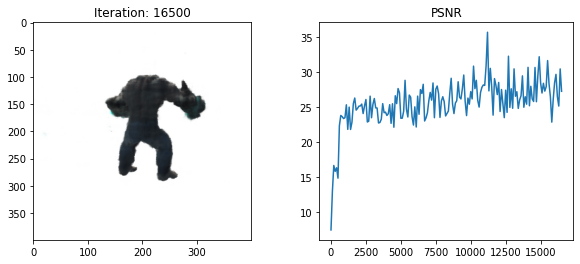

  2%|█▎                                                           | 16599/800001 [46:34<17:51:31, 12.19it/s]

[TRAIN] Iter: 16600 Loss_fine: 0.0014089224860072136 PSNR: 28.511127471923828


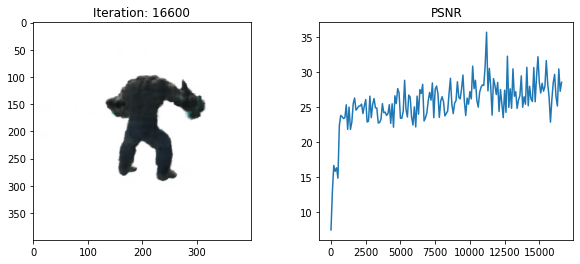

  2%|█▎                                                           | 16699/800001 [46:50<17:48:35, 12.22it/s]

[TRAIN] Iter: 16700 Loss_fine: 0.0016028350219130516 PSNR: 27.95111083984375


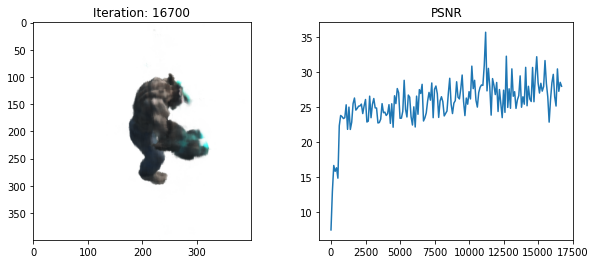

  2%|█▎                                                           | 16800/800001 [47:07<17:46:08, 12.24it/s]

[TRAIN] Iter: 16800 Loss_fine: 0.0020135967060923576 PSNR: 26.96027374267578


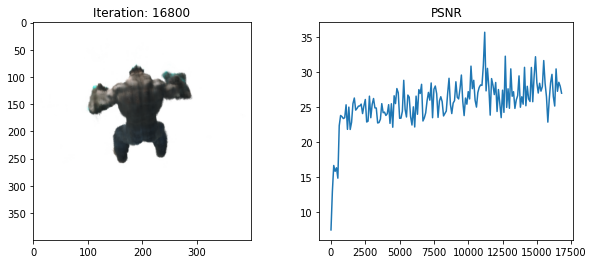

  2%|█▎                                                           | 16900/800001 [47:23<17:51:47, 12.18it/s]

[TRAIN] Iter: 16900 Loss_fine: 0.0025684181600809097 PSNR: 25.903343200683594


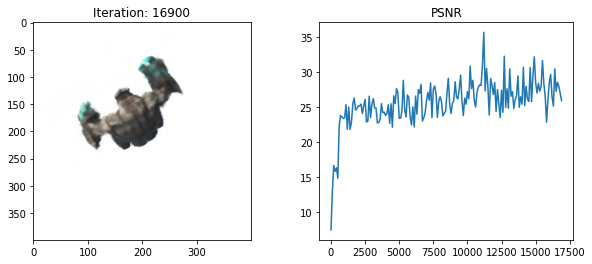

  2%|█▎                                                           | 17000/800001 [47:40<17:47:32, 12.22it/s]

[TRAIN] Iter: 17000 Loss_fine: 0.0014801113866269588 PSNR: 28.297056198120117


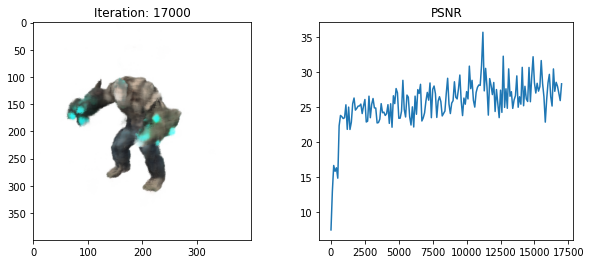

  2%|█▎                                                           | 17100/800001 [47:56<17:51:28, 12.18it/s]

[TRAIN] Iter: 17100 Loss_fine: 0.0031466928776353598 PSNR: 25.021453857421875


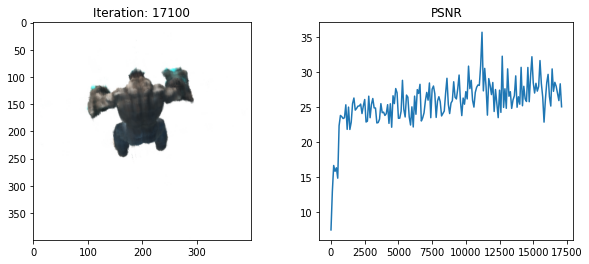

  2%|█▎                                                           | 17200/800001 [48:12<17:51:39, 12.17it/s]

[TRAIN] Iter: 17200 Loss_fine: 0.001297274138778448 PSNR: 28.86968231201172


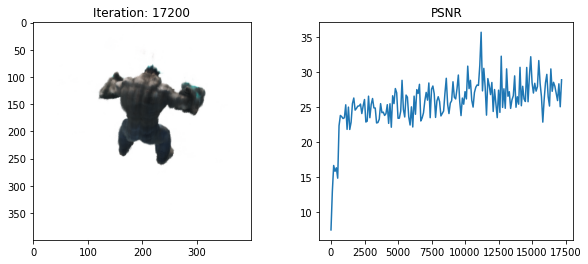

  2%|█▎                                                           | 17300/800001 [48:29<17:49:42, 12.19it/s]

[TRAIN] Iter: 17300 Loss_fine: 0.0009855383541435003 PSNR: 30.063264846801758


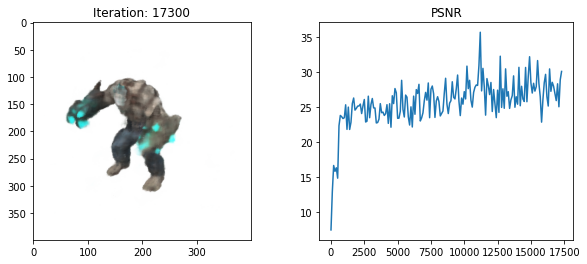

  2%|█▎                                                           | 17400/800001 [48:45<17:49:35, 12.19it/s]

[TRAIN] Iter: 17400 Loss_fine: 0.0006106726359575987 PSNR: 32.14191436767578


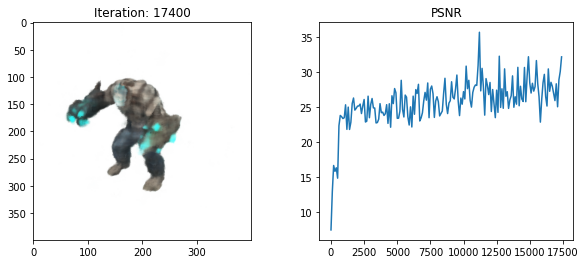

  2%|█▎                                                           | 17500/800001 [49:02<17:48:22, 12.21it/s]

[TRAIN] Iter: 17500 Loss_fine: 0.001489742542617023 PSNR: 28.268888473510742


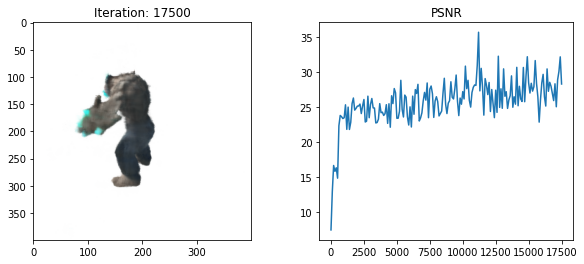

  2%|█▎                                                           | 17600/800001 [49:18<17:47:25, 12.22it/s]

[TRAIN] Iter: 17600 Loss_fine: 0.0004098715726286173 PSNR: 33.87351989746094


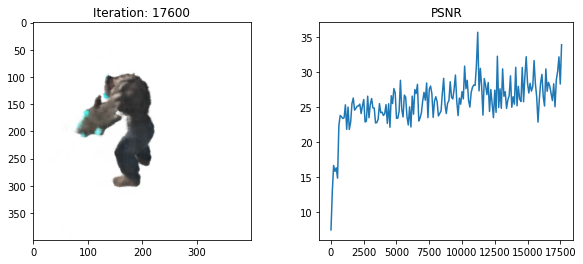

  2%|█▎                                                           | 17700/800001 [49:35<17:53:23, 12.15it/s]

[TRAIN] Iter: 17700 Loss_fine: 0.0025230629835277796 PSNR: 25.9807186126709


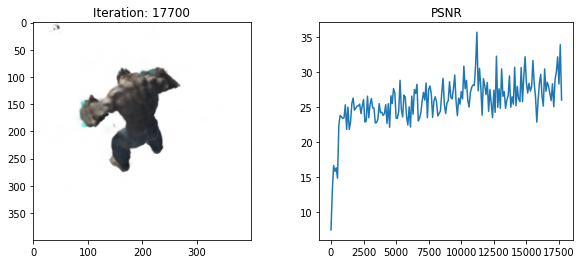

  2%|█▎                                                           | 17800/800001 [49:51<17:54:43, 12.13it/s]

[TRAIN] Iter: 17800 Loss_fine: 0.0020057375077158213 PSNR: 26.977256774902344


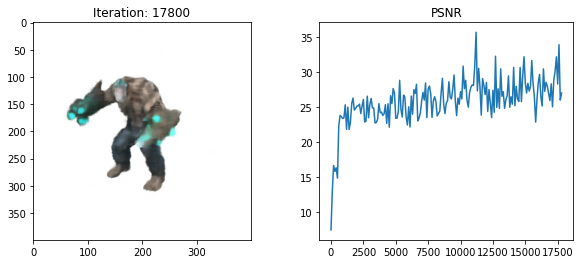

  2%|█▎                                                           | 17900/800001 [50:08<17:45:33, 12.23it/s]

[TRAIN] Iter: 17900 Loss_fine: 0.0015060550067573786 PSNR: 28.221590042114258


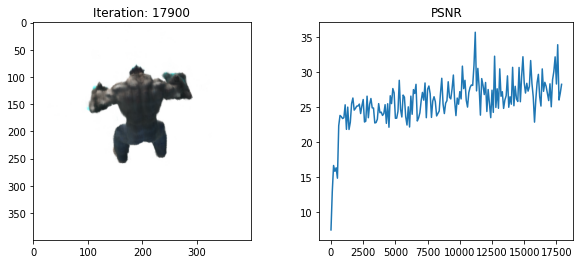

  2%|█▎                                                           | 18000/800001 [50:24<17:49:19, 12.19it/s]

[TRAIN] Iter: 18000 Loss_fine: 0.0025403655599802732 PSNR: 25.95103645324707


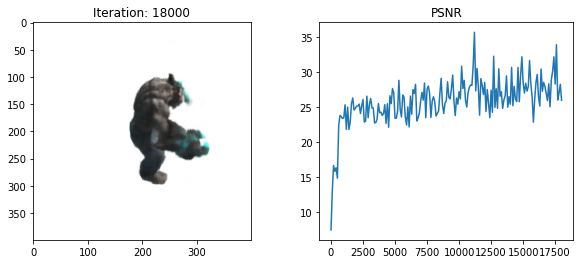

  2%|█▍                                                           | 18100/800001 [50:41<17:47:18, 12.21it/s]

[TRAIN] Iter: 18100 Loss_fine: 0.0009730626479722559 PSNR: 30.118589401245117


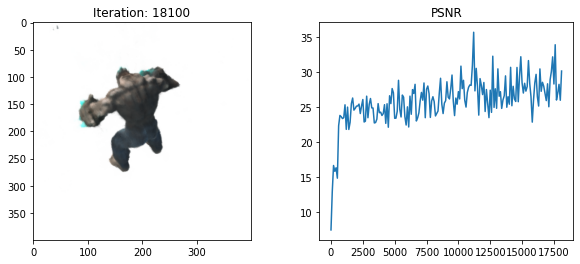

  2%|█▍                                                           | 18200/800001 [50:57<17:46:29, 12.22it/s]

[TRAIN] Iter: 18200 Loss_fine: 0.0020152870565652847 PSNR: 26.95663070678711


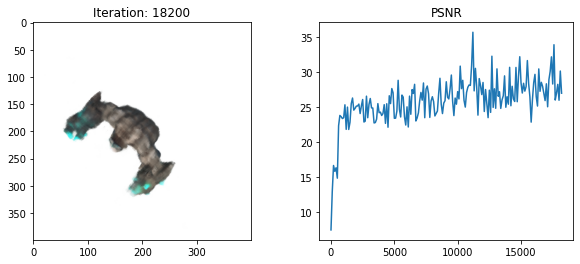

  2%|█▍                                                           | 18300/800001 [51:14<17:48:37, 12.19it/s]

[TRAIN] Iter: 18300 Loss_fine: 0.002664959989488125 PSNR: 25.743091583251953


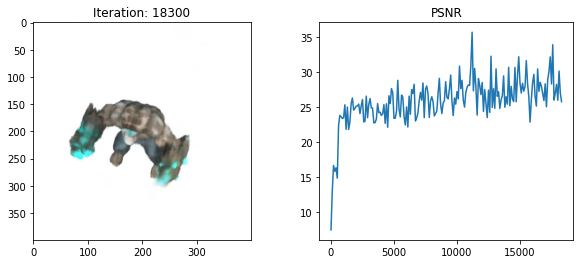

  2%|█▍                                                           | 18400/800001 [51:30<17:46:14, 12.22it/s]

[TRAIN] Iter: 18400 Loss_fine: 0.002865575486794114 PSNR: 25.427881240844727


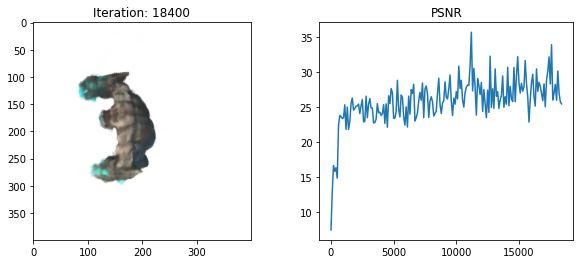

  2%|█▍                                                           | 18500/800001 [51:47<17:48:23, 12.19it/s]

[TRAIN] Iter: 18500 Loss_fine: 0.0021021002903580666 PSNR: 26.77346420288086


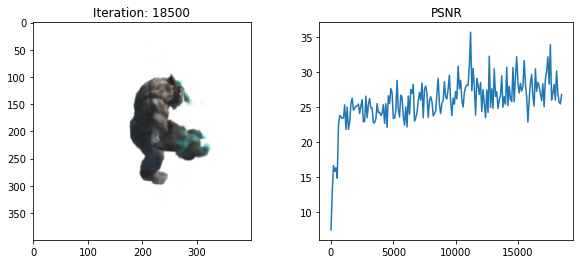

  2%|█▍                                                           | 18600/800001 [52:03<17:52:21, 12.14it/s]

[TRAIN] Iter: 18600 Loss_fine: 0.00044351848191581666 PSNR: 33.5308837890625


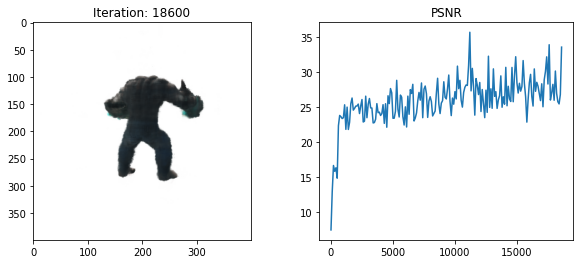

  2%|█▍                                                           | 18700/800001 [52:20<17:42:35, 12.25it/s]

[TRAIN] Iter: 18700 Loss_fine: 0.0012338144006207585 PSNR: 29.087501525878906


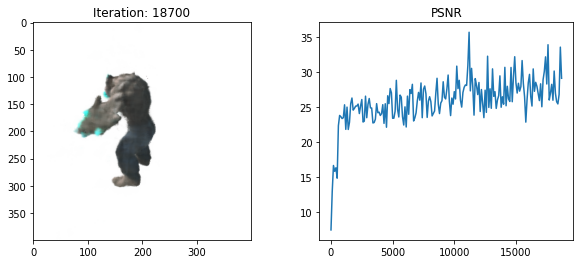

  2%|█▍                                                           | 18800/800001 [52:36<17:42:20, 12.26it/s]

[TRAIN] Iter: 18800 Loss_fine: 0.0007692967192269862 PSNR: 31.139060974121094


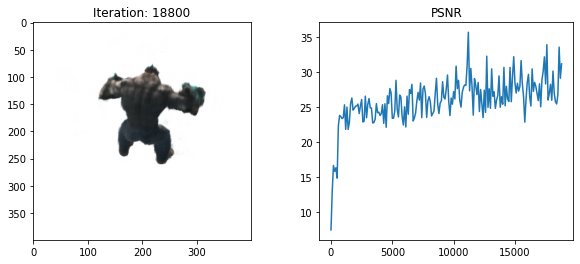

  2%|█▍                                                           | 18900/800001 [52:53<17:47:20, 12.20it/s]

[TRAIN] Iter: 18900 Loss_fine: 0.0009869876084849238 PSNR: 30.056884765625


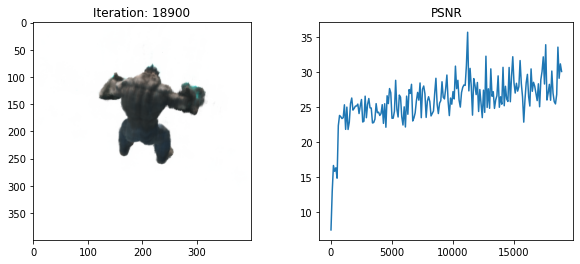

  2%|█▍                                                           | 19000/800001 [53:09<17:45:44, 12.21it/s]

[TRAIN] Iter: 19000 Loss_fine: 0.004533461760729551 PSNR: 23.435699462890625


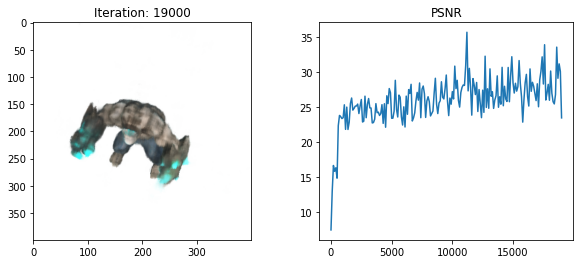

  2%|█▍                                                           | 19100/800001 [53:25<17:44:46, 12.22it/s]

[TRAIN] Iter: 19100 Loss_fine: 0.0012605366064235568 PSNR: 28.994443893432617


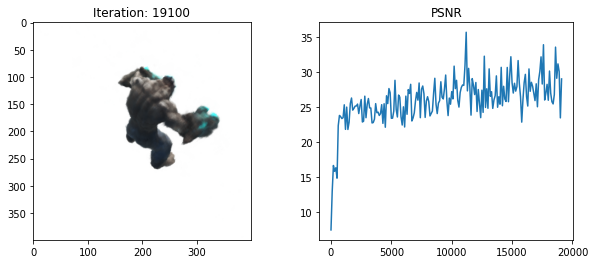

  2%|█▍                                                           | 19200/800001 [53:42<17:45:15, 12.22it/s]

[TRAIN] Iter: 19200 Loss_fine: 0.0007839225581847131 PSNR: 31.057266235351562


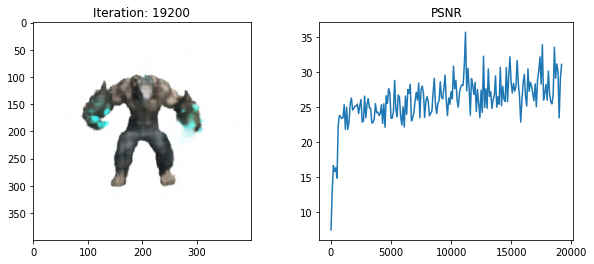

  2%|█▍                                                           | 19300/800001 [53:58<17:47:29, 12.19it/s]

[TRAIN] Iter: 19300 Loss_fine: 0.0010685456218197942 PSNR: 29.712068557739258


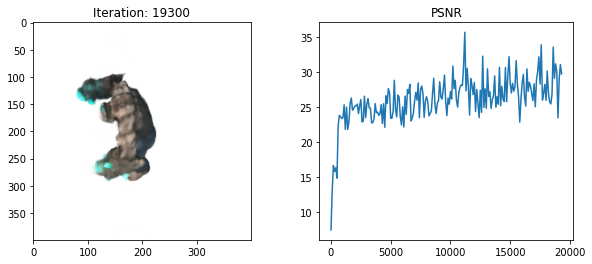

  2%|█▍                                                           | 19400/800001 [54:15<17:41:55, 12.25it/s]

[TRAIN] Iter: 19400 Loss_fine: 0.0017594483215361834 PSNR: 27.546234130859375


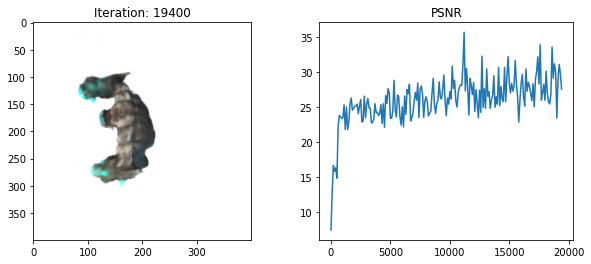

  2%|█▍                                                           | 19500/800001 [54:31<17:44:19, 12.22it/s]

[TRAIN] Iter: 19500 Loss_fine: 0.0005808866699226201 PSNR: 32.35908508300781


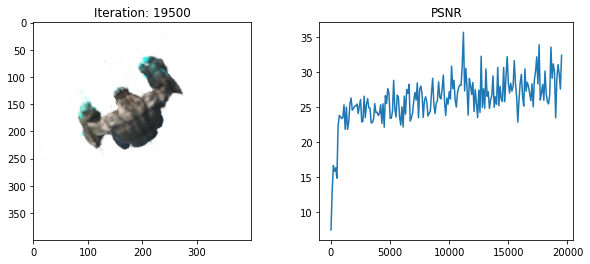

  2%|█▍                                                           | 19600/800001 [54:48<17:48:12, 12.18it/s]

[TRAIN] Iter: 19600 Loss_fine: 0.000342545157764107 PSNR: 34.6528205871582


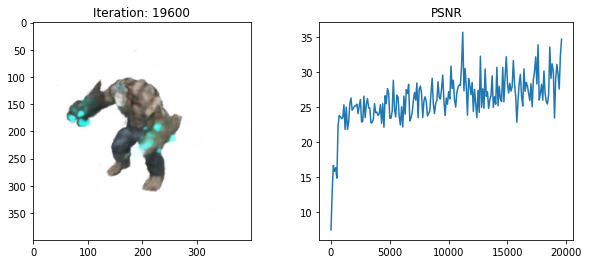

  2%|█▌                                                           | 19700/800001 [55:04<17:45:01, 12.21it/s]

[TRAIN] Iter: 19700 Loss_fine: 0.0016694688238203526 PSNR: 27.77421760559082


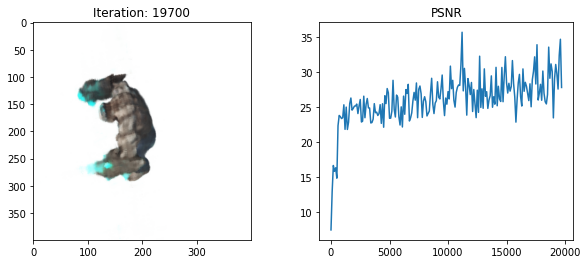

  2%|█▌                                                           | 19800/800001 [55:21<17:45:26, 12.20it/s]

[TRAIN] Iter: 19800 Loss_fine: 0.0014395654434338212 PSNR: 28.417686462402344


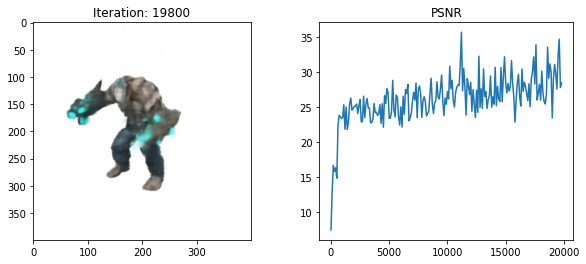

  2%|█▌                                                           | 19900/800001 [55:37<17:44:09, 12.22it/s]

[TRAIN] Iter: 19900 Loss_fine: 0.00038082434912212193 PSNR: 34.192752838134766


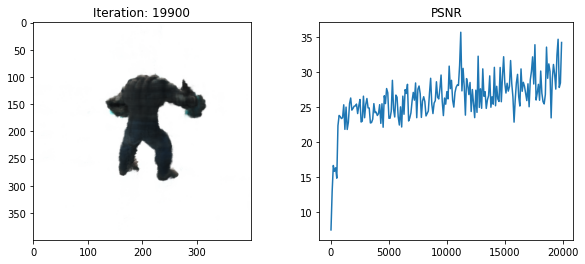

  2%|█▌                                                           | 20000/800001 [55:54<17:43:27, 12.22it/s]

[TRAIN] Iter: 20000 Loss_fine: 0.0021827060263603926 PSNR: 26.610048294067383


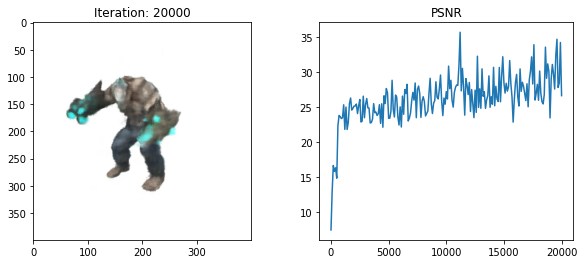

  3%|█▌                                                           | 20100/800001 [56:10<17:43:17, 12.22it/s]

[TRAIN] Iter: 20100 Loss_fine: 0.0012292240280658007 PSNR: 29.103687286376953


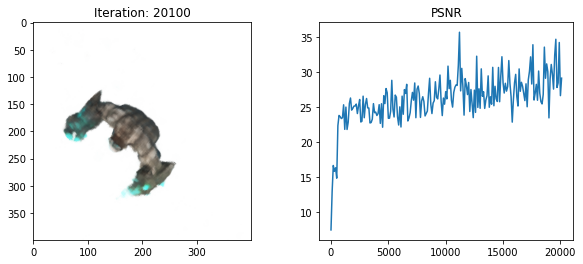

  3%|█▌                                                           | 20200/800001 [56:27<17:46:01, 12.19it/s]

[TRAIN] Iter: 20200 Loss_fine: 0.003069462953135371 PSNR: 25.129375457763672


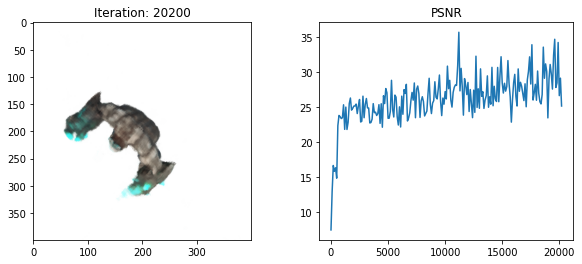

  3%|█▌                                                           | 20300/800001 [56:43<17:43:10, 12.22it/s]

[TRAIN] Iter: 20300 Loss_fine: 0.0013453770661726594 PSNR: 28.711559295654297


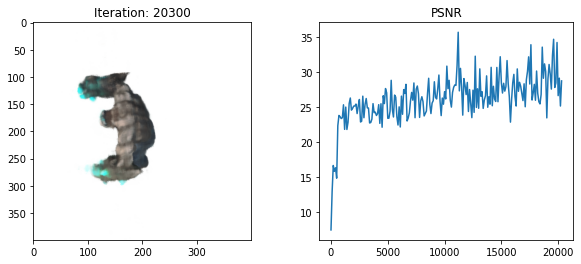

  3%|█▌                                                           | 20400/800001 [57:00<17:43:26, 12.22it/s]

[TRAIN] Iter: 20400 Loss_fine: 0.002159874187782407 PSNR: 26.65571403503418


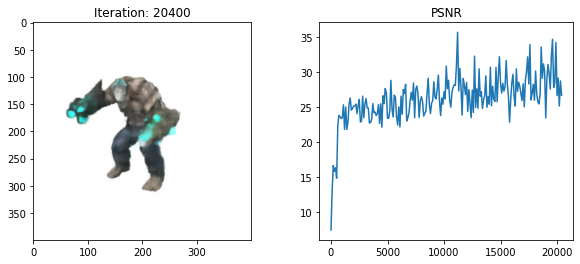

  3%|█▌                                                           | 20500/800001 [57:16<18:10:04, 11.92it/s]

[TRAIN] Iter: 20500 Loss_fine: 0.0022344898898154497 PSNR: 26.508214950561523


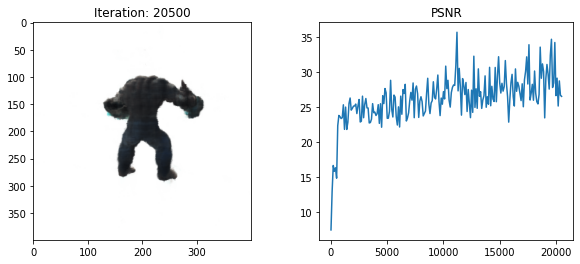

  3%|█▌                                                           | 20600/800001 [57:33<18:02:13, 12.00it/s]

[TRAIN] Iter: 20600 Loss_fine: 0.0007719197310507298 PSNR: 31.124277114868164


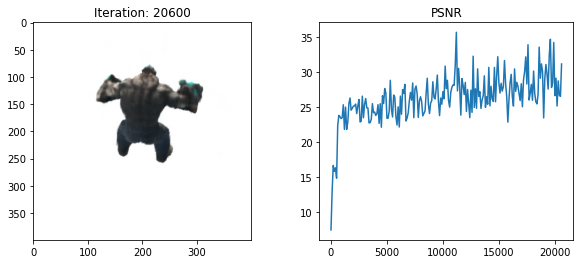

  3%|█▌                                                           | 20700/800001 [57:50<19:02:29, 11.37it/s]

[TRAIN] Iter: 20700 Loss_fine: 0.001539439195767045 PSNR: 28.126373291015625


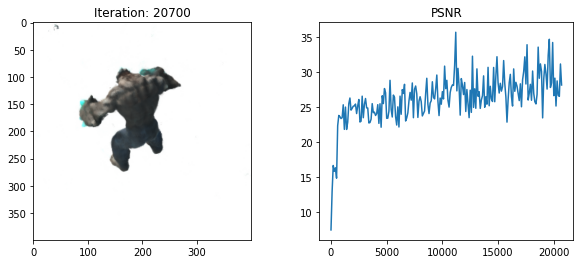

  3%|█▌                                                           | 20800/800001 [58:07<18:22:02, 11.78it/s]

[TRAIN] Iter: 20800 Loss_fine: 0.0017538261599838734 PSNR: 27.56013298034668


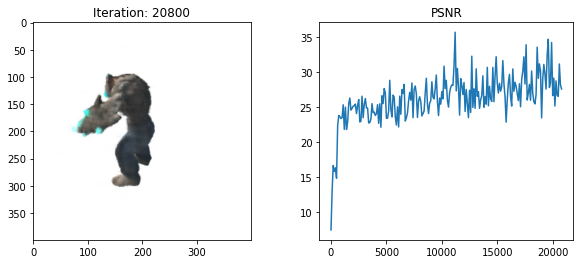

  3%|█▌                                                           | 20900/800001 [58:24<18:56:38, 11.42it/s]

[TRAIN] Iter: 20900 Loss_fine: 0.001393024460412562 PSNR: 28.56041145324707


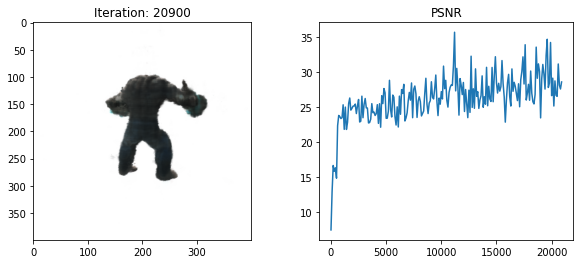

  3%|█▌                                                           | 21000/800001 [58:41<17:43:07, 12.21it/s]

[TRAIN] Iter: 21000 Loss_fine: 0.0011537596583366394 PSNR: 29.37884521484375


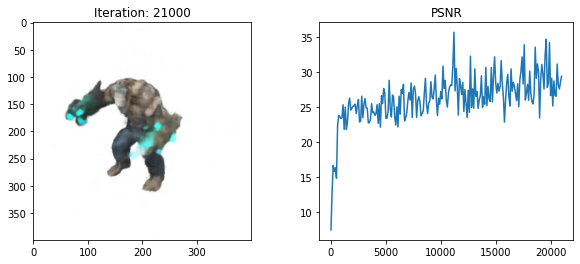

  3%|█▌                                                           | 21100/800001 [58:58<18:03:55, 11.98it/s]

[TRAIN] Iter: 21100 Loss_fine: 0.002201610477641225 PSNR: 26.572595596313477


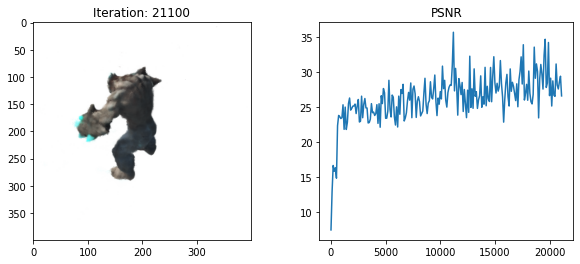

  3%|█▌                                                           | 21200/800001 [59:14<17:49:20, 12.14it/s]

[TRAIN] Iter: 21200 Loss_fine: 0.0025028211530297995 PSNR: 26.015703201293945


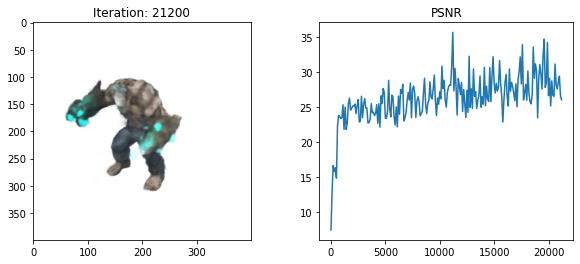

  3%|█▌                                                           | 21300/800001 [59:31<18:16:53, 11.83it/s]

[TRAIN] Iter: 21300 Loss_fine: 0.002468699822202325 PSNR: 26.075315475463867


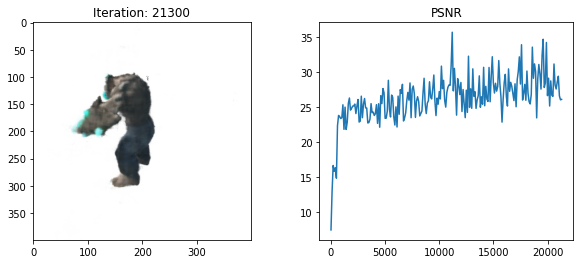

  3%|█▋                                                           | 21400/800001 [59:48<19:27:31, 11.11it/s]

[TRAIN] Iter: 21400 Loss_fine: 0.0018215724267065525 PSNR: 27.395536422729492


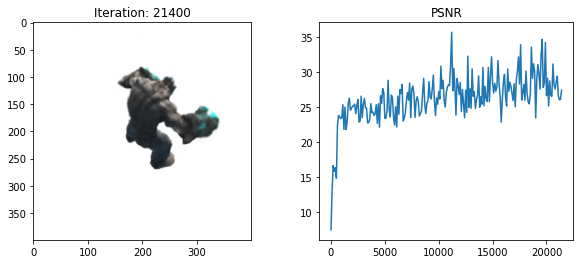

  3%|█▌                                                         | 21500/800001 [1:00:06<18:45:15, 11.53it/s]

[TRAIN] Iter: 21500 Loss_fine: 0.001965986331924796 PSNR: 27.06419563293457


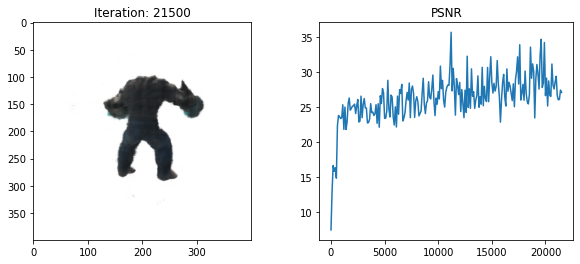

  3%|█▌                                                         | 21600/800001 [1:00:24<20:21:17, 10.62it/s]

[TRAIN] Iter: 21600 Loss_fine: 0.001360250753350556 PSNR: 28.66381072998047


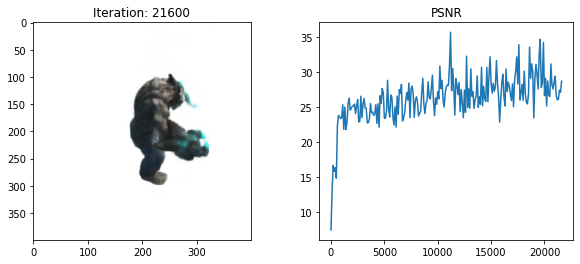

  3%|█▌                                                         | 21700/800001 [1:00:43<20:16:29, 10.66it/s]

[TRAIN] Iter: 21700 Loss_fine: 0.002106129191815853 PSNR: 26.765148162841797


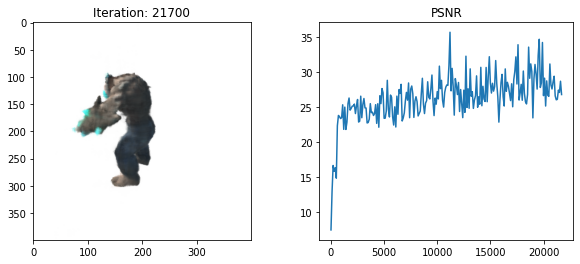

  3%|█▌                                                         | 21800/800001 [1:01:01<20:09:43, 10.72it/s]

[TRAIN] Iter: 21800 Loss_fine: 0.0016092272708192468 PSNR: 27.93382453918457


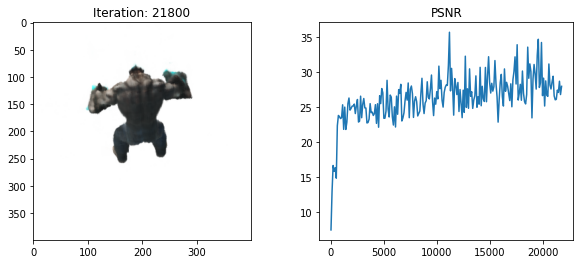

  3%|█▌                                                         | 21900/800001 [1:01:20<20:18:49, 10.64it/s]

[TRAIN] Iter: 21900 Loss_fine: 0.0013746499316766858 PSNR: 28.618078231811523


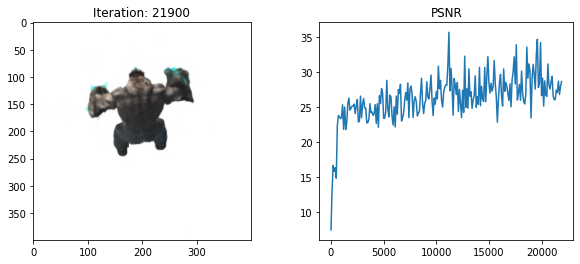

  3%|█▌                                                         | 22000/800001 [1:01:38<19:47:04, 10.92it/s]

[TRAIN] Iter: 22000 Loss_fine: 0.000801111978944391 PSNR: 30.96306610107422


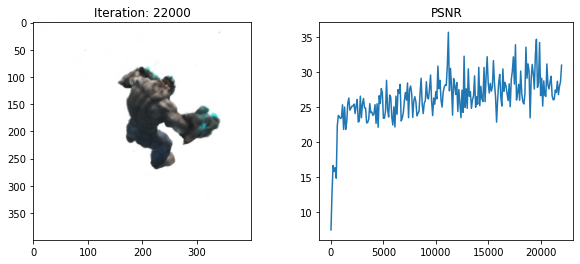

  3%|█▋                                                         | 22100/800001 [1:01:57<19:48:19, 10.91it/s]

[TRAIN] Iter: 22100 Loss_fine: 0.0023101186379790306 PSNR: 26.363658905029297


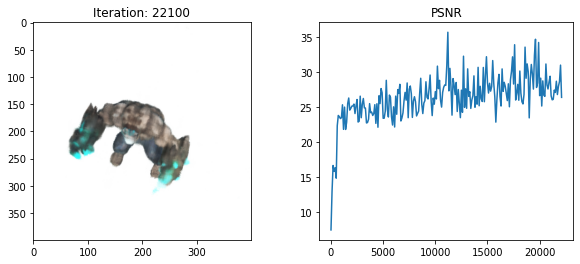

  3%|█▋                                                         | 22200/800001 [1:02:15<19:38:53, 11.00it/s]

[TRAIN] Iter: 22200 Loss_fine: 0.0007487901020795107 PSNR: 31.256399154663086


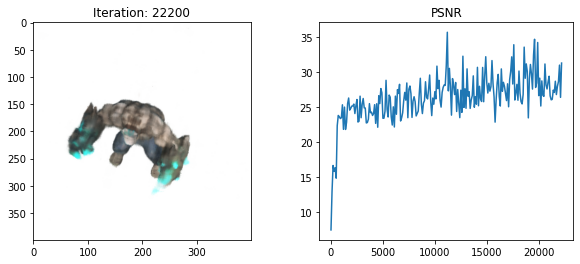

  3%|█▋                                                         | 22300/800001 [1:02:33<19:44:30, 10.94it/s]

[TRAIN] Iter: 22300 Loss_fine: 0.00331027340143919 PSNR: 24.801359176635742


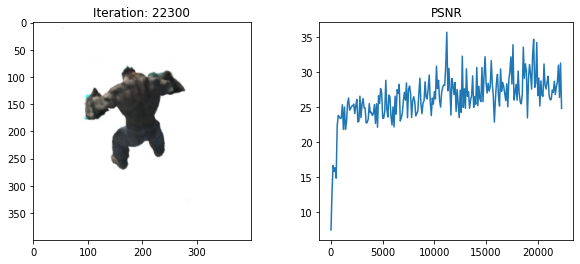

  3%|█▋                                                         | 22400/800001 [1:02:51<19:39:28, 10.99it/s]

[TRAIN] Iter: 22400 Loss_fine: 0.001103070448152721 PSNR: 29.573965072631836


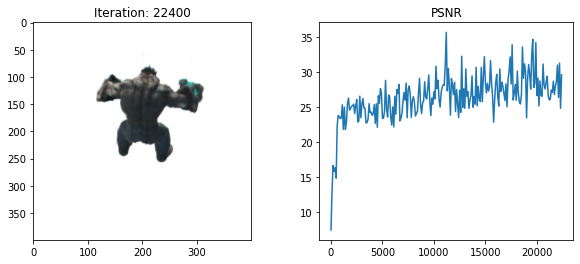

  3%|█▋                                                         | 22500/800001 [1:03:10<19:46:43, 10.92it/s]

[TRAIN] Iter: 22500 Loss_fine: 0.00121694419067353 PSNR: 29.14729118347168


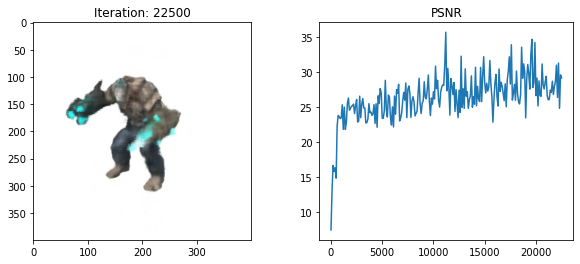

  3%|█▋                                                         | 22600/800001 [1:03:28<19:40:29, 10.98it/s]

[TRAIN] Iter: 22600 Loss_fine: 0.002552717924118042 PSNR: 25.92997169494629


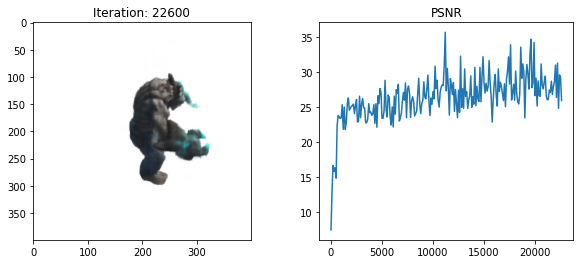

  3%|█▋                                                         | 22700/800001 [1:03:46<19:37:12, 11.00it/s]

[TRAIN] Iter: 22700 Loss_fine: 0.0006708789733238518 PSNR: 31.733558654785156


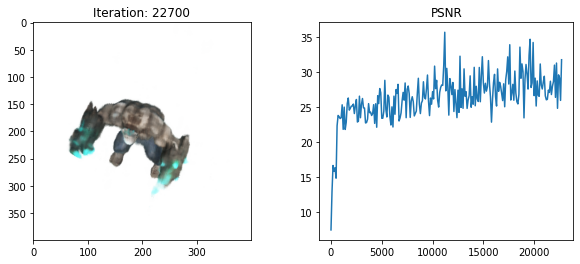

  3%|█▋                                                         | 22800/800001 [1:04:05<19:43:44, 10.94it/s]

[TRAIN] Iter: 22800 Loss_fine: 0.0007603699923492968 PSNR: 31.18975067138672


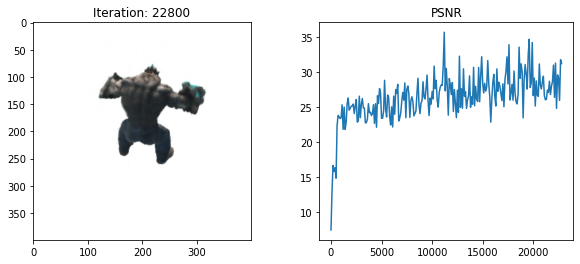

  3%|█▋                                                         | 22900/800001 [1:04:23<19:45:37, 10.92it/s]

[TRAIN] Iter: 22900 Loss_fine: 0.0009428688790649176 PSNR: 30.25548553466797


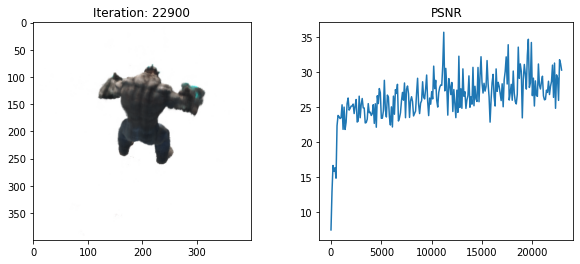

  3%|█▋                                                         | 23000/800001 [1:04:41<19:49:37, 10.89it/s]

[TRAIN] Iter: 23000 Loss_fine: 0.001343502663075924 PSNR: 28.71761703491211


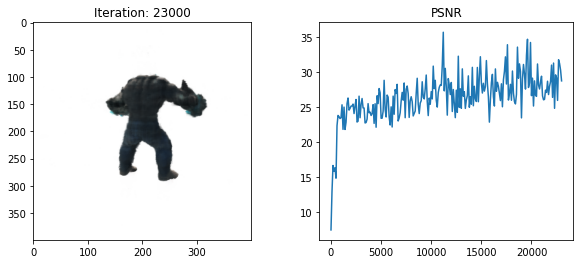

  3%|█▋                                                         | 23100/800001 [1:04:59<19:47:41, 10.90it/s]

[TRAIN] Iter: 23100 Loss_fine: 0.0020564845763146877 PSNR: 26.868743896484375


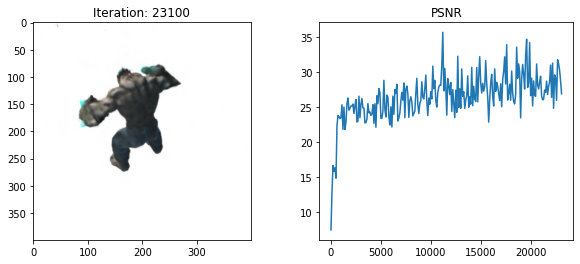

  3%|█▋                                                         | 23200/800001 [1:05:18<19:44:07, 10.93it/s]

[TRAIN] Iter: 23200 Loss_fine: 0.0005237170262262225 PSNR: 32.80903244018555


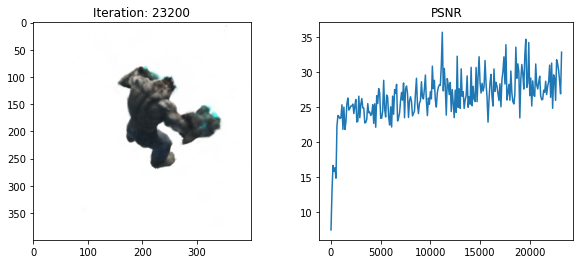

  3%|█▋                                                         | 23300/800001 [1:05:36<19:37:15, 11.00it/s]

[TRAIN] Iter: 23300 Loss_fine: 0.0012781668920069933 PSNR: 28.934123992919922


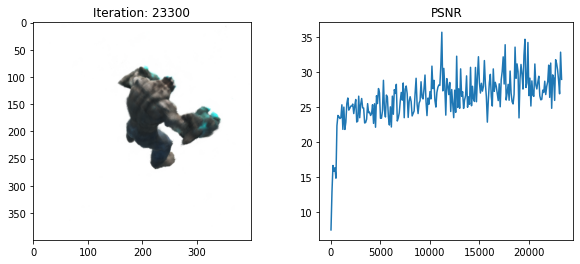

  3%|█▋                                                         | 23400/800001 [1:05:54<19:39:07, 10.98it/s]

[TRAIN] Iter: 23400 Loss_fine: 0.0025464468635618687 PSNR: 25.940654754638672


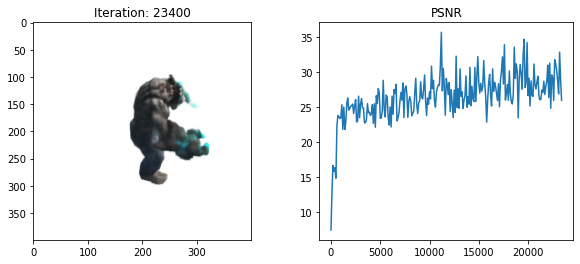

  3%|█▋                                                         | 23500/800001 [1:06:12<19:45:02, 10.92it/s]

[TRAIN] Iter: 23500 Loss_fine: 0.0008049451280385256 PSNR: 30.94233512878418


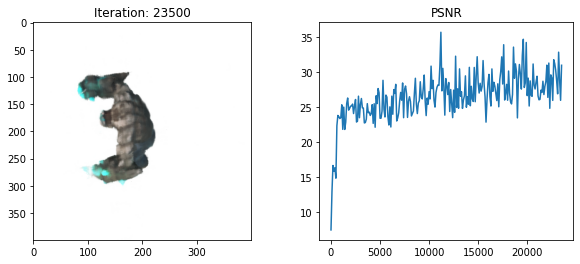

  3%|█▋                                                         | 23600/800001 [1:06:31<19:36:13, 11.00it/s]

[TRAIN] Iter: 23600 Loss_fine: 0.0016645024297758937 PSNR: 27.787155151367188


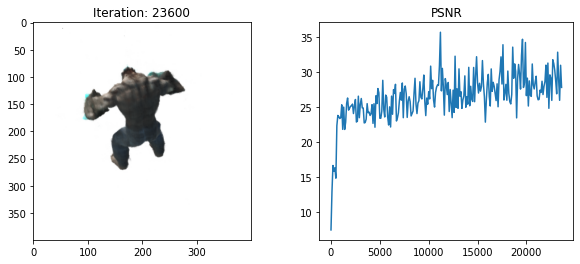

  3%|█▋                                                         | 23700/800001 [1:06:49<19:41:44, 10.95it/s]

[TRAIN] Iter: 23700 Loss_fine: 0.0011925913859158754 PSNR: 29.235084533691406


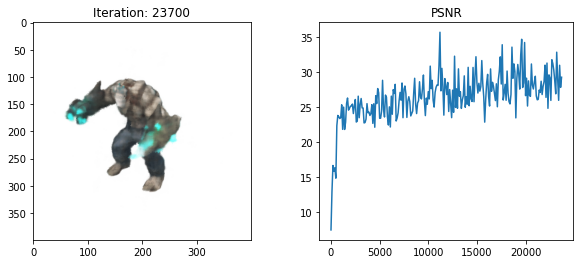

  3%|█▊                                                         | 23800/800001 [1:07:07<19:41:35, 10.95it/s]

[TRAIN] Iter: 23800 Loss_fine: 0.0011935587972402573 PSNR: 29.2315616607666


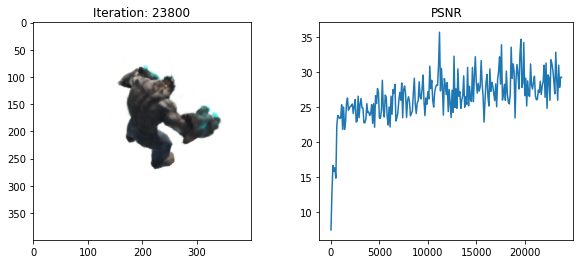

  3%|█▊                                                         | 23900/800001 [1:07:25<19:30:05, 11.05it/s]

[TRAIN] Iter: 23900 Loss_fine: 0.0020254103001207113 PSNR: 26.93486976623535


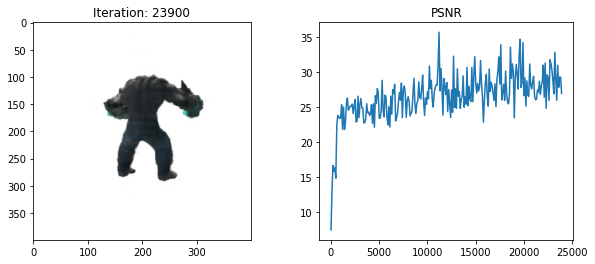

  3%|█▊                                                         | 24000/800001 [1:07:43<19:37:42, 10.98it/s]

[TRAIN] Iter: 24000 Loss_fine: 0.0012067053467035294 PSNR: 29.183988571166992


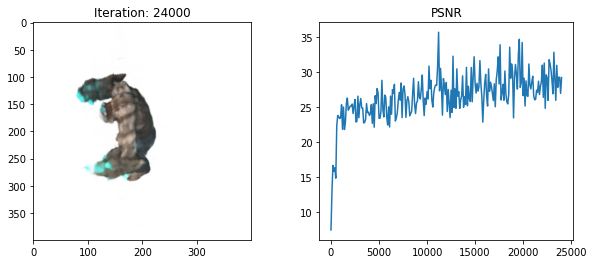

  3%|█▊                                                         | 24100/800001 [1:08:02<19:29:08, 11.06it/s]

[TRAIN] Iter: 24100 Loss_fine: 0.002759434748440981 PSNR: 25.591796875


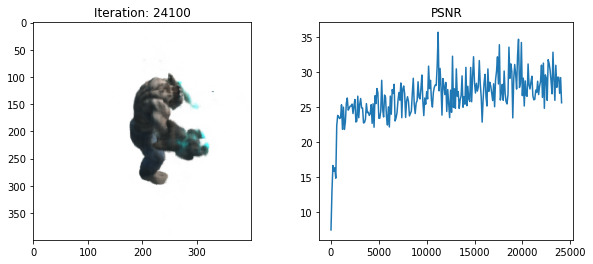

  3%|█▊                                                         | 24200/800001 [1:08:20<19:27:45, 11.07it/s]

[TRAIN] Iter: 24200 Loss_fine: 0.0010728484485298395 PSNR: 29.694616317749023


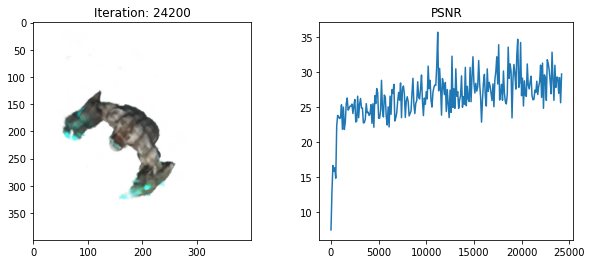

  3%|█▊                                                         | 24300/800001 [1:08:38<19:34:14, 11.01it/s]

[TRAIN] Iter: 24300 Loss_fine: 0.0015501708257943392 PSNR: 28.09620475769043


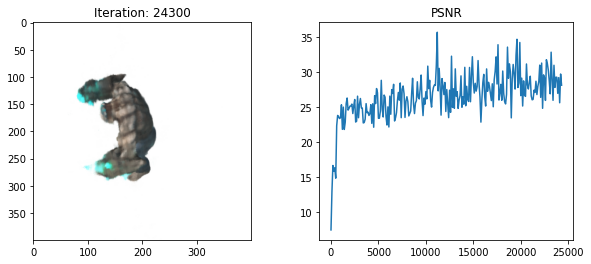

  3%|█▊                                                         | 24400/800001 [1:08:56<19:34:48, 11.00it/s]

[TRAIN] Iter: 24400 Loss_fine: 0.0027136639691889286 PSNR: 25.664440155029297


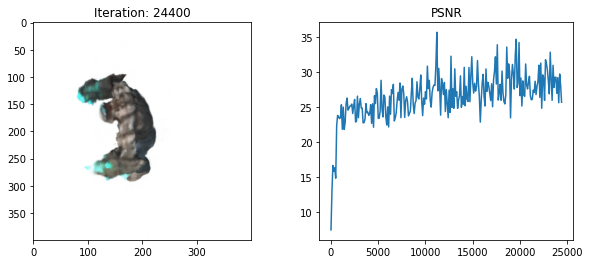

  3%|█▊                                                         | 24500/800001 [1:09:14<19:37:21, 10.98it/s]

[TRAIN] Iter: 24500 Loss_fine: 0.002237778389826417 PSNR: 26.501829147338867


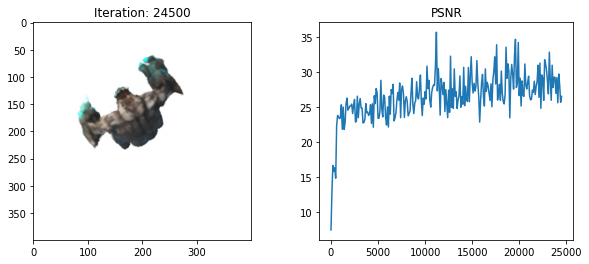

  3%|█▊                                                         | 24600/800001 [1:09:32<19:35:46, 10.99it/s]

[TRAIN] Iter: 24600 Loss_fine: 0.0018506384221836925 PSNR: 27.326784133911133


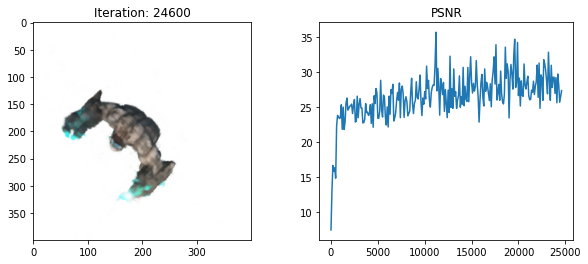

  3%|█▊                                                         | 24700/800001 [1:09:50<19:52:48, 10.83it/s]

[TRAIN] Iter: 24700 Loss_fine: 0.0009669855353422463 PSNR: 30.14579963684082


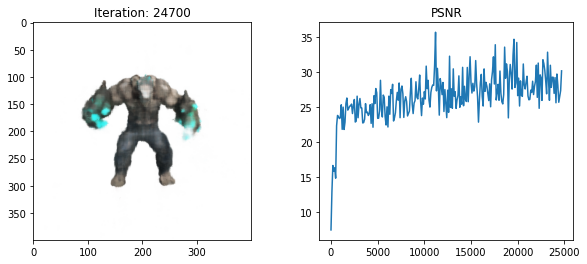

  3%|█▊                                                         | 24800/800001 [1:10:09<19:43:33, 10.92it/s]

[TRAIN] Iter: 24800 Loss_fine: 0.0012599513866007328 PSNR: 28.996461868286133


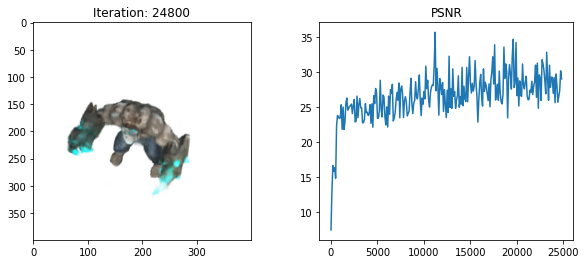

  3%|█▊                                                         | 24900/800001 [1:10:27<19:45:23, 10.90it/s]

[TRAIN] Iter: 24900 Loss_fine: 0.0005996545078232884 PSNR: 32.22098922729492


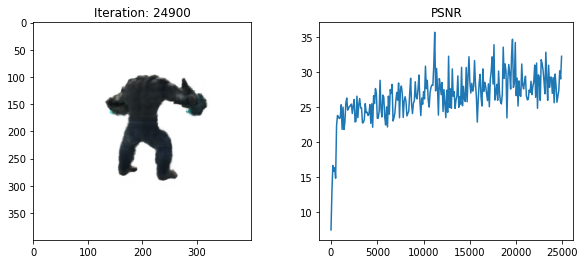

  3%|█▊                                                         | 25000/800001 [1:10:45<20:36:59, 10.44it/s]

[TRAIN] Iter: 25000 Loss_fine: 0.0012715995544567704 PSNR: 28.95649528503418


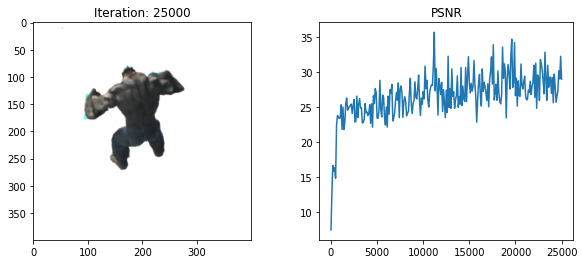

  3%|█▊                                                         | 25100/800001 [1:11:02<17:56:39, 12.00it/s]

[TRAIN] Iter: 25100 Loss_fine: 0.0011257395381107926 PSNR: 29.485620498657227


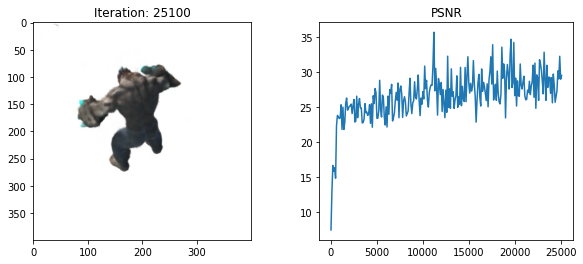

  3%|█▊                                                         | 25200/800001 [1:11:20<19:47:35, 10.87it/s]

[TRAIN] Iter: 25200 Loss_fine: 0.0012876413529738784 PSNR: 28.902050018310547


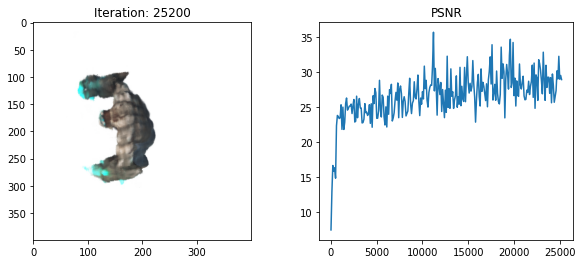

  3%|█▊                                                         | 25300/800001 [1:11:37<18:57:54, 11.35it/s]

[TRAIN] Iter: 25300 Loss_fine: 0.0011889146408066154 PSNR: 29.248493194580078


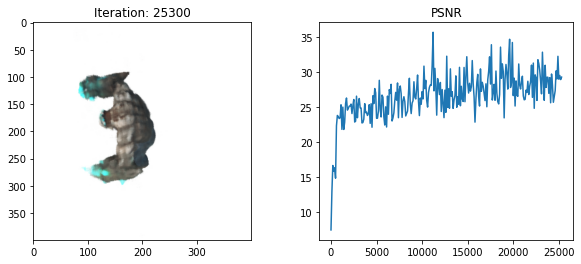

  3%|█▊                                                         | 25400/800001 [1:11:54<18:47:50, 11.45it/s]

[TRAIN] Iter: 25400 Loss_fine: 0.0013500084169209003 PSNR: 28.696636199951172


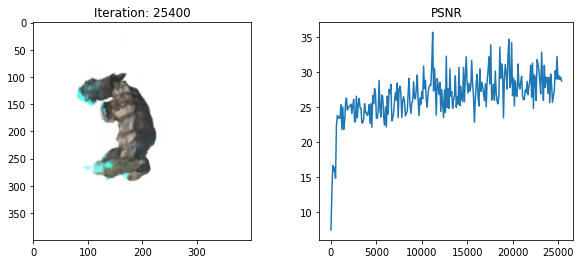

  3%|█▉                                                         | 25500/800001 [1:12:12<18:46:09, 11.46it/s]

[TRAIN] Iter: 25500 Loss_fine: 0.0020515983924269676 PSNR: 26.87907600402832


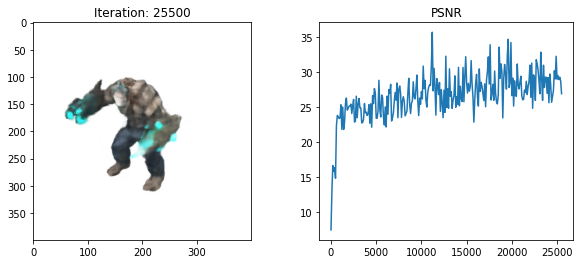

  3%|█▉                                                         | 25600/800001 [1:12:30<19:15:12, 11.17it/s]

[TRAIN] Iter: 25600 Loss_fine: 0.0013959573116153479 PSNR: 28.55127716064453


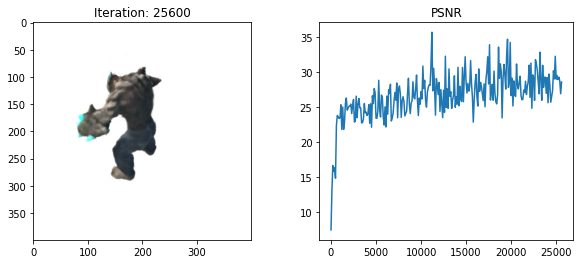

  3%|█▉                                                         | 25700/800001 [1:12:48<19:01:34, 11.30it/s]

[TRAIN] Iter: 25700 Loss_fine: 0.002395771909505129 PSNR: 26.20554542541504


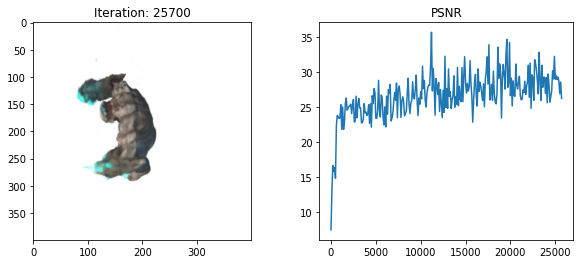

  3%|█▉                                                         | 25800/800001 [1:13:06<19:24:55, 11.08it/s]

[TRAIN] Iter: 25800 Loss_fine: 0.002153470879420638 PSNR: 26.668609619140625


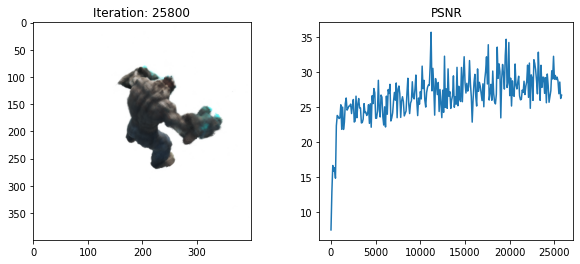

  3%|█▉                                                         | 25900/800001 [1:13:23<18:49:50, 11.42it/s]

[TRAIN] Iter: 25900 Loss_fine: 0.0006019538268446922 PSNR: 32.204368591308594


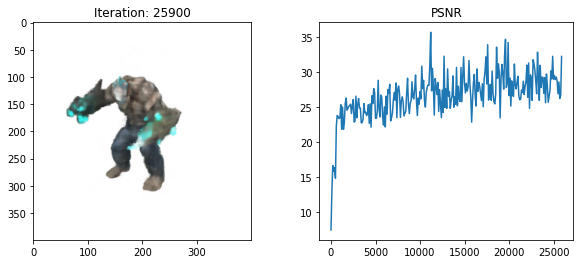

  3%|█▉                                                         | 26000/800001 [1:13:42<20:17:52, 10.59it/s]

[TRAIN] Iter: 26000 Loss_fine: 0.0010793654946610332 PSNR: 29.66831398010254


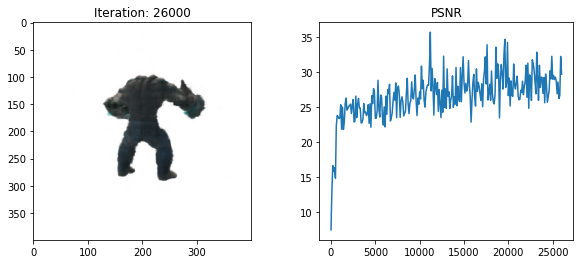

  3%|█▉                                                         | 26100/800001 [1:14:00<19:00:31, 11.31it/s]

[TRAIN] Iter: 26100 Loss_fine: 0.0011362001532688737 PSNR: 29.445451736450195


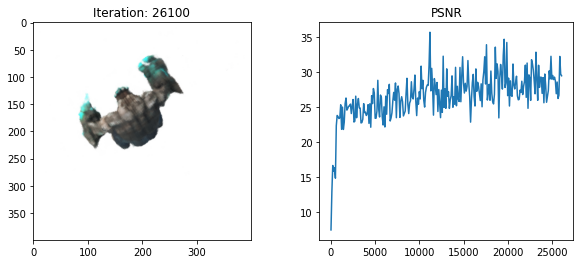

  3%|█▉                                                         | 26200/800001 [1:14:17<19:00:46, 11.31it/s]

[TRAIN] Iter: 26200 Loss_fine: 0.0023037195205688477 PSNR: 26.375703811645508


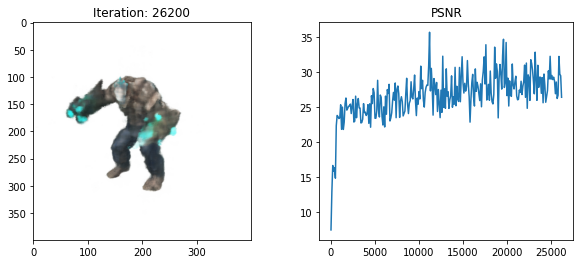

  3%|█▉                                                         | 26300/800001 [1:14:35<19:19:16, 11.12it/s]

[TRAIN] Iter: 26300 Loss_fine: 0.0014841731172055006 PSNR: 28.285154342651367


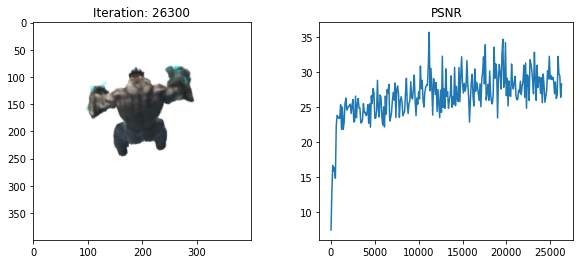

  3%|█▉                                                         | 26400/800001 [1:14:53<19:14:05, 11.17it/s]

[TRAIN] Iter: 26400 Loss_fine: 0.0023857709020376205 PSNR: 26.223711013793945


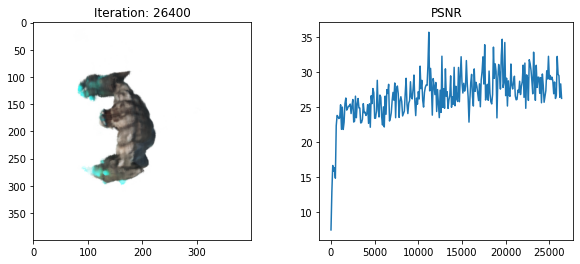

  3%|█▉                                                         | 26500/800001 [1:15:11<19:15:19, 11.16it/s]

[TRAIN] Iter: 26500 Loss_fine: 0.001082726987078786 PSNR: 29.654809951782227


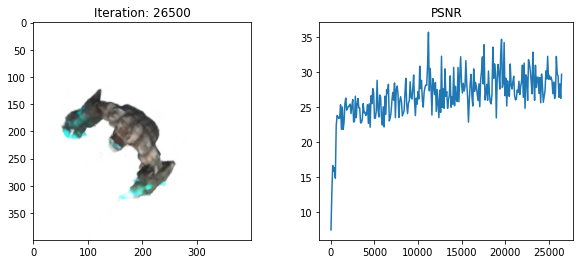

  3%|█▉                                                         | 26600/800001 [1:15:29<19:09:21, 11.21it/s]

[TRAIN] Iter: 26600 Loss_fine: 0.0010960898362100124 PSNR: 29.601539611816406


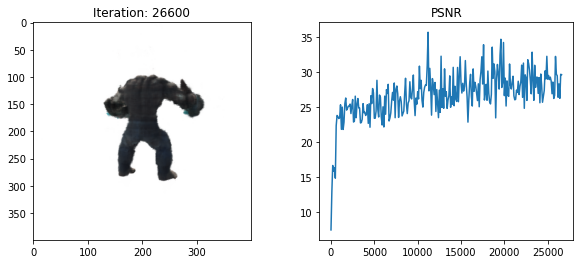

  3%|█▉                                                         | 26700/800001 [1:15:47<20:35:35, 10.43it/s]

[TRAIN] Iter: 26700 Loss_fine: 0.0015361319528892636 PSNR: 28.13571548461914


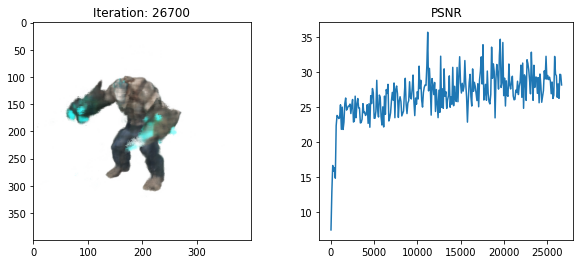

  3%|█▉                                                         | 26800/800001 [1:16:06<20:24:55, 10.52it/s]

[TRAIN] Iter: 26800 Loss_fine: 0.0008588442578911781 PSNR: 30.66085433959961


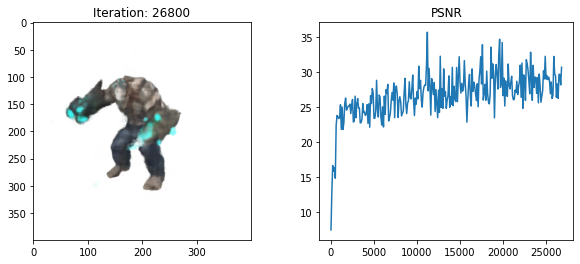

  3%|█▉                                                         | 26900/800001 [1:16:25<20:21:03, 10.55it/s]

[TRAIN] Iter: 26900 Loss_fine: 0.00314779463224113 PSNR: 25.019935607910156


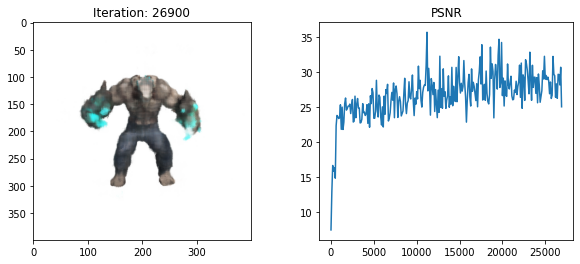

  3%|█▉                                                         | 27000/800001 [1:16:43<18:51:42, 11.38it/s]

[TRAIN] Iter: 27000 Loss_fine: 0.0013118996284902096 PSNR: 28.820995330810547


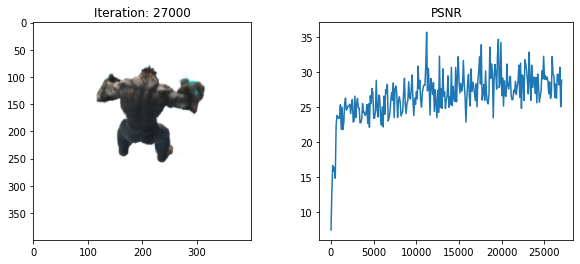

  3%|█▉                                                         | 27100/800001 [1:17:01<18:55:02, 11.35it/s]

[TRAIN] Iter: 27100 Loss_fine: 0.0008118007681332529 PSNR: 30.905506134033203


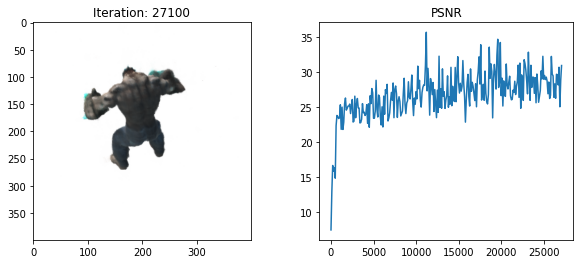

  3%|██                                                         | 27200/800001 [1:17:18<18:54:37, 11.35it/s]

[TRAIN] Iter: 27200 Loss_fine: 0.000596818863414228 PSNR: 32.241573333740234


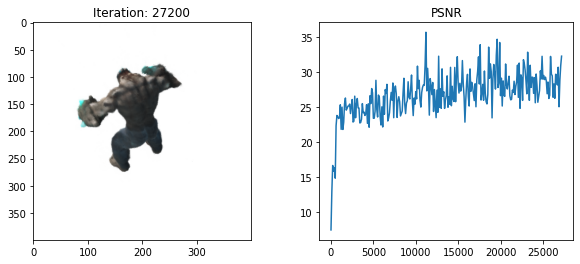

  3%|██                                                         | 27300/800001 [1:17:36<18:44:10, 11.46it/s]

[TRAIN] Iter: 27300 Loss_fine: 0.0023880191147327423 PSNR: 26.219621658325195


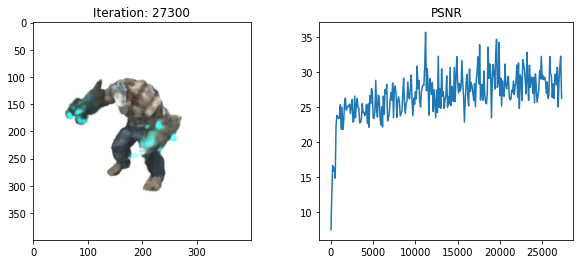

  3%|██                                                         | 27400/800001 [1:17:54<18:45:39, 11.44it/s]

[TRAIN] Iter: 27400 Loss_fine: 0.0014787892578169703 PSNR: 28.300935745239258


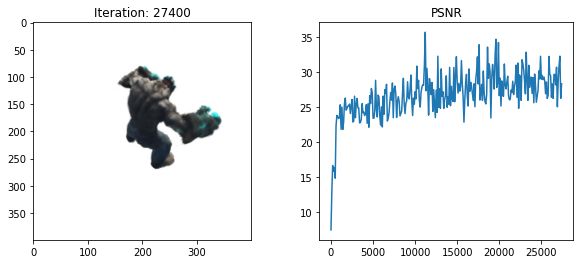

  3%|██                                                         | 27500/800001 [1:18:11<19:00:23, 11.29it/s]

[TRAIN] Iter: 27500 Loss_fine: 0.002228878904134035 PSNR: 26.519134521484375


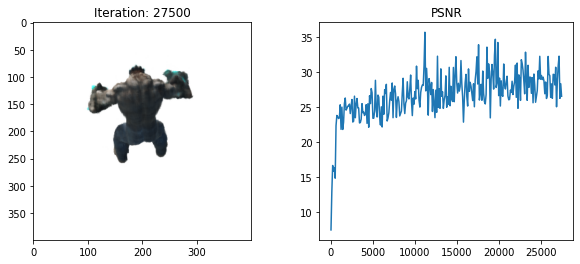

  3%|██                                                         | 27600/800001 [1:18:29<18:57:38, 11.32it/s]

[TRAIN] Iter: 27600 Loss_fine: 0.002428559586405754 PSNR: 26.14651107788086


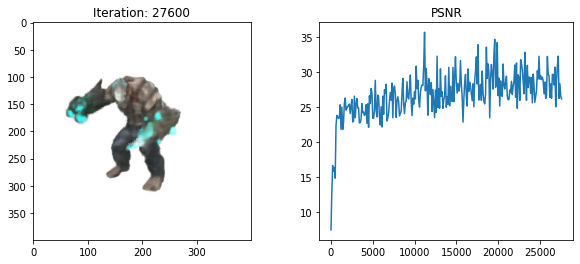

  3%|██                                                         | 27700/800001 [1:18:47<19:17:32, 11.12it/s]

[TRAIN] Iter: 27700 Loss_fine: 0.002441178075969219 PSNR: 26.124004364013672


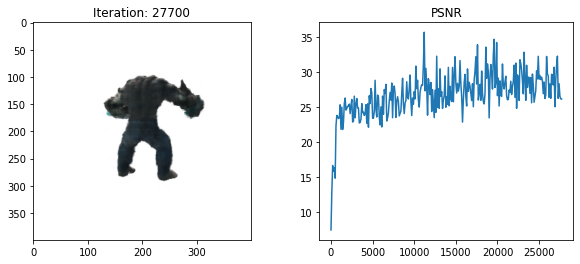

  3%|██                                                         | 27800/800001 [1:19:05<20:03:53, 10.69it/s]

[TRAIN] Iter: 27800 Loss_fine: 0.0010579499648883939 PSNR: 29.755348205566406


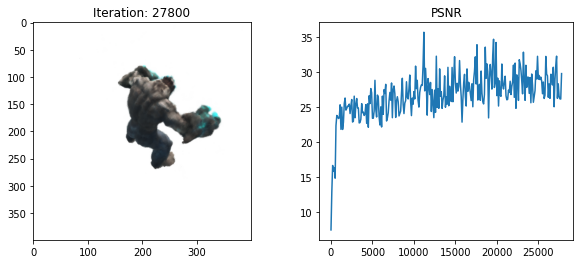

  3%|██                                                         | 27900/800001 [1:19:23<19:51:22, 10.80it/s]

[TRAIN] Iter: 27900 Loss_fine: 0.0030708485282957554 PSNR: 25.12741470336914


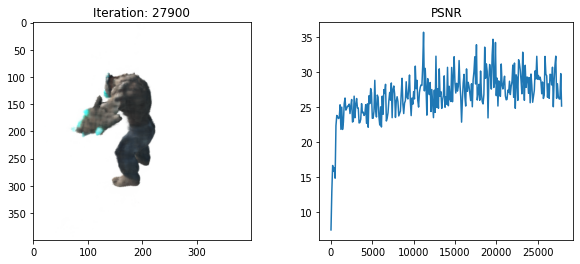

  3%|██                                                         | 28000/800001 [1:19:41<19:30:40, 10.99it/s]

[TRAIN] Iter: 28000 Loss_fine: 0.000911693787202239 PSNR: 30.401512145996094


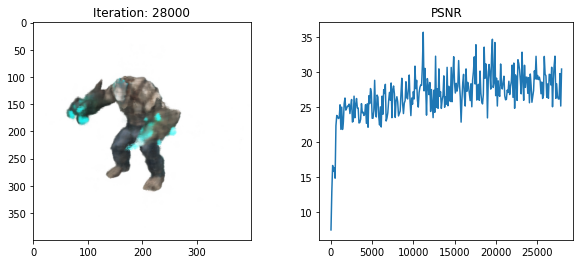

  4%|██                                                         | 28100/800001 [1:19:59<19:04:26, 11.24it/s]

[TRAIN] Iter: 28100 Loss_fine: 0.0011184060713276267 PSNR: 29.514005661010742


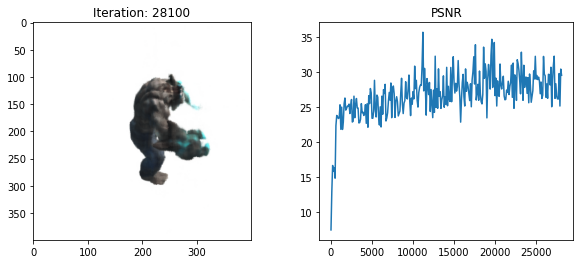

  4%|██                                                         | 28200/800001 [1:20:17<18:56:37, 11.32it/s]

[TRAIN] Iter: 28200 Loss_fine: 0.0024606813676655293 PSNR: 26.089445114135742


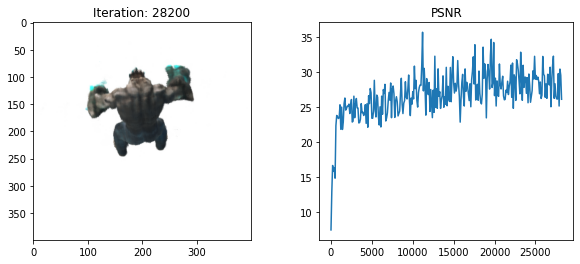

  4%|██                                                         | 28300/800001 [1:20:35<19:59:50, 10.72it/s]

[TRAIN] Iter: 28300 Loss_fine: 0.0011190940858796239 PSNR: 29.51133155822754


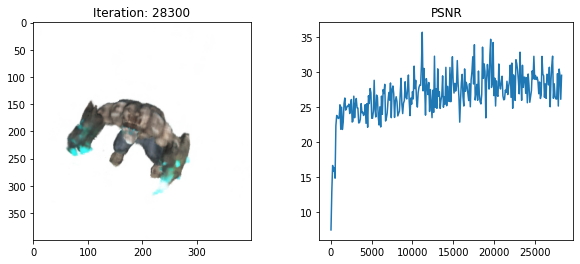

  4%|██                                                         | 28399/800001 [1:20:53<19:03:31, 11.25it/s]

[TRAIN] Iter: 28400 Loss_fine: 0.00041099710506387055 PSNR: 33.86161422729492


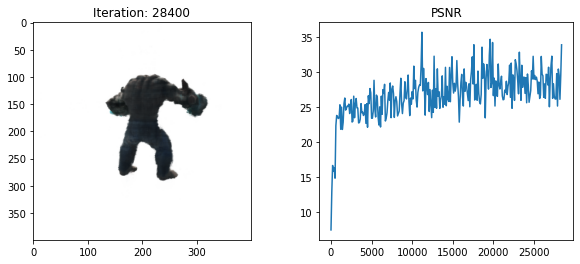

  4%|██                                                         | 28499/800001 [1:21:11<19:01:53, 11.26it/s]

[TRAIN] Iter: 28500 Loss_fine: 0.001334846019744873 PSNR: 28.74568748474121


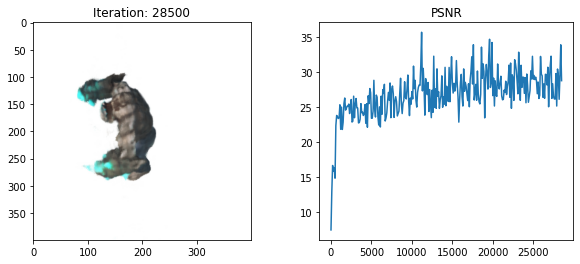

  4%|██                                                         | 28599/800001 [1:21:29<19:05:34, 11.22it/s]

[TRAIN] Iter: 28600 Loss_fine: 0.0013057462638244033 PSNR: 28.841411590576172


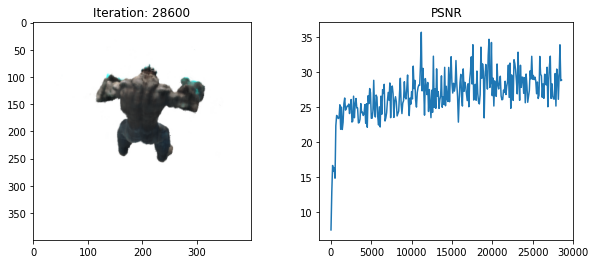

  4%|██                                                         | 28699/800001 [1:21:46<19:35:48, 10.93it/s]

[TRAIN] Iter: 28700 Loss_fine: 0.0011308216489851475 PSNR: 29.466060638427734


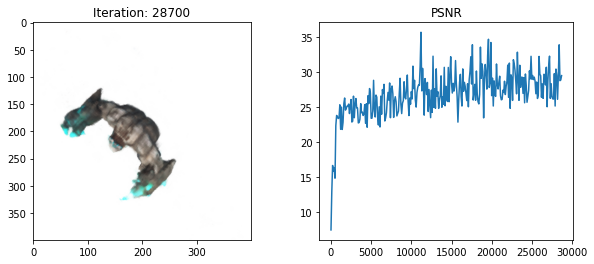

  4%|██                                                         | 28799/800001 [1:22:04<18:55:44, 11.32it/s]

[TRAIN] Iter: 28800 Loss_fine: 0.0014153592055663466 PSNR: 28.4913330078125


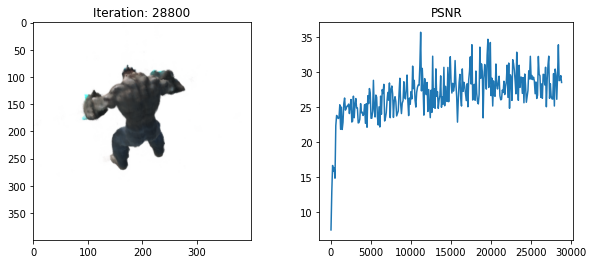

  4%|██▏                                                        | 28899/800001 [1:22:22<20:02:17, 10.69it/s]

[TRAIN] Iter: 28900 Loss_fine: 0.001839066855609417 PSNR: 27.35402488708496


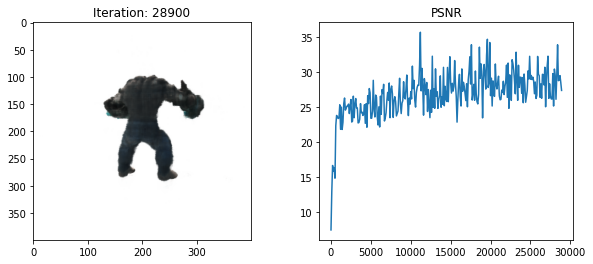

  4%|██▏                                                        | 28999/800001 [1:22:41<20:02:43, 10.68it/s]

[TRAIN] Iter: 29000 Loss_fine: 0.0012544632190838456 PSNR: 29.015419006347656


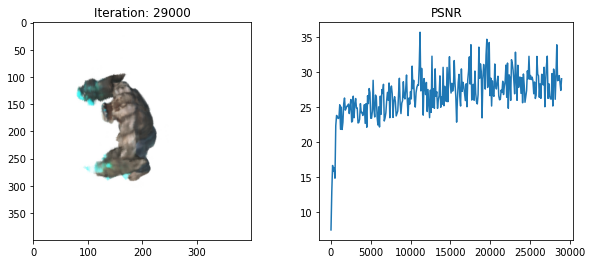

  4%|██▏                                                        | 29099/800001 [1:23:00<20:06:58, 10.65it/s]

[TRAIN] Iter: 29100 Loss_fine: 0.00048410738236270845 PSNR: 33.15058135986328


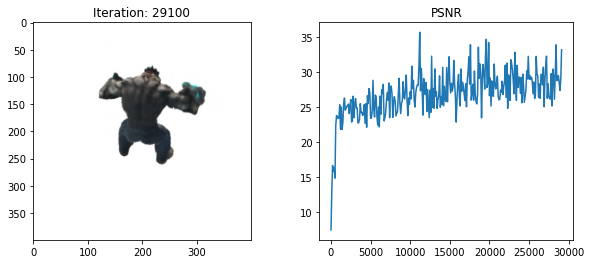

  4%|██▏                                                        | 29199/800001 [1:23:18<20:07:05, 10.64it/s]

[TRAIN] Iter: 29200 Loss_fine: 0.0021225439850240946 PSNR: 26.73143196105957


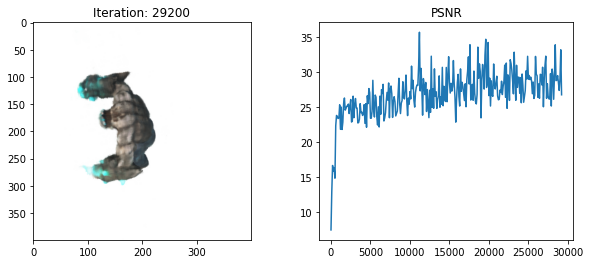

  4%|██▏                                                        | 29300/800001 [1:23:37<20:03:15, 10.68it/s]

[TRAIN] Iter: 29300 Loss_fine: 0.000829074124339968 PSNR: 30.81406593322754


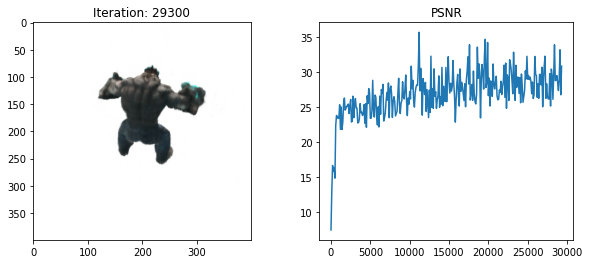

  4%|██▏                                                        | 29400/800001 [1:23:55<20:01:58, 10.69it/s]

[TRAIN] Iter: 29400 Loss_fine: 0.0012177410535514355 PSNR: 29.14444923400879


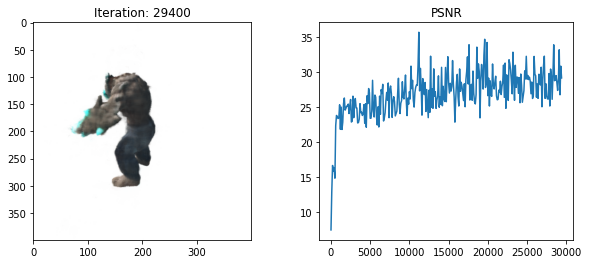

  4%|██▏                                                        | 29500/800001 [1:24:13<19:02:15, 11.24it/s]

[TRAIN] Iter: 29500 Loss_fine: 0.0011760260676965117 PSNR: 29.295827865600586


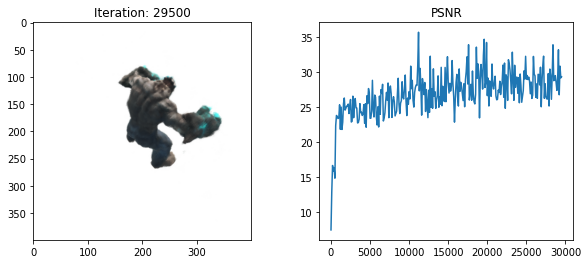

  4%|██▏                                                        | 29600/800001 [1:24:31<18:59:21, 11.27it/s]

[TRAIN] Iter: 29600 Loss_fine: 0.0009363472345285118 PSNR: 30.28563117980957


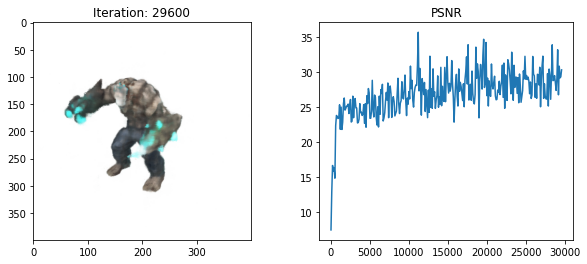

  4%|██▏                                                        | 29700/800001 [1:24:49<19:09:56, 11.16it/s]

[TRAIN] Iter: 29700 Loss_fine: 0.0007199026877060533 PSNR: 31.427261352539062


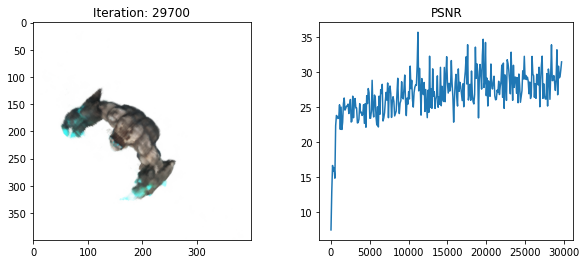

  4%|██▏                                                        | 29800/800001 [1:25:07<19:10:44, 11.16it/s]

[TRAIN] Iter: 29800 Loss_fine: 0.0010170458117499948 PSNR: 29.926593780517578


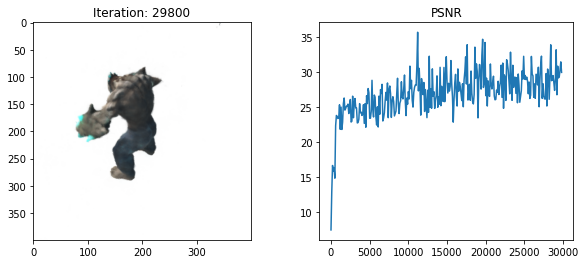

  4%|██▏                                                        | 29900/800001 [1:25:25<18:59:05, 11.27it/s]

[TRAIN] Iter: 29900 Loss_fine: 0.0008421370293945074 PSNR: 30.746171951293945


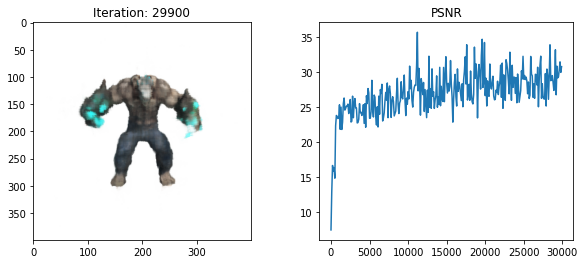

  4%|██▏                                                        | 30000/800001 [1:25:43<19:26:21, 11.00it/s]

[TRAIN] Iter: 30000 Loss_fine: 0.00032534467754885554 PSNR: 34.87656021118164


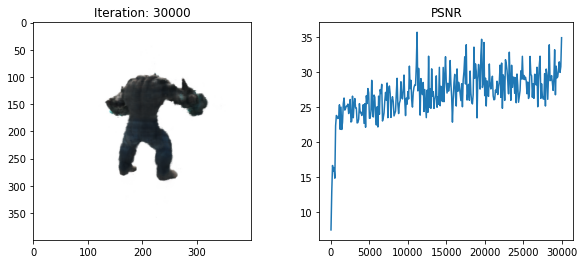

  4%|██▏                                                        | 30100/800001 [1:26:00<19:03:27, 11.22it/s]

[TRAIN] Iter: 30100 Loss_fine: 0.001220698468387127 PSNR: 29.133914947509766


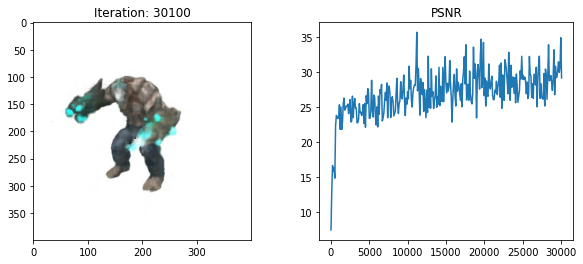

  4%|██▏                                                        | 30200/800001 [1:26:18<19:02:59, 11.22it/s]

[TRAIN] Iter: 30200 Loss_fine: 0.0007129557779990137 PSNR: 31.469375610351562


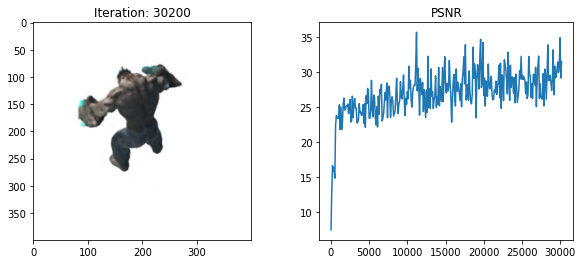

  4%|██▏                                                        | 30300/800001 [1:26:36<19:28:59, 10.97it/s]

[TRAIN] Iter: 30300 Loss_fine: 0.000984846381470561 PSNR: 30.066316604614258


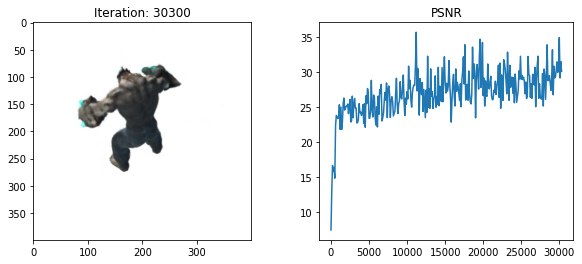

  4%|██▏                                                        | 30400/800001 [1:26:54<19:55:03, 10.73it/s]

[TRAIN] Iter: 30400 Loss_fine: 0.0005838903016410768 PSNR: 32.33668899536133


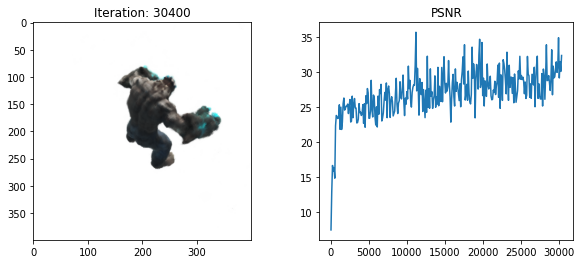

  4%|██▏                                                        | 30500/800001 [1:27:12<19:03:18, 11.22it/s]

[TRAIN] Iter: 30500 Loss_fine: 0.0023589625488966703 PSNR: 26.272789001464844


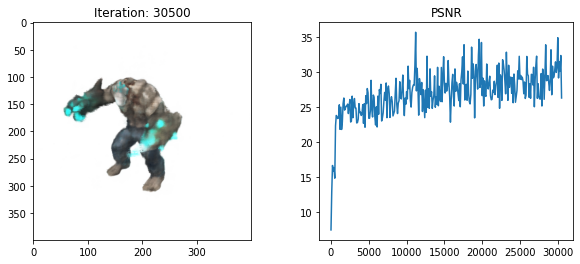

  4%|██▎                                                        | 30600/800001 [1:27:30<18:54:53, 11.30it/s]

[TRAIN] Iter: 30600 Loss_fine: 0.0022597333882004023 PSNR: 26.459426879882812


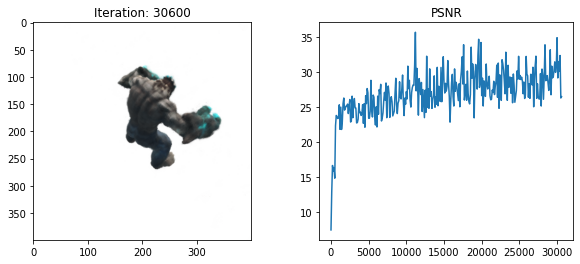

  4%|██▎                                                        | 30700/800001 [1:27:48<18:50:44, 11.34it/s]

[TRAIN] Iter: 30700 Loss_fine: 0.0006526948418468237 PSNR: 31.85289764404297


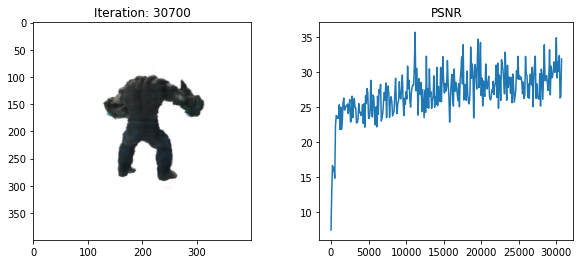

  4%|██▎                                                        | 30800/800001 [1:28:05<19:53:41, 10.74it/s]

[TRAIN] Iter: 30800 Loss_fine: 0.0005940556875430048 PSNR: 32.26172637939453


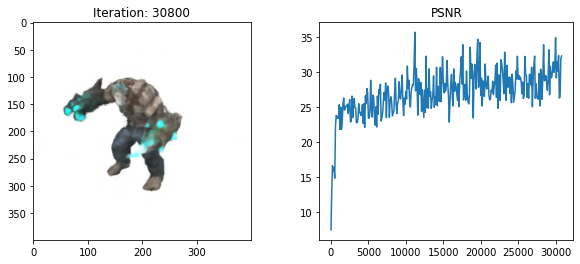

  4%|██▎                                                        | 30900/800001 [1:28:24<19:58:19, 10.70it/s]

[TRAIN] Iter: 30900 Loss_fine: 0.003418395994231105 PSNR: 24.66177749633789


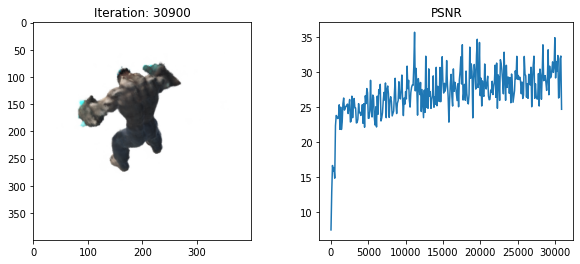

  4%|██▎                                                        | 31000/800001 [1:28:43<19:56:24, 10.71it/s]

[TRAIN] Iter: 31000 Loss_fine: 0.0007129135192371905 PSNR: 31.469629287719727


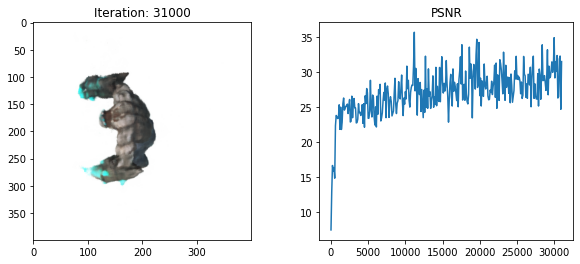

  4%|██▎                                                        | 31100/800001 [1:29:01<18:54:37, 11.29it/s]

[TRAIN] Iter: 31100 Loss_fine: 0.001204238855279982 PSNR: 29.192874908447266


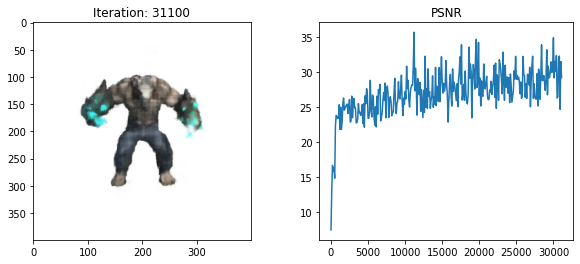

  4%|██▎                                                        | 31200/800001 [1:29:19<19:41:38, 10.84it/s]

[TRAIN] Iter: 31200 Loss_fine: 0.0010672523640096188 PSNR: 29.717329025268555


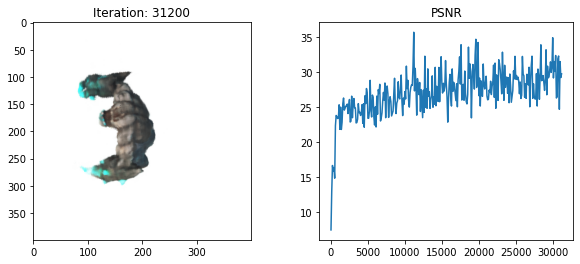

  4%|██▎                                                        | 31300/800001 [1:29:37<19:13:48, 11.10it/s]

[TRAIN] Iter: 31300 Loss_fine: 0.0016739651327952743 PSNR: 27.76253318786621


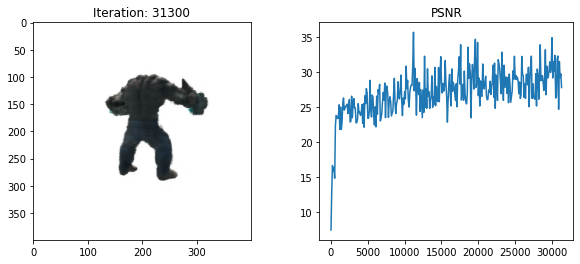

  4%|██▎                                                        | 31400/800001 [1:29:55<19:18:02, 11.06it/s]

[TRAIN] Iter: 31400 Loss_fine: 0.00036981917219236493 PSNR: 34.320106506347656


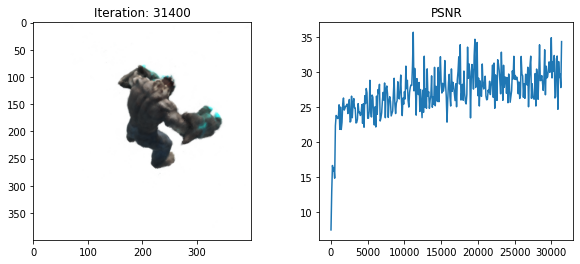

  4%|██▎                                                        | 31500/800001 [1:30:13<19:02:43, 11.21it/s]

[TRAIN] Iter: 31500 Loss_fine: 0.0019743822049349546 PSNR: 27.04568862915039


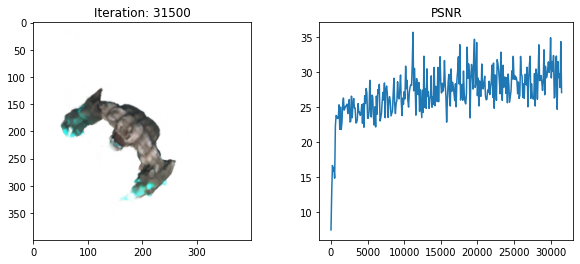

  4%|██▎                                                        | 31600/800001 [1:30:30<18:59:31, 11.24it/s]

[TRAIN] Iter: 31600 Loss_fine: 0.0013903495855629444 PSNR: 28.568758010864258


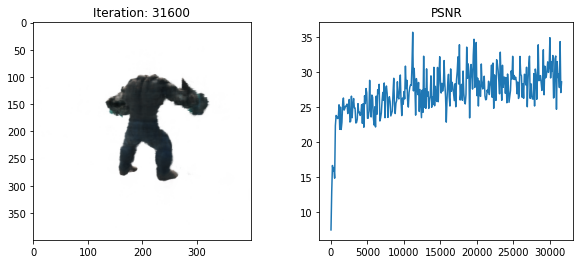

  4%|██▎                                                        | 31700/800001 [1:30:48<19:03:18, 11.20it/s]

[TRAIN] Iter: 31700 Loss_fine: 0.0022563524544239044 PSNR: 26.46592903137207


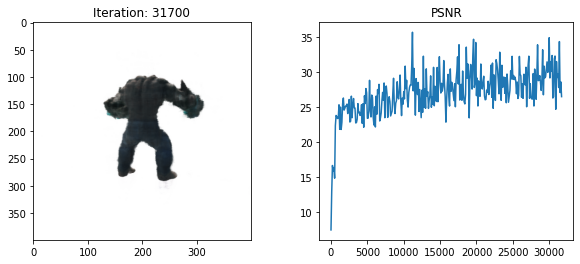

  4%|██▎                                                        | 31800/800001 [1:31:06<19:06:29, 11.17it/s]

[TRAIN] Iter: 31800 Loss_fine: 0.0017052515177056193 PSNR: 27.682113647460938


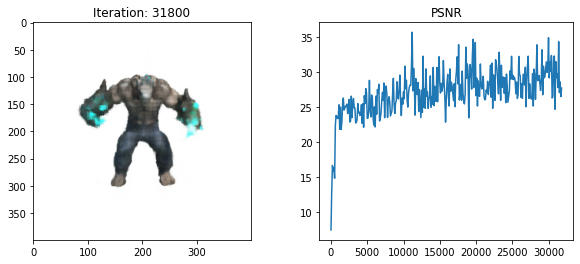

  4%|██▎                                                        | 31900/800001 [1:31:24<18:57:19, 11.26it/s]

[TRAIN] Iter: 31900 Loss_fine: 0.0012602385831996799 PSNR: 28.995471954345703


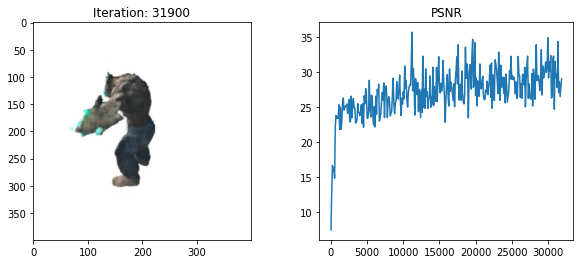

  4%|██▎                                                        | 32000/800001 [1:31:42<19:14:01, 11.09it/s]

[TRAIN] Iter: 32000 Loss_fine: 0.001450406271032989 PSNR: 28.385103225708008


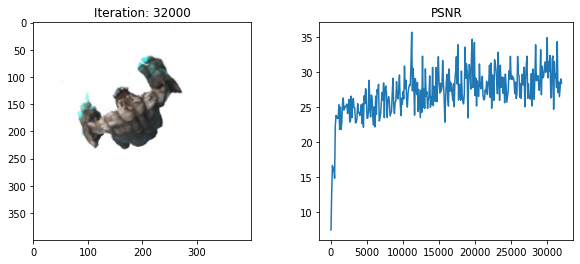

  4%|██▎                                                        | 32100/800001 [1:31:58<17:30:59, 12.18it/s]

[TRAIN] Iter: 32100 Loss_fine: 0.0005470000905916095 PSNR: 32.6201286315918


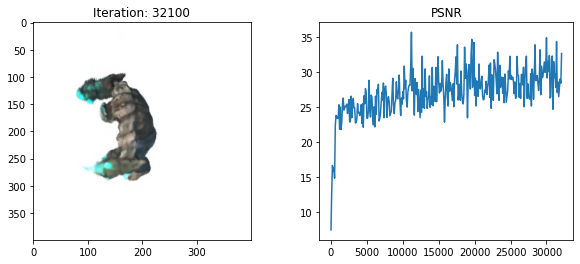

  4%|██▎                                                        | 32200/800001 [1:32:15<17:28:05, 12.21it/s]

[TRAIN] Iter: 32200 Loss_fine: 0.0017815576866269112 PSNR: 27.492000579833984


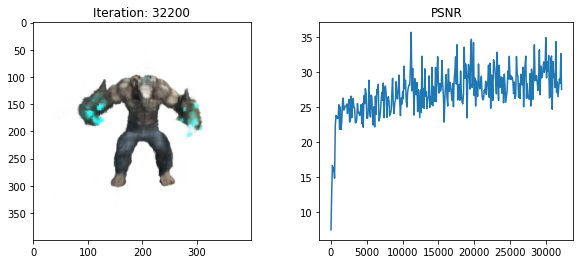

  4%|██▍                                                        | 32300/800001 [1:32:31<17:30:04, 12.18it/s]

[TRAIN] Iter: 32300 Loss_fine: 0.0007405298529192805 PSNR: 31.30457305908203


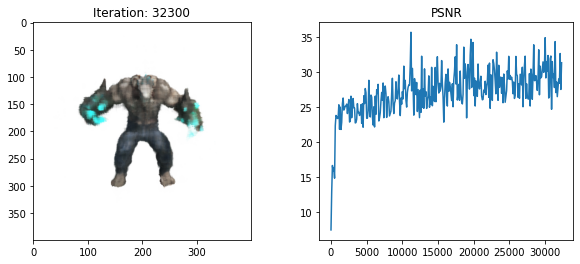

  4%|██▍                                                        | 32400/800001 [1:32:48<17:27:36, 12.21it/s]

[TRAIN] Iter: 32400 Loss_fine: 0.0012717775534838438 PSNR: 28.955888748168945


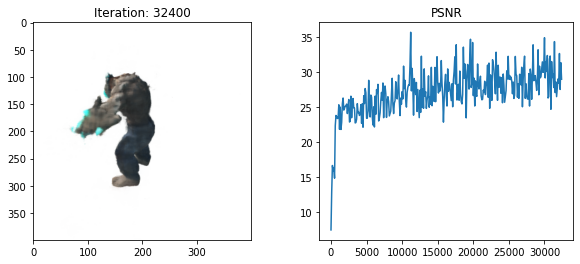

  4%|██▍                                                        | 32500/800001 [1:33:04<17:27:08, 12.22it/s]

[TRAIN] Iter: 32500 Loss_fine: 0.0019046770175918937 PSNR: 27.201786041259766


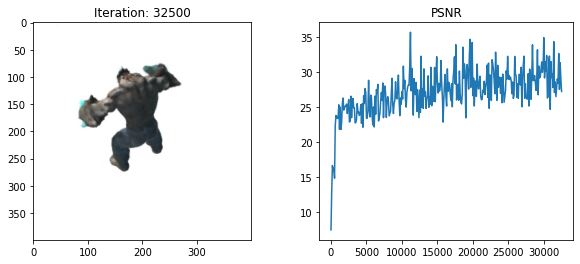

  4%|██▍                                                        | 32600/800001 [1:33:21<17:27:04, 12.21it/s]

[TRAIN] Iter: 32600 Loss_fine: 0.0020111287012696266 PSNR: 26.965600967407227


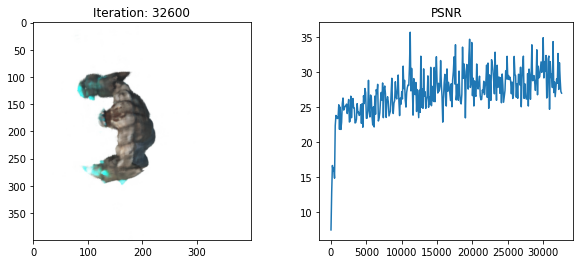

  4%|██▍                                                        | 32700/800001 [1:33:37<17:28:15, 12.20it/s]

[TRAIN] Iter: 32700 Loss_fine: 0.000621619401499629 PSNR: 32.064754486083984


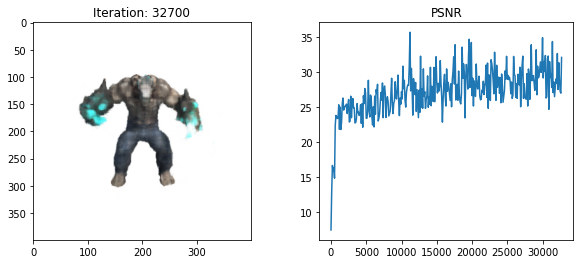

  4%|██▍                                                        | 32800/800001 [1:33:54<17:25:59, 12.22it/s]

[TRAIN] Iter: 32800 Loss_fine: 0.0028021768666803837 PSNR: 25.52504539489746


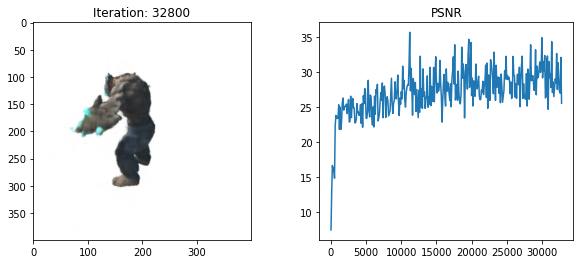

  4%|██▍                                                        | 32900/800001 [1:34:10<17:31:43, 12.16it/s]

[TRAIN] Iter: 32900 Loss_fine: 0.001250681234523654 PSNR: 29.028532028198242


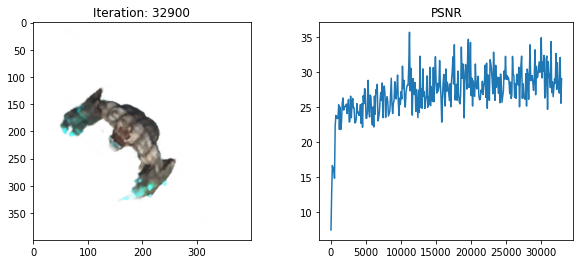

  4%|██▍                                                        | 33000/800001 [1:34:26<17:24:21, 12.24it/s]

[TRAIN] Iter: 33000 Loss_fine: 0.0007703582523390651 PSNR: 31.133071899414062


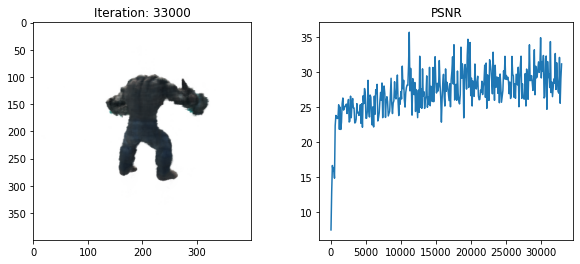

  4%|██▍                                                        | 33100/800001 [1:34:43<17:26:32, 12.21it/s]

[TRAIN] Iter: 33100 Loss_fine: 0.001295546069741249 PSNR: 28.875469207763672


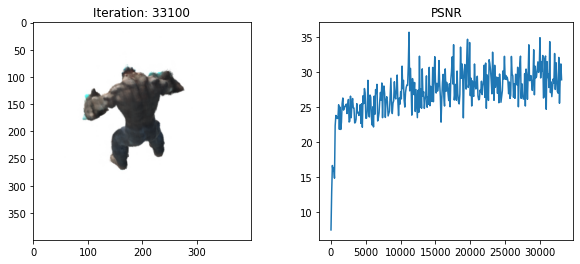

  4%|██▍                                                        | 33200/800001 [1:34:59<17:24:57, 12.23it/s]

[TRAIN] Iter: 33200 Loss_fine: 0.0020350238773971796 PSNR: 26.914302825927734


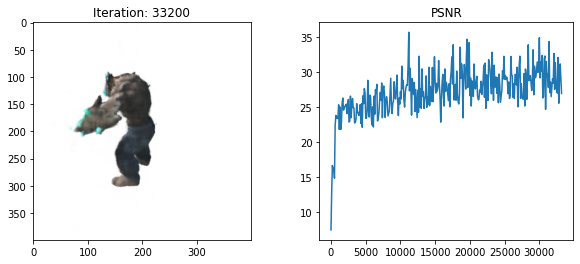

  4%|██▍                                                        | 33300/800001 [1:35:16<17:25:44, 12.22it/s]

[TRAIN] Iter: 33300 Loss_fine: 0.0010093218879774213 PSNR: 29.959701538085938


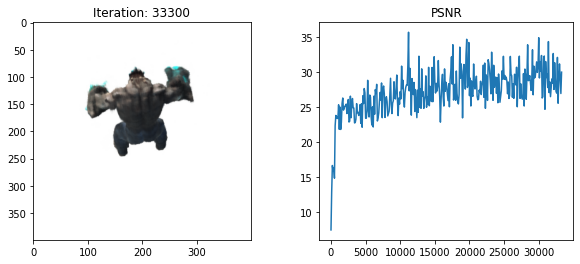

  4%|██▍                                                        | 33400/800001 [1:35:32<18:23:54, 11.57it/s]

[TRAIN] Iter: 33400 Loss_fine: 0.0019993390887975693 PSNR: 26.99113655090332


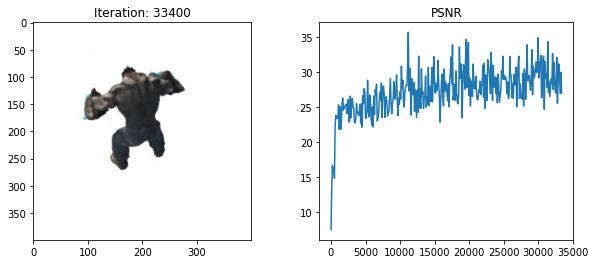

  4%|██▍                                                        | 33500/800001 [1:35:49<17:43:35, 12.01it/s]

[TRAIN] Iter: 33500 Loss_fine: 0.0018949077930301428 PSNR: 27.224119186401367


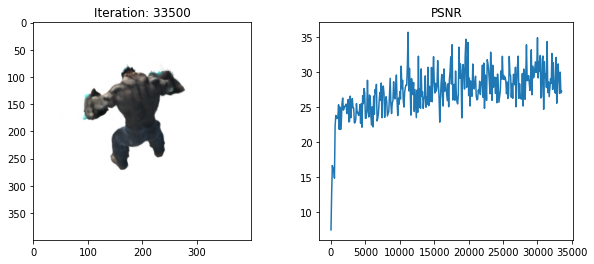

  4%|██▍                                                        | 33600/800001 [1:36:06<17:42:48, 12.02it/s]

[TRAIN] Iter: 33600 Loss_fine: 0.001970767043530941 PSNR: 27.053646087646484


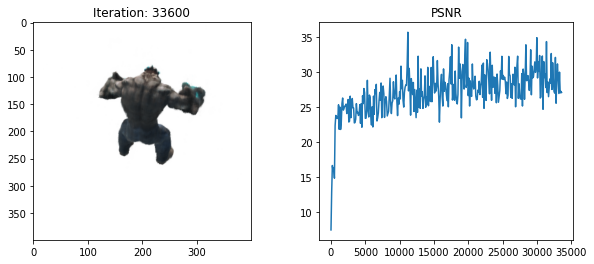

  4%|██▍                                                        | 33700/800001 [1:36:22<17:43:48, 12.01it/s]

[TRAIN] Iter: 33700 Loss_fine: 0.0039611998945474625 PSNR: 24.021732330322266


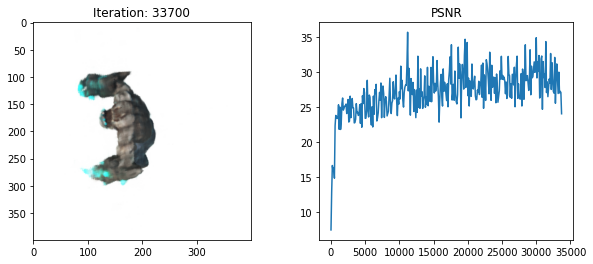

  4%|██▍                                                        | 33800/800001 [1:36:39<17:44:18, 12.00it/s]

[TRAIN] Iter: 33800 Loss_fine: 0.0010214908979833126 PSNR: 29.907655715942383


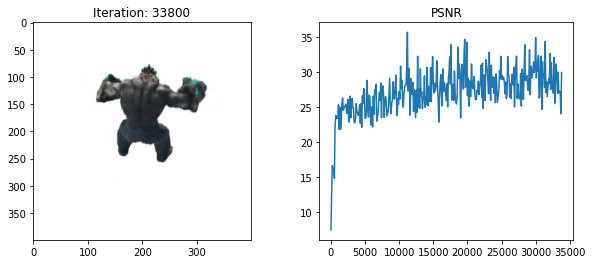

  4%|██▌                                                        | 33900/800001 [1:36:56<19:10:53, 11.09it/s]

[TRAIN] Iter: 33900 Loss_fine: 0.0015288767172023654 PSNR: 28.15627670288086


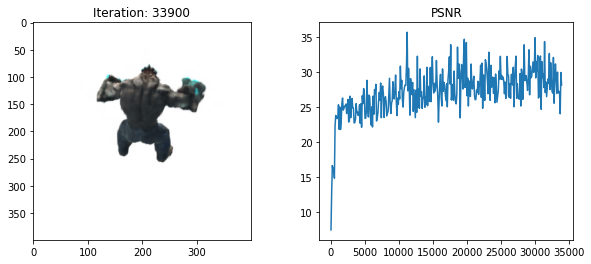

  4%|██▌                                                        | 34000/800001 [1:37:13<17:42:53, 12.01it/s]

[TRAIN] Iter: 34000 Loss_fine: 0.0016396091086789966 PSNR: 27.852598190307617


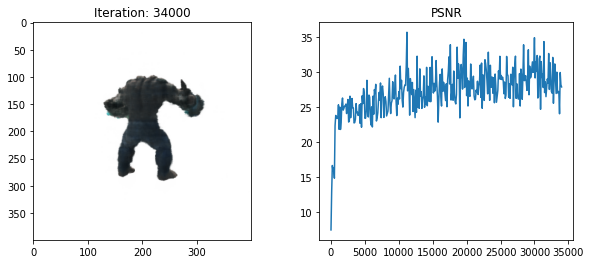

  4%|██▌                                                        | 34100/800001 [1:37:29<17:39:54, 12.04it/s]

[TRAIN] Iter: 34100 Loss_fine: 0.002011918695643544 PSNR: 26.96389389038086


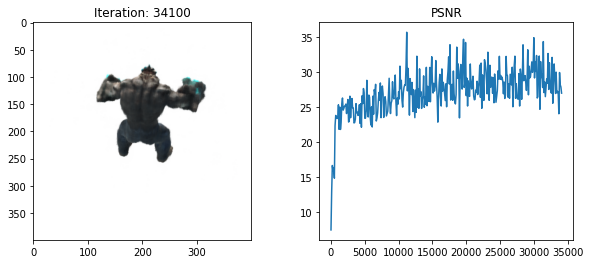

  4%|██▌                                                        | 34200/800001 [1:37:46<17:37:09, 12.07it/s]

[TRAIN] Iter: 34200 Loss_fine: 0.0002533357182983309 PSNR: 35.963035583496094


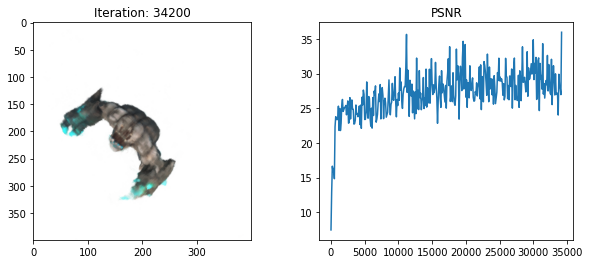

  4%|██▌                                                        | 34300/800001 [1:38:02<17:39:10, 12.05it/s]

[TRAIN] Iter: 34300 Loss_fine: 0.0021587295923382044 PSNR: 26.658018112182617


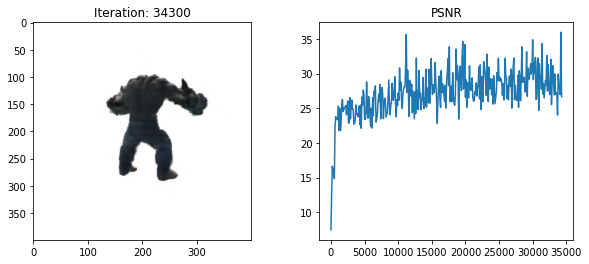

  4%|██▌                                                        | 34400/800001 [1:38:19<17:35:56, 12.08it/s]

[TRAIN] Iter: 34400 Loss_fine: 0.0010805317433550954 PSNR: 29.663625717163086


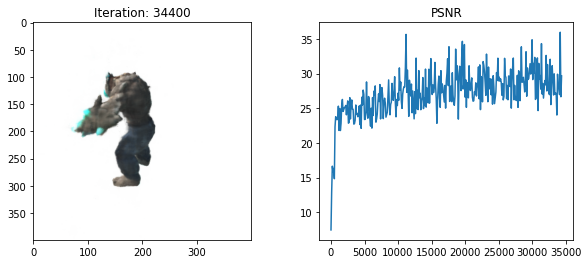

  4%|██▌                                                        | 34500/800001 [1:38:36<17:39:28, 12.04it/s]

[TRAIN] Iter: 34500 Loss_fine: 0.002169808140024543 PSNR: 26.635787963867188


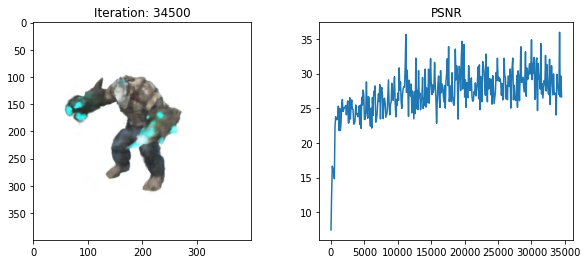

  4%|██▌                                                        | 34600/800001 [1:38:52<17:35:10, 12.09it/s]

[TRAIN] Iter: 34600 Loss_fine: 0.0009374027140438557 PSNR: 30.280736923217773


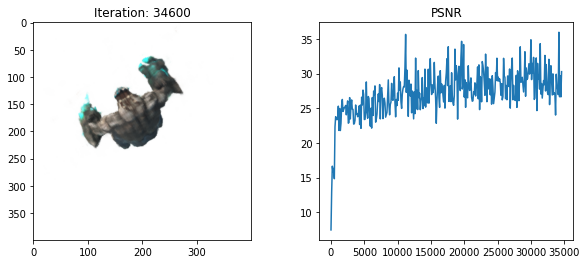

  4%|██▌                                                        | 34700/800001 [1:39:09<17:35:48, 12.08it/s]

[TRAIN] Iter: 34700 Loss_fine: 0.002442710567265749 PSNR: 26.121278762817383


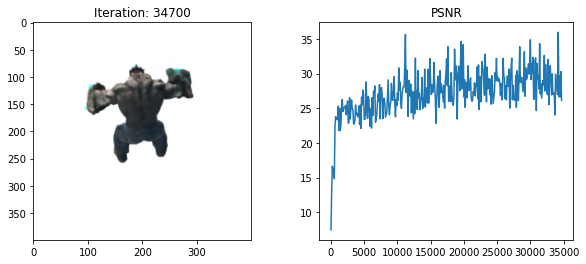

  4%|██▌                                                        | 34800/800001 [1:39:25<17:37:05, 12.06it/s]

[TRAIN] Iter: 34800 Loss_fine: 0.0012740576639771461 PSNR: 28.948110580444336


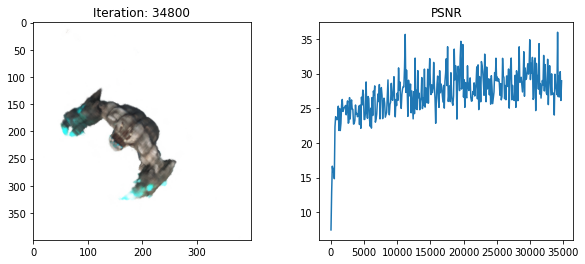

  4%|██▌                                                        | 34900/800001 [1:39:42<17:35:24, 12.08it/s]

[TRAIN] Iter: 34900 Loss_fine: 0.0012245484394952655 PSNR: 29.120241165161133


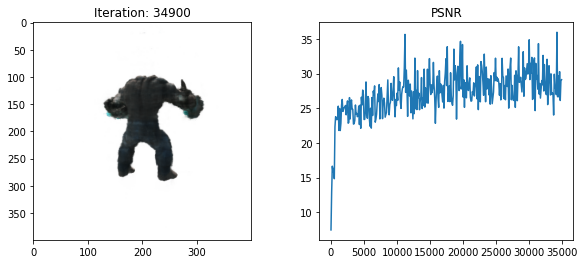

  4%|██▌                                                        | 35000/800001 [1:39:58<17:38:03, 12.05it/s]

[TRAIN] Iter: 35000 Loss_fine: 0.003769341390579939 PSNR: 24.23734474182129


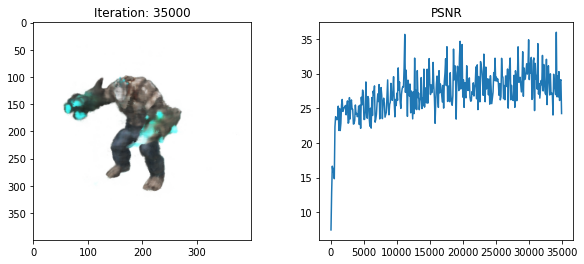

  4%|██▌                                                        | 35100/800001 [1:40:15<17:36:40, 12.06it/s]

[TRAIN] Iter: 35100 Loss_fine: 0.0010735926916822791 PSNR: 29.691604614257812


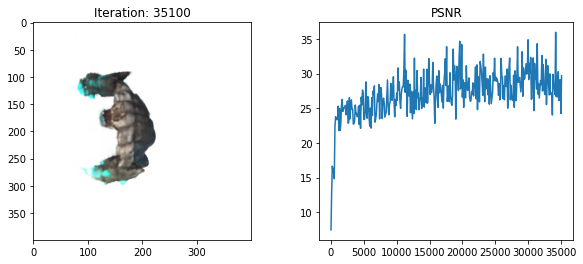

  4%|██▌                                                        | 35200/800001 [1:40:32<17:39:06, 12.04it/s]

[TRAIN] Iter: 35200 Loss_fine: 0.00140563549939543 PSNR: 28.52127456665039


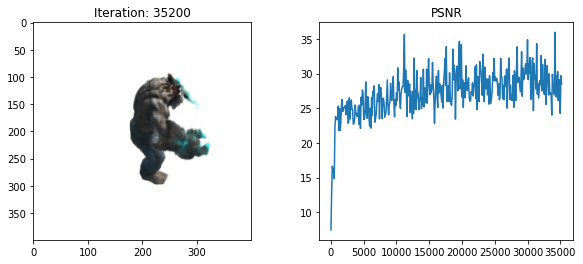

  4%|██▌                                                        | 35300/800001 [1:40:48<17:35:51, 12.07it/s]

[TRAIN] Iter: 35300 Loss_fine: 0.0008744297665543854 PSNR: 30.58275032043457


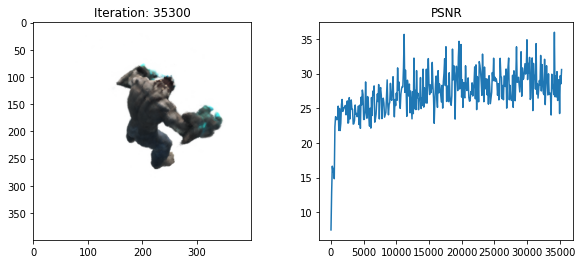

  4%|██▌                                                        | 35400/800001 [1:41:05<17:35:05, 12.08it/s]

[TRAIN] Iter: 35400 Loss_fine: 0.00025086200912483037 PSNR: 36.00564956665039


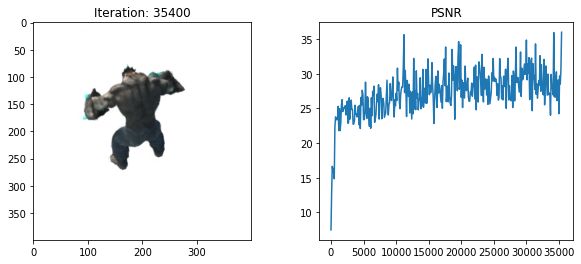

  4%|██▌                                                        | 35500/800001 [1:41:21<17:32:25, 12.11it/s]

[TRAIN] Iter: 35500 Loss_fine: 0.0008918427629396319 PSNR: 30.497116088867188


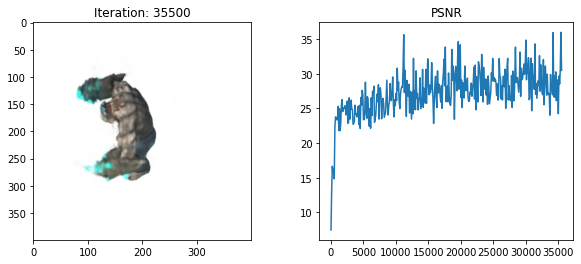

  4%|██▋                                                        | 35600/800001 [1:41:38<17:36:35, 12.06it/s]

[TRAIN] Iter: 35600 Loss_fine: 0.0022756403777748346 PSNR: 26.428964614868164


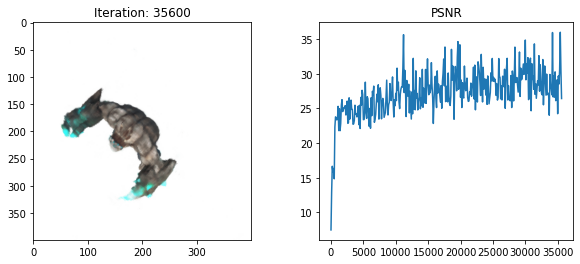

  4%|██▋                                                        | 35700/800001 [1:41:54<17:38:31, 12.03it/s]

[TRAIN] Iter: 35700 Loss_fine: 0.001894830958917737 PSNR: 27.224294662475586


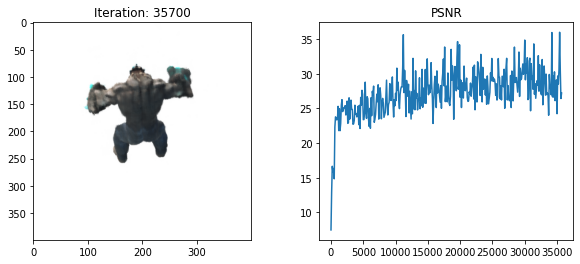

  4%|██▋                                                        | 35800/800001 [1:42:11<17:35:10, 12.07it/s]

[TRAIN] Iter: 35800 Loss_fine: 0.0007612602785229683 PSNR: 31.184667587280273


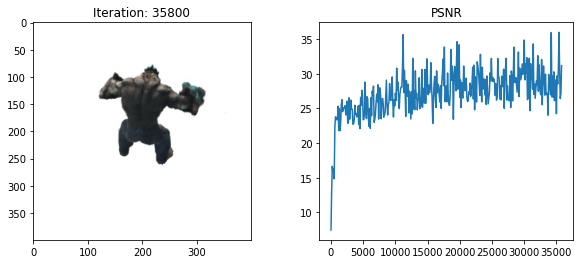

  4%|██▋                                                        | 35900/800001 [1:42:28<17:38:58, 12.03it/s]

[TRAIN] Iter: 35900 Loss_fine: 0.0012653362937271595 PSNR: 28.97793960571289


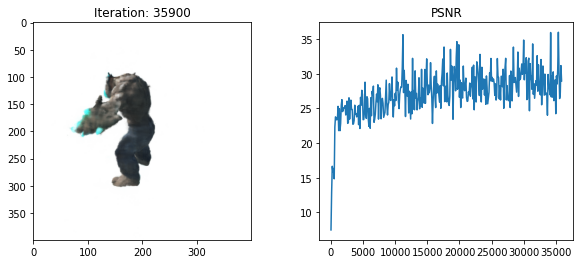

  4%|██▋                                                        | 36000/800001 [1:42:44<17:34:18, 12.08it/s]

[TRAIN] Iter: 36000 Loss_fine: 0.001858293078839779 PSNR: 27.308856964111328


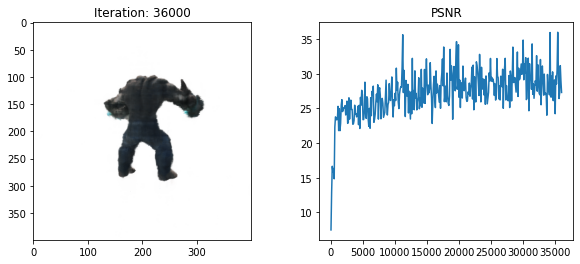

  5%|██▋                                                        | 36100/800001 [1:43:01<17:36:48, 12.05it/s]

[TRAIN] Iter: 36100 Loss_fine: 0.0026208749040961266 PSNR: 25.81553840637207


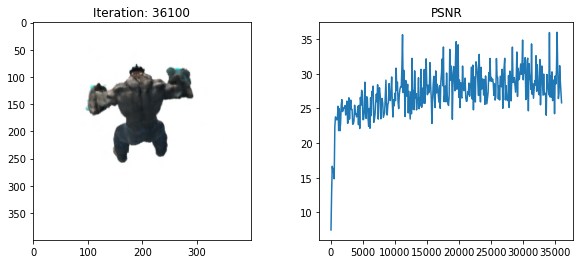

  5%|██▋                                                        | 36200/800001 [1:43:17<17:33:17, 12.09it/s]

[TRAIN] Iter: 36200 Loss_fine: 0.0007066345424391329 PSNR: 31.50804901123047


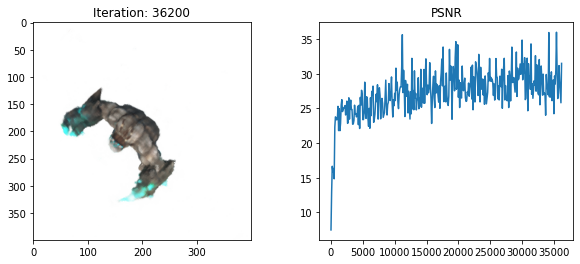

  5%|██▋                                                        | 36300/800001 [1:43:34<17:39:49, 12.01it/s]

[TRAIN] Iter: 36300 Loss_fine: 0.0007992387400008738 PSNR: 30.97323226928711


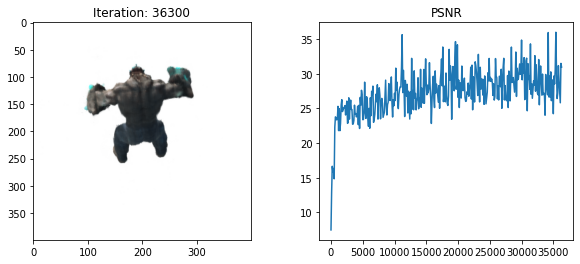

  5%|██▋                                                        | 36400/800001 [1:43:50<17:34:54, 12.06it/s]

[TRAIN] Iter: 36400 Loss_fine: 0.0007074518362060189 PSNR: 31.503028869628906


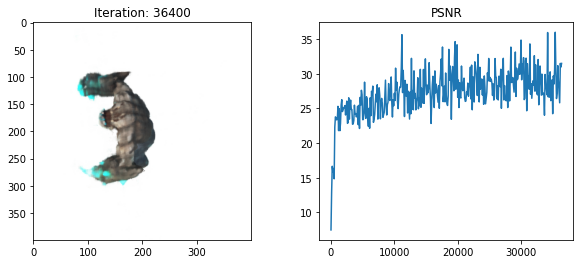

  5%|██▋                                                        | 36500/800001 [1:44:07<17:32:15, 12.09it/s]

[TRAIN] Iter: 36500 Loss_fine: 0.000694362330250442 PSNR: 31.584138870239258


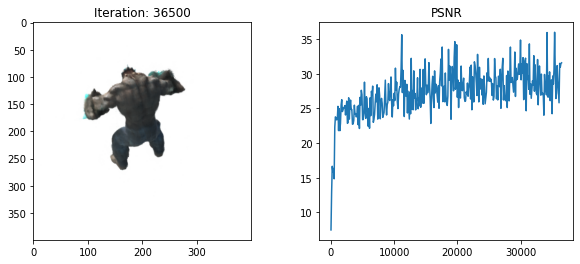

  5%|██▋                                                        | 36600/800001 [1:44:24<17:33:23, 12.08it/s]

[TRAIN] Iter: 36600 Loss_fine: 0.0012664200039580464 PSNR: 28.97422218322754


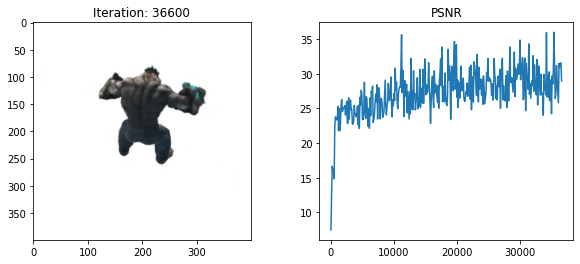

  5%|██▋                                                        | 36700/800001 [1:44:40<17:32:13, 12.09it/s]

[TRAIN] Iter: 36700 Loss_fine: 0.004175071604549885 PSNR: 23.79336166381836


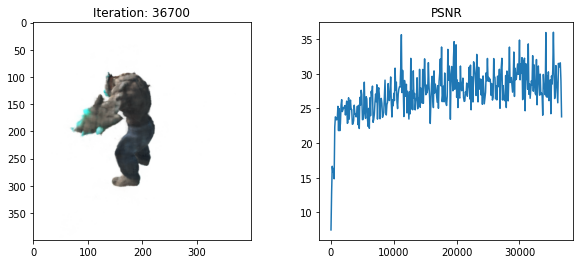

  5%|██▋                                                        | 36800/800001 [1:44:57<17:35:06, 12.06it/s]

[TRAIN] Iter: 36800 Loss_fine: 0.0007037288160063326 PSNR: 31.52594757080078


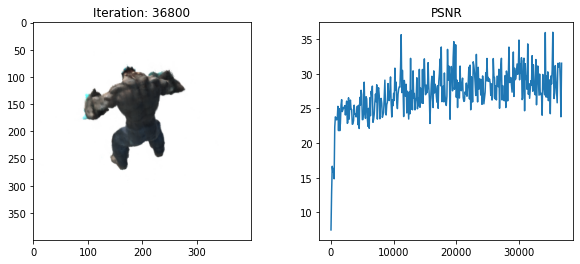

  5%|██▋                                                        | 36900/800001 [1:45:13<17:34:01, 12.07it/s]

[TRAIN] Iter: 36900 Loss_fine: 0.002315645106136799 PSNR: 26.353281021118164


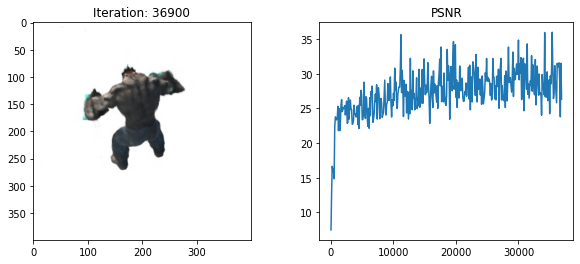

  5%|██▋                                                        | 37000/800001 [1:45:30<17:34:22, 12.06it/s]

[TRAIN] Iter: 37000 Loss_fine: 0.0015908967470750213 PSNR: 27.98358154296875


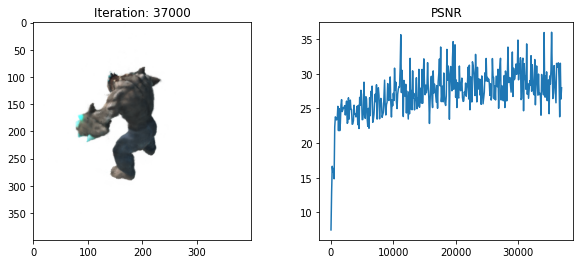

  5%|██▋                                                        | 37100/800001 [1:45:46<17:57:05, 11.80it/s]

[TRAIN] Iter: 37100 Loss_fine: 0.001257202704437077 PSNR: 29.005945205688477


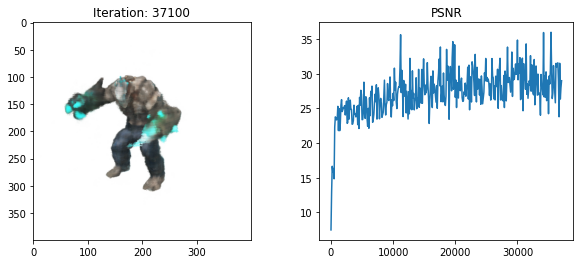

  5%|██▋                                                        | 37200/800001 [1:46:03<17:30:10, 12.11it/s]

[TRAIN] Iter: 37200 Loss_fine: 0.0012440091231837869 PSNR: 29.0517635345459


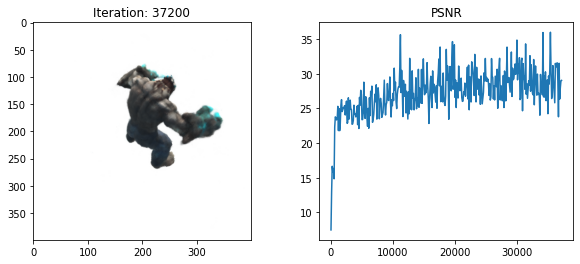

  5%|██▊                                                        | 37300/800001 [1:46:20<17:31:40, 12.09it/s]

[TRAIN] Iter: 37300 Loss_fine: 0.0007942587253637612 PSNR: 31.00037956237793


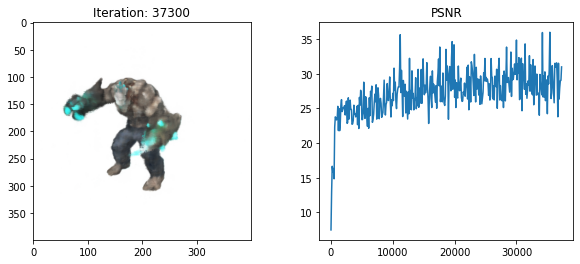

  5%|██▊                                                        | 37400/800001 [1:46:36<17:30:13, 12.10it/s]

[TRAIN] Iter: 37400 Loss_fine: 0.001215719385072589 PSNR: 29.15166473388672


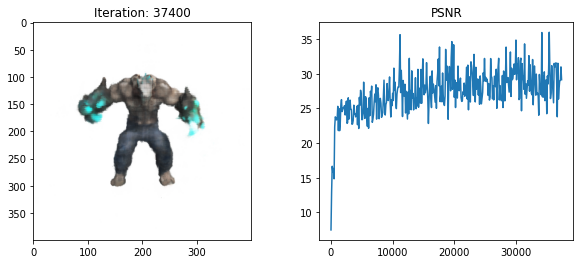

  5%|██▊                                                        | 37500/800001 [1:46:53<17:30:15, 12.10it/s]

[TRAIN] Iter: 37500 Loss_fine: 0.001580247888341546 PSNR: 28.012744903564453


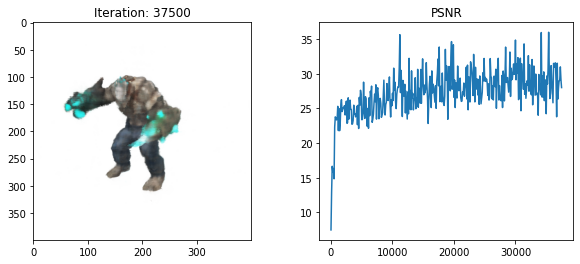

  5%|██▊                                                        | 37600/800001 [1:47:09<17:31:52, 12.08it/s]

[TRAIN] Iter: 37600 Loss_fine: 0.0014248080551624298 PSNR: 28.462434768676758


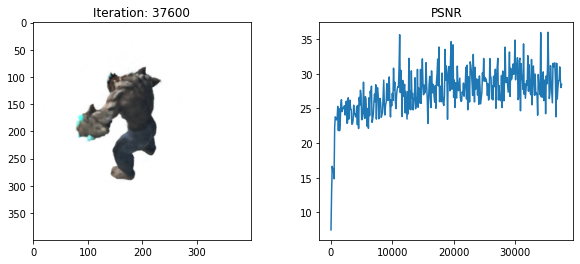

  5%|██▊                                                        | 37700/800001 [1:47:26<17:46:47, 11.91it/s]

[TRAIN] Iter: 37700 Loss_fine: 0.0022575603798031807 PSNR: 26.463607788085938


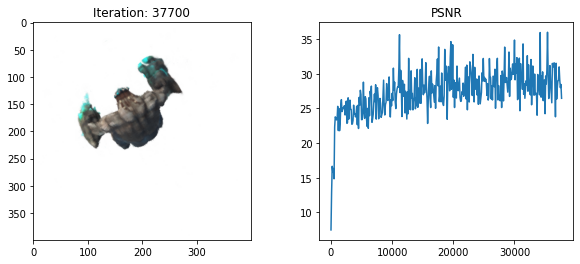

  5%|██▊                                                        | 37800/800001 [1:47:42<17:33:20, 12.06it/s]

[TRAIN] Iter: 37800 Loss_fine: 0.0019844085909426212 PSNR: 27.02368927001953


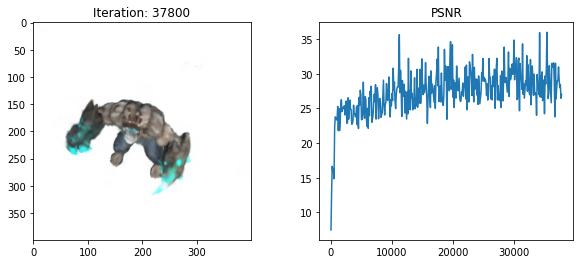

  5%|██▊                                                        | 37900/800001 [1:47:59<17:35:25, 12.03it/s]

[TRAIN] Iter: 37900 Loss_fine: 0.0010453343857079744 PSNR: 29.80744743347168


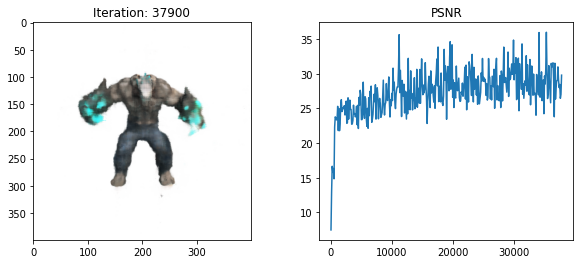

  5%|██▊                                                        | 38000/800001 [1:48:15<17:35:51, 12.03it/s]

[TRAIN] Iter: 38000 Loss_fine: 0.0003332816413603723 PSNR: 34.771888732910156


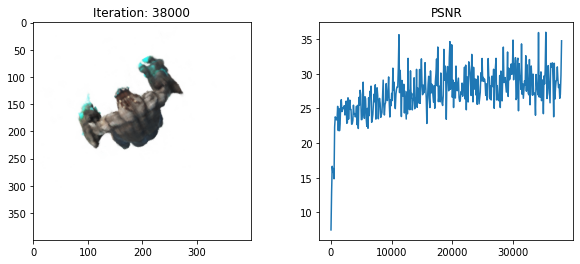

  5%|██▊                                                        | 38100/800001 [1:48:32<17:35:29, 12.03it/s]

[TRAIN] Iter: 38100 Loss_fine: 0.0005005530547350645 PSNR: 33.005496978759766


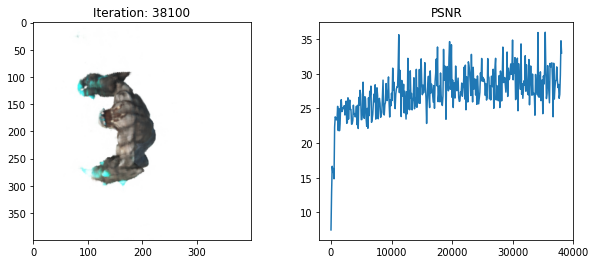

  5%|██▊                                                        | 38200/800001 [1:48:49<17:30:19, 12.09it/s]

[TRAIN] Iter: 38200 Loss_fine: 0.001066785305738449 PSNR: 29.7192325592041


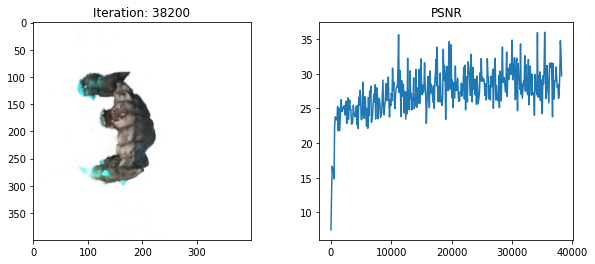

  5%|██▊                                                        | 38300/800001 [1:49:05<17:30:43, 12.08it/s]

[TRAIN] Iter: 38300 Loss_fine: 0.0013831874821335077 PSNR: 28.591190338134766


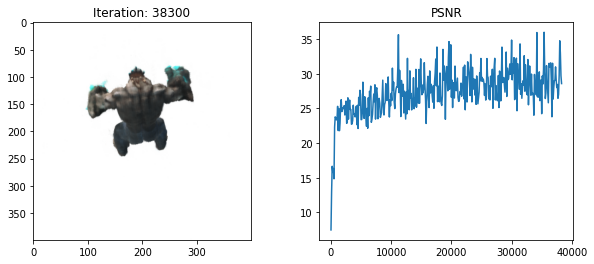

  5%|██▊                                                        | 38400/800001 [1:49:22<17:33:39, 12.05it/s]

[TRAIN] Iter: 38400 Loss_fine: 0.002026480855420232 PSNR: 26.932575225830078


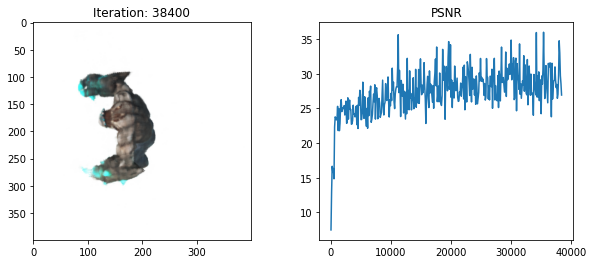

  5%|██▊                                                        | 38500/800001 [1:49:38<17:31:21, 12.07it/s]

[TRAIN] Iter: 38500 Loss_fine: 0.0008412274182774127 PSNR: 30.750865936279297


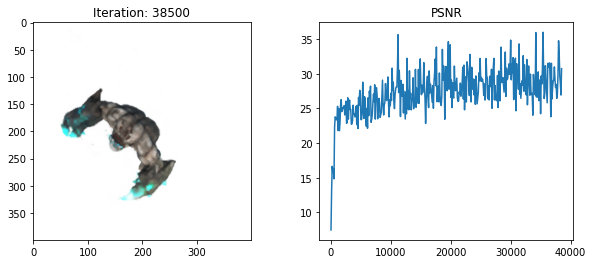

  5%|██▊                                                        | 38600/800001 [1:49:55<17:46:13, 11.90it/s]

[TRAIN] Iter: 38600 Loss_fine: 0.0015934756956994534 PSNR: 27.976547241210938


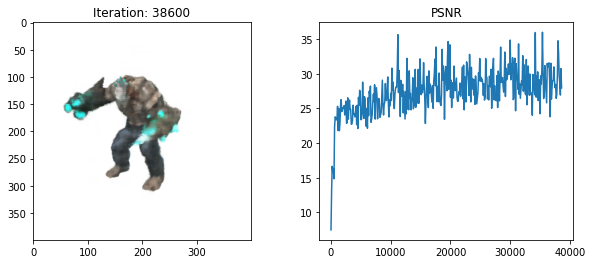

  5%|██▊                                                        | 38700/800001 [1:50:12<17:38:06, 11.99it/s]

[TRAIN] Iter: 38700 Loss_fine: 0.0020022576209157705 PSNR: 26.984800338745117


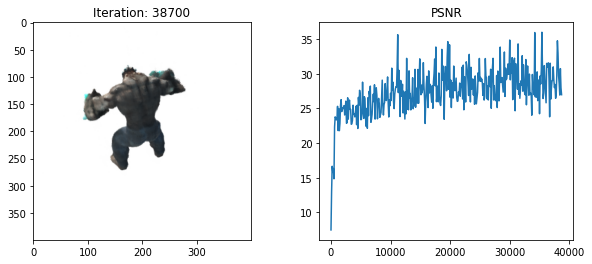

  5%|██▊                                                        | 38800/800001 [1:50:28<17:31:05, 12.07it/s]

[TRAIN] Iter: 38800 Loss_fine: 0.0007325504557229578 PSNR: 31.35162353515625


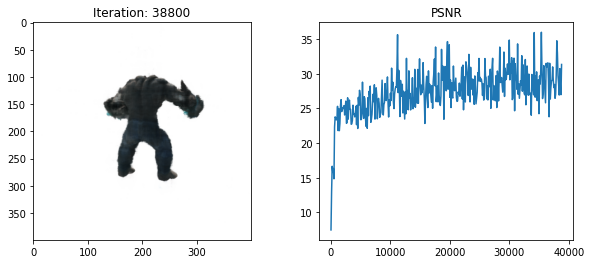

  5%|██▊                                                        | 38900/800001 [1:50:45<17:32:10, 12.06it/s]

[TRAIN] Iter: 38900 Loss_fine: 0.001630382495932281 PSNR: 27.877105712890625


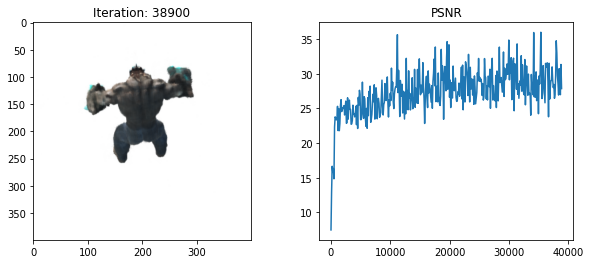

  5%|██▉                                                        | 39000/800001 [1:51:01<17:31:22, 12.06it/s]

[TRAIN] Iter: 39000 Loss_fine: 0.0017737661255523562 PSNR: 27.511035919189453


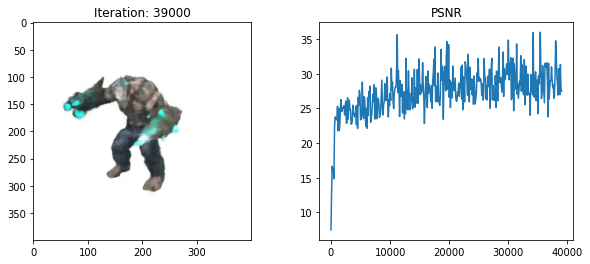

  5%|██▉                                                        | 39100/800001 [1:51:18<17:30:50, 12.07it/s]

[TRAIN] Iter: 39100 Loss_fine: 0.0009848909685388207 PSNR: 30.066118240356445


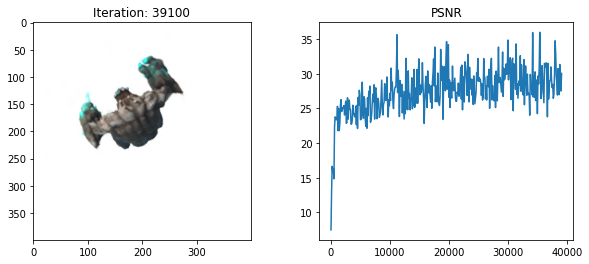

  5%|██▉                                                        | 39200/800001 [1:51:35<17:36:22, 12.00it/s]

[TRAIN] Iter: 39200 Loss_fine: 0.0014786528190597892 PSNR: 28.30133628845215


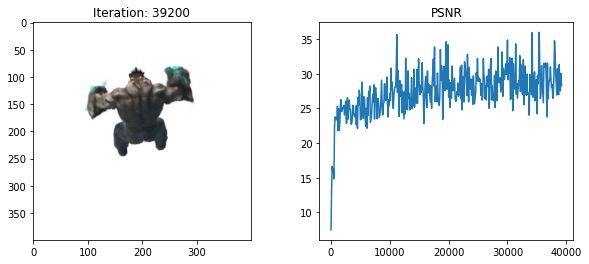

  5%|██▉                                                        | 39300/800001 [1:51:51<17:28:50, 12.09it/s]

[TRAIN] Iter: 39300 Loss_fine: 0.004564224276691675 PSNR: 23.406330108642578


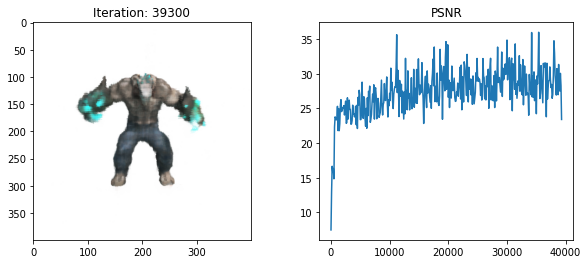

  5%|██▉                                                        | 39400/800001 [1:52:08<17:32:53, 12.04it/s]

[TRAIN] Iter: 39400 Loss_fine: 0.0018970618257299066 PSNR: 27.21918487548828


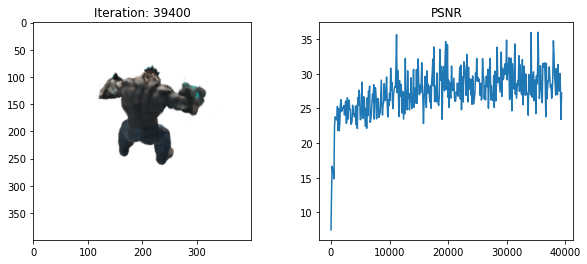

  5%|██▉                                                        | 39500/800001 [1:52:24<17:30:17, 12.07it/s]

[TRAIN] Iter: 39500 Loss_fine: 0.0012907887576147914 PSNR: 28.891450881958008


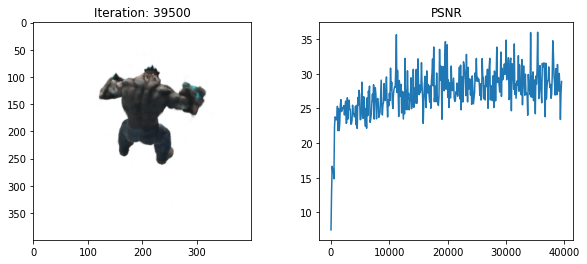

  5%|██▉                                                        | 39600/800001 [1:52:41<17:32:03, 12.05it/s]

[TRAIN] Iter: 39600 Loss_fine: 0.0004713739617727697 PSNR: 33.26634216308594


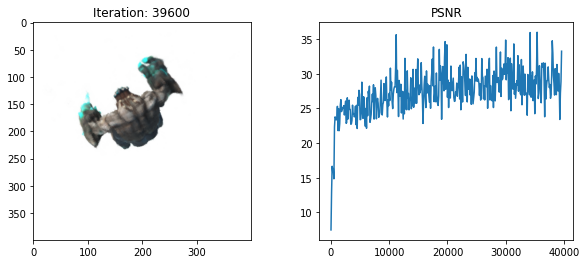

  5%|██▉                                                        | 39700/800001 [1:52:57<17:29:49, 12.07it/s]

[TRAIN] Iter: 39700 Loss_fine: 0.002497055334970355 PSNR: 26.025718688964844


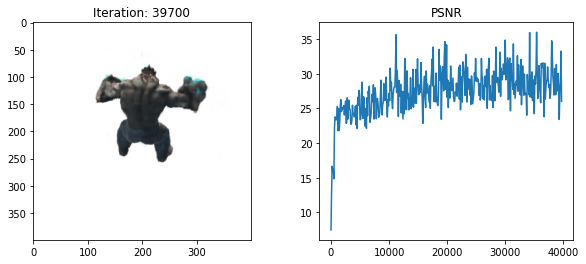

  5%|██▉                                                        | 39800/800001 [1:53:14<17:29:34, 12.07it/s]

[TRAIN] Iter: 39800 Loss_fine: 0.0015703560784459114 PSNR: 28.04001808166504


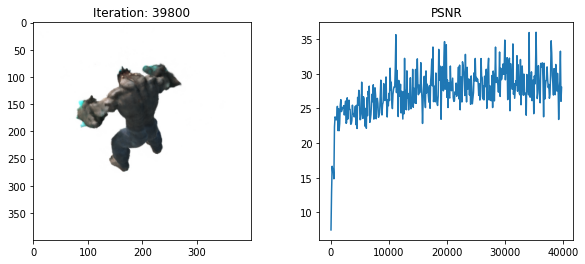

  5%|██▉                                                        | 39900/800001 [1:53:31<17:28:56, 12.08it/s]

[TRAIN] Iter: 39900 Loss_fine: 0.0007555449847131968 PSNR: 31.217397689819336


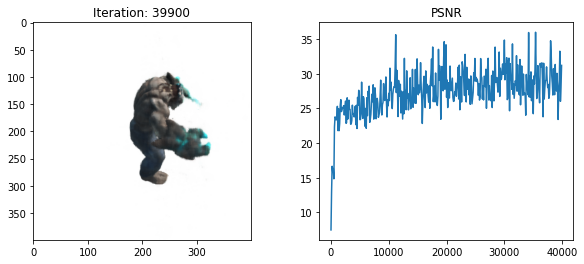

  5%|██▉                                                        | 40000/800001 [1:53:47<17:27:23, 12.09it/s]

[TRAIN] Iter: 40000 Loss_fine: 0.0005520112463273108 PSNR: 32.58052062988281


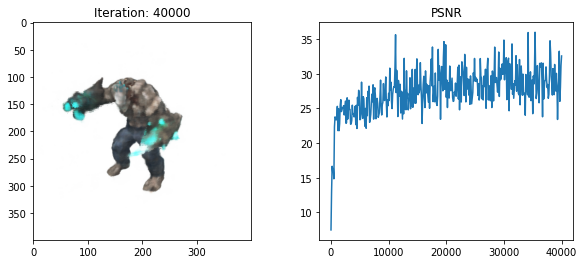

  5%|██▉                                                        | 40100/800001 [1:54:04<17:26:52, 12.10it/s]

[TRAIN] Iter: 40100 Loss_fine: 0.001493637333624065 PSNR: 28.25754737854004


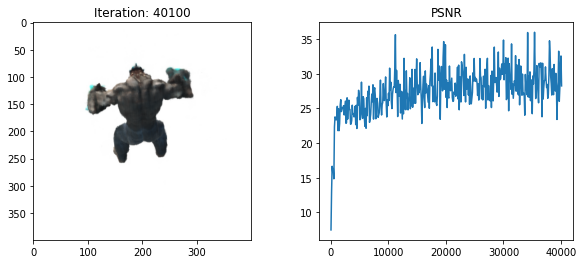

  5%|██▉                                                        | 40200/800001 [1:54:20<17:27:40, 12.09it/s]

[TRAIN] Iter: 40200 Loss_fine: 0.0014489084715023637 PSNR: 28.389589309692383


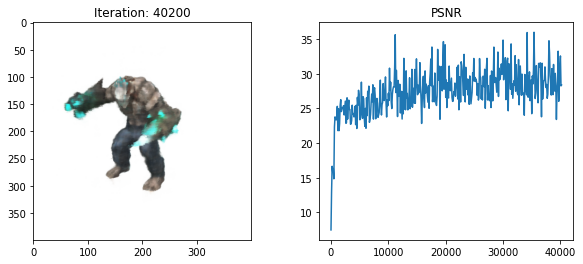

  5%|██▉                                                        | 40300/800001 [1:54:37<17:30:18, 12.06it/s]

[TRAIN] Iter: 40300 Loss_fine: 0.001164266373962164 PSNR: 29.339475631713867


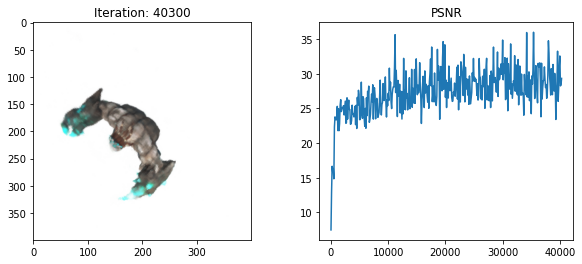

  5%|██▉                                                        | 40400/800001 [1:54:53<17:28:26, 12.08it/s]

[TRAIN] Iter: 40400 Loss_fine: 0.001517001772299409 PSNR: 28.190139770507812


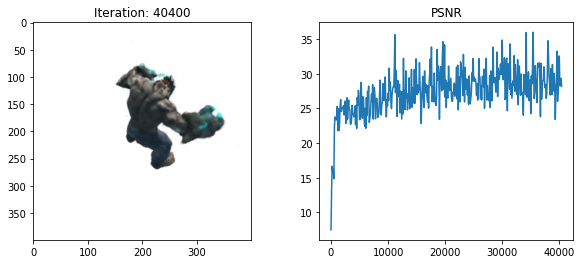

  5%|██▉                                                        | 40500/800001 [1:55:10<17:29:45, 12.06it/s]

[TRAIN] Iter: 40500 Loss_fine: 0.0008825050899758935 PSNR: 30.542827606201172


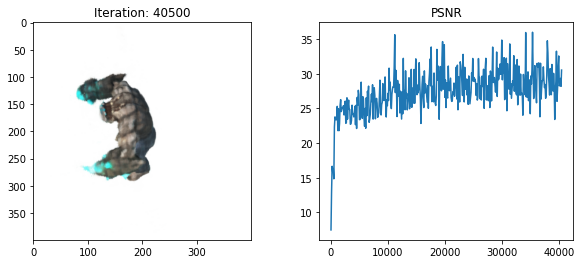

  5%|██▉                                                        | 40600/800001 [1:55:27<17:37:44, 11.97it/s]

[TRAIN] Iter: 40600 Loss_fine: 0.0018919178983196616 PSNR: 27.230976104736328


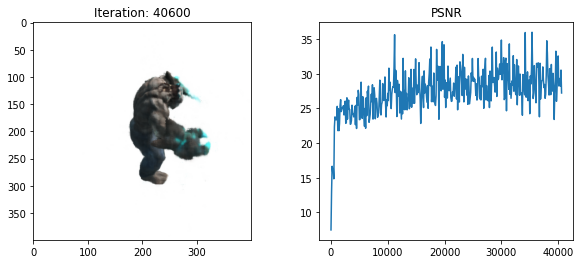

  5%|███                                                        | 40700/800001 [1:55:43<17:28:30, 12.07it/s]

[TRAIN] Iter: 40700 Loss_fine: 0.0014647319912910461 PSNR: 28.342418670654297


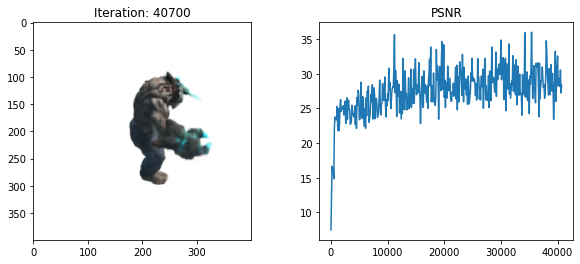

  5%|███                                                        | 40800/800001 [1:56:00<17:29:12, 12.06it/s]

[TRAIN] Iter: 40800 Loss_fine: 0.0015917302807793021 PSNR: 27.981304168701172


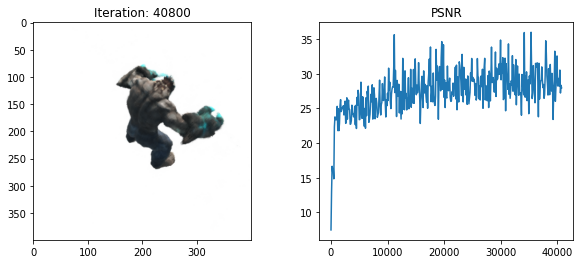

  5%|███                                                        | 40900/800001 [1:56:16<17:26:37, 12.09it/s]

[TRAIN] Iter: 40900 Loss_fine: 0.00039350095903500915 PSNR: 34.050540924072266


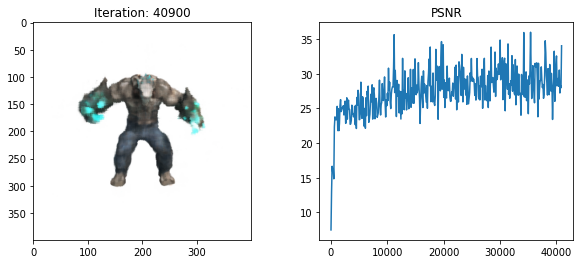

  5%|███                                                        | 41000/800001 [1:56:33<17:25:41, 12.10it/s]

[TRAIN] Iter: 41000 Loss_fine: 0.0010481917997822165 PSNR: 29.79559326171875


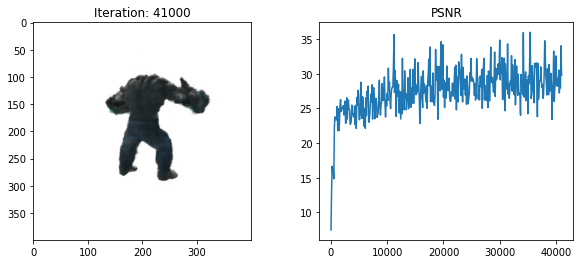

  5%|███                                                        | 41100/800001 [1:56:49<17:25:10, 12.10it/s]

[TRAIN] Iter: 41100 Loss_fine: 0.0018088091164827347 PSNR: 27.42607307434082


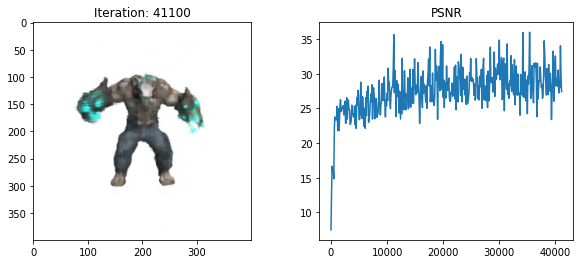

  5%|███                                                        | 41200/800001 [1:57:06<17:30:24, 12.04it/s]

[TRAIN] Iter: 41200 Loss_fine: 0.0016890030819922686 PSNR: 27.723695755004883


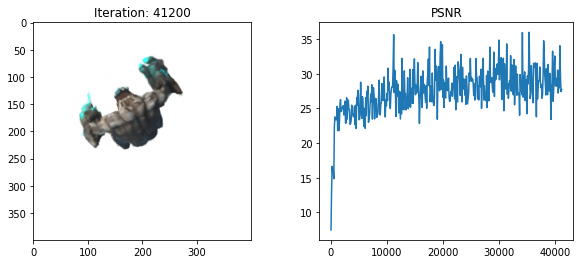

  5%|███                                                        | 41300/800001 [1:57:23<17:30:58, 12.03it/s]

[TRAIN] Iter: 41300 Loss_fine: 0.0003648060082923621 PSNR: 34.37937927246094


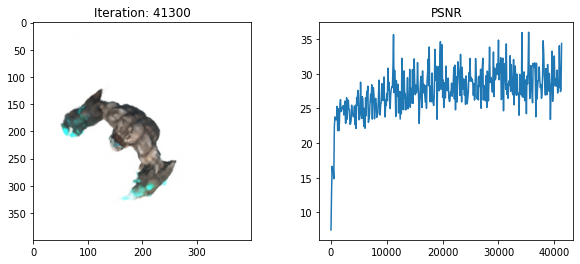

  5%|███                                                        | 41400/800001 [1:57:39<17:25:54, 12.09it/s]

[TRAIN] Iter: 41400 Loss_fine: 0.0010353997349739075 PSNR: 29.848918914794922


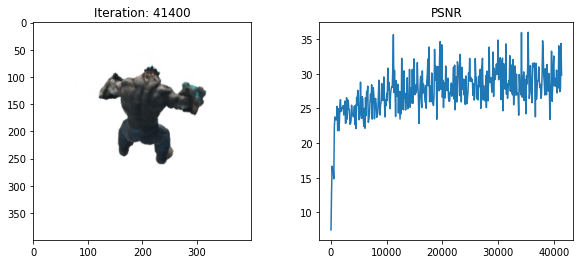

  5%|███                                                        | 41500/800001 [1:57:56<17:26:11, 12.08it/s]

[TRAIN] Iter: 41500 Loss_fine: 0.0011655628914013505 PSNR: 29.33464241027832


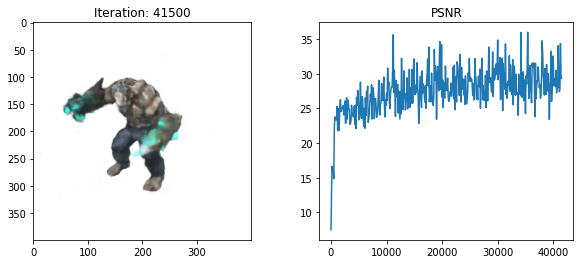

  5%|███                                                        | 41600/800001 [1:58:12<17:29:09, 12.05it/s]

[TRAIN] Iter: 41600 Loss_fine: 0.0016593077452853322 PSNR: 27.800731658935547


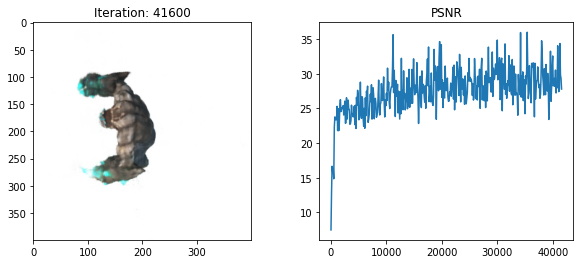

  5%|███                                                        | 41700/800001 [1:58:29<17:25:41, 12.09it/s]

[TRAIN] Iter: 41700 Loss_fine: 0.0003880263539031148 PSNR: 34.111385345458984


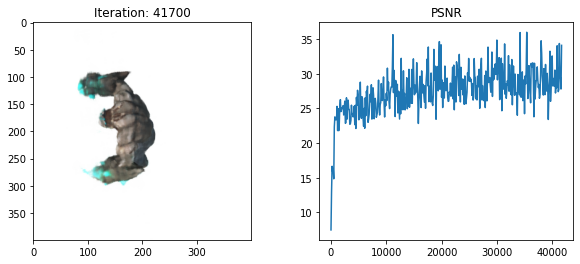

  5%|███                                                        | 41800/800001 [1:58:45<17:30:33, 12.03it/s]

[TRAIN] Iter: 41800 Loss_fine: 0.005235267803072929 PSNR: 22.810611724853516


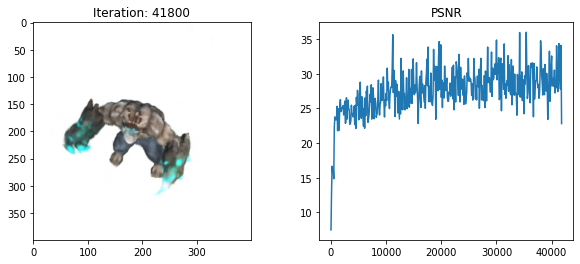

  5%|███                                                        | 41900/800001 [1:59:02<17:24:50, 12.09it/s]

[TRAIN] Iter: 41900 Loss_fine: 0.0007765639456920326 PSNR: 31.09822654724121


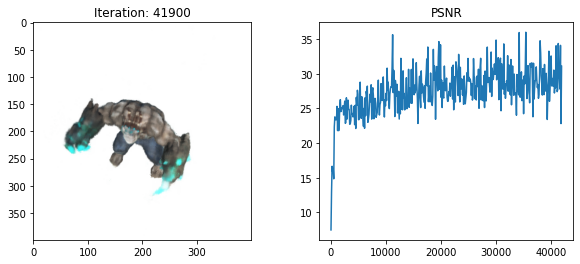

  5%|███                                                        | 42000/800001 [1:59:19<17:25:25, 12.08it/s]

[TRAIN] Iter: 42000 Loss_fine: 0.0006659257924184203 PSNR: 31.765743255615234


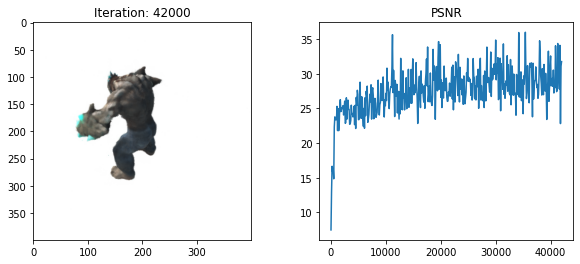

  5%|███                                                        | 42100/800001 [1:59:35<17:30:55, 12.02it/s]

[TRAIN] Iter: 42100 Loss_fine: 0.00043267838191241026 PSNR: 33.638343811035156


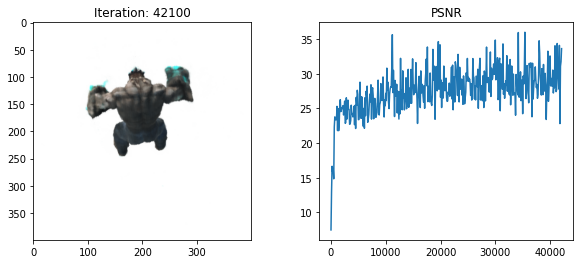

  5%|███                                                        | 42200/800001 [1:59:52<17:27:30, 12.06it/s]

[TRAIN] Iter: 42200 Loss_fine: 0.00014258100418373942 PSNR: 38.459381103515625


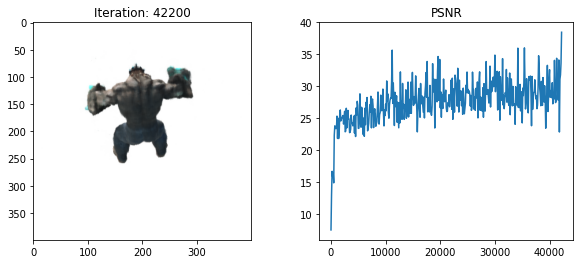

  5%|███                                                        | 42300/800001 [2:00:08<17:28:02, 12.05it/s]

[TRAIN] Iter: 42300 Loss_fine: 0.0010789716616272926 PSNR: 29.66990089416504


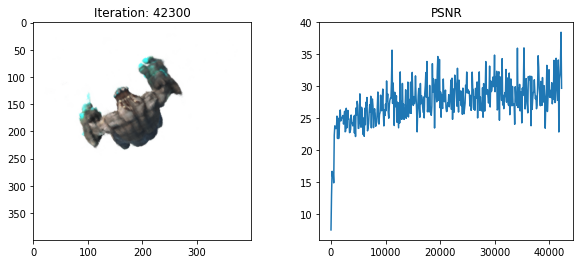

  5%|███▏                                                       | 42400/800001 [2:00:25<17:25:09, 12.08it/s]

[TRAIN] Iter: 42400 Loss_fine: 0.002079470781609416 PSNR: 26.820472717285156


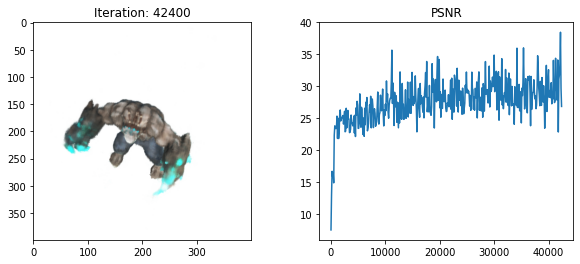

  5%|███▏                                                       | 42500/800001 [2:00:41<17:27:16, 12.06it/s]

[TRAIN] Iter: 42500 Loss_fine: 0.0009354969370178878 PSNR: 30.28957748413086


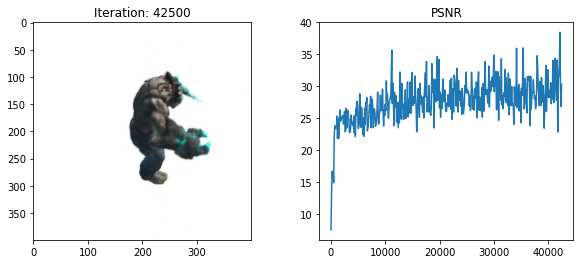

  5%|███▏                                                       | 42600/800001 [2:00:58<17:25:43, 12.07it/s]

[TRAIN] Iter: 42600 Loss_fine: 0.002259778557345271 PSNR: 26.459339141845703


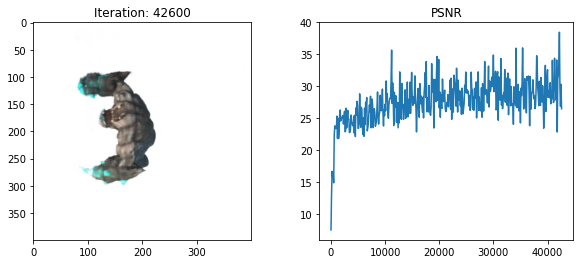

  5%|███▏                                                       | 42700/800001 [2:01:15<17:26:36, 12.06it/s]

[TRAIN] Iter: 42700 Loss_fine: 0.0003526494838297367 PSNR: 34.52656555175781


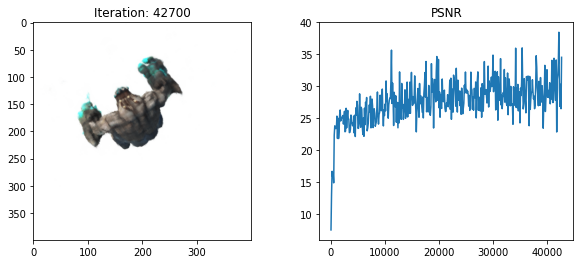

  5%|███▏                                                       | 42800/800001 [2:01:31<17:25:15, 12.07it/s]

[TRAIN] Iter: 42800 Loss_fine: 0.000719789881259203 PSNR: 31.427940368652344


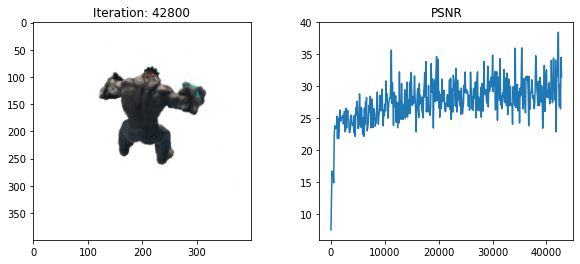

  5%|███▏                                                       | 42900/800001 [2:01:48<17:25:54, 12.06it/s]

[TRAIN] Iter: 42900 Loss_fine: 0.0012534729903563857 PSNR: 29.018850326538086


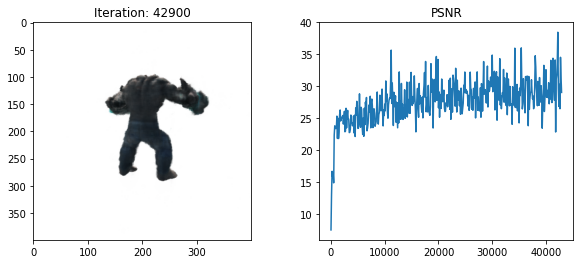

  5%|███▏                                                       | 43000/800001 [2:02:04<17:21:05, 12.12it/s]

[TRAIN] Iter: 43000 Loss_fine: 0.002186604542657733 PSNR: 26.602296829223633


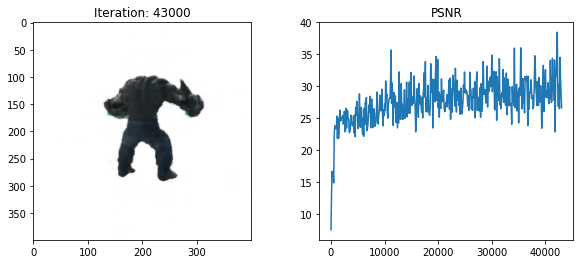

  5%|███▏                                                       | 43100/800001 [2:02:21<17:25:53, 12.06it/s]

[TRAIN] Iter: 43100 Loss_fine: 0.0017256132559850812 PSNR: 27.630563735961914


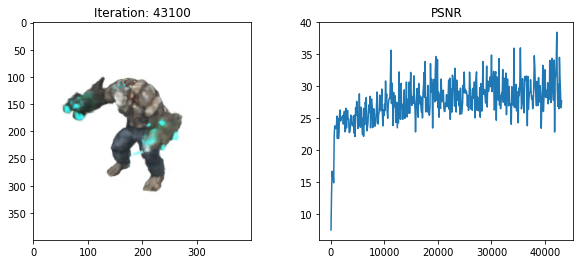

  5%|███▏                                                       | 43200/800001 [2:02:37<17:26:40, 12.05it/s]

[TRAIN] Iter: 43200 Loss_fine: 0.0007748851785436273 PSNR: 31.107624053955078


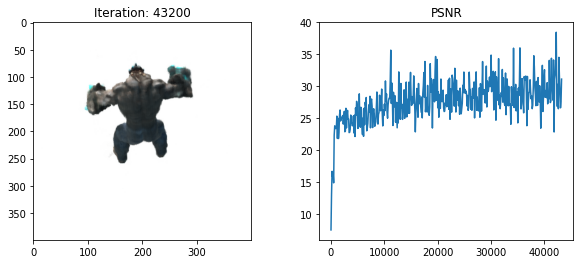

  5%|███▏                                                       | 43300/800001 [2:02:54<17:24:35, 12.07it/s]

[TRAIN] Iter: 43300 Loss_fine: 0.001582064083777368 PSNR: 28.00775909423828


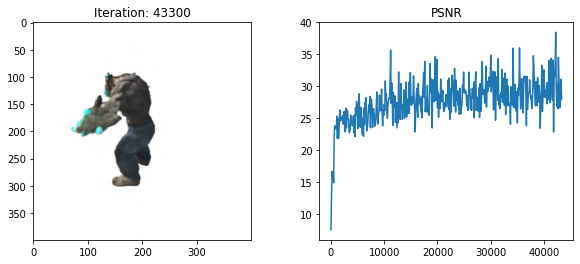

  5%|███▏                                                       | 43400/800001 [2:03:11<17:29:22, 12.02it/s]

[TRAIN] Iter: 43400 Loss_fine: 0.0013822601176798344 PSNR: 28.59410285949707


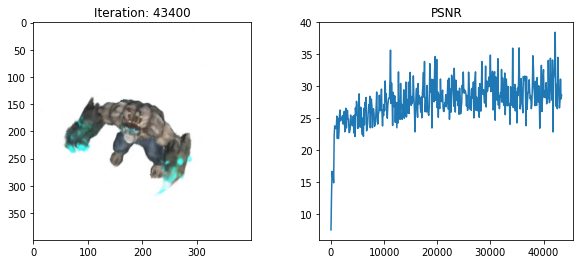

  5%|███▏                                                       | 43500/800001 [2:03:27<17:29:41, 12.01it/s]

[TRAIN] Iter: 43500 Loss_fine: 0.0012969711096957326 PSNR: 28.870695114135742


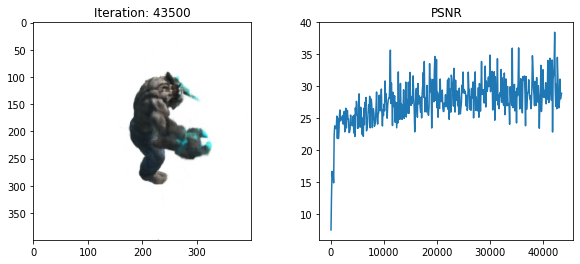

  5%|███▏                                                       | 43600/800001 [2:03:44<17:25:40, 12.06it/s]

[TRAIN] Iter: 43600 Loss_fine: 0.0020824922248721123 PSNR: 26.814167022705078


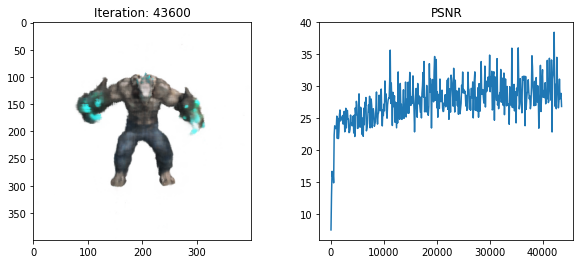

  5%|███▏                                                       | 43700/800001 [2:04:00<17:24:55, 12.06it/s]

[TRAIN] Iter: 43700 Loss_fine: 0.0018955246778205037 PSNR: 27.22270393371582


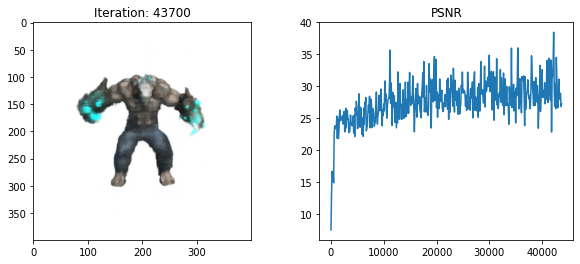

  5%|███▏                                                       | 43800/800001 [2:04:17<17:25:51, 12.05it/s]

[TRAIN] Iter: 43800 Loss_fine: 0.0013553401222452521 PSNR: 28.67951774597168


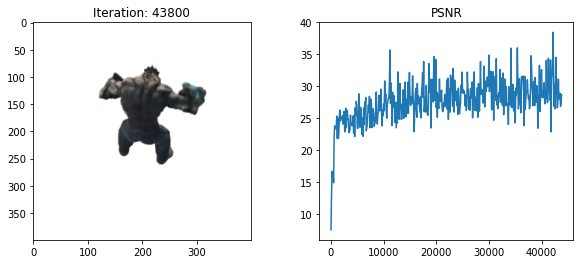

  5%|███▏                                                       | 43900/800001 [2:04:34<17:22:40, 12.09it/s]

[TRAIN] Iter: 43900 Loss_fine: 0.0037397765554487705 PSNR: 24.271543502807617


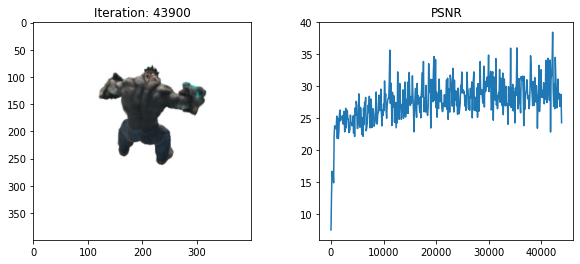

  5%|███▏                                                       | 44000/800001 [2:04:50<17:27:48, 12.03it/s]

[TRAIN] Iter: 44000 Loss_fine: 0.0008959901751950383 PSNR: 30.476966857910156


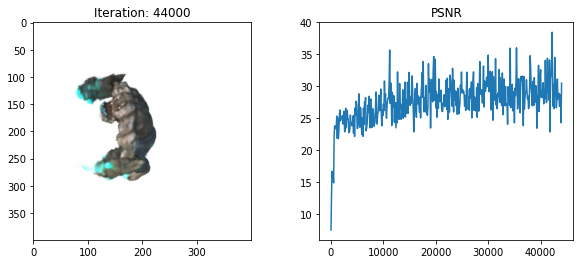

  6%|███▎                                                       | 44100/800001 [2:05:07<17:22:07, 12.09it/s]

[TRAIN] Iter: 44100 Loss_fine: 0.0019099029013887048 PSNR: 27.18988800048828


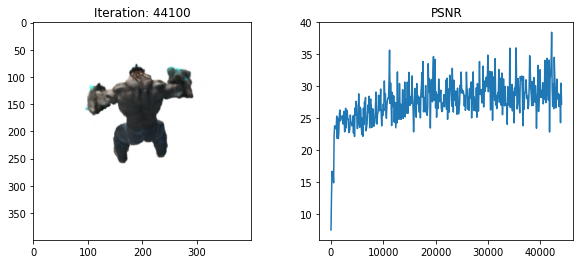

  6%|███▎                                                       | 44200/800001 [2:05:23<17:22:40, 12.08it/s]

[TRAIN] Iter: 44200 Loss_fine: 0.00136885407846421 PSNR: 28.63642692565918


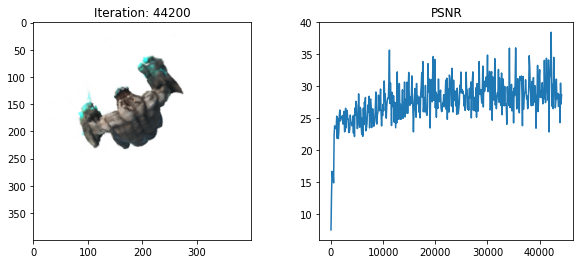

  6%|███▎                                                       | 44300/800001 [2:05:40<17:21:52, 12.09it/s]

[TRAIN] Iter: 44300 Loss_fine: 0.0006019804277457297 PSNR: 32.20417404174805


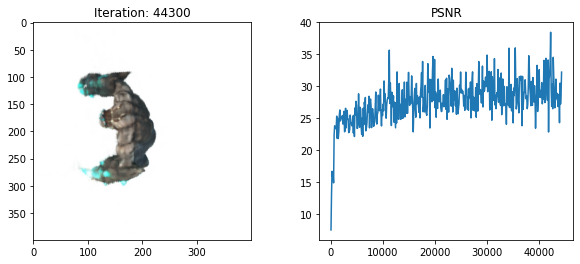

  6%|███▎                                                       | 44400/800001 [2:05:56<17:22:39, 12.08it/s]

[TRAIN] Iter: 44400 Loss_fine: 0.00041290593799203634 PSNR: 33.841487884521484


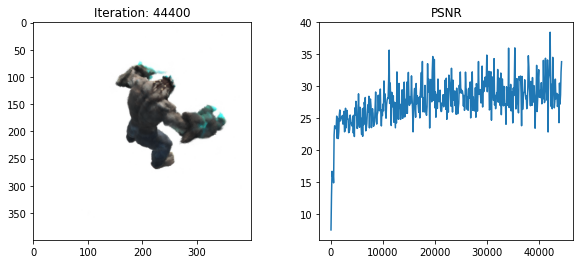

  6%|███▎                                                       | 44500/800001 [2:06:13<17:23:02, 12.07it/s]

[TRAIN] Iter: 44500 Loss_fine: 0.0014839754439890385 PSNR: 28.285730361938477


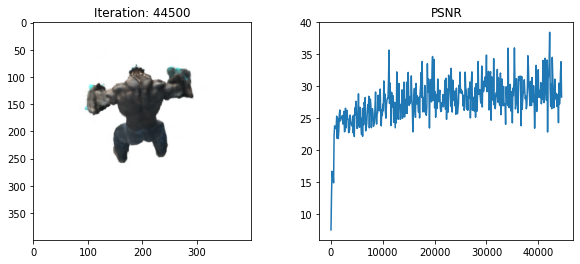

  6%|███▎                                                       | 44600/800001 [2:06:30<17:20:50, 12.10it/s]

[TRAIN] Iter: 44600 Loss_fine: 0.0019170602317899466 PSNR: 27.173641204833984


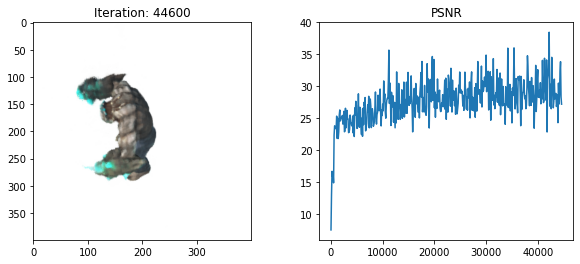

  6%|███▎                                                       | 44700/800001 [2:06:46<17:23:19, 12.07it/s]

[TRAIN] Iter: 44700 Loss_fine: 0.0013017740566283464 PSNR: 28.854642868041992


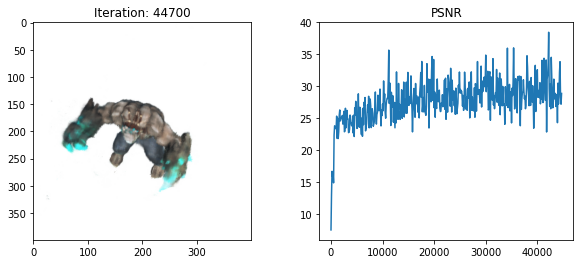

  6%|███▎                                                       | 44800/800001 [2:07:03<17:23:33, 12.06it/s]

[TRAIN] Iter: 44800 Loss_fine: 0.0021969371009618044 PSNR: 26.581823348999023


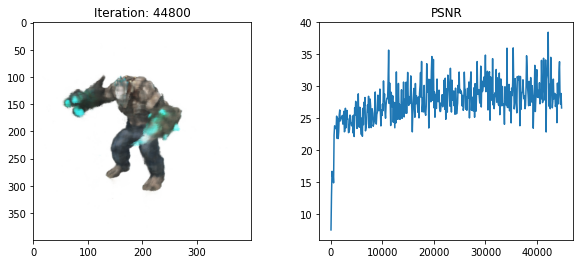

  6%|███▎                                                       | 44900/800001 [2:07:19<17:25:36, 12.04it/s]

[TRAIN] Iter: 44900 Loss_fine: 0.0012796556111425161 PSNR: 28.929067611694336


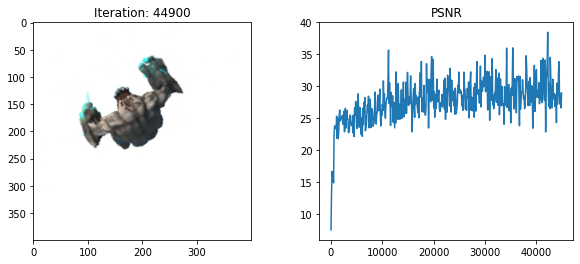

  6%|███▎                                                       | 45000/800001 [2:07:36<17:28:09, 12.01it/s]

[TRAIN] Iter: 45000 Loss_fine: 0.001289520412683487 PSNR: 28.89571762084961


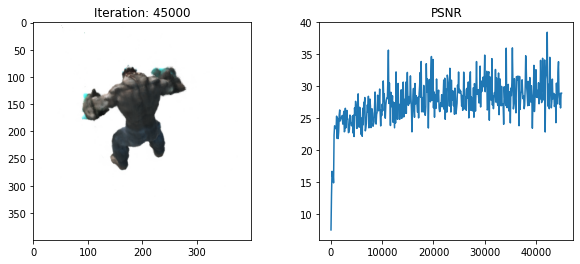

  6%|███▎                                                       | 45100/800001 [2:07:52<17:23:33, 12.06it/s]

[TRAIN] Iter: 45100 Loss_fine: 0.002296506194397807 PSNR: 26.389324188232422


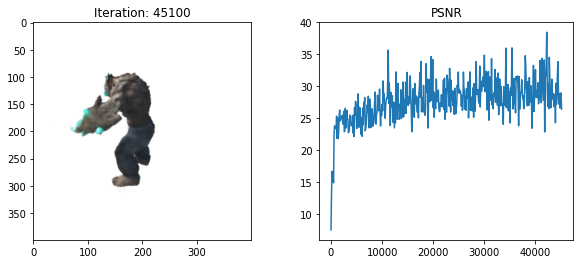

  6%|███▎                                                       | 45200/800001 [2:08:09<17:22:30, 12.07it/s]

[TRAIN] Iter: 45200 Loss_fine: 0.0010865458752959967 PSNR: 29.63951873779297


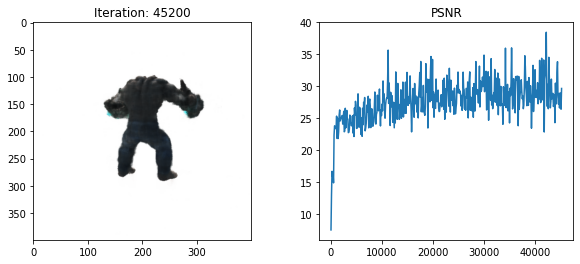

  6%|███▎                                                       | 45300/800001 [2:08:26<17:22:22, 12.07it/s]

[TRAIN] Iter: 45300 Loss_fine: 0.0029312754049897194 PSNR: 25.32943344116211


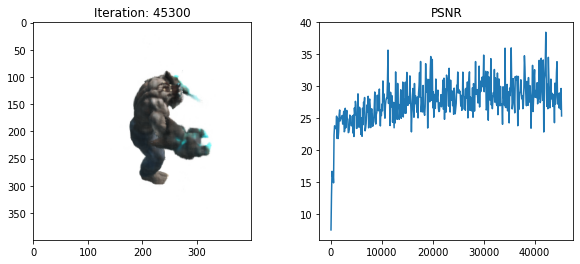

  6%|███▎                                                       | 45400/800001 [2:08:42<17:22:03, 12.07it/s]

[TRAIN] Iter: 45400 Loss_fine: 0.001427898881956935 PSNR: 28.45302391052246


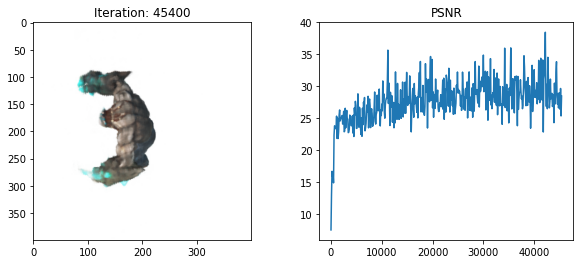

  6%|███▎                                                       | 45500/800001 [2:08:59<17:26:52, 12.01it/s]

[TRAIN] Iter: 45500 Loss_fine: 0.0010074222227558494 PSNR: 29.967885971069336


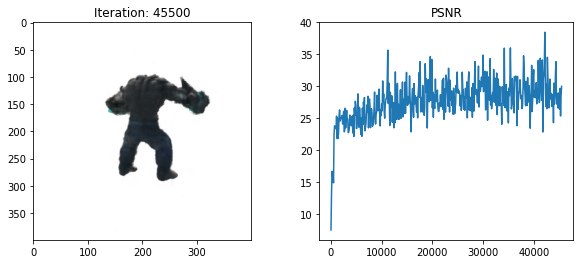

  6%|███▎                                                       | 45600/800001 [2:09:15<17:20:40, 12.08it/s]

[TRAIN] Iter: 45600 Loss_fine: 0.0004708347551058978 PSNR: 33.27131652832031


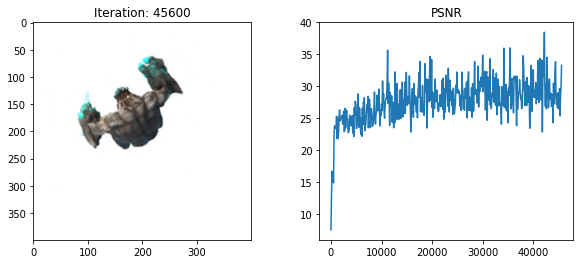

  6%|███▎                                                       | 45700/800001 [2:09:32<17:25:19, 12.03it/s]

[TRAIN] Iter: 45700 Loss_fine: 0.0022065993398427963 PSNR: 26.562763214111328


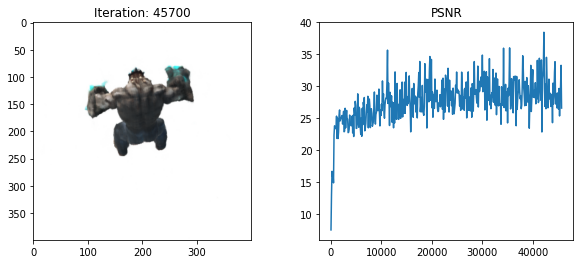

  6%|███▍                                                       | 45800/800001 [2:09:48<17:33:33, 11.93it/s]

[TRAIN] Iter: 45800 Loss_fine: 0.000773188250605017 PSNR: 31.11714744567871


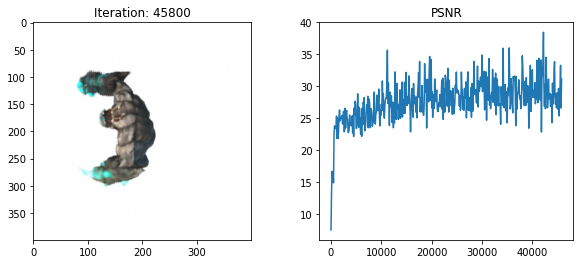

  6%|███▍                                                       | 45900/800001 [2:10:05<17:24:47, 12.03it/s]

[TRAIN] Iter: 45900 Loss_fine: 0.0013668129686266184 PSNR: 28.642908096313477


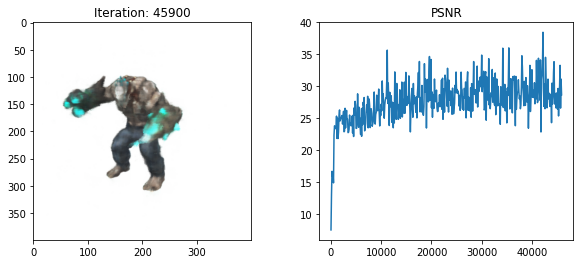

  6%|███▍                                                       | 46000/800001 [2:10:22<17:21:26, 12.07it/s]

[TRAIN] Iter: 46000 Loss_fine: 0.0014146928442642093 PSNR: 28.493377685546875


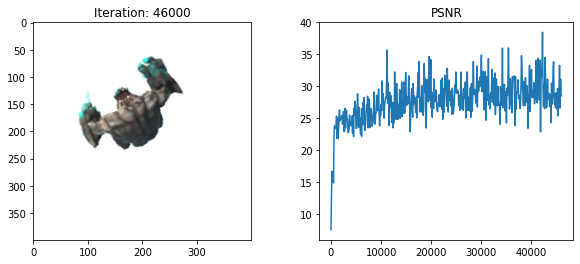

  6%|███▍                                                       | 46100/800001 [2:10:38<17:25:38, 12.02it/s]

[TRAIN] Iter: 46100 Loss_fine: 0.0008416239288635552 PSNR: 30.74881935119629


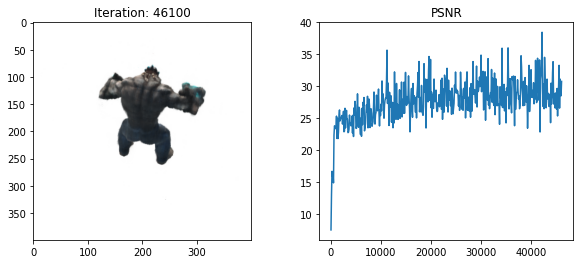

  6%|███▍                                                       | 46200/800001 [2:10:55<17:20:30, 12.07it/s]

[TRAIN] Iter: 46200 Loss_fine: 0.0015746173448860645 PSNR: 28.028249740600586


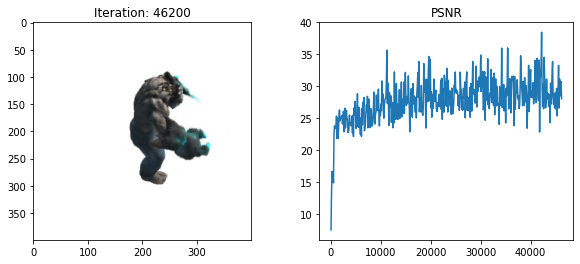

  6%|███▍                                                       | 46300/800001 [2:11:11<17:21:07, 12.07it/s]

[TRAIN] Iter: 46300 Loss_fine: 0.0019371049711480737 PSNR: 27.128467559814453


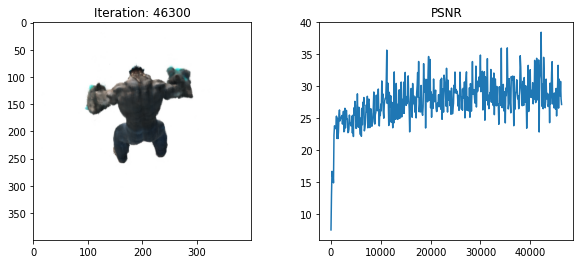

  6%|███▍                                                       | 46400/800001 [2:11:28<17:22:32, 12.05it/s]

[TRAIN] Iter: 46400 Loss_fine: 0.0007507812115363777 PSNR: 31.24486541748047


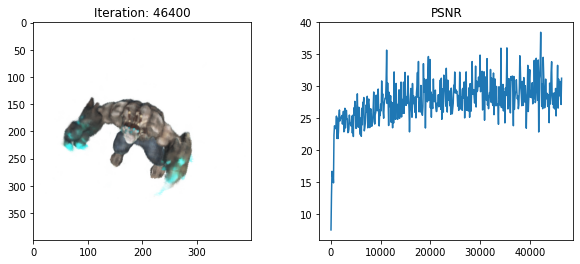

  6%|███▍                                                       | 46500/800001 [2:11:45<17:19:44, 12.08it/s]

[TRAIN] Iter: 46500 Loss_fine: 0.0010955798206850886 PSNR: 29.603561401367188


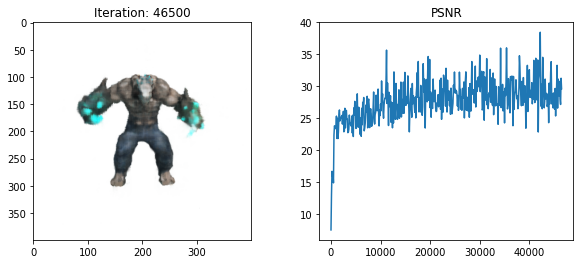

  6%|███▍                                                       | 46600/800001 [2:12:01<17:20:49, 12.06it/s]

[TRAIN] Iter: 46600 Loss_fine: 0.0009982881601899862 PSNR: 30.0074405670166


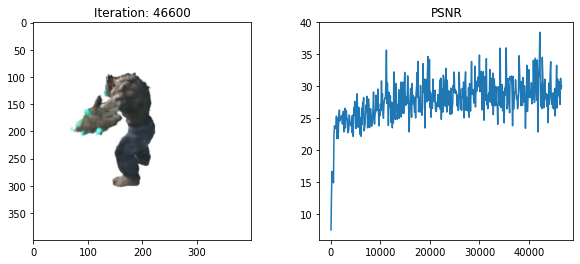

  6%|███▍                                                       | 46700/800001 [2:12:18<17:19:51, 12.07it/s]

[TRAIN] Iter: 46700 Loss_fine: 0.0017663831822574139 PSNR: 27.529151916503906


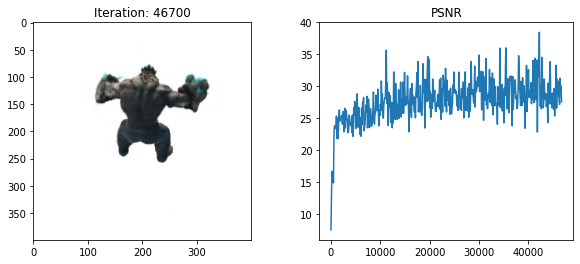

  6%|███▍                                                       | 46800/800001 [2:12:34<17:19:10, 12.08it/s]

[TRAIN] Iter: 46800 Loss_fine: 0.0005030132597312331 PSNR: 32.98420333862305


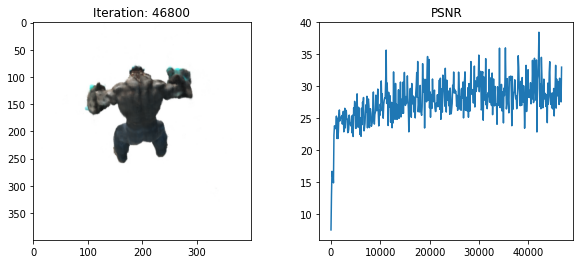

  6%|███▍                                                       | 46900/800001 [2:12:51<17:22:56, 12.03it/s]

[TRAIN] Iter: 46900 Loss_fine: 0.0014055873034521937 PSNR: 28.521419525146484


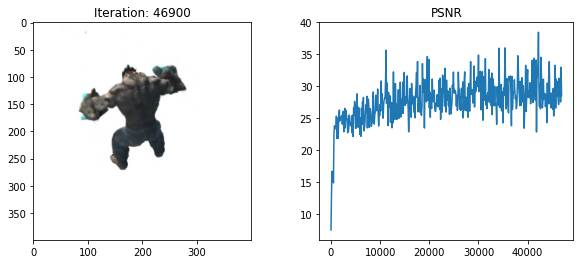

  6%|███▍                                                       | 47000/800001 [2:13:07<17:18:22, 12.09it/s]

[TRAIN] Iter: 47000 Loss_fine: 0.0018146643415093422 PSNR: 27.412036895751953


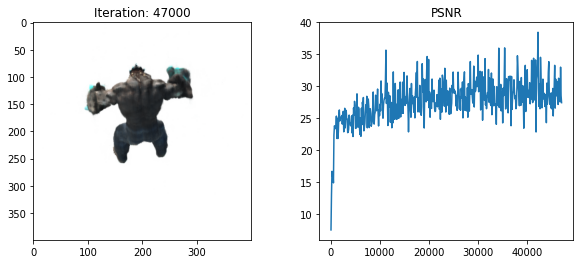

  6%|███▍                                                       | 47100/800001 [2:13:24<17:19:44, 12.07it/s]

[TRAIN] Iter: 47100 Loss_fine: 0.0002985368191730231 PSNR: 35.25001907348633


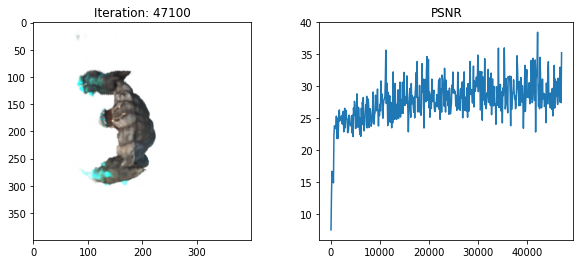

  6%|███▍                                                       | 47200/800001 [2:13:41<17:20:21, 12.06it/s]

[TRAIN] Iter: 47200 Loss_fine: 0.0028864711057394743 PSNR: 25.39632797241211


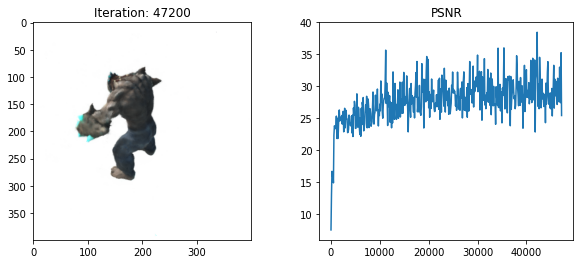

  6%|███▍                                                       | 47300/800001 [2:13:57<17:19:28, 12.07it/s]

[TRAIN] Iter: 47300 Loss_fine: 0.0013633931521326303 PSNR: 28.653789520263672


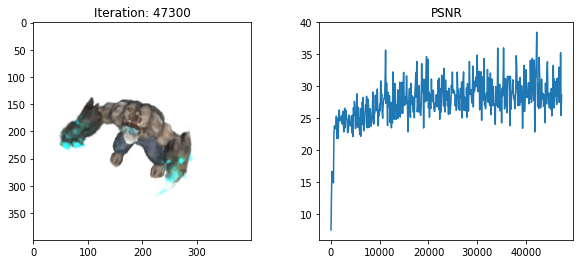

  6%|███▍                                                       | 47400/800001 [2:14:14<17:22:45, 12.03it/s]

[TRAIN] Iter: 47400 Loss_fine: 0.0007542953244410455 PSNR: 31.224586486816406


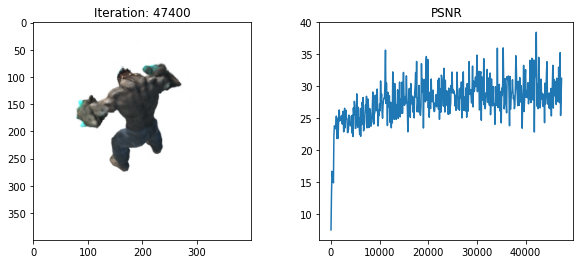

  6%|███▌                                                       | 47500/800001 [2:14:30<17:21:39, 12.04it/s]

[TRAIN] Iter: 47500 Loss_fine: 0.0020080110989511013 PSNR: 26.97233772277832


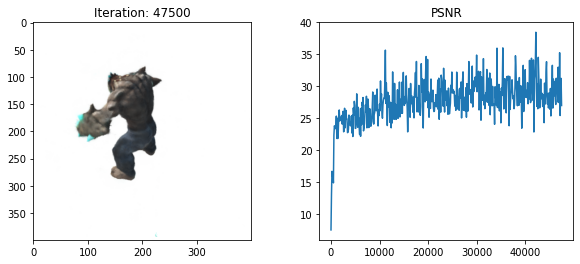

  6%|███▌                                                       | 47600/800001 [2:14:47<17:20:22, 12.05it/s]

[TRAIN] Iter: 47600 Loss_fine: 0.0017762158531695604 PSNR: 27.505043029785156


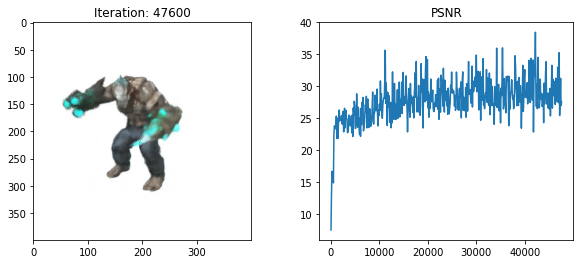

  6%|███▌                                                       | 47700/800001 [2:15:03<17:24:49, 12.00it/s]

[TRAIN] Iter: 47700 Loss_fine: 0.001973408740013838 PSNR: 27.047828674316406


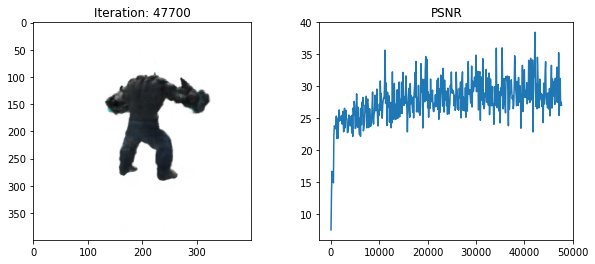

  6%|███▌                                                       | 47800/800001 [2:15:20<17:17:56, 12.08it/s]

[TRAIN] Iter: 47800 Loss_fine: 0.000643640523776412 PSNR: 31.91356658935547


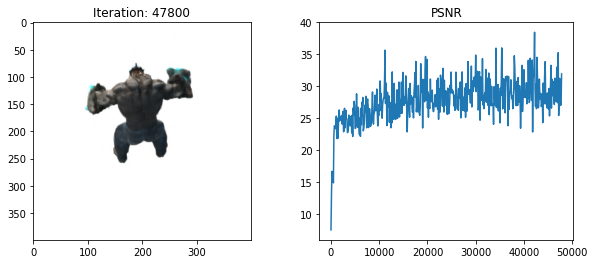

  6%|███▌                                                       | 47900/800001 [2:15:37<17:20:39, 12.05it/s]

[TRAIN] Iter: 47900 Loss_fine: 0.0020069011952728033 PSNR: 26.97473907470703


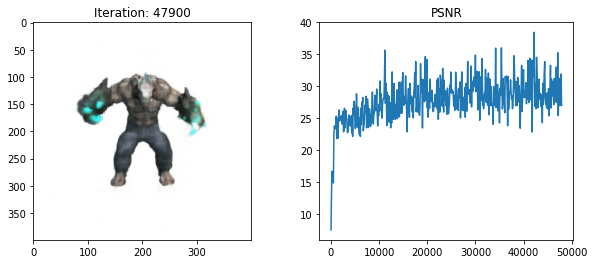

  6%|███▌                                                       | 48000/800001 [2:15:53<17:18:51, 12.06it/s]

[TRAIN] Iter: 48000 Loss_fine: 0.0012892453232780099 PSNR: 28.89664649963379


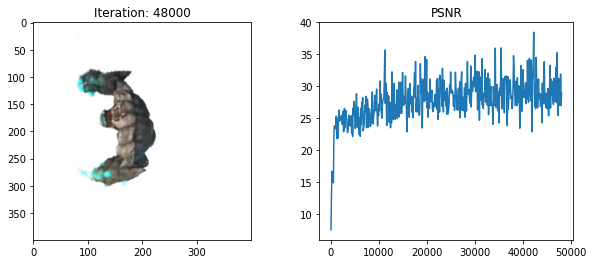

  6%|███▌                                                       | 48100/800001 [2:16:10<17:18:34, 12.07it/s]

[TRAIN] Iter: 48100 Loss_fine: 0.0022795661352574825 PSNR: 26.421478271484375


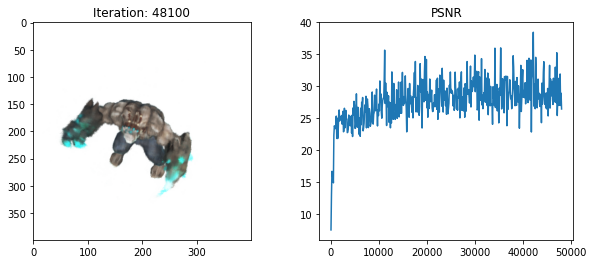

  6%|███▌                                                       | 48200/800001 [2:16:26<17:16:52, 12.08it/s]

[TRAIN] Iter: 48200 Loss_fine: 0.0011800723150372505 PSNR: 29.28091049194336


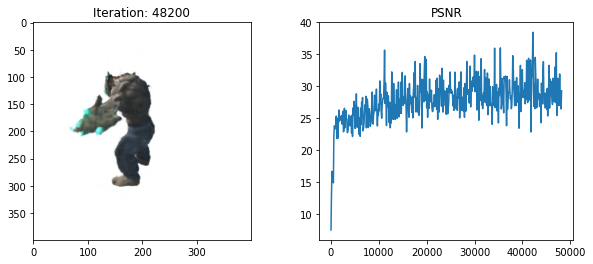

  6%|███▌                                                       | 48300/800001 [2:16:43<17:20:54, 12.04it/s]

[TRAIN] Iter: 48300 Loss_fine: 0.0006511235842481256 PSNR: 31.863365173339844


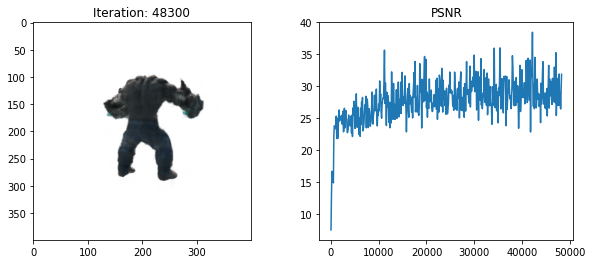

  6%|███▌                                                       | 48400/800001 [2:17:00<17:20:37, 12.04it/s]

[TRAIN] Iter: 48400 Loss_fine: 0.0003668697318062186 PSNR: 34.354881286621094


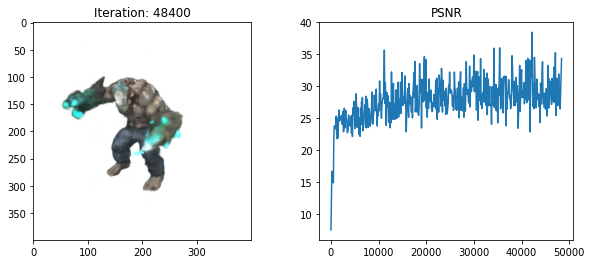

  6%|███▌                                                       | 48500/800001 [2:17:16<17:17:52, 12.07it/s]

[TRAIN] Iter: 48500 Loss_fine: 0.0006939433515071869 PSNR: 31.586759567260742


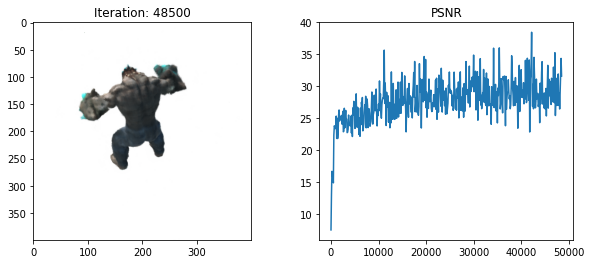

  6%|███▌                                                       | 48600/800001 [2:17:33<17:15:17, 12.10it/s]

[TRAIN] Iter: 48600 Loss_fine: 0.0016700202831998467 PSNR: 27.772783279418945


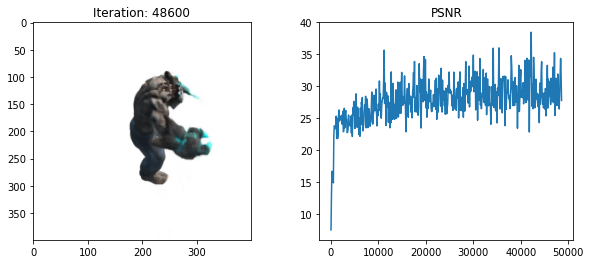

  6%|███▌                                                       | 48700/800001 [2:17:49<17:16:51, 12.08it/s]

[TRAIN] Iter: 48700 Loss_fine: 0.0009527356014586985 PSNR: 30.210275650024414


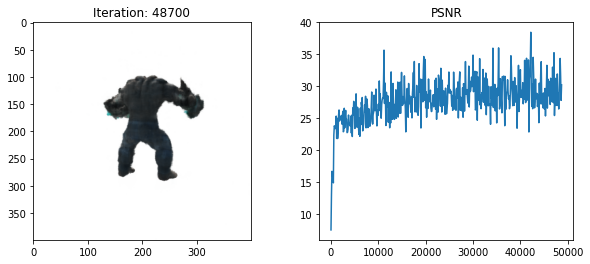

  6%|███▌                                                       | 48800/800001 [2:18:06<17:17:59, 12.06it/s]

[TRAIN] Iter: 48800 Loss_fine: 0.0006612261640839279 PSNR: 31.796497344970703


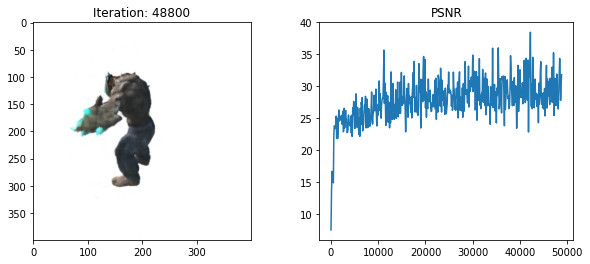

  6%|███▌                                                       | 48900/800001 [2:18:22<17:15:39, 12.09it/s]

[TRAIN] Iter: 48900 Loss_fine: 0.002466643927618861 PSNR: 26.078933715820312


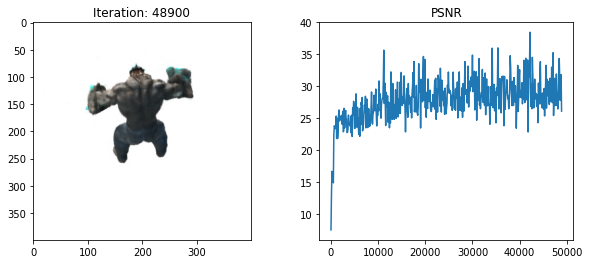

  6%|███▌                                                       | 49000/800001 [2:18:39<17:18:58, 12.05it/s]

[TRAIN] Iter: 49000 Loss_fine: 0.0002888461749535054 PSNR: 35.393333435058594


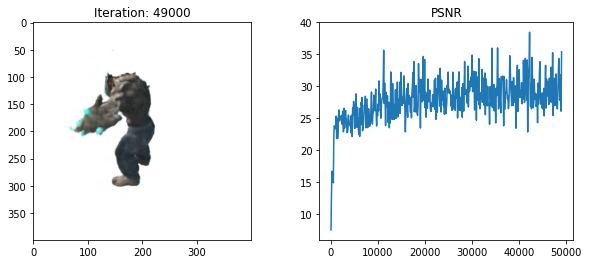

  6%|███▌                                                       | 49100/800001 [2:18:56<17:19:39, 12.04it/s]

[TRAIN] Iter: 49100 Loss_fine: 0.005002012010663748 PSNR: 23.00855255126953


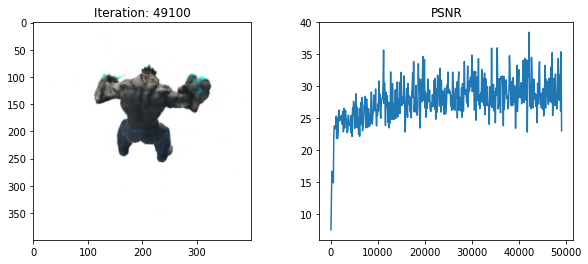

  6%|███▋                                                       | 49200/800001 [2:19:12<17:23:13, 11.99it/s]

[TRAIN] Iter: 49200 Loss_fine: 0.0005284068756736815 PSNR: 32.77031326293945


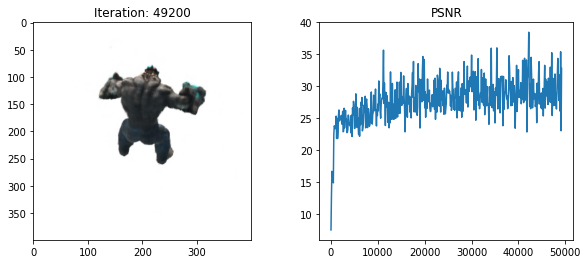

  6%|███▋                                                       | 49300/800001 [2:19:29<17:25:18, 11.97it/s]

[TRAIN] Iter: 49300 Loss_fine: 0.0016242514830082655 PSNR: 27.89346694946289


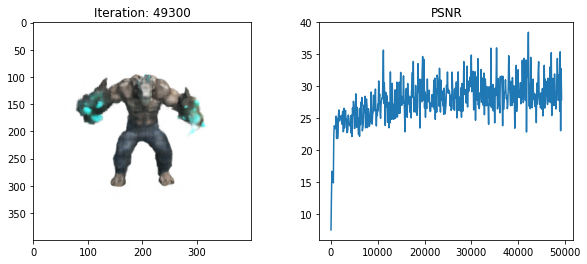

  6%|███▋                                                       | 49400/800001 [2:19:45<17:15:39, 12.08it/s]

[TRAIN] Iter: 49400 Loss_fine: 0.0005318911280483007 PSNR: 32.74177169799805


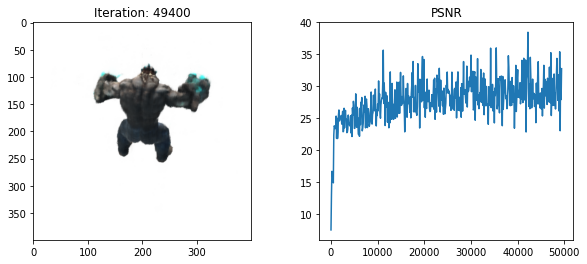

  6%|███▋                                                       | 49500/800001 [2:20:02<17:15:57, 12.07it/s]

[TRAIN] Iter: 49500 Loss_fine: 0.000280401756754145 PSNR: 35.52219009399414


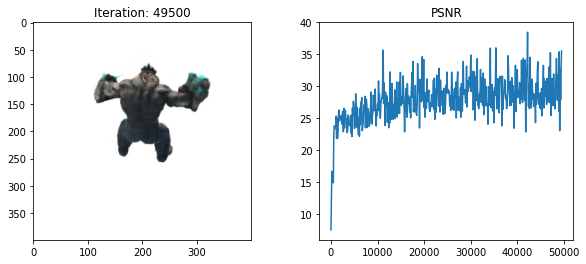

  6%|███▋                                                       | 49600/800001 [2:20:18<17:19:46, 12.03it/s]

[TRAIN] Iter: 49600 Loss_fine: 0.004197720438241959 PSNR: 23.769865036010742


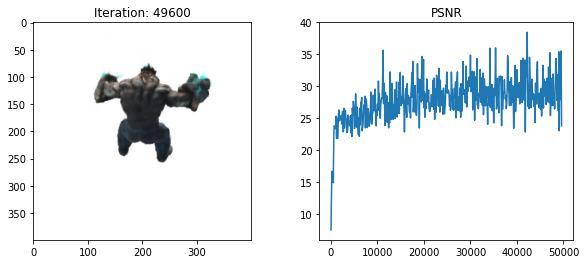

  6%|███▋                                                       | 49700/800001 [2:20:35<17:16:05, 12.07it/s]

[TRAIN] Iter: 49700 Loss_fine: 0.000794646271970123 PSNR: 30.998258590698242


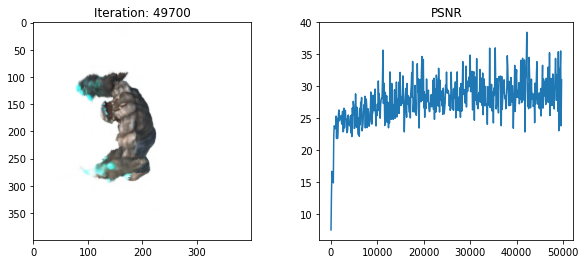

  6%|███▋                                                       | 49800/800001 [2:20:52<17:16:17, 12.07it/s]

[TRAIN] Iter: 49800 Loss_fine: 0.001843213220126927 PSNR: 27.34424591064453


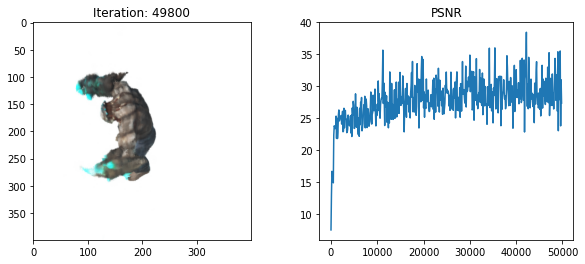

  6%|███▋                                                       | 49900/800001 [2:21:08<17:17:02, 12.06it/s]

[TRAIN] Iter: 49900 Loss_fine: 0.0012589616235345602 PSNR: 28.999876022338867


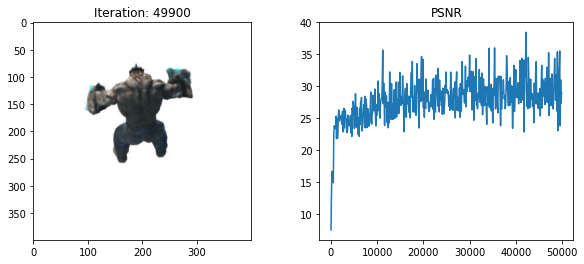

  6%|███▋                                                       | 50000/800001 [2:21:25<17:18:27, 12.04it/s]

[TRAIN] Iter: 50000 Loss_fine: 0.0010563732357695699 PSNR: 29.761825561523438


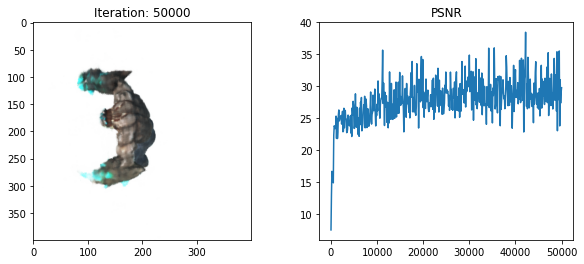

  6%|███▋                                                       | 50100/800001 [2:21:41<17:21:33, 12.00it/s]

[TRAIN] Iter: 50100 Loss_fine: 0.0020028206054121256 PSNR: 26.983579635620117


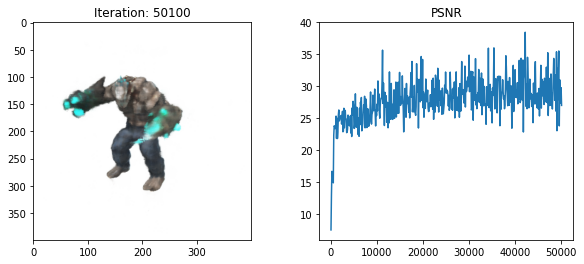

  6%|███▋                                                       | 50200/800001 [2:21:58<17:14:35, 12.08it/s]

[TRAIN] Iter: 50200 Loss_fine: 0.0005491902702488005 PSNR: 32.6027717590332


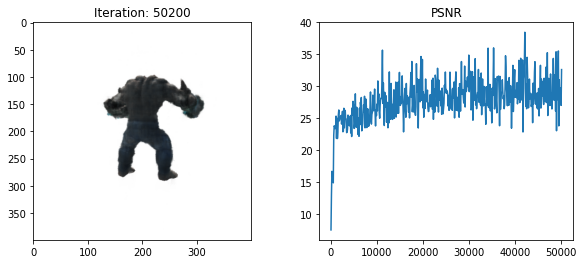

  6%|███▋                                                       | 50300/800001 [2:22:15<17:14:55, 12.07it/s]

[TRAIN] Iter: 50300 Loss_fine: 0.0031576412729918957 PSNR: 25.006372451782227


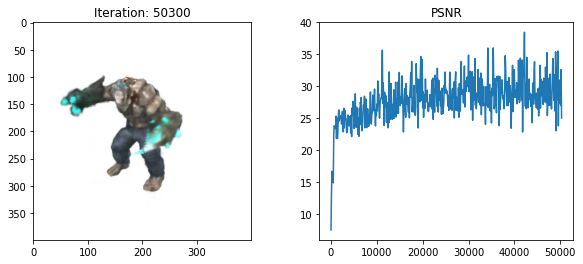

  6%|███▋                                                       | 50400/800001 [2:22:31<17:18:48, 12.03it/s]

[TRAIN] Iter: 50400 Loss_fine: 0.0035446712281554937 PSNR: 24.50423812866211


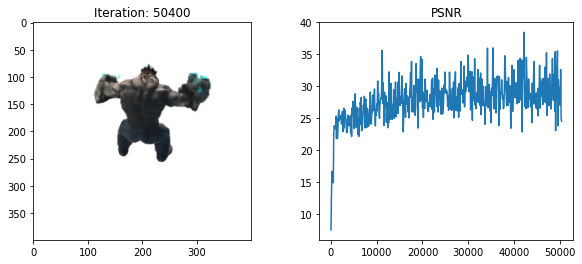

  6%|███▋                                                       | 50500/800001 [2:22:48<17:16:38, 12.05it/s]

[TRAIN] Iter: 50500 Loss_fine: 0.0028592899907380342 PSNR: 25.43741798400879


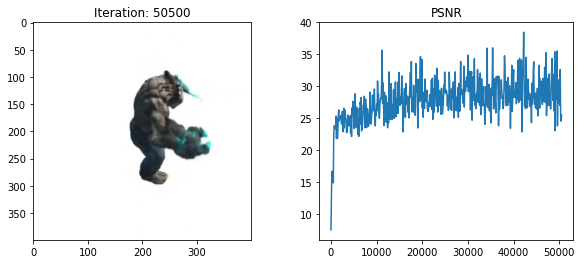

  6%|███▋                                                       | 50600/800001 [2:23:04<17:17:42, 12.04it/s]

[TRAIN] Iter: 50600 Loss_fine: 0.0011844995897263288 PSNR: 29.2646484375


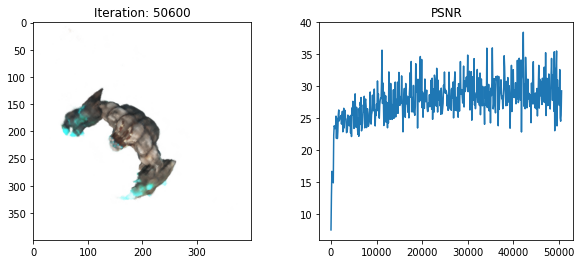

  6%|███▋                                                       | 50700/800001 [2:23:21<17:15:45, 12.06it/s]

[TRAIN] Iter: 50700 Loss_fine: 0.0005081375711597502 PSNR: 32.940185546875


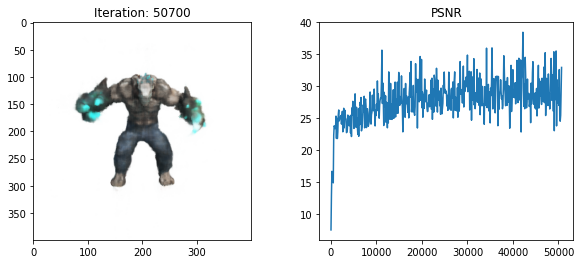

  6%|███▋                                                       | 50800/800001 [2:23:37<17:14:12, 12.07it/s]

[TRAIN] Iter: 50800 Loss_fine: 0.0011537506943568587 PSNR: 29.37887954711914


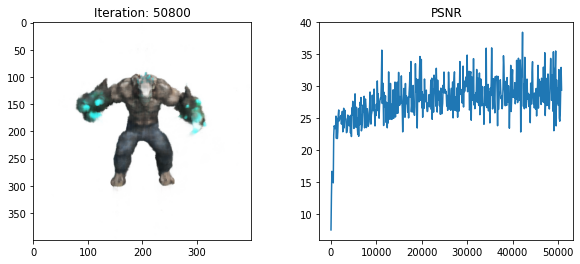

  6%|███▊                                                       | 50900/800001 [2:23:54<17:14:00, 12.07it/s]

[TRAIN] Iter: 50900 Loss_fine: 0.0006144977523945272 PSNR: 32.11479568481445


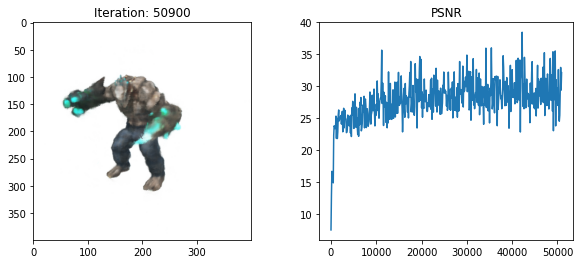

  6%|███▊                                                       | 51000/800001 [2:24:11<17:14:21, 12.07it/s]

[TRAIN] Iter: 51000 Loss_fine: 0.00036148729850538075 PSNR: 34.419071197509766


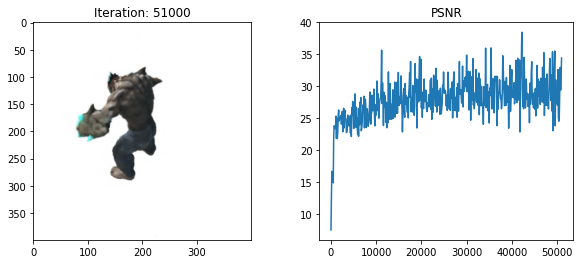

  6%|███▊                                                       | 51100/800001 [2:24:27<17:22:13, 11.98it/s]

[TRAIN] Iter: 51100 Loss_fine: 0.001280279248021543 PSNR: 28.926950454711914


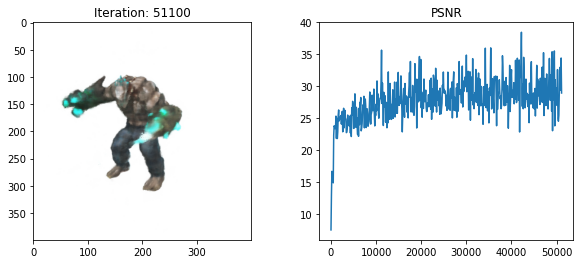

  6%|███▊                                                       | 51200/800001 [2:24:44<17:13:35, 12.07it/s]

[TRAIN] Iter: 51200 Loss_fine: 0.0004531338927336037 PSNR: 33.4377326965332


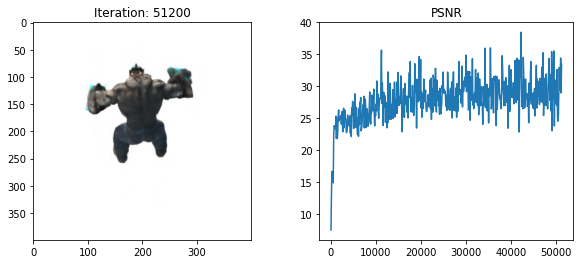

  6%|███▊                                                       | 51300/800001 [2:25:00<17:14:49, 12.06it/s]

[TRAIN] Iter: 51300 Loss_fine: 0.0008127626497298479 PSNR: 30.900360107421875


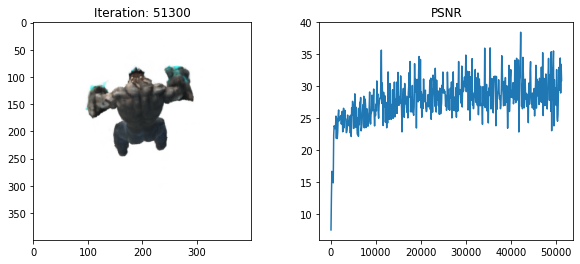

  6%|███▊                                                       | 51400/800001 [2:25:17<17:14:14, 12.06it/s]

[TRAIN] Iter: 51400 Loss_fine: 0.0007716150139458477 PSNR: 31.12598991394043


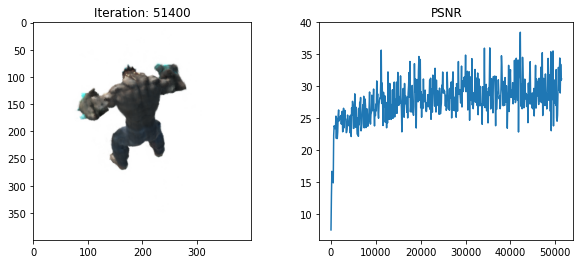

  6%|███▊                                                       | 51500/800001 [2:25:34<17:20:33, 11.99it/s]

[TRAIN] Iter: 51500 Loss_fine: 0.001501353457570076 PSNR: 28.23516845703125


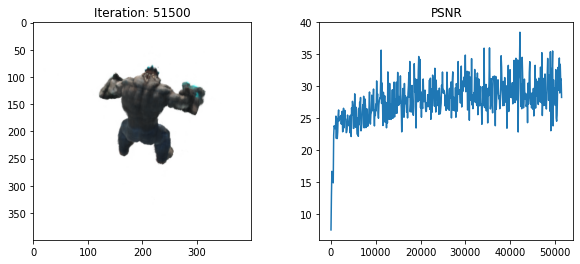

  6%|███▊                                                       | 51600/800001 [2:25:50<17:19:12, 12.00it/s]

[TRAIN] Iter: 51600 Loss_fine: 0.0013032802380621433 PSNR: 28.84962272644043


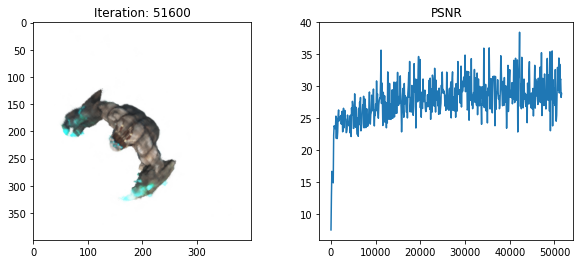

  6%|███▊                                                       | 51700/800001 [2:26:07<17:16:12, 12.04it/s]

[TRAIN] Iter: 51700 Loss_fine: 0.002097589196637273 PSNR: 26.782793045043945


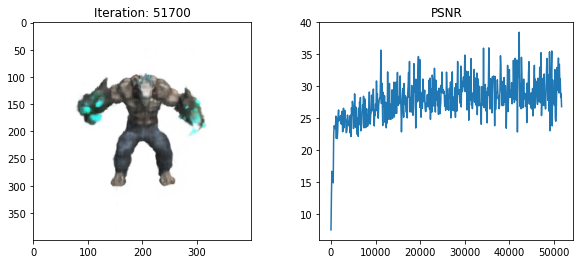

  6%|███▊                                                       | 51800/800001 [2:26:23<17:13:03, 12.07it/s]

[TRAIN] Iter: 51800 Loss_fine: 0.0008048802264966071 PSNR: 30.942686080932617


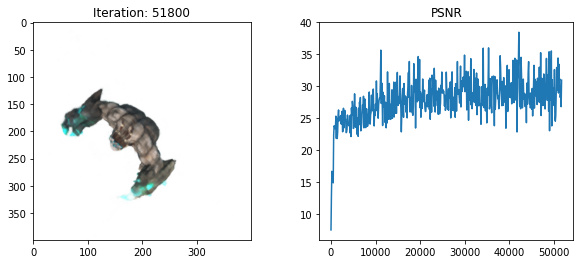

  6%|███▊                                                       | 51900/800001 [2:26:40<17:13:20, 12.07it/s]

[TRAIN] Iter: 51900 Loss_fine: 0.0020021472591906786 PSNR: 26.98503875732422


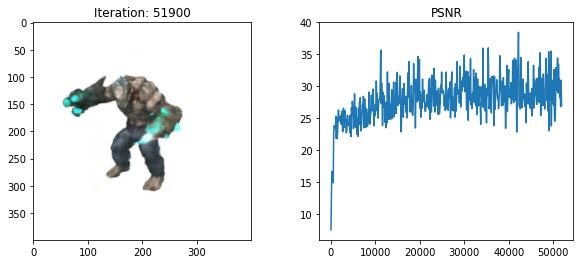

  6%|███▊                                                       | 52000/800001 [2:26:57<17:14:13, 12.05it/s]

[TRAIN] Iter: 52000 Loss_fine: 0.0008641468593850732 PSNR: 30.634122848510742


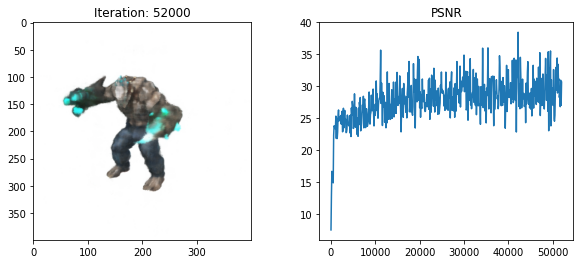

  7%|███▊                                                       | 52100/800001 [2:27:13<17:11:10, 12.09it/s]

[TRAIN] Iter: 52100 Loss_fine: 0.0007007922977209091 PSNR: 31.544105529785156


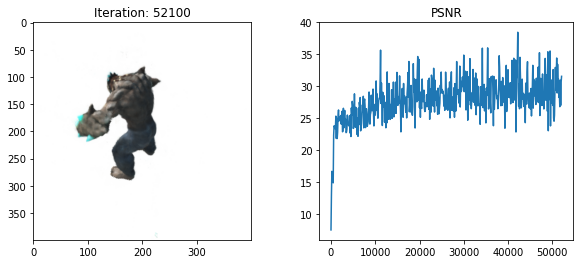

  7%|███▊                                                       | 52200/800001 [2:27:30<17:17:44, 12.01it/s]

[TRAIN] Iter: 52200 Loss_fine: 0.0006615804741159081 PSNR: 31.794172286987305


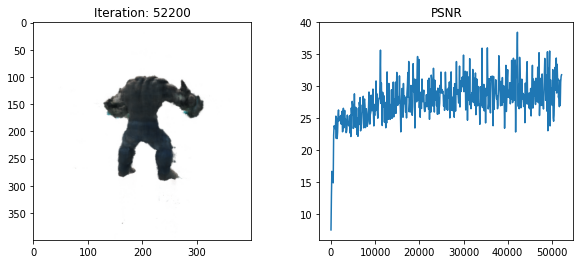

  7%|███▊                                                       | 52300/800001 [2:27:46<17:12:28, 12.07it/s]

[TRAIN] Iter: 52300 Loss_fine: 0.0017261801986023784 PSNR: 27.629138946533203


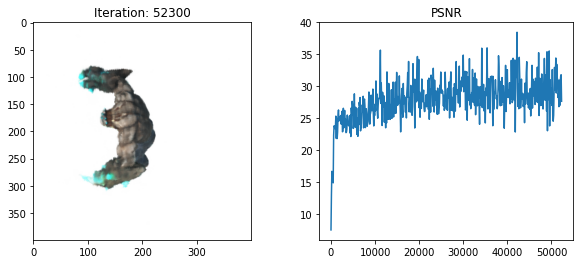

  7%|███▊                                                       | 52400/800001 [2:28:03<17:10:58, 12.09it/s]

[TRAIN] Iter: 52400 Loss_fine: 0.0012547048972919583 PSNR: 29.014583587646484


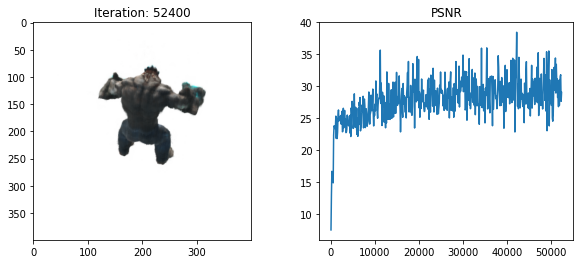

  7%|███▊                                                       | 52500/800001 [2:28:19<17:16:01, 12.03it/s]

[TRAIN] Iter: 52500 Loss_fine: 0.0024143599439412355 PSNR: 26.171979904174805


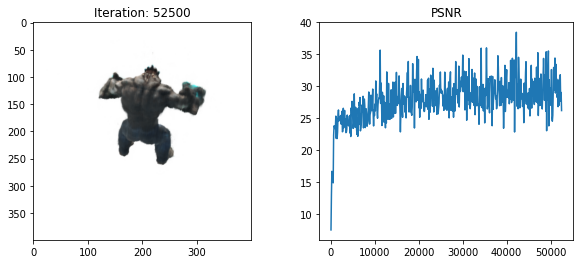

  7%|███▉                                                       | 52600/800001 [2:28:36<17:08:32, 12.11it/s]

[TRAIN] Iter: 52600 Loss_fine: 0.00043095811270177364 PSNR: 33.65564727783203


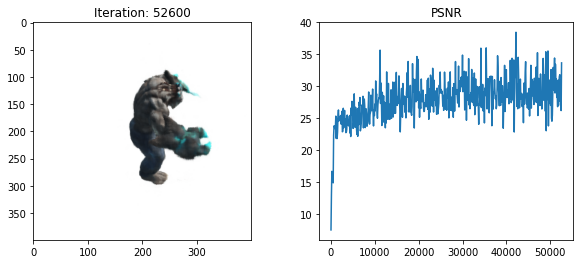

  7%|███▉                                                       | 52700/800001 [2:28:53<17:09:55, 12.09it/s]

[TRAIN] Iter: 52700 Loss_fine: 0.001490777125582099 PSNR: 28.265872955322266


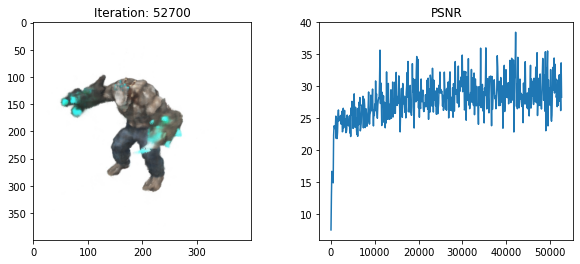

  7%|███▉                                                       | 52800/800001 [2:29:09<17:13:37, 12.05it/s]

[TRAIN] Iter: 52800 Loss_fine: 0.0008432001923210919 PSNR: 30.740694046020508


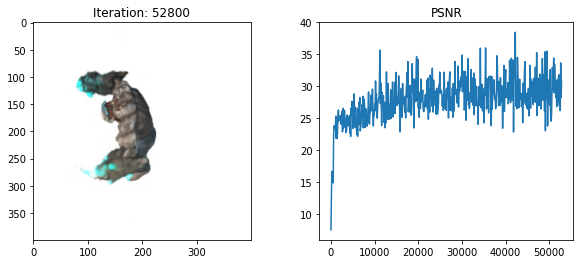

  7%|███▉                                                       | 52900/800001 [2:29:26<17:27:34, 11.89it/s]

[TRAIN] Iter: 52900 Loss_fine: 0.0005558949196711183 PSNR: 32.550071716308594


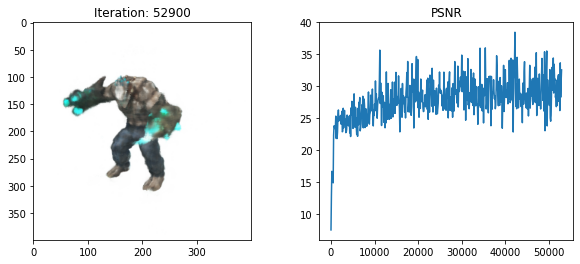

  7%|███▉                                                       | 53000/800001 [2:29:42<17:12:04, 12.06it/s]

[TRAIN] Iter: 53000 Loss_fine: 0.001632968196645379 PSNR: 27.870223999023438


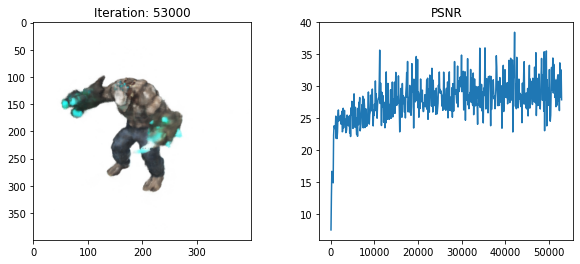

  7%|███▉                                                       | 53100/800001 [2:29:59<17:11:28, 12.07it/s]

[TRAIN] Iter: 53100 Loss_fine: 0.002608049428090453 PSNR: 25.836843490600586


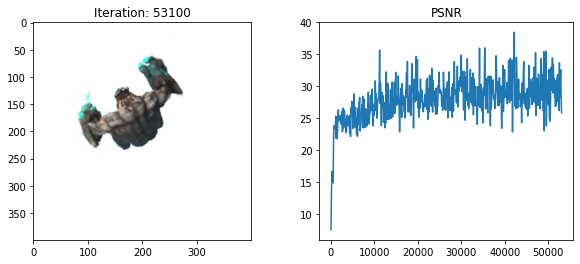

  7%|███▉                                                       | 53200/800001 [2:30:16<17:14:52, 12.03it/s]

[TRAIN] Iter: 53200 Loss_fine: 0.001358137116767466 PSNR: 28.670562744140625


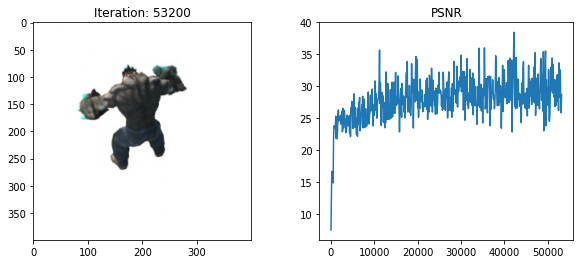

  7%|███▉                                                       | 53300/800001 [2:30:32<17:11:20, 12.07it/s]

[TRAIN] Iter: 53300 Loss_fine: 0.0003726938448380679 PSNR: 34.286476135253906


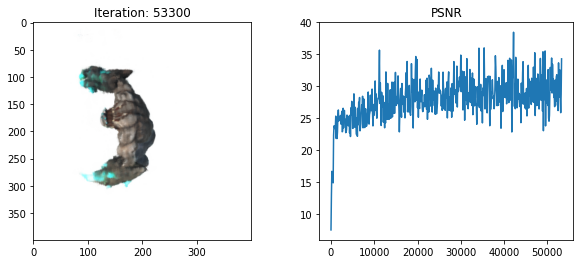

  7%|███▉                                                       | 53400/800001 [2:30:49<17:14:17, 12.03it/s]

[TRAIN] Iter: 53400 Loss_fine: 0.0006295025232248008 PSNR: 32.01002502441406


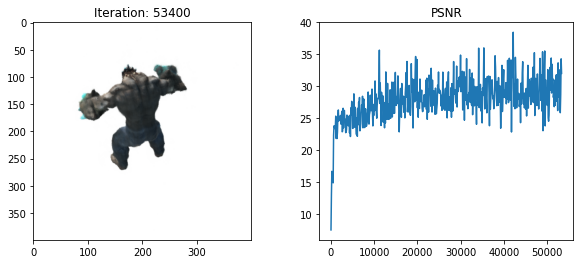

  7%|███▉                                                       | 53500/800001 [2:31:05<17:09:35, 12.08it/s]

[TRAIN] Iter: 53500 Loss_fine: 0.0002942566352430731 PSNR: 35.31273651123047


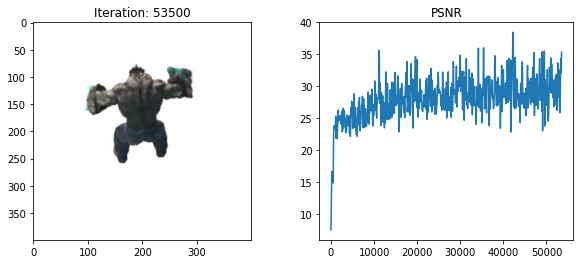

  7%|███▉                                                       | 53600/800001 [2:31:22<17:08:48, 12.09it/s]

[TRAIN] Iter: 53600 Loss_fine: 0.0004538028151728213 PSNR: 33.43132781982422


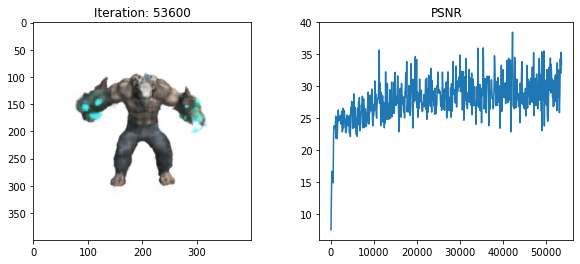

  7%|███▉                                                       | 53700/800001 [2:31:38<17:10:31, 12.07it/s]

[TRAIN] Iter: 53700 Loss_fine: 0.00027667597169056535 PSNR: 35.580284118652344


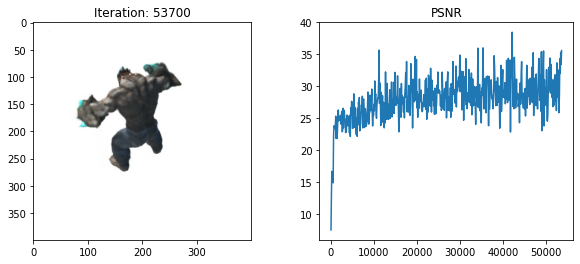

  7%|███▉                                                       | 53800/800001 [2:31:55<17:11:01, 12.06it/s]

[TRAIN] Iter: 53800 Loss_fine: 0.00155129365157336 PSNR: 28.093059539794922


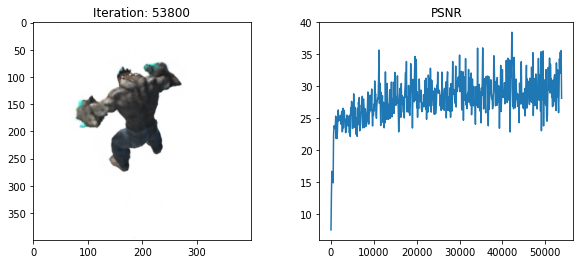

  7%|███▉                                                       | 53900/800001 [2:32:12<17:16:45, 11.99it/s]

[TRAIN] Iter: 53900 Loss_fine: 0.000714107824023813 PSNR: 31.462364196777344


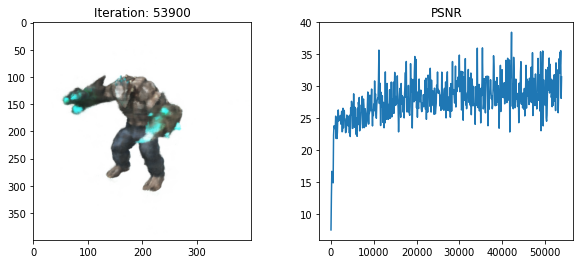

  7%|███▉                                                       | 54000/800001 [2:32:28<17:16:29, 12.00it/s]

[TRAIN] Iter: 54000 Loss_fine: 0.0015397716779261827 PSNR: 28.12543487548828


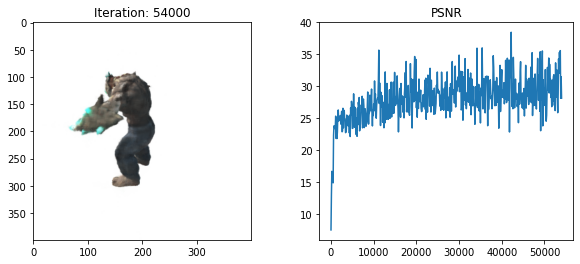

  7%|███▉                                                       | 54100/800001 [2:32:45<17:19:06, 11.96it/s]

[TRAIN] Iter: 54100 Loss_fine: 0.0005865743733011186 PSNR: 32.316768646240234


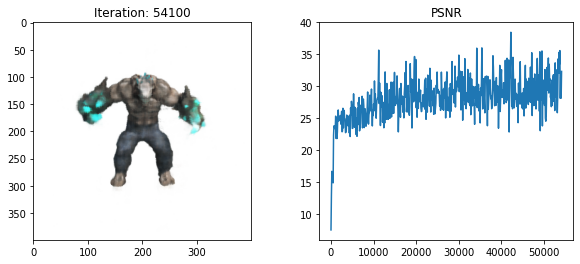

  7%|███▉                                                       | 54200/800001 [2:33:01<17:07:35, 12.10it/s]

[TRAIN] Iter: 54200 Loss_fine: 0.0014799354830756783 PSNR: 28.297569274902344


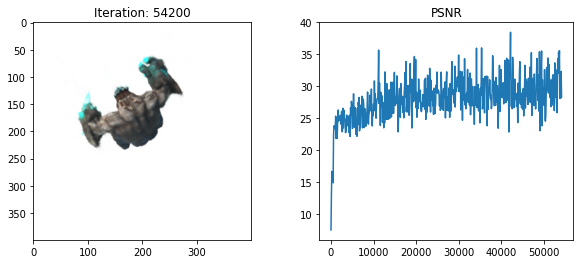

  7%|████                                                       | 54300/800001 [2:33:18<17:13:38, 12.02it/s]

[TRAIN] Iter: 54300 Loss_fine: 0.0007616871735081077 PSNR: 31.182231903076172


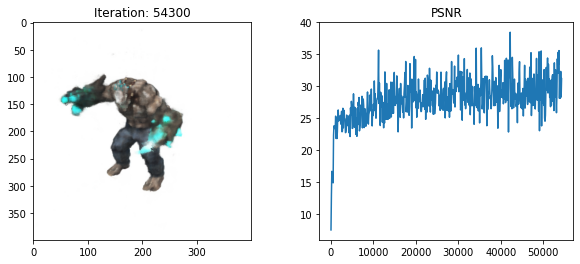

  7%|████                                                       | 54400/800001 [2:33:35<17:16:04, 11.99it/s]

[TRAIN] Iter: 54400 Loss_fine: 0.002448385814204812 PSNR: 26.1112003326416


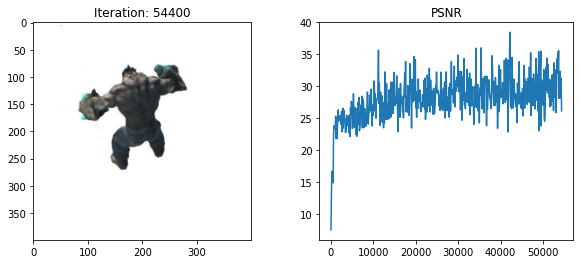

  7%|████                                                       | 54500/800001 [2:33:51<17:09:53, 12.06it/s]

[TRAIN] Iter: 54500 Loss_fine: 0.0041806697845458984 PSNR: 23.787540435791016


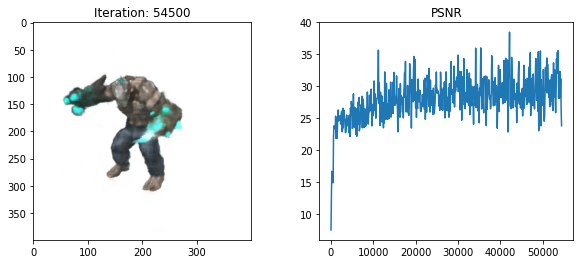

  7%|████                                                       | 54600/800001 [2:34:08<17:09:04, 12.07it/s]

[TRAIN] Iter: 54600 Loss_fine: 0.002751569962128997 PSNR: 25.60419464111328


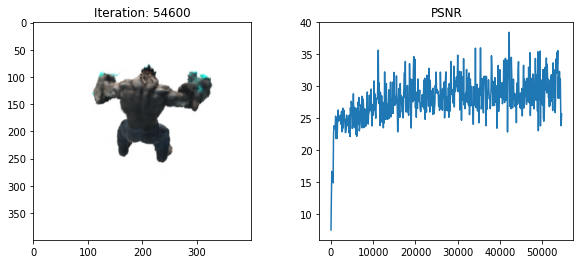

  7%|████                                                       | 54700/800001 [2:34:24<17:09:15, 12.07it/s]

[TRAIN] Iter: 54700 Loss_fine: 0.001233907649293542 PSNR: 29.087173461914062


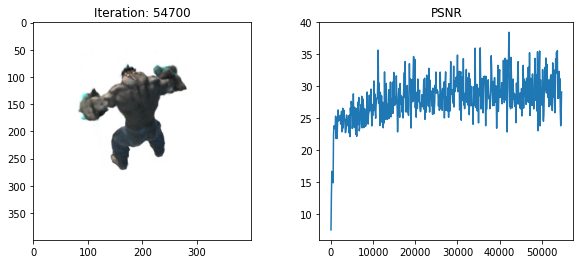

  7%|████                                                       | 54800/800001 [2:34:41<17:09:17, 12.07it/s]

[TRAIN] Iter: 54800 Loss_fine: 0.0005579577409662306 PSNR: 32.53398513793945


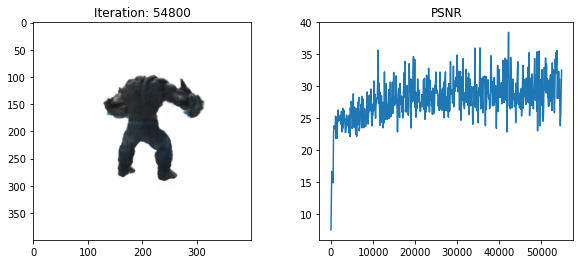

  7%|████                                                       | 54900/800001 [2:34:57<17:11:41, 12.04it/s]

[TRAIN] Iter: 54900 Loss_fine: 0.0007584026316180825 PSNR: 31.20100212097168


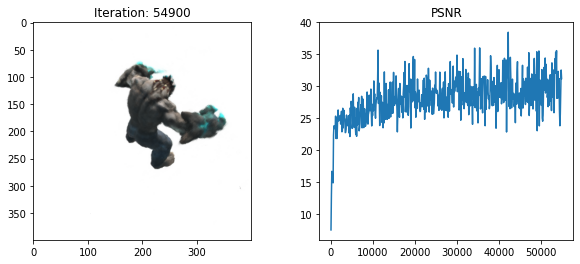

  7%|████                                                       | 55000/800001 [2:35:14<17:08:42, 12.07it/s]

[TRAIN] Iter: 55000 Loss_fine: 0.0020538857206702232 PSNR: 26.874237060546875


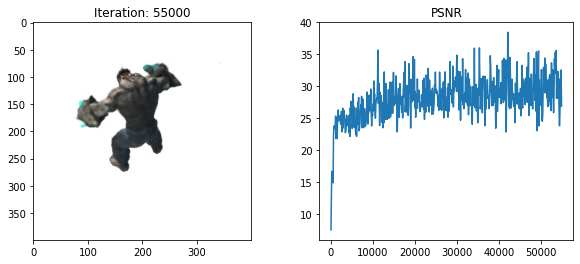

  7%|████                                                       | 55100/800001 [2:35:31<17:07:47, 12.08it/s]

[TRAIN] Iter: 55100 Loss_fine: 0.0008471203618682921 PSNR: 30.720548629760742


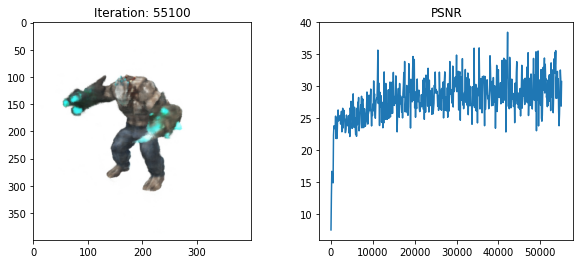

  7%|████                                                       | 55200/800001 [2:35:47<17:11:54, 12.03it/s]

[TRAIN] Iter: 55200 Loss_fine: 0.004034227225929499 PSNR: 23.942394256591797


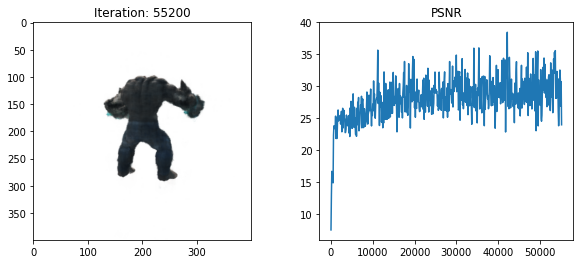

  7%|████                                                       | 55300/800001 [2:36:04<17:09:56, 12.05it/s]

[TRAIN] Iter: 55300 Loss_fine: 0.001172065269201994 PSNR: 29.310483932495117


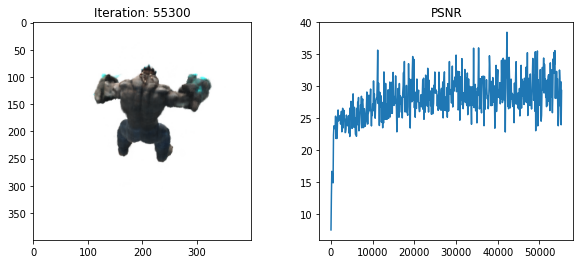

  7%|████                                                       | 55400/800001 [2:36:20<17:08:03, 12.07it/s]

[TRAIN] Iter: 55400 Loss_fine: 0.0021367166191339493 PSNR: 26.702529907226562


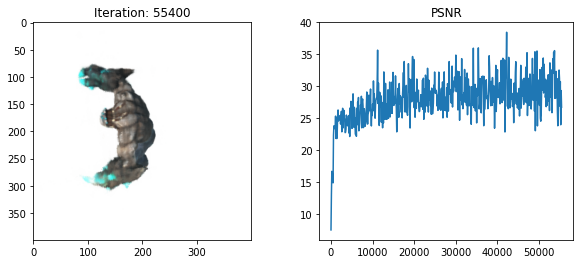

  7%|████                                                       | 55500/800001 [2:36:37<17:08:00, 12.07it/s]

[TRAIN] Iter: 55500 Loss_fine: 0.0016706015449017286 PSNR: 27.771270751953125


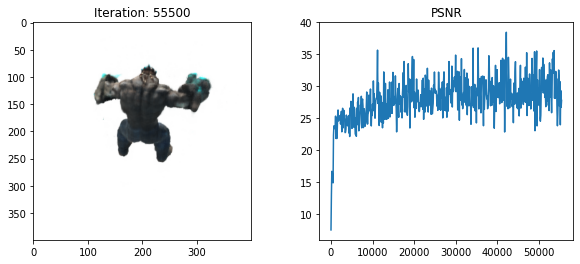

  7%|████                                                       | 55600/800001 [2:36:54<17:08:28, 12.06it/s]

[TRAIN] Iter: 55600 Loss_fine: 0.0009439588175155222 PSNR: 30.250469207763672


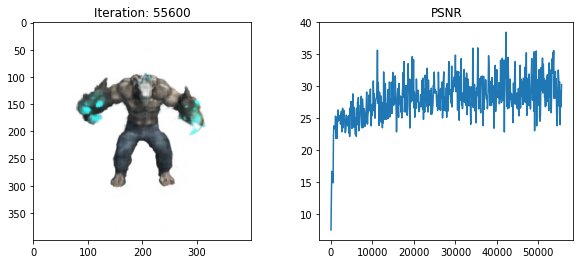

  7%|████                                                       | 55700/800001 [2:37:10<17:10:37, 12.04it/s]

[TRAIN] Iter: 55700 Loss_fine: 0.0005568169872276485 PSNR: 32.54287338256836


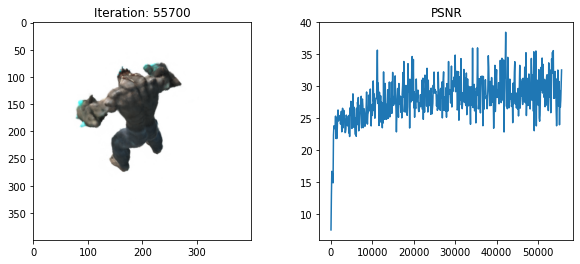

  7%|████                                                       | 55800/800001 [2:37:27<17:13:22, 12.00it/s]

[TRAIN] Iter: 55800 Loss_fine: 0.003556495066732168 PSNR: 24.489778518676758


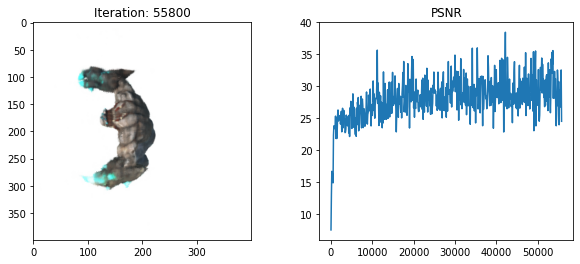

  7%|████                                                       | 55900/800001 [2:37:43<17:06:23, 12.08it/s]

[TRAIN] Iter: 55900 Loss_fine: 0.00129033497069031 PSNR: 28.892974853515625


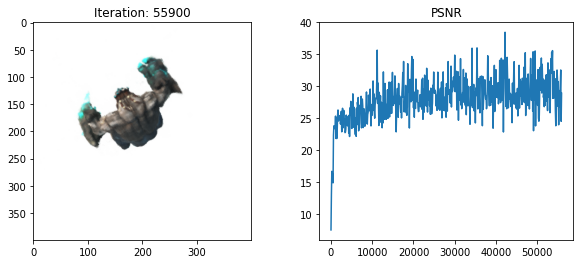

  7%|████▏                                                      | 56000/800001 [2:38:00<17:07:32, 12.07it/s]

[TRAIN] Iter: 56000 Loss_fine: 0.00046810117783024907 PSNR: 33.296600341796875


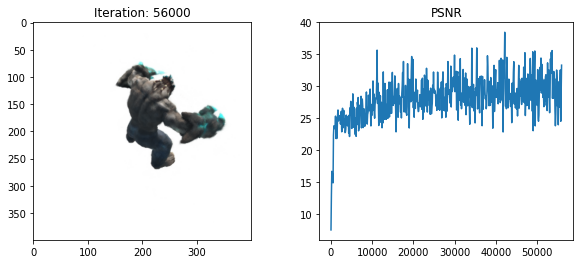

  7%|████▏                                                      | 56100/800001 [2:38:16<17:10:01, 12.04it/s]

[TRAIN] Iter: 56100 Loss_fine: 0.0008651908137835562 PSNR: 30.62887954711914


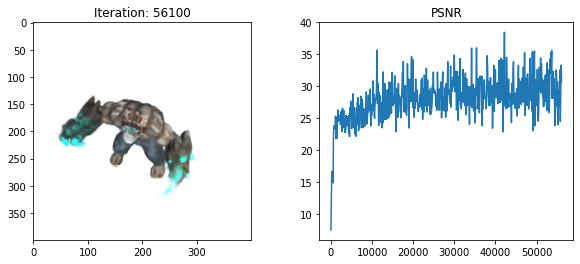

  7%|████▏                                                      | 56200/800001 [2:38:33<17:07:55, 12.06it/s]

[TRAIN] Iter: 56200 Loss_fine: 0.0019527721451595426 PSNR: 27.09348487854004


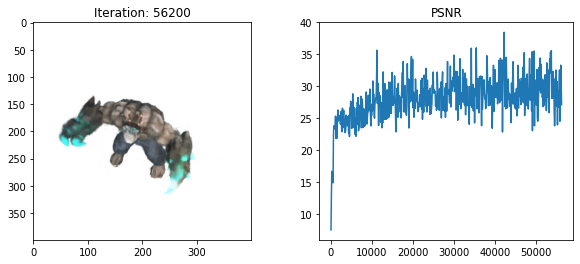

  7%|████▏                                                      | 56300/800001 [2:38:50<17:06:44, 12.07it/s]

[TRAIN] Iter: 56300 Loss_fine: 0.0013779712608084083 PSNR: 28.60759735107422


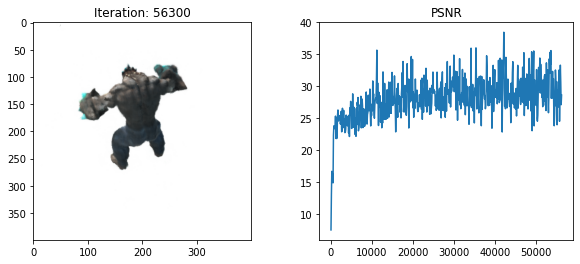

  7%|████▏                                                      | 56400/800001 [2:39:06<17:06:10, 12.08it/s]

[TRAIN] Iter: 56400 Loss_fine: 0.0005331627326086164 PSNR: 32.73139953613281


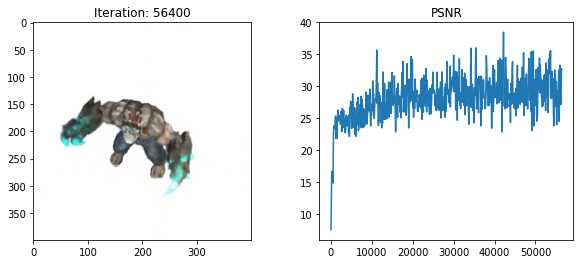

  7%|████▏                                                      | 56500/800001 [2:39:23<17:08:22, 12.05it/s]

[TRAIN] Iter: 56500 Loss_fine: 0.00047432369319722056 PSNR: 33.239253997802734


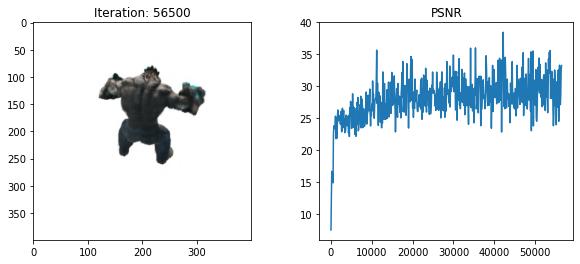

  7%|████▏                                                      | 56600/800001 [2:39:39<17:06:55, 12.07it/s]

[TRAIN] Iter: 56600 Loss_fine: 0.0022301345597952604 PSNR: 26.51668930053711


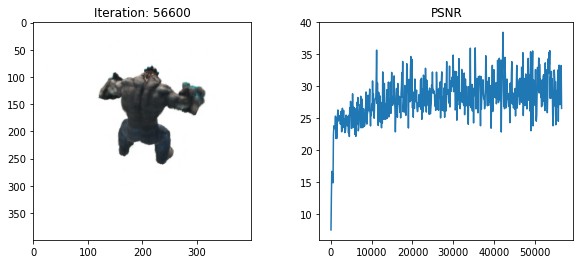

  7%|████▏                                                      | 56700/800001 [2:39:56<17:05:33, 12.08it/s]

[TRAIN] Iter: 56700 Loss_fine: 0.0007423425558954477 PSNR: 31.293956756591797


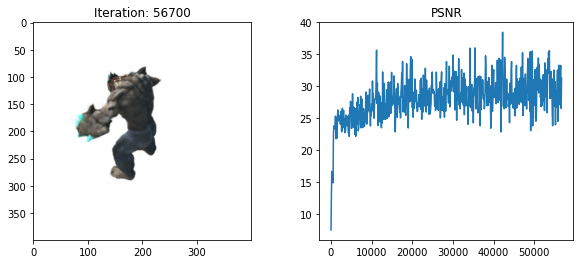

  7%|████▏                                                      | 56800/800001 [2:40:13<17:05:59, 12.07it/s]

[TRAIN] Iter: 56800 Loss_fine: 0.0010719593847170472 PSNR: 29.698217391967773


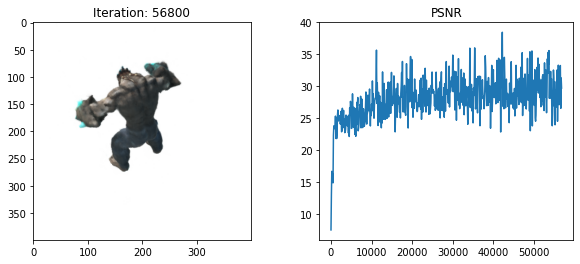

  7%|████▏                                                      | 56900/800001 [2:40:29<17:05:31, 12.08it/s]

[TRAIN] Iter: 56900 Loss_fine: 0.0004011337296105921 PSNR: 33.96710968017578


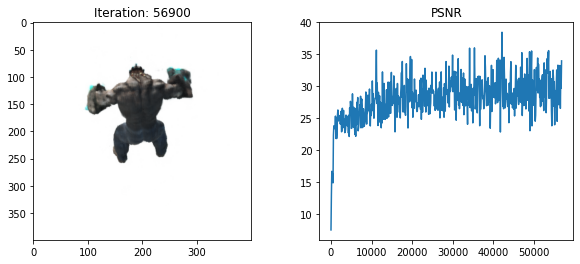

  7%|████▏                                                      | 57000/800001 [2:40:46<17:05:51, 12.07it/s]

[TRAIN] Iter: 57000 Loss_fine: 0.0006136356969363987 PSNR: 32.12089157104492


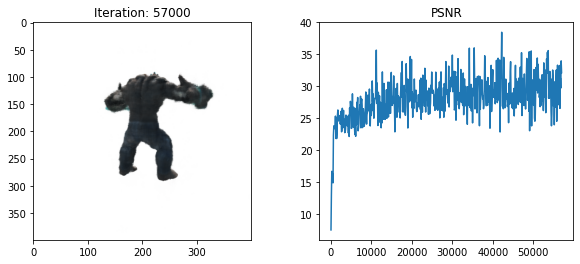

  7%|████▏                                                      | 57100/800001 [2:41:02<17:09:26, 12.03it/s]

[TRAIN] Iter: 57100 Loss_fine: 0.001191942486912012 PSNR: 29.237445831298828


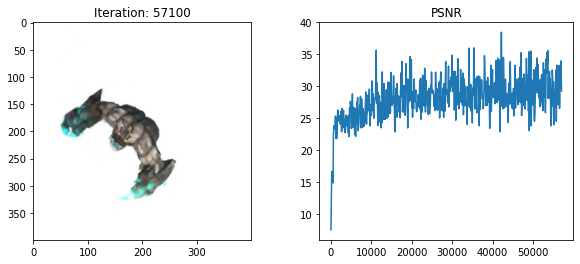

  7%|████▏                                                      | 57200/800001 [2:41:19<17:05:14, 12.08it/s]

[TRAIN] Iter: 57200 Loss_fine: 0.0009230868890881538 PSNR: 30.347572326660156


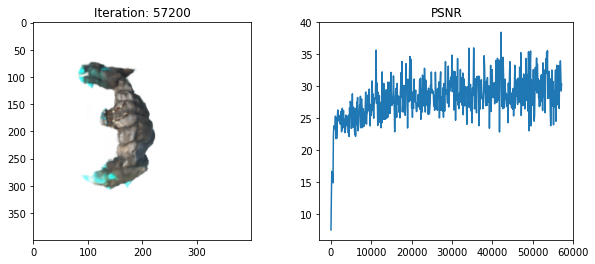

  7%|████▏                                                      | 57300/800001 [2:41:35<17:08:33, 12.03it/s]

[TRAIN] Iter: 57300 Loss_fine: 0.0015476589323952794 PSNR: 28.103248596191406


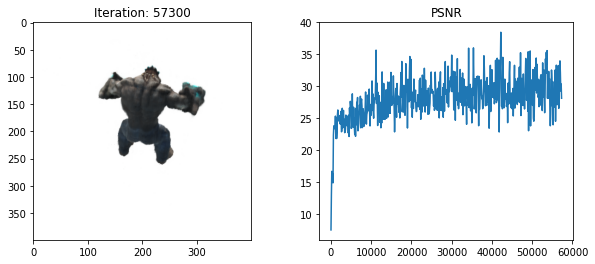

  7%|████▏                                                      | 57400/800001 [2:41:52<17:07:59, 12.04it/s]

[TRAIN] Iter: 57400 Loss_fine: 0.0004734282847493887 PSNR: 33.24745559692383


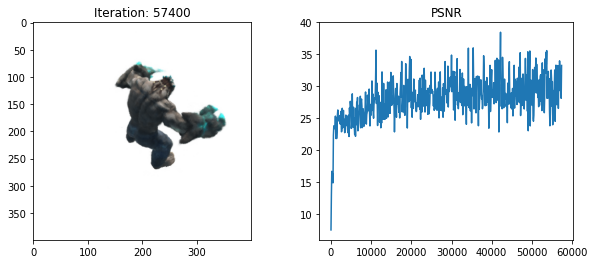

  7%|████▏                                                      | 57500/800001 [2:42:09<17:05:18, 12.07it/s]

[TRAIN] Iter: 57500 Loss_fine: 0.0007643885328434408 PSNR: 31.166858673095703


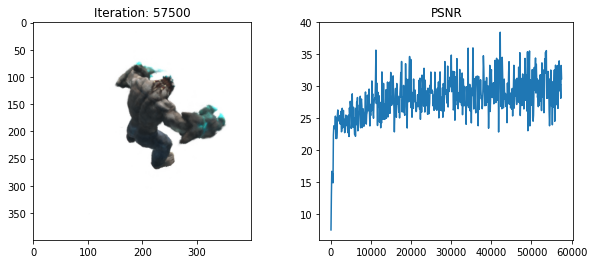

  7%|████▏                                                      | 57600/800001 [2:42:25<17:08:49, 12.03it/s]

[TRAIN] Iter: 57600 Loss_fine: 0.0008257034351117909 PSNR: 30.83176040649414


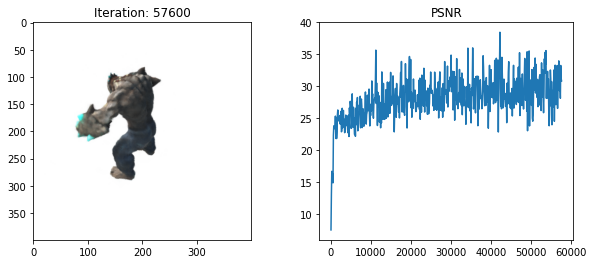

  7%|████▎                                                      | 57700/800001 [2:42:42<17:09:20, 12.02it/s]

[TRAIN] Iter: 57700 Loss_fine: 0.0014956989325582981 PSNR: 28.25156021118164


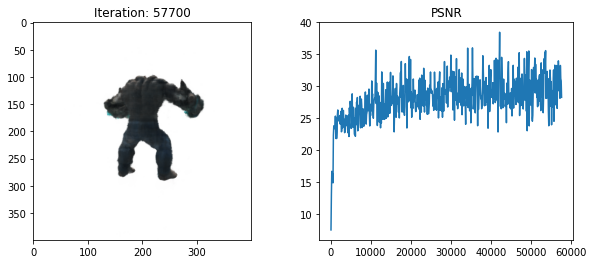

  7%|████▎                                                      | 57800/800001 [2:42:58<17:08:43, 12.02it/s]

[TRAIN] Iter: 57800 Loss_fine: 0.00123222463298589 PSNR: 29.093101501464844


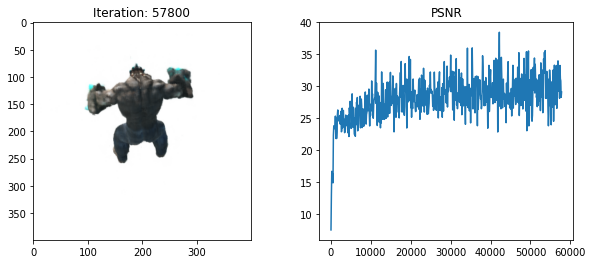

  7%|████▎                                                      | 57900/800001 [2:43:15<17:07:10, 12.04it/s]

[TRAIN] Iter: 57900 Loss_fine: 0.0022965045645833015 PSNR: 26.389326095581055


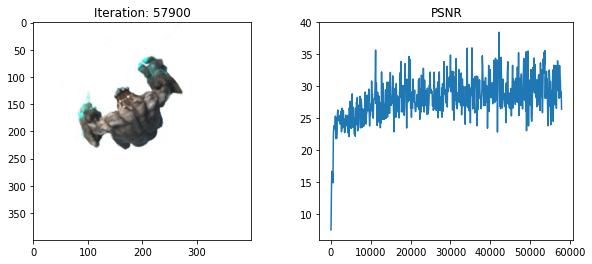

  7%|████▎                                                      | 58000/800001 [2:43:32<17:09:14, 12.02it/s]

[TRAIN] Iter: 58000 Loss_fine: 0.0017389643471688032 PSNR: 27.597091674804688


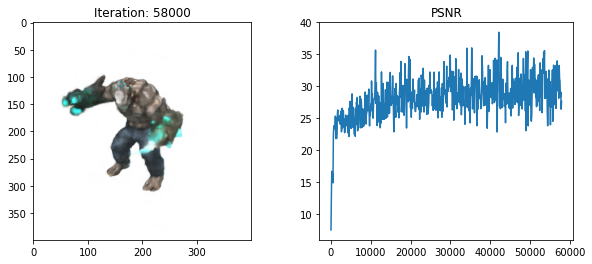

  7%|████▎                                                      | 58100/800001 [2:43:48<17:04:09, 12.07it/s]

[TRAIN] Iter: 58100 Loss_fine: 0.001456987694837153 PSNR: 28.365440368652344


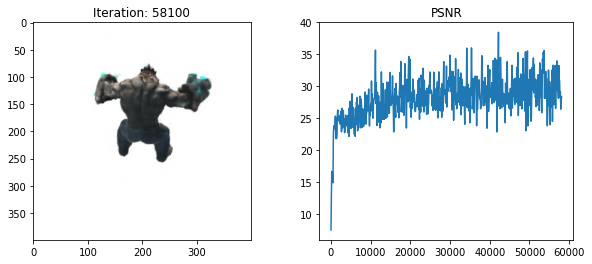

  7%|████▎                                                      | 58200/800001 [2:44:05<17:00:54, 12.11it/s]

[TRAIN] Iter: 58200 Loss_fine: 0.0009766198927536607 PSNR: 30.102745056152344


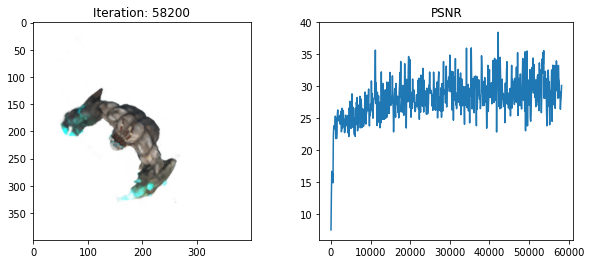

  7%|████▎                                                      | 58300/800001 [2:44:21<17:04:43, 12.06it/s]

[TRAIN] Iter: 58300 Loss_fine: 0.0012007779441773891 PSNR: 29.205371856689453


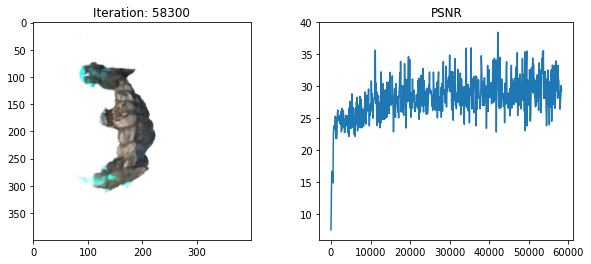

  7%|████▎                                                      | 58400/800001 [2:44:38<17:03:07, 12.08it/s]

[TRAIN] Iter: 58400 Loss_fine: 0.0005661488394252956 PSNR: 32.4706916809082


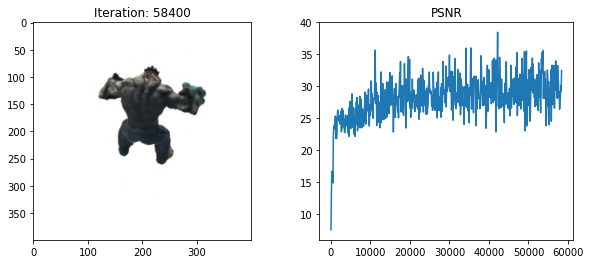

  7%|████▎                                                      | 58500/800001 [2:44:54<17:12:51, 11.97it/s]

[TRAIN] Iter: 58500 Loss_fine: 0.0006036175764165819 PSNR: 32.192378997802734


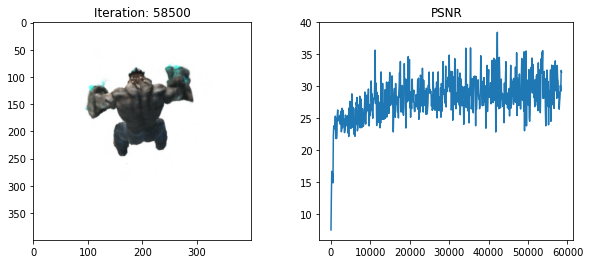

  7%|████▎                                                      | 58600/800001 [2:45:11<17:02:54, 12.08it/s]

[TRAIN] Iter: 58600 Loss_fine: 0.0018707033013924956 PSNR: 27.279949188232422


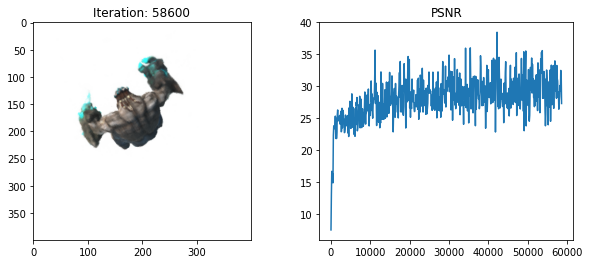

  7%|████▎                                                      | 58700/800001 [2:45:28<17:07:47, 12.02it/s]

[TRAIN] Iter: 58700 Loss_fine: 0.00044140577665530145 PSNR: 33.55162048339844


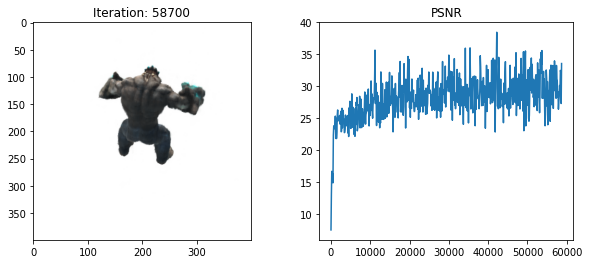

  7%|████▎                                                      | 58800/800001 [2:45:44<17:02:25, 12.08it/s]

[TRAIN] Iter: 58800 Loss_fine: 0.0016019883332774043 PSNR: 27.953405380249023


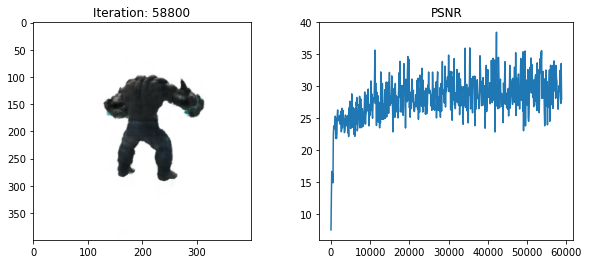

  7%|████▎                                                      | 58900/800001 [2:46:01<17:04:37, 12.05it/s]

[TRAIN] Iter: 58900 Loss_fine: 0.0019323823507875204 PSNR: 27.139066696166992


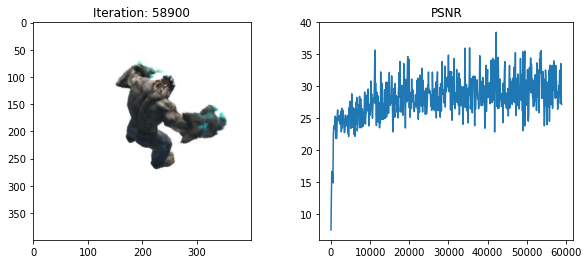

  7%|████▎                                                      | 59000/800001 [2:46:17<17:01:05, 12.09it/s]

[TRAIN] Iter: 59000 Loss_fine: 0.00028855312848463655 PSNR: 35.39773941040039


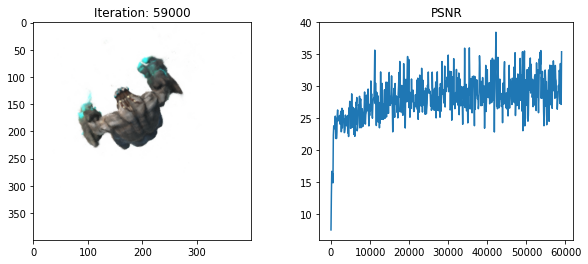

  7%|████▎                                                      | 59100/800001 [2:46:34<17:03:24, 12.07it/s]

[TRAIN] Iter: 59100 Loss_fine: 0.0018412567442283034 PSNR: 27.34885597229004


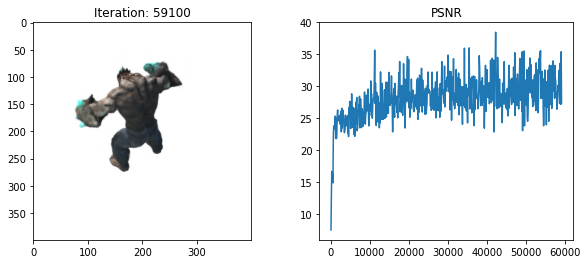

  7%|████▎                                                      | 59200/800001 [2:46:50<17:02:37, 12.07it/s]

[TRAIN] Iter: 59200 Loss_fine: 0.0007375529385171831 PSNR: 31.322067260742188


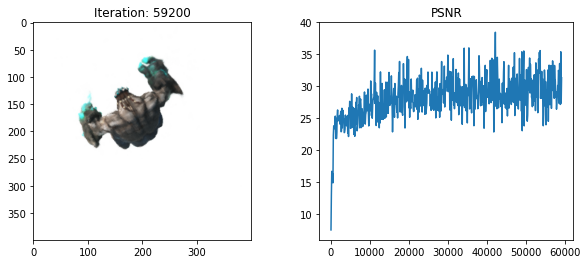

  7%|████▎                                                      | 59300/800001 [2:47:07<17:02:20, 12.08it/s]

[TRAIN] Iter: 59300 Loss_fine: 0.0019052362767979503 PSNR: 27.200511932373047


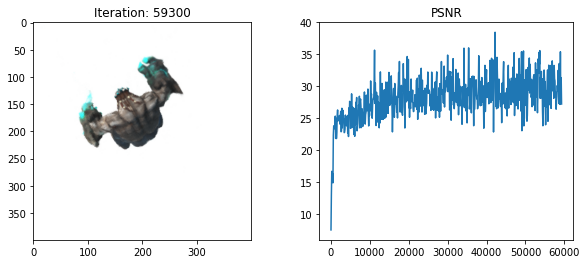

  7%|████▍                                                      | 59400/800001 [2:47:24<17:06:47, 12.02it/s]

[TRAIN] Iter: 59400 Loss_fine: 0.0031689107418060303 PSNR: 24.99090003967285


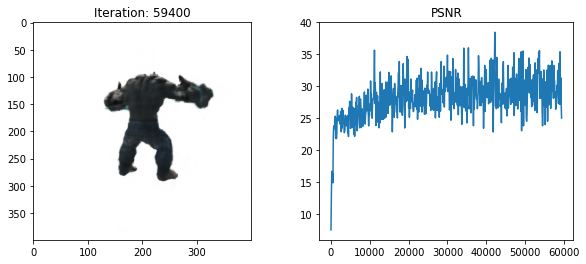

  7%|████▍                                                      | 59500/800001 [2:47:40<17:04:09, 12.05it/s]

[TRAIN] Iter: 59500 Loss_fine: 0.0011445328127592802 PSNR: 29.413719177246094


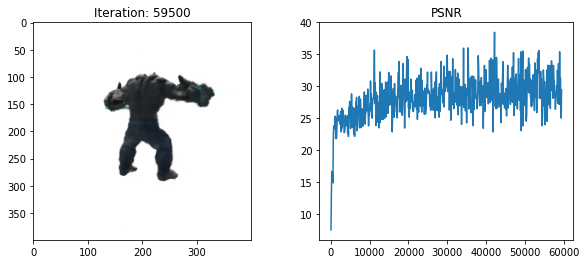

  7%|████▍                                                      | 59600/800001 [2:47:57<17:07:46, 12.01it/s]

[TRAIN] Iter: 59600 Loss_fine: 0.0008919219835661352 PSNR: 30.496732711791992


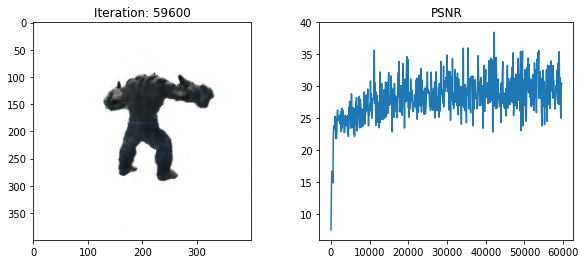

  7%|████▍                                                      | 59700/800001 [2:48:13<17:03:22, 12.06it/s]

[TRAIN] Iter: 59700 Loss_fine: 0.00192629499360919 PSNR: 27.15277099609375


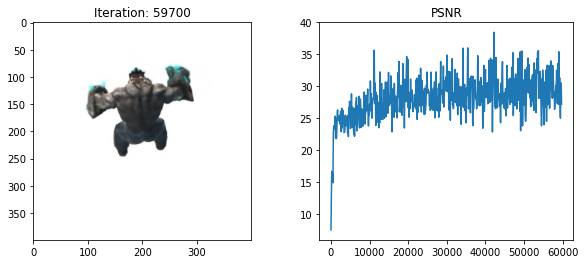

  7%|████▍                                                      | 59800/800001 [2:48:30<17:04:13, 12.04it/s]

[TRAIN] Iter: 59800 Loss_fine: 0.0013590995222330093 PSNR: 28.66748809814453


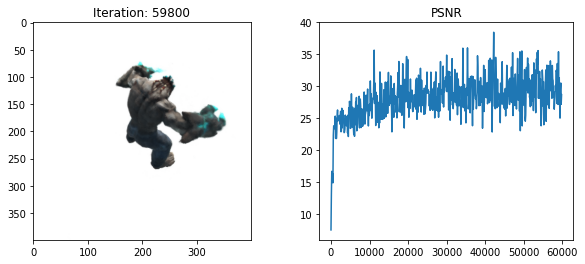

  7%|████▍                                                      | 59900/800001 [2:48:47<17:04:03, 12.05it/s]

[TRAIN] Iter: 59900 Loss_fine: 0.0013817452127113938 PSNR: 28.595720291137695


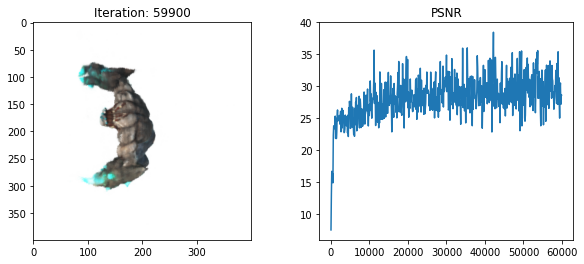

  7%|████▍                                                      | 60000/800001 [2:49:03<17:00:33, 12.08it/s]

[TRAIN] Iter: 60000 Loss_fine: 0.0010704112937673926 PSNR: 29.70449447631836


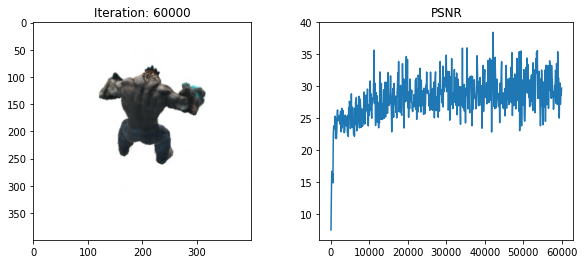

  8%|████▍                                                      | 60100/800001 [2:49:20<17:05:09, 12.03it/s]

[TRAIN] Iter: 60100 Loss_fine: 0.0019394108094274998 PSNR: 27.123300552368164


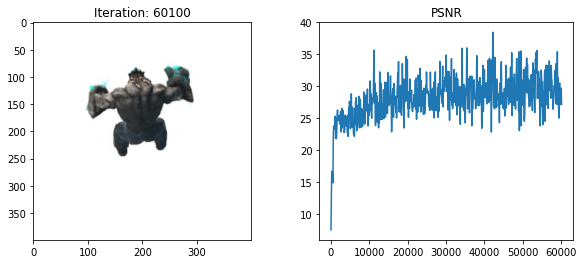

  8%|████▍                                                      | 60200/800001 [2:49:36<17:01:53, 12.07it/s]

[TRAIN] Iter: 60200 Loss_fine: 0.0010626355651766062 PSNR: 29.736156463623047


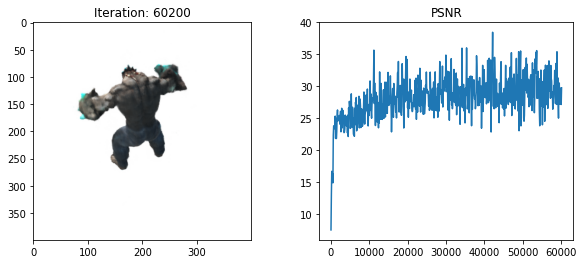

  8%|████▍                                                      | 60300/800001 [2:49:53<17:03:21, 12.05it/s]

[TRAIN] Iter: 60300 Loss_fine: 0.0014013570034876466 PSNR: 28.53451156616211


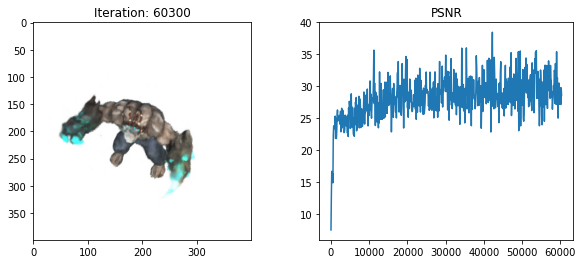

  8%|████▍                                                      | 60400/800001 [2:50:09<17:01:16, 12.07it/s]

[TRAIN] Iter: 60400 Loss_fine: 0.0010443759383633733 PSNR: 29.811429977416992


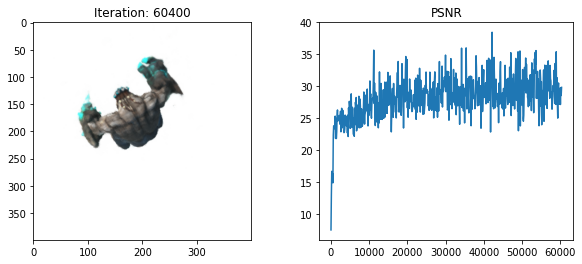

  8%|████▍                                                      | 60500/800001 [2:50:26<17:06:11, 12.01it/s]

[TRAIN] Iter: 60500 Loss_fine: 0.0002870215685106814 PSNR: 35.42085266113281


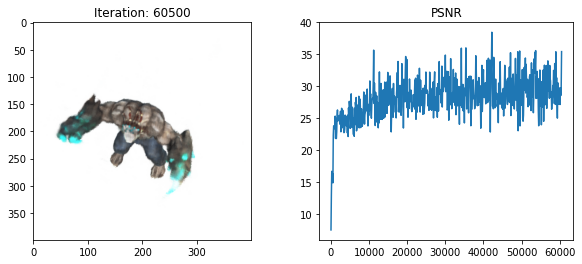

  8%|████▍                                                      | 60600/800001 [2:50:43<17:00:36, 12.07it/s]

[TRAIN] Iter: 60600 Loss_fine: 0.0037068314850330353 PSNR: 24.309972763061523


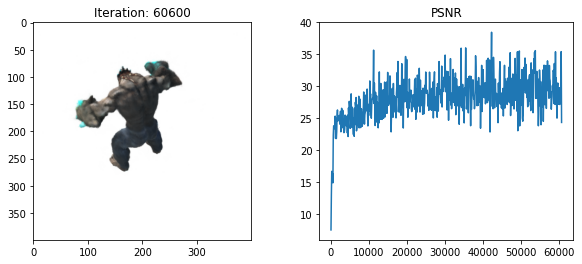

  8%|████▍                                                      | 60700/800001 [2:50:59<17:04:45, 12.02it/s]

[TRAIN] Iter: 60700 Loss_fine: 0.0028686218429356813 PSNR: 25.423267364501953


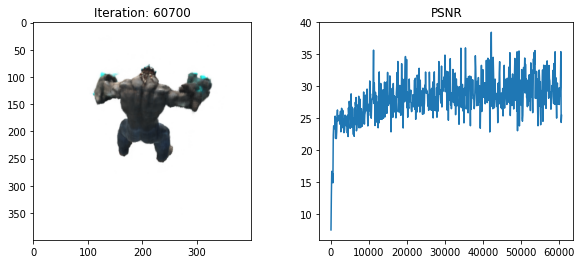

  8%|████▍                                                      | 60800/800001 [2:51:16<17:05:18, 12.02it/s]

[TRAIN] Iter: 60800 Loss_fine: 0.0020399154163897038 PSNR: 26.903879165649414


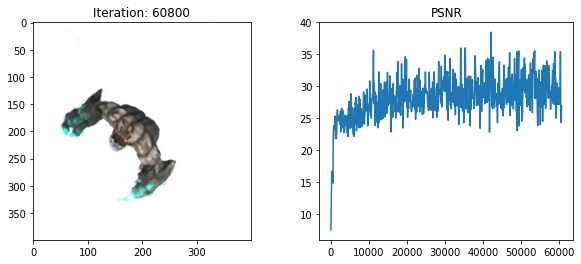

  8%|████▍                                                      | 60900/800001 [2:51:32<17:02:05, 12.05it/s]

[TRAIN] Iter: 60900 Loss_fine: 0.0012174372095614672 PSNR: 29.145532608032227


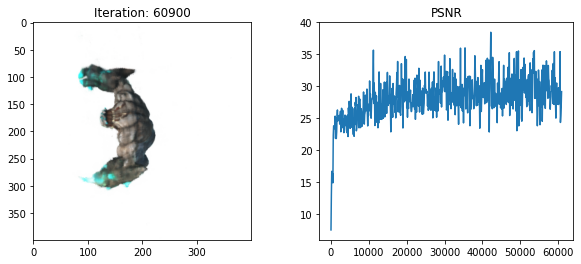

  8%|████▍                                                      | 61000/800001 [2:51:49<17:04:49, 12.02it/s]

[TRAIN] Iter: 61000 Loss_fine: 0.00027323339600116014 PSNR: 35.63466262817383


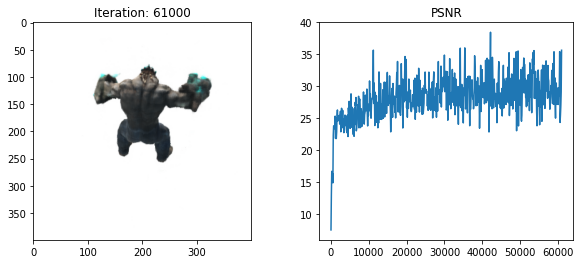

  8%|████▌                                                      | 61100/800001 [2:52:06<17:00:33, 12.07it/s]

[TRAIN] Iter: 61100 Loss_fine: 0.0009525011992082 PSNR: 30.211345672607422


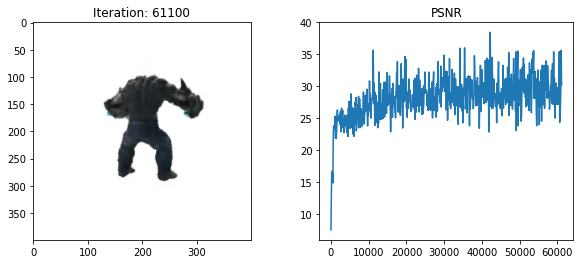

  8%|████▌                                                      | 61200/800001 [2:52:22<17:03:01, 12.04it/s]

[TRAIN] Iter: 61200 Loss_fine: 0.000871345167979598 PSNR: 30.598098754882812


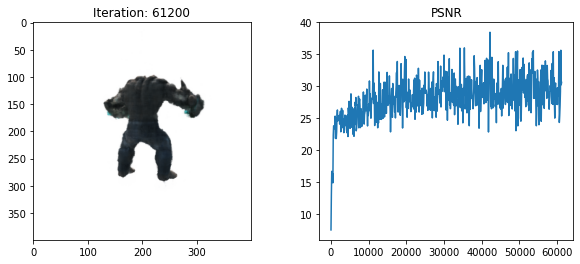

  8%|████▌                                                      | 61300/800001 [2:52:39<17:04:24, 12.02it/s]

[TRAIN] Iter: 61300 Loss_fine: 0.0015774312196299434 PSNR: 28.020496368408203


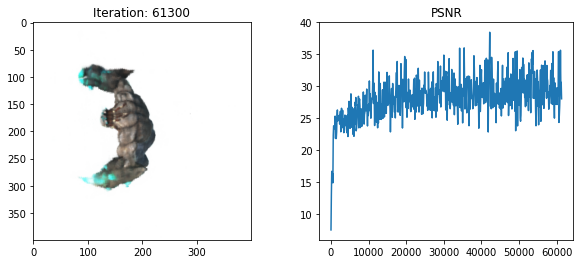

  8%|████▌                                                      | 61400/800001 [2:52:55<17:01:16, 12.05it/s]

[TRAIN] Iter: 61400 Loss_fine: 0.001250112778507173 PSNR: 29.030508041381836


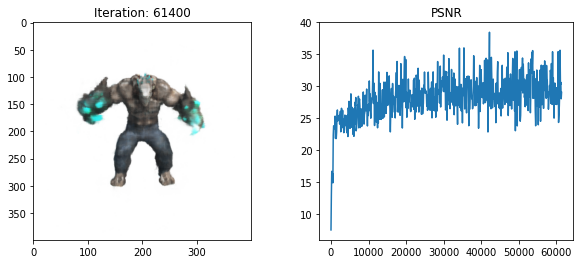

  8%|████▌                                                      | 61500/800001 [2:53:12<17:04:36, 12.01it/s]

[TRAIN] Iter: 61500 Loss_fine: 0.001136838924139738 PSNR: 29.443010330200195


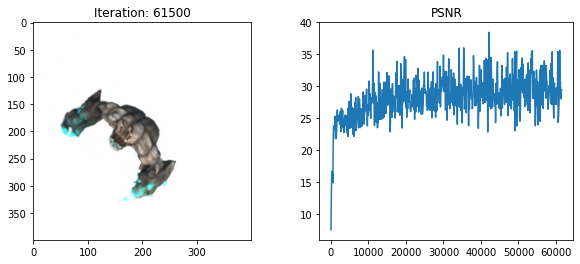

  8%|████▌                                                      | 61600/800001 [2:53:29<17:13:14, 11.91it/s]

[TRAIN] Iter: 61600 Loss_fine: 0.0007172842160798609 PSNR: 31.443086624145508


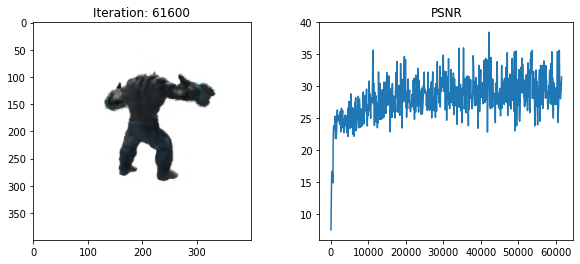

  8%|████▌                                                      | 61700/800001 [2:53:45<16:59:30, 12.07it/s]

[TRAIN] Iter: 61700 Loss_fine: 0.0006747898296453059 PSNR: 31.708314895629883


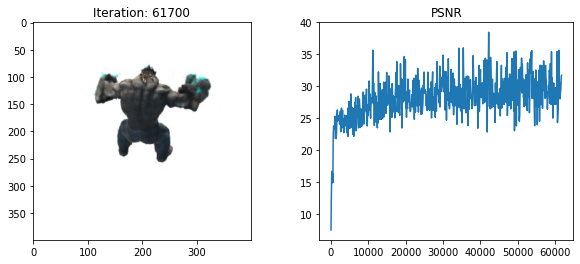

  8%|████▌                                                      | 61800/800001 [2:54:02<17:01:51, 12.04it/s]

[TRAIN] Iter: 61800 Loss_fine: 0.0017404269892722368 PSNR: 27.593441009521484


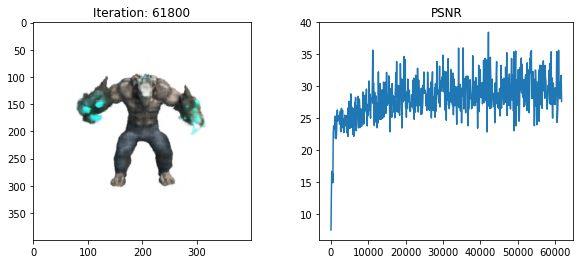

  8%|████▌                                                      | 61900/800001 [2:54:18<17:00:04, 12.06it/s]

[TRAIN] Iter: 61900 Loss_fine: 0.0027110001537948847 PSNR: 25.668704986572266


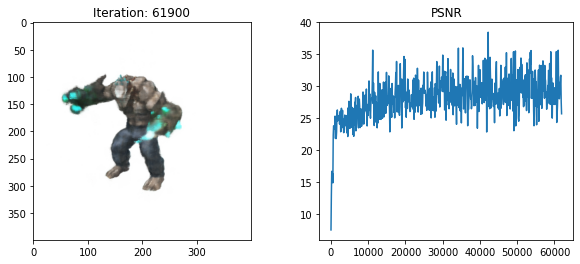

  8%|████▌                                                      | 62000/800001 [2:54:35<17:01:47, 12.04it/s]

[TRAIN] Iter: 62000 Loss_fine: 0.0008799053612165153 PSNR: 30.555641174316406


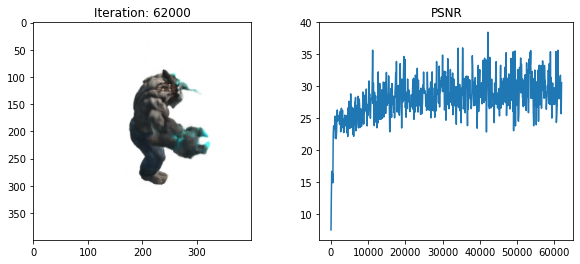

  8%|████▌                                                      | 62100/800001 [2:54:51<17:03:14, 12.02it/s]

[TRAIN] Iter: 62100 Loss_fine: 0.0013561653904616833 PSNR: 28.6768741607666


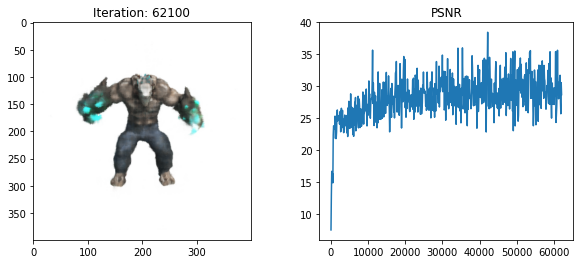

  8%|████▌                                                      | 62200/800001 [2:55:08<16:57:52, 12.08it/s]

[TRAIN] Iter: 62200 Loss_fine: 0.001295100781135261 PSNR: 28.876964569091797


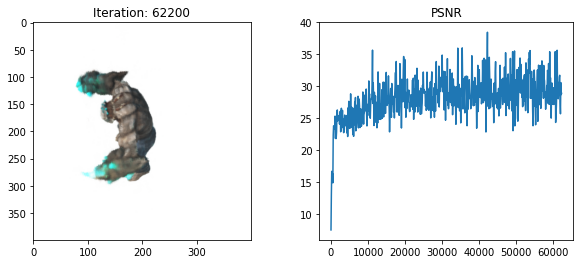

  8%|████▌                                                      | 62300/800001 [2:55:25<17:01:56, 12.03it/s]

[TRAIN] Iter: 62300 Loss_fine: 0.0006341845146380365 PSNR: 31.977842330932617


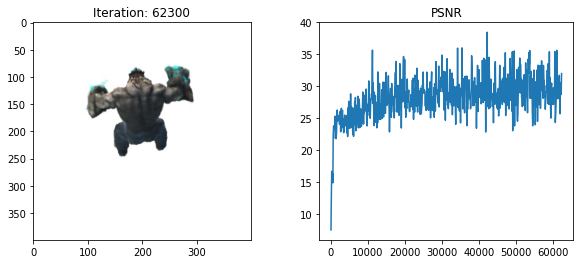

  8%|████▌                                                      | 62400/800001 [2:55:41<17:00:21, 12.05it/s]

[TRAIN] Iter: 62400 Loss_fine: 0.0003649533027783036 PSNR: 34.37762451171875


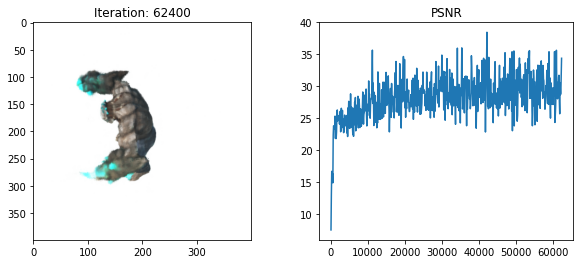

  8%|████▌                                                      | 62500/800001 [2:55:58<16:57:12, 12.08it/s]

[TRAIN] Iter: 62500 Loss_fine: 0.0008571104262955487 PSNR: 30.669631958007812


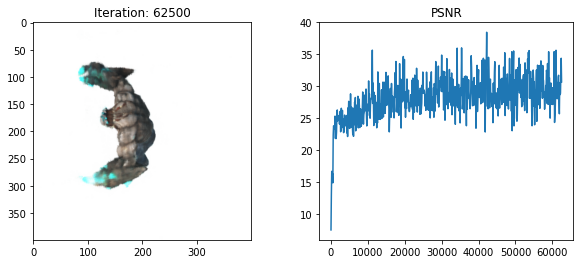

  8%|████▌                                                      | 62600/800001 [2:56:14<17:00:20, 12.04it/s]

[TRAIN] Iter: 62600 Loss_fine: 0.0014693193370476365 PSNR: 28.328838348388672


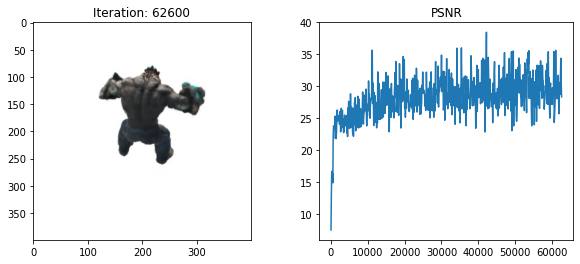

  8%|████▌                                                      | 62700/800001 [2:56:31<16:59:43, 12.05it/s]

[TRAIN] Iter: 62700 Loss_fine: 0.0002557791885919869 PSNR: 35.921348571777344


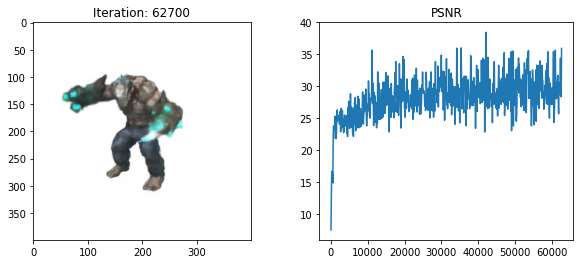

  8%|████▋                                                      | 62800/800001 [2:56:47<16:58:33, 12.06it/s]

[TRAIN] Iter: 62800 Loss_fine: 0.0007772636599838734 PSNR: 31.094314575195312


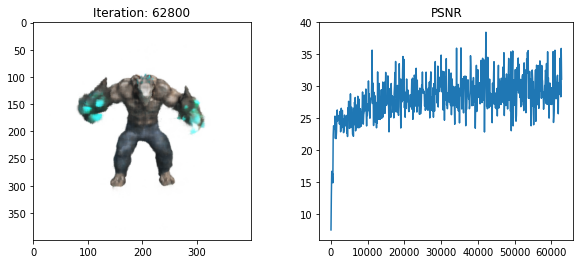

  8%|████▋                                                      | 62900/800001 [2:57:04<17:00:22, 12.04it/s]

[TRAIN] Iter: 62900 Loss_fine: 0.00034988883999176323 PSNR: 34.560699462890625


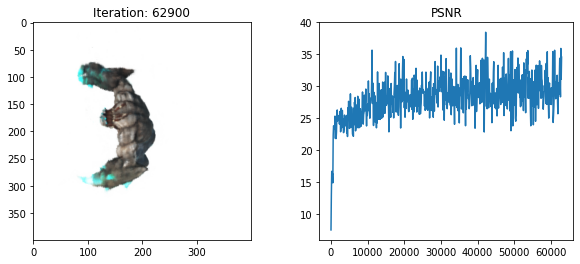

  8%|████▋                                                      | 63000/800001 [2:57:21<16:55:28, 12.10it/s]

[TRAIN] Iter: 63000 Loss_fine: 0.0015973675763234496 PSNR: 27.96595001220703


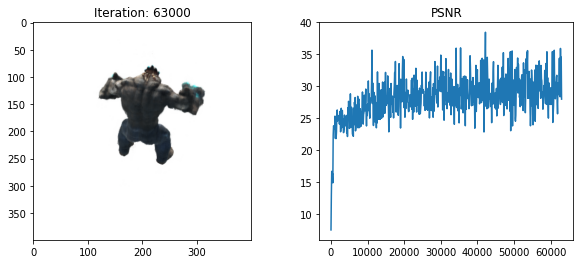

  8%|████▋                                                      | 63100/800001 [2:57:37<16:57:33, 12.07it/s]

[TRAIN] Iter: 63100 Loss_fine: 0.00027265751850791276 PSNR: 35.64382553100586


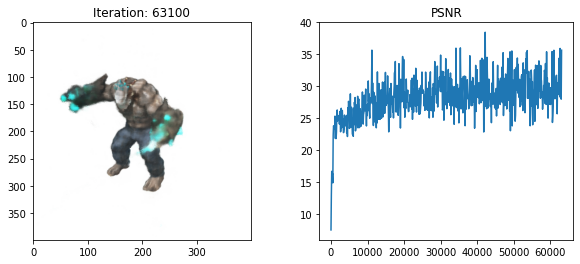

  8%|████▋                                                      | 63200/800001 [2:57:54<16:56:27, 12.08it/s]

[TRAIN] Iter: 63200 Loss_fine: 0.0014639475848525763 PSNR: 28.344741821289062


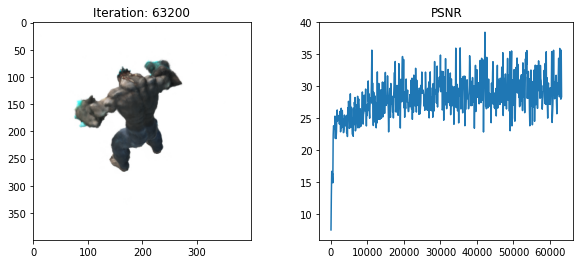

  8%|████▋                                                      | 63300/800001 [2:58:10<16:56:45, 12.08it/s]

[TRAIN] Iter: 63300 Loss_fine: 0.0011139500420540571 PSNR: 29.531341552734375


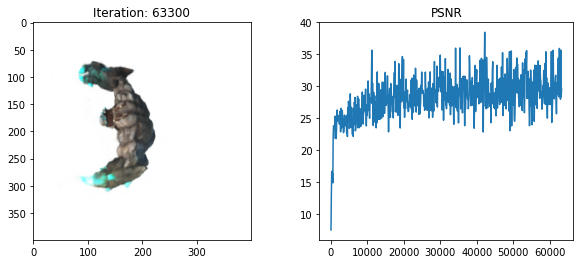

  8%|████▋                                                      | 63400/800001 [2:58:27<17:02:15, 12.01it/s]

[TRAIN] Iter: 63400 Loss_fine: 0.0007251378847286105 PSNR: 31.395793914794922


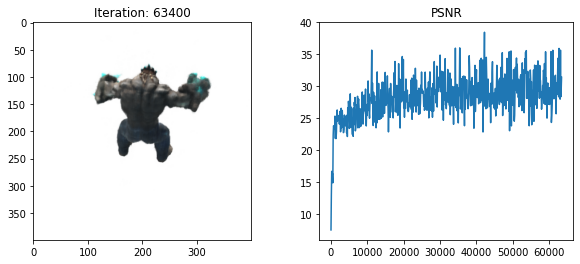

  8%|████▋                                                      | 63500/800001 [2:58:44<16:56:45, 12.07it/s]

[TRAIN] Iter: 63500 Loss_fine: 0.000585929024964571 PSNR: 32.32154846191406


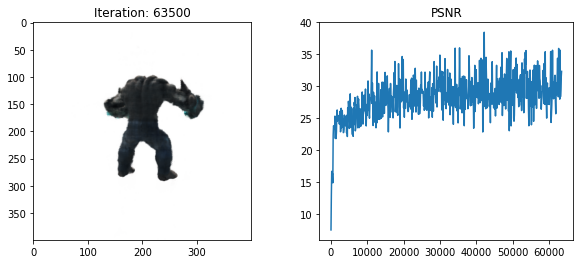

  8%|████▋                                                      | 63600/800001 [2:59:00<16:58:18, 12.05it/s]

[TRAIN] Iter: 63600 Loss_fine: 0.0009749734308570623 PSNR: 30.110071182250977


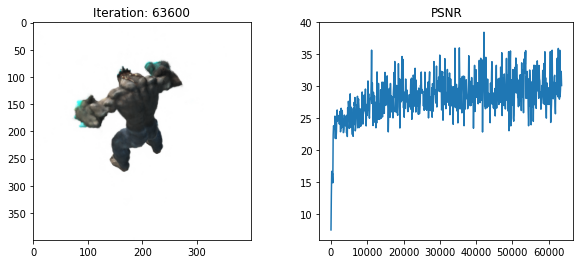

  8%|████▋                                                      | 63700/800001 [2:59:17<17:00:50, 12.02it/s]

[TRAIN] Iter: 63700 Loss_fine: 0.003969863057136536 PSNR: 24.012245178222656


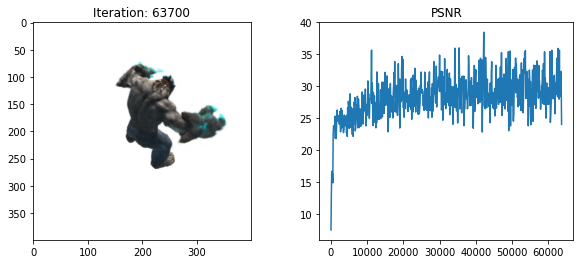

  8%|████▋                                                      | 63800/800001 [2:59:33<16:55:15, 12.09it/s]

[TRAIN] Iter: 63800 Loss_fine: 0.0014800074277445674 PSNR: 28.297361373901367


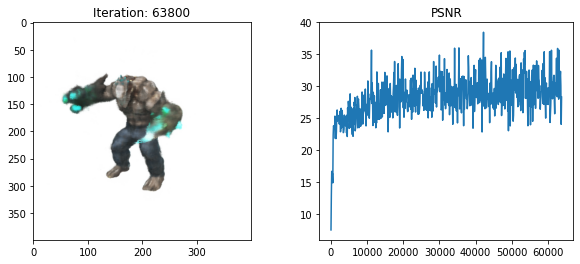

  8%|████▋                                                      | 63900/800001 [2:59:50<16:57:57, 12.05it/s]

[TRAIN] Iter: 63900 Loss_fine: 0.0022380235604941845 PSNR: 26.501352310180664


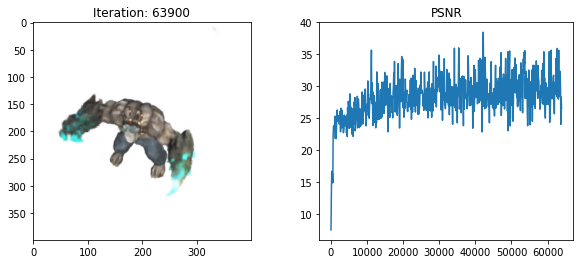

  8%|████▋                                                      | 64000/800001 [3:00:06<16:59:49, 12.03it/s]

[TRAIN] Iter: 64000 Loss_fine: 0.0006195846362970769 PSNR: 32.0789909362793


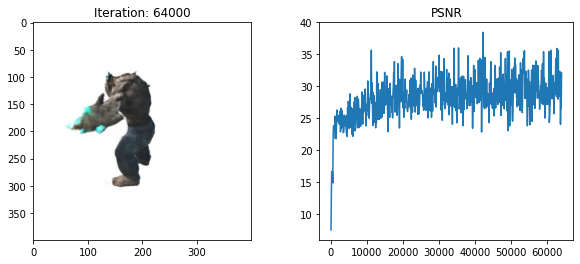

  8%|████▋                                                      | 64100/800001 [3:00:23<16:56:53, 12.06it/s]

[TRAIN] Iter: 64100 Loss_fine: 0.0016479609766975045 PSNR: 27.83053207397461


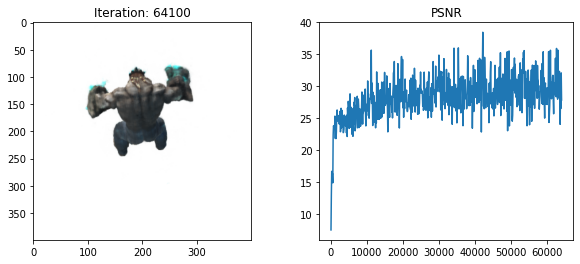

  8%|████▋                                                      | 64200/800001 [3:00:40<16:57:47, 12.05it/s]

[TRAIN] Iter: 64200 Loss_fine: 0.0006750308093614876 PSNR: 31.706764221191406


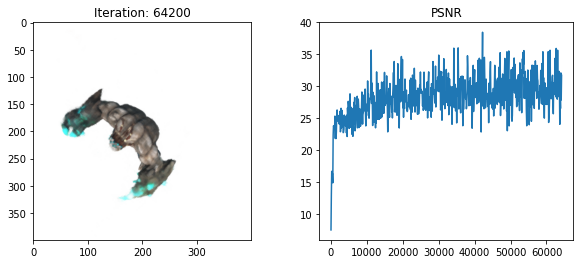

  8%|████▋                                                      | 64300/800001 [3:00:56<16:56:09, 12.07it/s]

[TRAIN] Iter: 64300 Loss_fine: 0.0007720597786828876 PSNR: 31.123491287231445


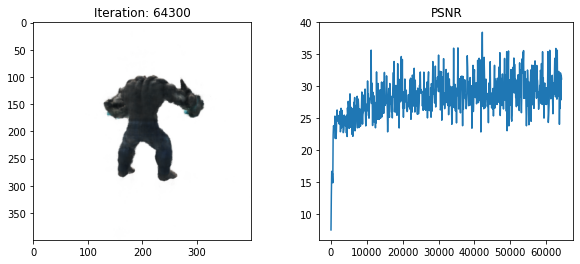

  8%|████▋                                                      | 64400/800001 [3:01:13<16:57:31, 12.05it/s]

[TRAIN] Iter: 64400 Loss_fine: 0.0020262652542442083 PSNR: 26.93303680419922


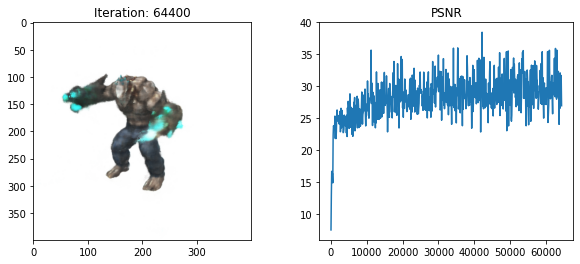

  8%|████▊                                                      | 64500/800001 [3:01:29<17:01:50, 12.00it/s]

[TRAIN] Iter: 64500 Loss_fine: 0.0023949884343892336 PSNR: 26.206966400146484


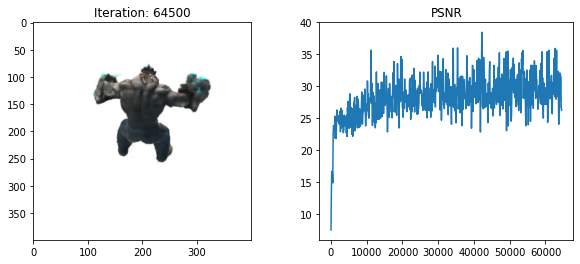

  8%|████▊                                                      | 64600/800001 [3:01:46<16:57:02, 12.05it/s]

[TRAIN] Iter: 64600 Loss_fine: 0.0009477664716541767 PSNR: 30.23298454284668


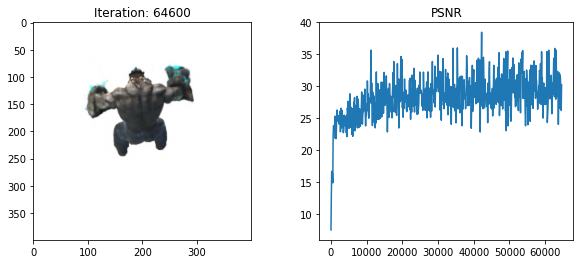

  8%|████▊                                                      | 64700/800001 [3:02:03<16:55:42, 12.07it/s]

[TRAIN] Iter: 64700 Loss_fine: 0.0005138257401995361 PSNR: 32.891841888427734


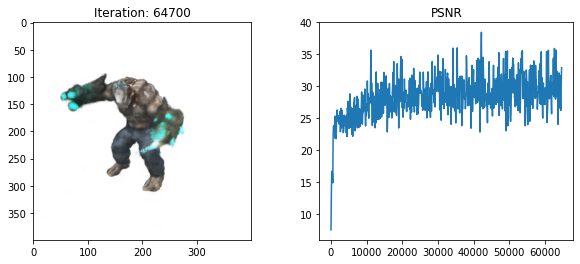

  8%|████▊                                                      | 64800/800001 [3:02:19<16:58:31, 12.03it/s]

[TRAIN] Iter: 64800 Loss_fine: 0.0019752541556954384 PSNR: 27.04376983642578


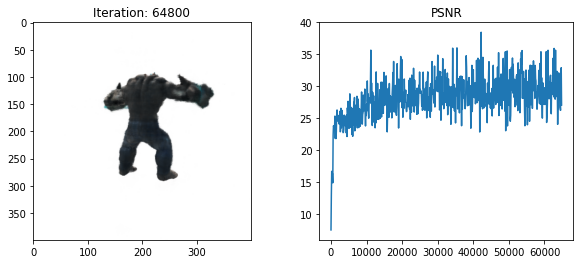

  8%|████▊                                                      | 64900/800001 [3:02:36<16:56:19, 12.05it/s]

[TRAIN] Iter: 64900 Loss_fine: 0.000488352554384619 PSNR: 33.11266326904297


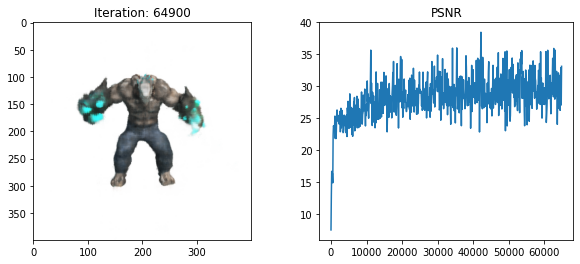

  8%|████▊                                                      | 65000/800001 [3:02:52<16:57:35, 12.04it/s]

[TRAIN] Iter: 65000 Loss_fine: 0.0020678392611443996 PSNR: 26.844831466674805


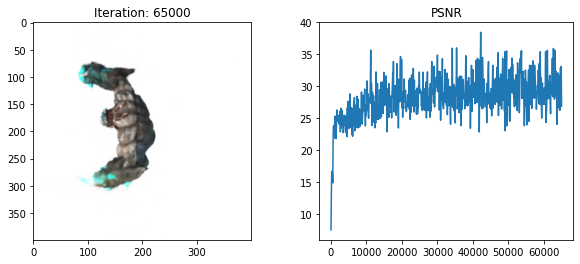

  8%|████▊                                                      | 65100/800001 [3:03:09<16:54:10, 12.08it/s]

[TRAIN] Iter: 65100 Loss_fine: 0.0003929076192434877 PSNR: 34.05709457397461


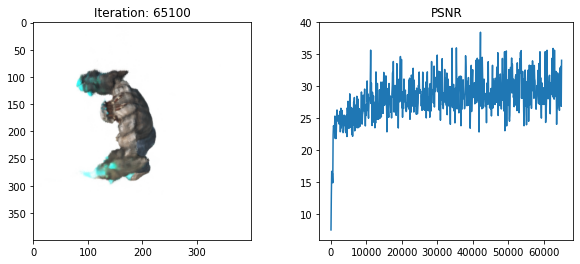

  8%|████▊                                                      | 65200/800001 [3:03:25<16:54:11, 12.08it/s]

[TRAIN] Iter: 65200 Loss_fine: 0.0010834252461791039 PSNR: 29.652009963989258


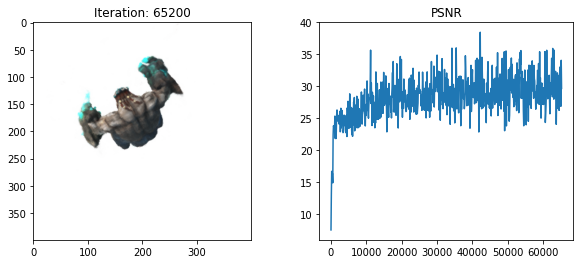

  8%|████▊                                                      | 65300/800001 [3:03:42<16:59:19, 12.01it/s]

[TRAIN] Iter: 65300 Loss_fine: 0.0011493935016915202 PSNR: 29.395313262939453


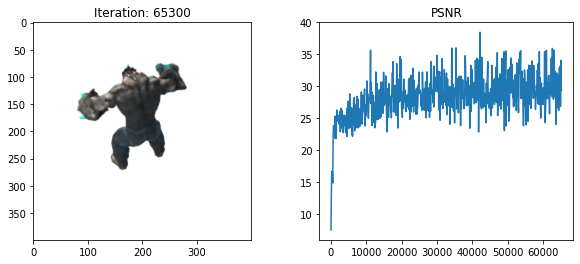

  8%|████▊                                                      | 65400/800001 [3:03:59<16:54:21, 12.07it/s]

[TRAIN] Iter: 65400 Loss_fine: 0.0011497923405840993 PSNR: 29.39380645751953


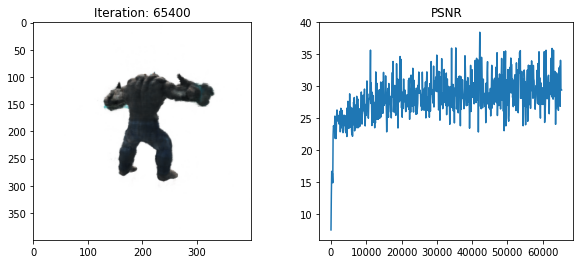

  8%|████▊                                                      | 65500/800001 [3:04:15<16:57:06, 12.04it/s]

[TRAIN] Iter: 65500 Loss_fine: 0.0010217138333246112 PSNR: 29.906707763671875


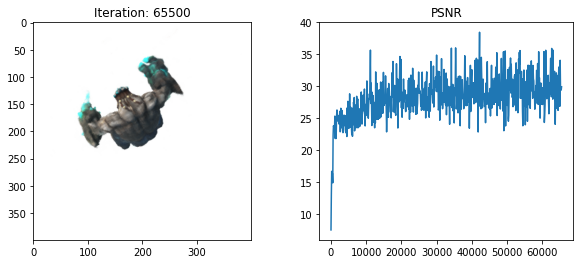

  8%|████▊                                                      | 65600/800001 [3:04:32<16:58:09, 12.02it/s]

[TRAIN] Iter: 65600 Loss_fine: 0.0004089350695721805 PSNR: 33.88345718383789


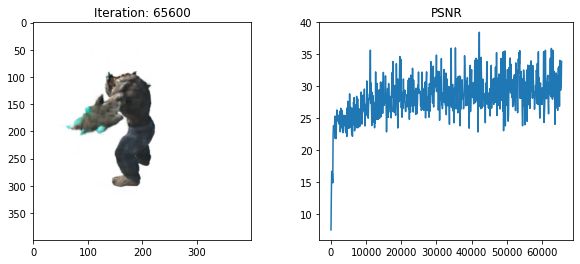

  8%|████▊                                                      | 65700/800001 [3:04:48<17:01:30, 11.98it/s]

[TRAIN] Iter: 65700 Loss_fine: 0.0012337042717263103 PSNR: 29.087888717651367


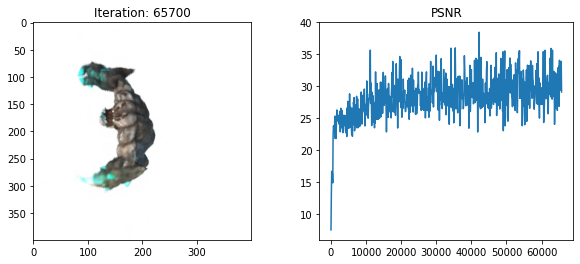

  8%|████▊                                                      | 65800/800001 [3:05:05<16:52:09, 12.09it/s]

[TRAIN] Iter: 65800 Loss_fine: 0.0007067594560794532 PSNR: 31.50728416442871


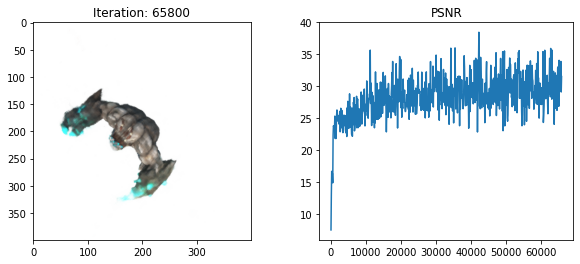

  8%|████▊                                                      | 65900/800001 [3:05:21<16:53:59, 12.07it/s]

[TRAIN] Iter: 65900 Loss_fine: 0.0016262392746284604 PSNR: 27.888154983520508


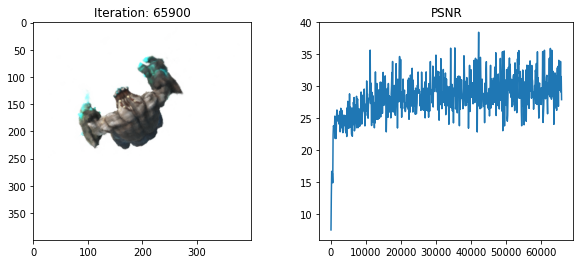

  8%|████▊                                                      | 66000/800001 [3:05:38<16:54:24, 12.06it/s]

[TRAIN] Iter: 66000 Loss_fine: 0.004048142582178116 PSNR: 23.927440643310547


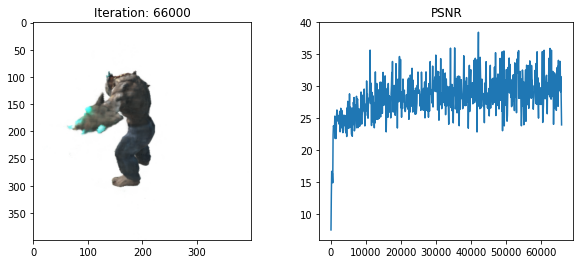

  8%|████▊                                                      | 66100/800001 [3:05:55<16:58:39, 12.01it/s]

[TRAIN] Iter: 66100 Loss_fine: 0.0016579413786530495 PSNR: 27.804309844970703


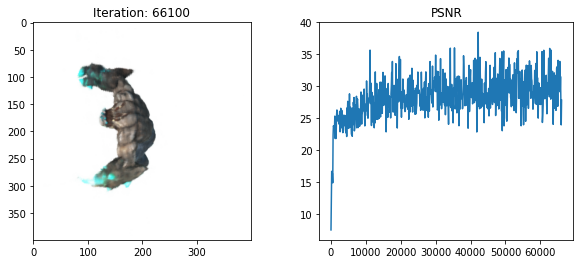

  8%|████▉                                                      | 66200/800001 [3:06:11<16:50:56, 12.10it/s]

[TRAIN] Iter: 66200 Loss_fine: 0.0009528842056170106 PSNR: 30.209598541259766


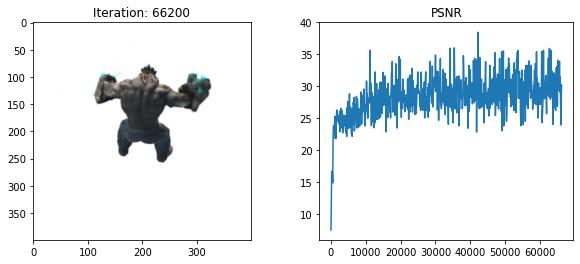

  8%|████▉                                                      | 66300/800001 [3:06:28<16:51:19, 12.09it/s]

[TRAIN] Iter: 66300 Loss_fine: 0.0015145818470045924 PSNR: 28.197071075439453


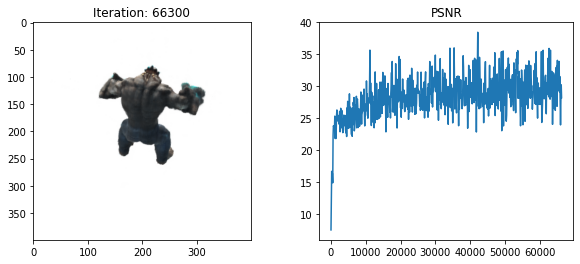

  8%|████▉                                                      | 66400/800001 [3:06:44<16:55:07, 12.04it/s]

[TRAIN] Iter: 66400 Loss_fine: 0.0020224538166075945 PSNR: 26.941211700439453


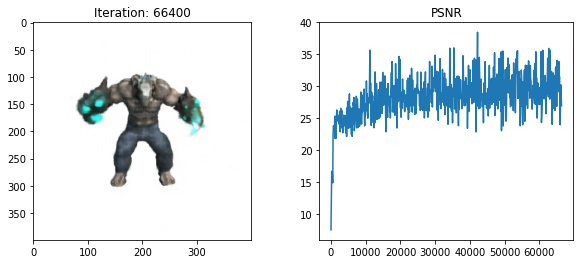

  8%|████▉                                                      | 66500/800001 [3:07:01<16:57:01, 12.02it/s]

[TRAIN] Iter: 66500 Loss_fine: 0.00045670976396650076 PSNR: 33.40359878540039


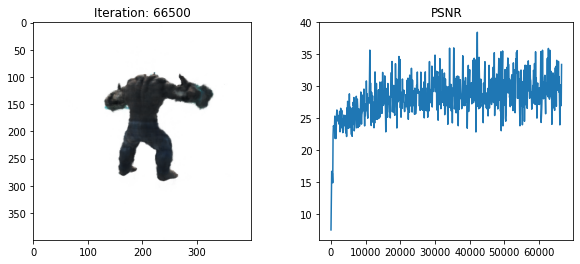

  8%|████▉                                                      | 66600/800001 [3:07:17<16:54:35, 12.05it/s]

[TRAIN] Iter: 66600 Loss_fine: 0.0010983176762238145 PSNR: 29.59272003173828


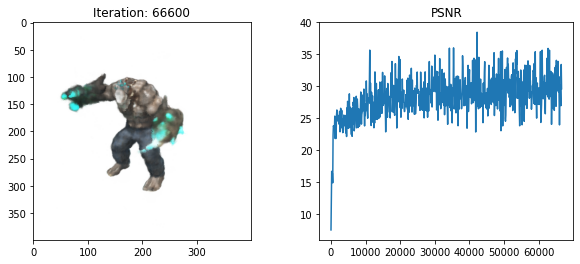

  8%|████▉                                                      | 66700/800001 [3:07:34<16:55:35, 12.03it/s]

[TRAIN] Iter: 66700 Loss_fine: 0.002816441236063838 PSNR: 25.50299072265625


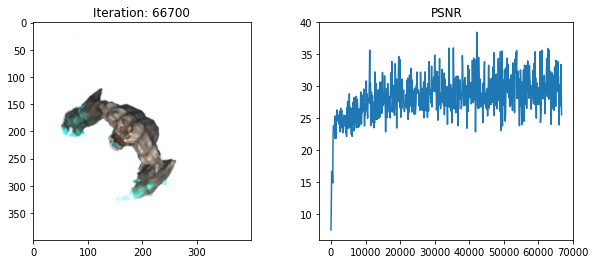

  8%|████▉                                                      | 66800/800001 [3:07:51<16:54:12, 12.05it/s]

[TRAIN] Iter: 66800 Loss_fine: 0.0020474432967603207 PSNR: 26.887882232666016


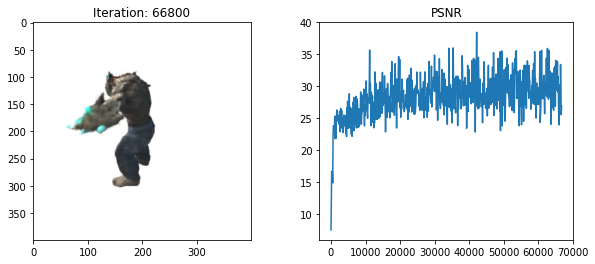

  8%|████▉                                                      | 66900/800001 [3:08:07<16:54:43, 12.04it/s]

[TRAIN] Iter: 66900 Loss_fine: 0.0022001771721988916 PSNR: 26.575422286987305


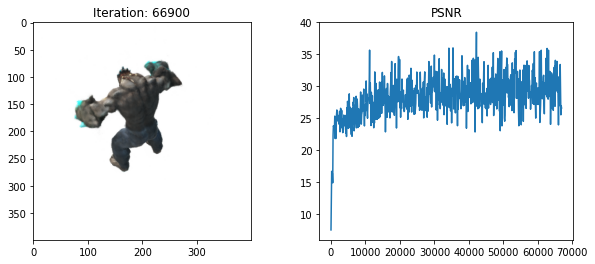

  8%|████▉                                                      | 67000/800001 [3:08:24<16:54:41, 12.04it/s]

[TRAIN] Iter: 67000 Loss_fine: 0.001371412887237966 PSNR: 28.62831687927246


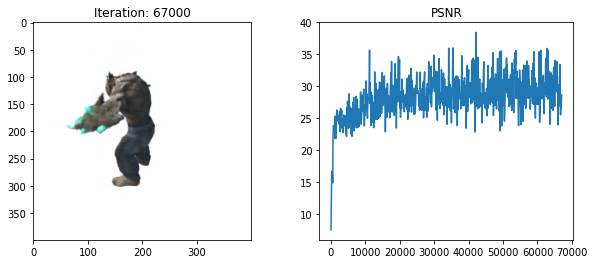

  8%|████▉                                                      | 67100/800001 [3:08:40<16:52:21, 12.07it/s]

[TRAIN] Iter: 67100 Loss_fine: 0.0009394118096679449 PSNR: 30.271440505981445


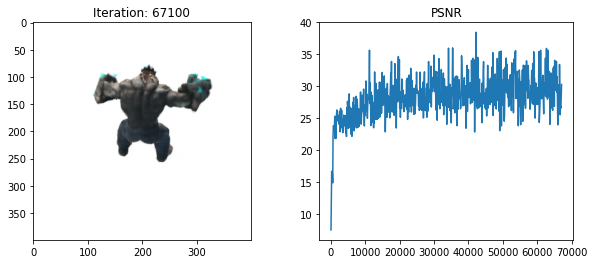

  8%|████▉                                                      | 67200/800001 [3:08:57<16:53:39, 12.05it/s]

[TRAIN] Iter: 67200 Loss_fine: 0.0016088415868580341 PSNR: 27.93486785888672


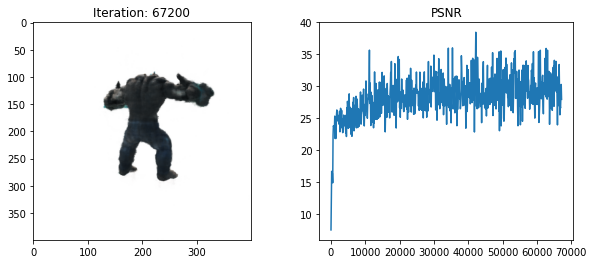

  8%|████▉                                                      | 67300/800001 [3:09:14<16:52:24, 12.06it/s]

[TRAIN] Iter: 67300 Loss_fine: 0.001561204087920487 PSNR: 28.06540298461914


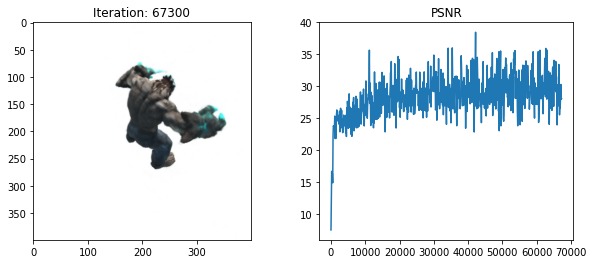

  8%|████▉                                                      | 67400/800001 [3:09:30<16:55:59, 12.02it/s]

[TRAIN] Iter: 67400 Loss_fine: 0.001889636623673141 PSNR: 27.236215591430664


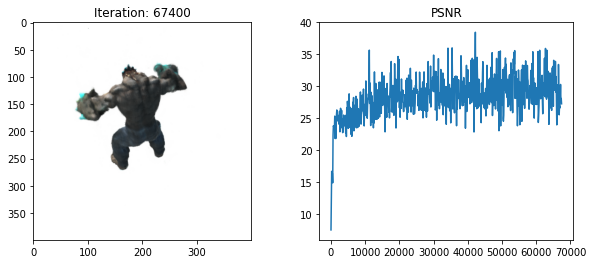

  8%|████▉                                                      | 67500/800001 [3:09:47<16:52:27, 12.06it/s]

[TRAIN] Iter: 67500 Loss_fine: 0.001433089841157198 PSNR: 28.437265396118164


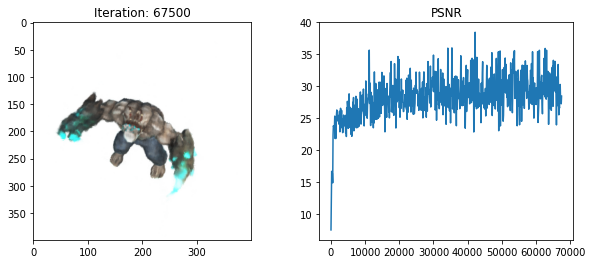

  8%|████▉                                                      | 67600/800001 [3:10:03<16:52:30, 12.06it/s]

[TRAIN] Iter: 67600 Loss_fine: 0.0016413322882726789 PSNR: 27.84803581237793


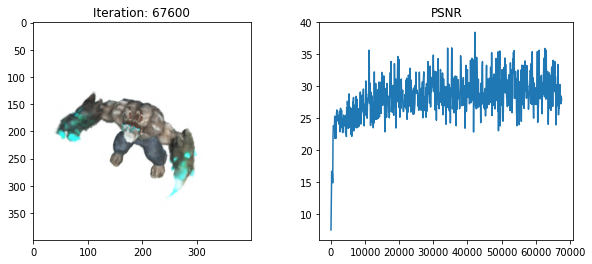

  8%|████▉                                                      | 67700/800001 [3:10:20<16:54:31, 12.03it/s]

[TRAIN] Iter: 67700 Loss_fine: 0.0018758235964924097 PSNR: 27.26807975769043


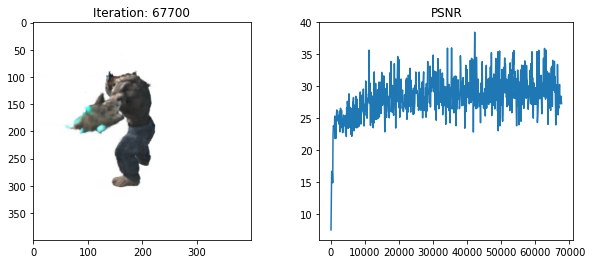

  8%|█████                                                      | 67800/800001 [3:10:36<16:47:28, 12.11it/s]

[TRAIN] Iter: 67800 Loss_fine: 0.0005414158804342151 PSNR: 32.66468811035156


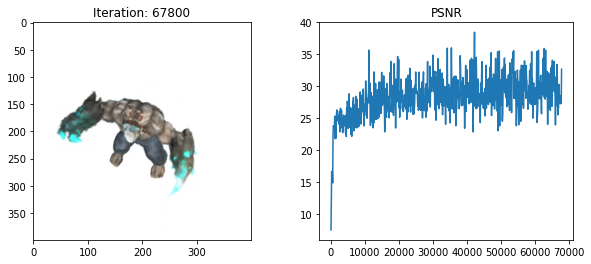

  8%|█████                                                      | 67900/800001 [3:10:53<16:50:36, 12.07it/s]

[TRAIN] Iter: 67900 Loss_fine: 0.00224102265201509 PSNR: 26.49553680419922


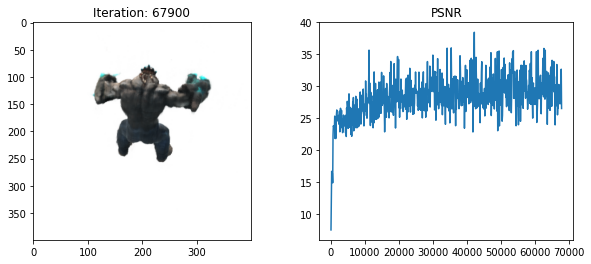

  8%|█████                                                      | 68000/800001 [3:11:10<16:51:05, 12.07it/s]

[TRAIN] Iter: 68000 Loss_fine: 0.0007387542864307761 PSNR: 31.315000534057617


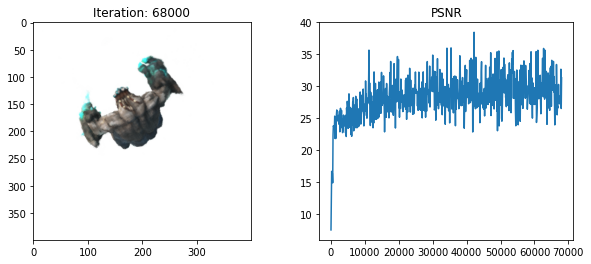

  9%|█████                                                      | 68100/800001 [3:11:26<17:04:50, 11.90it/s]

[TRAIN] Iter: 68100 Loss_fine: 0.002150875749066472 PSNR: 26.673845291137695


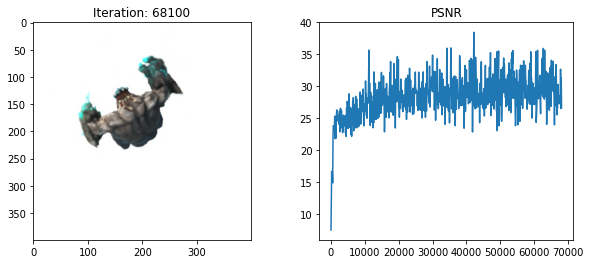

  9%|█████                                                      | 68200/800001 [3:11:43<16:52:14, 12.05it/s]

[TRAIN] Iter: 68200 Loss_fine: 0.0006447664345614612 PSNR: 31.905975341796875


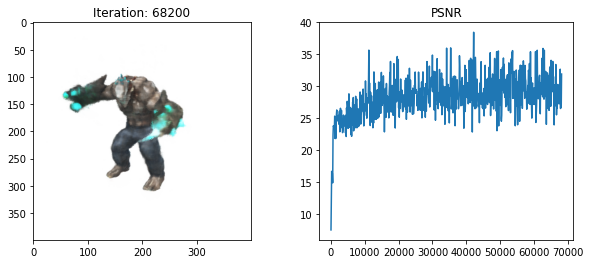

  9%|█████                                                      | 68300/800001 [3:11:59<16:49:42, 12.08it/s]

[TRAIN] Iter: 68300 Loss_fine: 0.000574106874410063 PSNR: 32.410072326660156


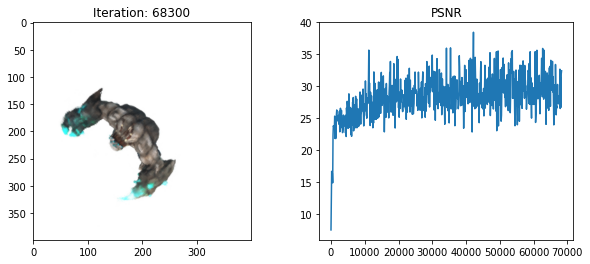

  9%|█████                                                      | 68400/800001 [3:12:16<16:50:57, 12.06it/s]

[TRAIN] Iter: 68400 Loss_fine: 0.0011150784557685256 PSNR: 29.526945114135742


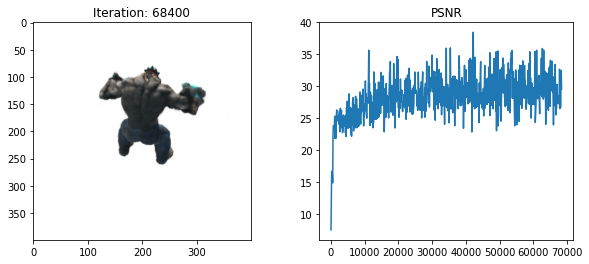

  9%|█████                                                      | 68500/800001 [3:12:33<16:52:46, 12.04it/s]

[TRAIN] Iter: 68500 Loss_fine: 0.0008420648518949747 PSNR: 30.746545791625977


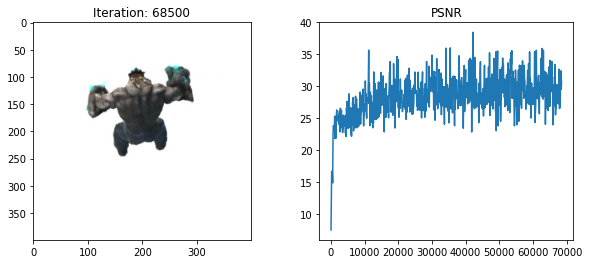

  9%|█████                                                      | 68600/800001 [3:12:49<16:51:42, 12.05it/s]

[TRAIN] Iter: 68600 Loss_fine: 0.0006234071915969253 PSNR: 32.05228042602539


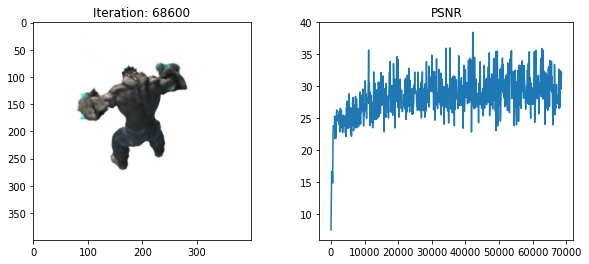

  9%|█████                                                      | 68700/800001 [3:13:06<16:51:06, 12.05it/s]

[TRAIN] Iter: 68700 Loss_fine: 0.0018325939308851957 PSNR: 27.36933708190918


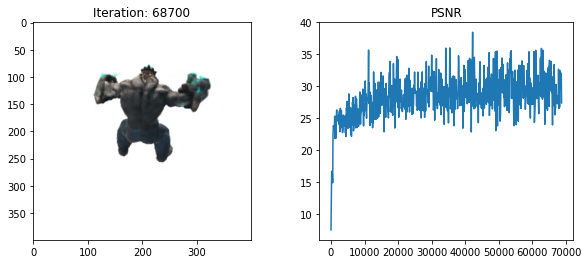

  9%|█████                                                      | 68800/800001 [3:13:22<16:48:59, 12.08it/s]

[TRAIN] Iter: 68800 Loss_fine: 0.0015286413254216313 PSNR: 28.156944274902344


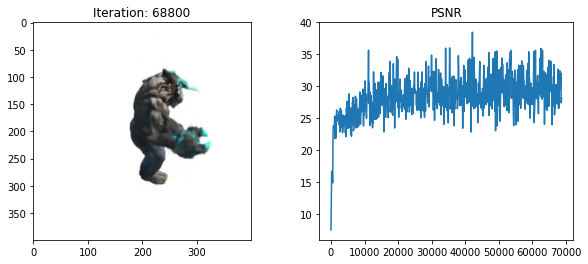

  9%|█████                                                      | 68900/800001 [3:13:39<16:50:07, 12.06it/s]

[TRAIN] Iter: 68900 Loss_fine: 0.0012647880939766765 PSNR: 28.979822158813477


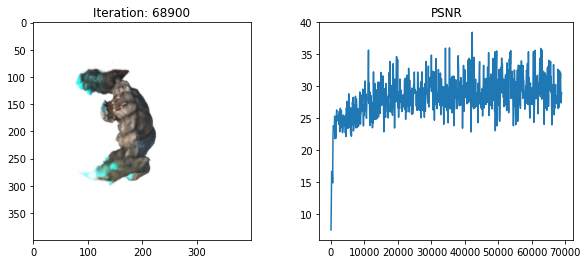

  9%|█████                                                      | 69000/800001 [3:13:55<16:50:02, 12.06it/s]

[TRAIN] Iter: 69000 Loss_fine: 0.000599890248849988 PSNR: 32.21928024291992


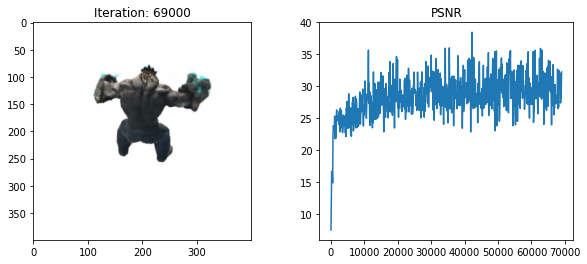

  9%|█████                                                      | 69100/800001 [3:14:12<16:51:19, 12.05it/s]

[TRAIN] Iter: 69100 Loss_fine: 0.00045597198186442256 PSNR: 33.410614013671875


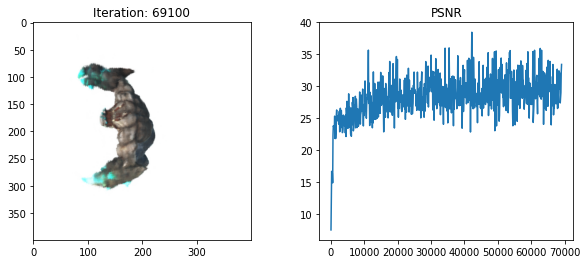

  9%|█████                                                      | 69200/800001 [3:14:29<16:50:24, 12.05it/s]

[TRAIN] Iter: 69200 Loss_fine: 0.0017401723889634013 PSNR: 27.594078063964844


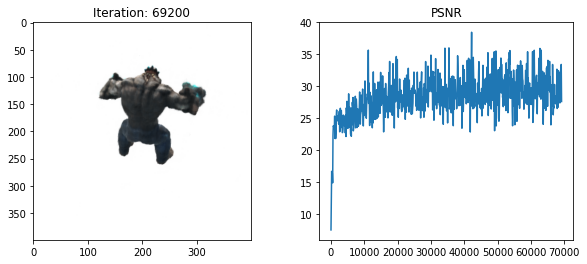

  9%|█████                                                      | 69300/800001 [3:14:45<16:51:03, 12.05it/s]

[TRAIN] Iter: 69300 Loss_fine: 0.0014265744248405099 PSNR: 28.457056045532227


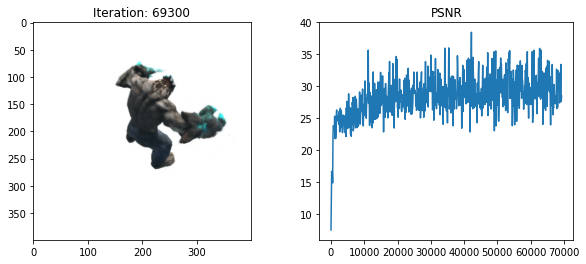

  9%|█████                                                      | 69400/800001 [3:15:02<16:47:05, 12.09it/s]

[TRAIN] Iter: 69400 Loss_fine: 0.0008425519918091595 PSNR: 30.744033813476562


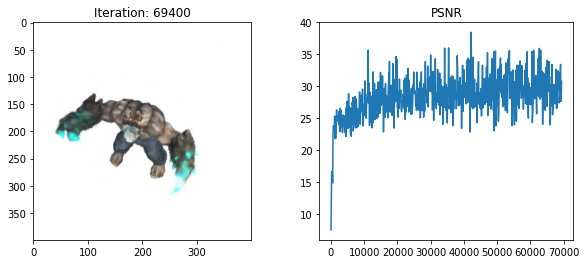

  9%|█████▏                                                     | 69500/800001 [3:15:18<16:48:14, 12.08it/s]

[TRAIN] Iter: 69500 Loss_fine: 0.0006154605653136969 PSNR: 32.10799789428711


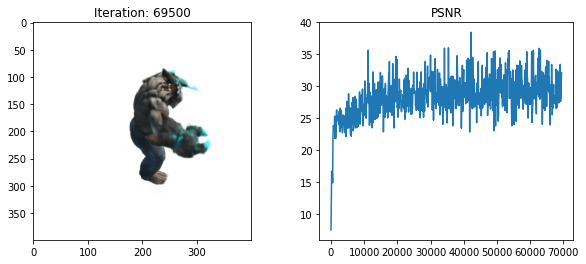

  9%|█████▏                                                     | 69600/800001 [3:15:35<16:49:51, 12.05it/s]

[TRAIN] Iter: 69600 Loss_fine: 0.0010065766982734203 PSNR: 29.97153091430664


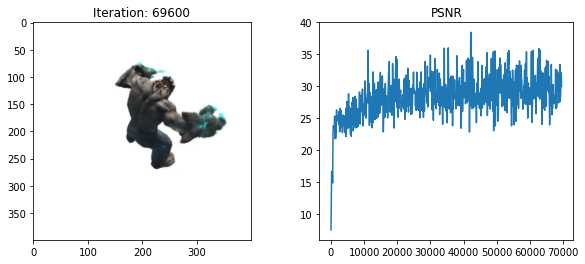

  9%|█████▏                                                     | 69700/800001 [3:15:52<16:51:20, 12.04it/s]

[TRAIN] Iter: 69700 Loss_fine: 0.001405096729286015 PSNR: 28.522937774658203


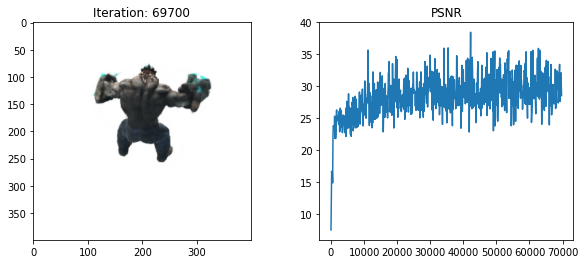

  9%|█████▏                                                     | 69800/800001 [3:16:08<16:49:11, 12.06it/s]

[TRAIN] Iter: 69800 Loss_fine: 0.0008644944173283875 PSNR: 30.63237953186035


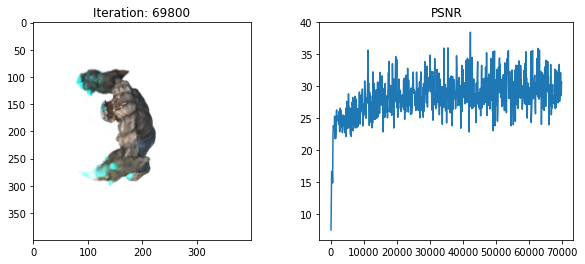

  9%|█████▏                                                     | 69900/800001 [3:16:25<16:48:43, 12.06it/s]

[TRAIN] Iter: 69900 Loss_fine: 0.0030412073247134686 PSNR: 25.169540405273438


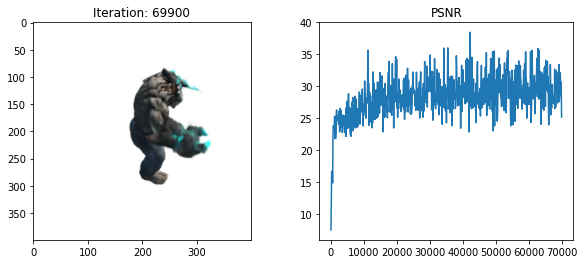

  9%|█████▏                                                     | 70000/800001 [3:16:41<16:48:24, 12.07it/s]

[TRAIN] Iter: 70000 Loss_fine: 0.0009818535763770342 PSNR: 30.079530715942383


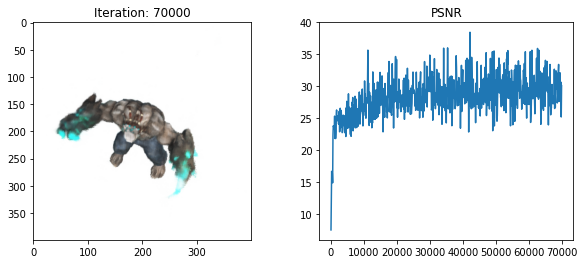

  9%|█████▏                                                     | 70100/800001 [3:16:58<16:49:00, 12.06it/s]

[TRAIN] Iter: 70100 Loss_fine: 0.0006921837921254337 PSNR: 31.59778594970703


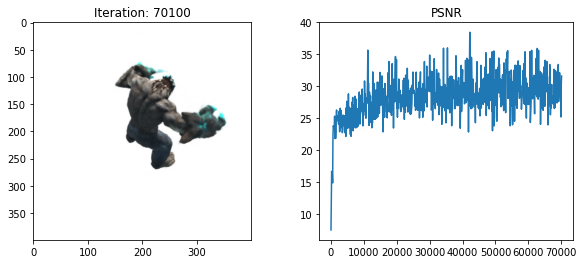

  9%|█████▏                                                     | 70200/800001 [3:17:14<16:05:42, 12.60it/s]

[TRAIN] Iter: 70200 Loss_fine: 0.0007452396675944328 PSNR: 31.27703857421875


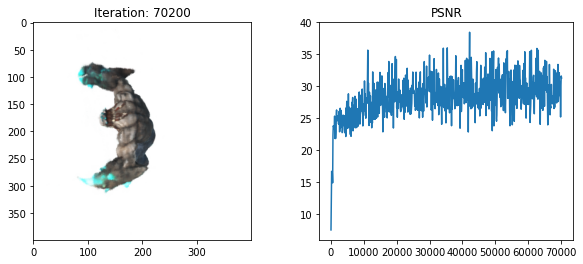

  9%|█████▏                                                     | 70300/800001 [3:17:29<16:05:17, 12.60it/s]

[TRAIN] Iter: 70300 Loss_fine: 0.0008389421855099499 PSNR: 30.762678146362305


  9%|█████                                                     | 70300/800001 [9:46:04<101:23:21,  2.00it/s]


RuntimeError: CUDA error: unspecified launch failure
CUDA kernel errors might be asynchronously reported at some other API call,so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.

In [17]:
args.no_reload=True
train(args)

NeRF type selected: direct_temporal
Found ckpts ['./logs/mutant/000000.tar', './logs/mutant/800000.tar']
Reloading from ./logs/mutant/800000.tar
Loaded from ./logs/mutant/800000.tar


100%|█████████████████████████████████████████████████████████████████████████| 1/1 [00:08<00:00,  8.23s/it]

(400, 400, 3)
(400, 400)
(400, 400)


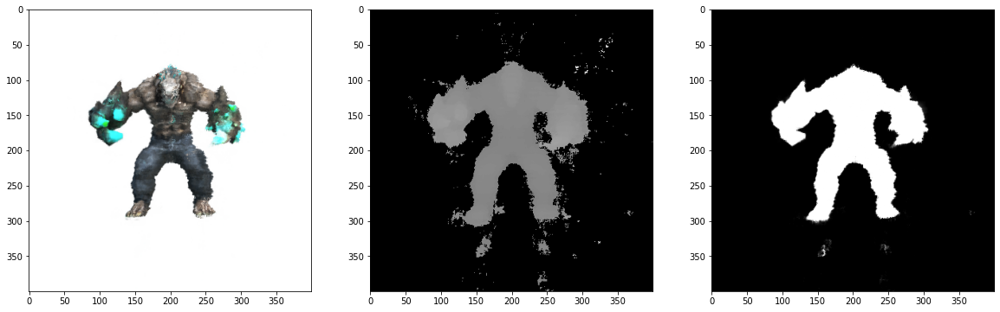

In [44]:
hwf = [400, 400, 555.555]
args.no_reload = False
_, render_kwargs_test, _, _, _ = create_nerf(args)
render_kwargs_test.update({'near' : 2., 'far' : 6.})

def generate_img(time, azimuth, elevation):
    assert 0. <= time <= 1.
    assert -180 <= azimuth <= 180
    assert -180 <= elevation <= 180
    
    render_poses = torch.unsqueeze(pose_spherical(azimuth, elevation, 4.0), 0).to(device)
    render_times = torch.Tensor([time]).to(device)

    with torch.no_grad():
            rgbs, disps, accs = render_path(render_poses, render_times, hwf, args.chunk, render_kwargs_test, render_factor=args.render_factor)
    rgbs = to8b(rgbs)
    disps = to8b(disps)
    accs = to8b(accs) 
    return rgbs[0], disps[0], accs[0]


_time = 0.0  # in [0,1]
azimuth = 180  # in [-180,180]
elevation = 0  # in [-180,180]
img, disp, acc = generate_img(_time, azimuth, elevation)

print(img.shape)
print(disp.shape)
print(acc.shape)
# display
plt.figure(2, figsize=(20,6))
plt.subplot(1,3,1)
plt.imshow(img)
plt.subplot(1,3,2)
plt.imshow(disp,cmap='gray')
plt.subplot(1,3,3)
plt.imshow(acc,cmap='gray')


plt.show()

100%|█████████████████████████████████████████████████████████████████████████| 1/1 [00:08<00:00,  8.15s/it]


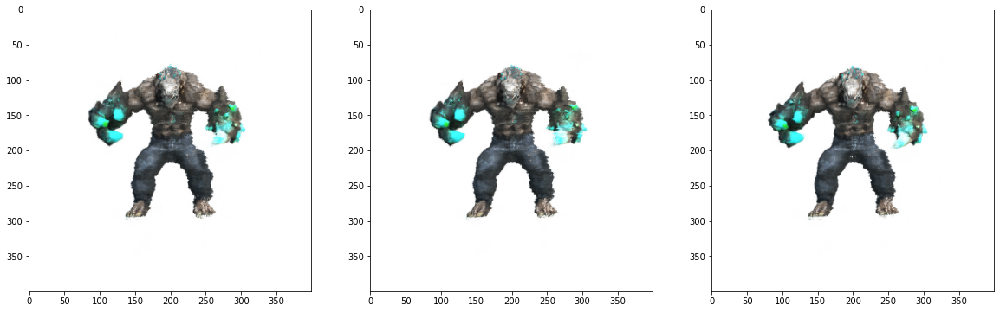

In [42]:
_times = [0., 0.5, 1.]
azimuth = 180  # in [-180,180]
elevation = 0  # in [-180,180]

plt.figure(3, figsize=(20, 6))
for i in range(3):
    img, disp, acc = generate_img(_times[i], azimuth, elevation)
    plt.subplot(1, 3, i+1)
    plt.imshow(img)

## Generate Mesh with Marching Cube Algorithm

https://en.wikipedia.org/wiki/Marching_cubes \

\
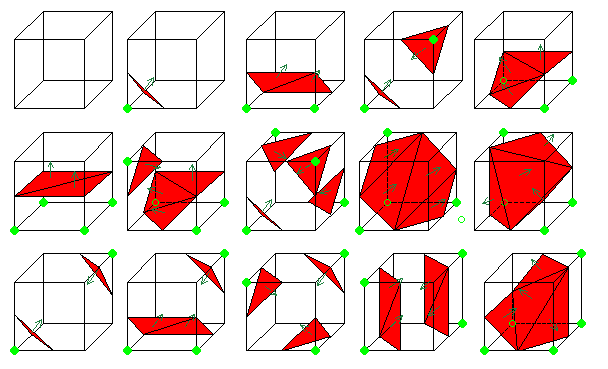

100%|█████████████████████████████████████████████████████████████████████████| 1/1 [00:08<00:00,  8.53s/it]


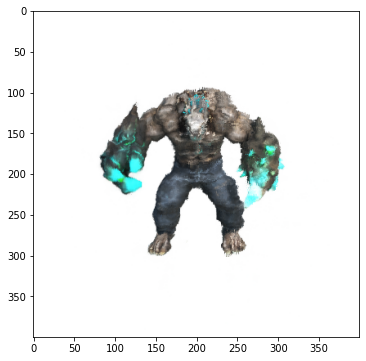

In [39]:
def generate_img(time):
    render_poses = torch.unsqueeze(pose_spherical(180, -20, 4.0), 0).to(device)
    render_times = torch.Tensor([time]).to(device)

    with torch.no_grad():
            rgbs, _, _ = render_path(render_poses, render_times, hwf, args.chunk, render_kwargs_test, render_factor=args.render_factor)
    rgbs = to8b(rgbs)
    return rgbs[0]

_time = 0.  # time in [0,1]
img = generate_img(_time)

# display
plt.figure(2, figsize=(20,6))
plt.imshow(img)
plt.show()

N = 256
min_rec, max_rec = -1.2, 1.2
t = np.linspace(min_rec, max_rec, N+1)

query_pts = np.stack(np.meshgrid(t, t, t), -1).astype(np.float32)
sh = query_pts.shape
pts = torch.Tensor(query_pts.reshape([-1,3]))

'''
def batchify_test(fn, chunk):
    if chunk is None:
        return fn
    def ret(inputs):
        return torch.concat([fn(inputs[i:i+chunk]) for i in range(0, inputs.shape[0], chunk)], 0)
    return ret
'''

def reconstruct(points, time):
    net_fn = render_kwargs_test['network_query_fn']
    fn = lambda i0, i1 : net_fn(points[i0:i1,None,:], viewdirs=torch.zeros_like(points[i0:i1]), ts=torch.ones_like(points[i0:i1])[:,0:1]*time, network_fn=render_kwargs_test['network_fn'])
    chunk = 1024*64
    raw = np.concatenate([fn(i, i+chunk)[0].cpu().numpy() for i in range(0, points.shape[0], chunk)], 0)
    raw = np.reshape(raw, list(sh[:-1]) + [-1])
    sigma = np.maximum(raw[...,-1], 0.)
    return sigma
    
with torch.no_grad():
    sigma = reconstruct(pts, _time)

In [ ]:
print(sigma.shape)
print(query_pts.shape)

In [ ]:
# reconstruct
threshold = 40  # this is just a randomly found threshold
vertices, triangles = mcubes.marching_cubes(sigma, threshold)

# display
mesh = trimesh.Trimesh(vertices / N * (max_rec - min_rec) + min_rec , triangles)
mesh = trimesh.smoothing.filter_laplacian(mesh, iterations=3)
mesh.show()

## Visualize Video Output

In [ ]:
args.no_reload = False
args.render_only = True
args.render_test = False
train(args)

In [ ]:
from IPython.display import HTML
from base64 import b64encode
testsavedir = os.path.join(args.basedir, args.expname, 'renderonly_{}_{:06d}'.format('test' if args.render_test else 'path', 800000))

mp4 = open(os.path.join(testsavedir, 'video.mp4'),'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## Calculate Test Metrics
- MSE
- PSNR
- SSIM
- lpips

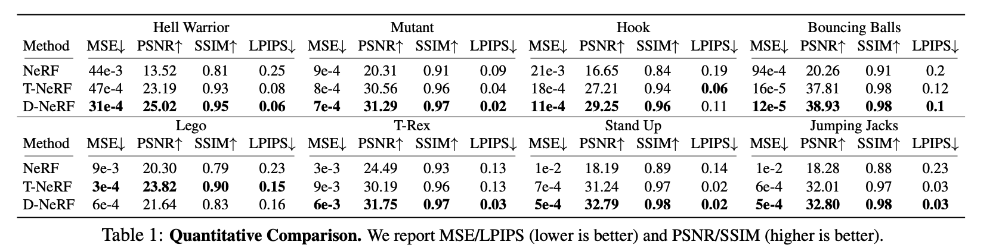

In [ ]:
# Mean Square Error
class MSE(object):
    def __call__(self, pred, gt):
        return torch.mean((pred - gt) ** 2)

# Peak Signal to Noise Ratio
class PSNR(object):
    def __call__(self, pred, gt):
        mse = torch.mean((pred - gt) ** 2)
        return 10 * torch.log10(1 / mse)

# structural similarity index
class SSIM(object):
    '''
    borrowed from https://github.com/huster-wgm/Pytorch-metrics/blob/master/metrics.py
    '''
    def gaussian(self, w_size, sigma):
        gauss = torch.Tensor([math.exp(-(x - w_size//2)**2/float(2*sigma**2)) for x in range(w_size)])
        return gauss/gauss.sum()

    def create_window(self, w_size, channel=1):
        _1D_window = self.gaussian(w_size, 1.5).unsqueeze(1)
        _2D_window = _1D_window.mm(_1D_window.t()).float().unsqueeze(0).unsqueeze(0)
        window = _2D_window.expand(channel, 1, w_size, w_size).contiguous()
        return window

    def __call__(self, y_pred, y_true, w_size=11, size_average=True, full=False):
        """
        args:
            y_true : 4-d ndarray in [batch_size, channels, img_rows, img_cols]
            y_pred : 4-d ndarray in [batch_size, channels, img_rows, img_cols]
            w_size : int, default 11
            size_average : boolean, default True
            full : boolean, default False
        return ssim, larger the better
        """
        # Value range can be different from 255. Other common ranges are 1 (sigmoid) and 2 (tanh).
        if torch.max(y_pred) > 128:
            max_val = 255
        else:
            max_val = 1

        if torch.min(y_pred) < -0.5:
            min_val = -1
        else:
            min_val = 0
        L = max_val - min_val

        padd = 0
        (_, channel, height, width) = y_pred.size()
        window = self.create_window(w_size, channel=channel).to(y_pred.device)

        mu1 = F.conv2d(y_pred, window, padding=padd, groups=channel)
        mu2 = F.conv2d(y_true, window, padding=padd, groups=channel)

        mu1_sq = mu1.pow(2)
        mu2_sq = mu2.pow(2)
        mu1_mu2 = mu1 * mu2

        sigma1_sq = F.conv2d(y_pred * y_pred, window, padding=padd, groups=channel) - mu1_sq
        sigma2_sq = F.conv2d(y_true * y_true, window, padding=padd, groups=channel) - mu2_sq
        sigma12 = F.conv2d(y_pred * y_true, window, padding=padd, groups=channel) - mu1_mu2

        C1 = (0.01 * L) ** 2
        C2 = (0.03 * L) ** 2

        v1 = 2.0 * sigma12 + C2
        v2 = sigma1_sq + sigma2_sq + C2
        cs = torch.mean(v1 / v2)  # contrast sensitivity

        ssim_map = ((2 * mu1_mu2 + C1) * v1) / ((mu1_sq + mu2_sq + C1) * v2)

        if size_average:
            ret = ssim_map.mean()
        else:
            ret = ssim_map.mean(1).mean(1).mean(1)

        if full:
            return ret, cs
        return ret
        
# Learned Perceptual Image Patch Similarity
class LPIPS(object):
    '''
    borrowed from https://github.com/huster-wgm/Pytorch-metrics/blob/master/metrics.py
    '''
    def __init__(self):
        self.model = lpips.LPIPS(net='vgg').cuda()

    def __call__(self, y_pred, y_true, normalized=True):
        """
        args:
            y_true : 4-d ndarray in [batch_size, channels, img_rows, img_cols]
            y_pred : 4-d ndarray in [batch_size, channels, img_rows, img_cols]
            normalized : change [0,1] => [-1,1] (default by LPIPS)
        return LPIPS, smaller the better
        """
        if normalized:
            y_pred = y_pred * 2.0 - 1.0
            y_true = y_true * 2.0 - 1.0
        error =  self.model.forward(y_pred, y_true)
        return torch.mean(error)

In [ ]:
def read_images_in_dir(imgs_dir):
    imgs = []
    fnames = os.listdir(imgs_dir)
    fnames.sort()
    for fname in fnames:
        if fname == "000.png" :  # ignore canonical space, only evalute real scene
            continue
            
        img_path = os.path.join(imgs_dir, fname)
        img = imageio.imread(img_path)
        img = (np.array(img) / 255.).astype(np.float32)
        img = np.transpose(img, (2, 0, 1))
        imgs.append(img)
    
    imgs = np.stack(imgs)       
    return imgs

def estim_error(estim, gt):
    errors = dict()
    metric = MSE()
    errors["mse"] = metric(estim, gt).item()
    metric = PSNR()
    errors["psnr"] = metric(estim, gt).item()
    metric = SSIM()
    errors["ssim"] = metric(estim, gt).item()
    metric = LPIPS()
    errors["lpips"] = metric(estim, gt).item()
    return errors

def save_error(errors, save_dir):
    save_path = os.path.join(save_dir, "metrics.txt")
    f = open(save_path,"w")
    f.write( str(errors) )
    f.close()

In [ ]:
# First, render test images
args.no_reload = False
args.render_only = True
args.render_test = True
train(args)

In [ ]:
files_dir = "./logs/mutant/renderonly_test_800000/"

estim_dir = os.path.join(files_dir, "estim")
gt_dir = os.path.join(files_dir, "gt")

estim = read_images_in_dir(estim_dir)
gt = read_images_in_dir(gt_dir)

estim = torch.Tensor(estim).cuda()
gt = torch.Tensor(gt).cuda()

errors = estim_error(estim, gt)
save_error(errors, files_dir)
print(errors)